In [1]:
import pandas as pd
import os
os.environ['USE_PYGEOS'] = '0'
import geopandas as gpd
from pathlib import Path 
import sys
from sqlalchemy import create_engine
engine = create_engine('postgresql://postgres@localhost:5432/david')
import libpysal as lps
from esda import smoothing as sm
import numpy as np
import contextily as ctx
from matplotlib_scalebar.scalebar import ScaleBar
import matplotlib.pyplot as plt
from shapely.geometry import Point, Polygon
import seaborn as sns
from libpysal.weights.distance import get_points_array
from scipy.spatial import cKDTree
sys.path.append('/Users/david/Dropbox/PhD/Scripts/Spatial analyses')
import pyspace
import plotly.express as px
import pickle
from matplotlib import patches, colors
from sqlalchemy import create_engine
from geoalchemy2 import Geometry, WKTElement
geo_engine = create_engine('postgresql://postgres@localhost:5432/david')

In [2]:
df_participation = pd.read_csv('../Data/Processed data/20221004_GIRACS_all.csv')

In [5]:
df_participation.numerodossier.nunique()

134689

In [10]:
df_participation.sort_values(['year_invit','month_invit'])[['year_invit','month_invit']]

,year_invit,month_invit
33707,1999,3
33727,1999,3
33758,1999,3
33765,1999,3
33958,1999,3
...,...,...
578247,2020,12
578252,2020,12
578265,2020,12
578300,2020,12


In [3]:
# df_participation = pd.read_feather('./Results/Processed data/20210301_GIRACS_all.feather')

In [4]:
geometry = [Point(xy) for xy in zip(df_participation.e, df_participation.n)]
crs = 'epsg:2056'
gdf_participation = gpd.GeoDataFrame(df_participation, crs=crs, geometry=geometry)

In [5]:
lake = gpd.read_file('/Users/david/Dropbox/PhD/GitHub/COVID19/Data/Mapping/lake.geojson')
lake.NOM = ['Lake Geneva', '', '']
cantons = gpd.read_file(
    '/Users/david/Dropbox/PhD/Data/Databases/SITG/SHAPEFILE_LV95_LN02/swissBOUNDARIES3D_1_3_TLM_KANTONSGEBIET.shp')
communes = gpd.read_file(
    '/Users/david/Dropbox/PhD/Data/Databases/SITG/SHAPEFILE_LV95_LN02/swissBOUNDARIES3D_1_3_TLM_HOHEITSGEBIET.shp')
communes = communes[communes.KANTONSNUM == 25]
communes.crs = 2056

In [6]:
def show_values(axs, orient="v",digits = 2, fontsize = 8, space=.05):
    def _single(ax):
        if orient == "v":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() / 2
                _y = p.get_y() + p.get_height() + (p.get_height()*0.02)
                value = '{:.{}f}'.format(p.get_height(), digits)
                ax.text(_x, _y, value,size = fontsize, ha="center") 
        elif orient == "h":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() + float(space)
                _y = p.get_y() + p.get_height() - (p.get_height()*0.5)
                value = '{:.{}f}'.format(p.get_width(), digits)
                ax.text(_x, _y, value,size = fontsize, ha="left")

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _single(ax, digits)
    else:
        _single(axs)

In [7]:
sns.set_theme(style="white")
sns.set_context("paper")

In [8]:
gdf_specchio = gpd.read_file('/Users/david/Dropbox/PhD/GitHub/GIRACS/Data/Specchio Data/participants_geneve.gpkg')
df_specchio = pd.read_csv('/Users/david/Dropbox/PhD/GitHub/GIRACS/Data/Specchio Data/ALL_inc.csv', sep=',')

/var/folders/vs/k61m7qc90ds735nc0468d1x80000gn/T/ipykernel_25678/759111003.py:2: DtypeWarning:

Columns (2,3,23,28,38,54,62,65,68,69,71,72,74,75,78,88,95,107,111,113,114,115,117,118,119,121,122,125,126,127,129,130,132,137,143,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,188,189,190,191,192,193,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,216,222,260,262,269,271,272,273,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,305,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,333,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,361,363,364,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,419,421,422,423,424,425,427,430,432,43

In [9]:
df_specchio = df_specchio[df_specchio[['serocov_pop_x', 'sp3_juin_2021_x', 'sp2_novdec_2020_x', 'sp4_avril_2022']].any(axis = 1)]

df_specchio_mammo = df_specchio.filter(regex=r'mammo|codbar_x|X|Y|\bsex\b|age_at_Q_submission|GIREC')

df_specchio_mammo = df_specchio_mammo.rename(columns = {"codbar_x":'codbar'})

df_specchio_mammo = df_specchio_mammo[(df_specchio_mammo.sex == 'Femme')&(df_specchio_mammo.age_at_Q_submission.between(35,74))]

gdf_specchio_mammo = gpd.GeoDataFrame(df_specchio_mammo, crs = 2056, geometry = gpd.points_from_xy(df_specchio_mammo.X, df_specchio_mammo.Y))

## Simples visualizations

In [10]:
changed_behavior_positive = df_participation[df_participation.mammo_last_invite ==1]
changed_behavior_negative = df_participation[df_participation.mammo_last_invite ==-1]
stable_behavior_positive = df_participation[(df_participation.mammo_last_invite ==0)& (df_participation.mammo == 1)]
stable_behavior_negative = df_participation[(df_participation.mammo_last_invite ==0)& (df_participation.mammo == 0)]

Text(0, 0.5, "Nombre d'invitations")

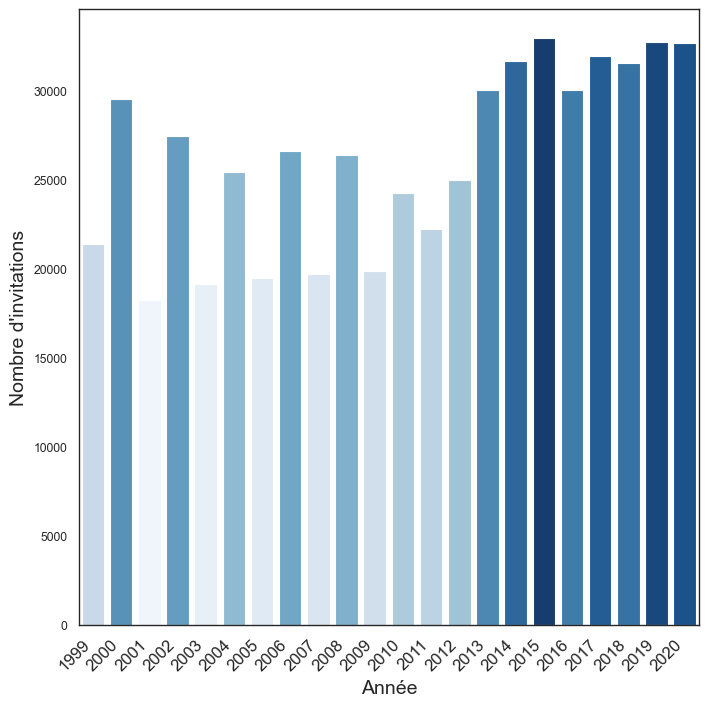

In [11]:
n_invit_by_year = pd.DataFrame(df_participation.groupby('year_invit').size()).reset_index()
pal = sns.color_palette("Blues", len(n_invit_by_year))
rank = n_invit_by_year[0].argsort().argsort()   # http://stackoverflow.com/a/6266510/1628638

fig, ax = plt.subplots(1, 1, figsize=(8, 8))
chart = sns.barplot(x="year_invit", y=0, data=n_invit_by_year, palette = np.array(pal)[rank], ax = ax)
chart.set_xticklabels(chart.get_xticklabels(),size = 12, rotation=45, horizontalalignment='right')
chart.set_xlabel("Année",size = 14)
chart.set_ylabel("Nombre d'invitations",size = 14)

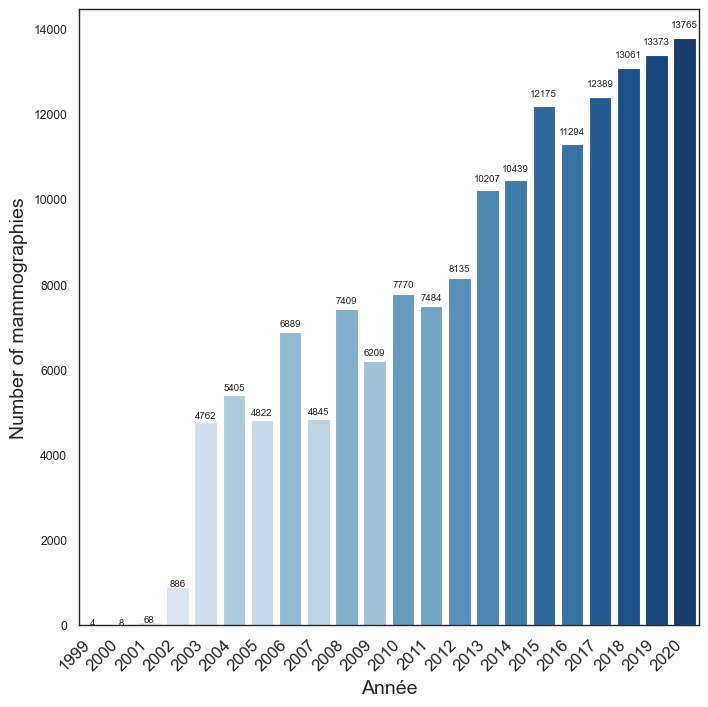

In [12]:
n_mammo_by_year = pd.DataFrame(df_participation.groupby('year_invit').mammo.sum()).reset_index()
pal = sns.color_palette("Blues", len(n_mammo_by_year))
rank = n_mammo_by_year['mammo'].argsort().argsort()   # http://stackoverflow.com/a/6266510/1628638

fig, ax = plt.subplots(1, 1, figsize=(8, 8))
chart = sns.barplot(x="year_invit", y="mammo", data=n_mammo_by_year, palette = np.array(pal)[rank], ax = ax)
chart.set_xticklabels(chart.get_xticklabels(),size = 12, rotation=45, horizontalalignment='right')
chart.set_xlabel("Année",size = 14)
chart.set_ylabel('Number of mammographies',size = 14)
show_values(chart, digits = 0, fontsize = 7)
plt.savefig('../Manuscript/Figures - EN/N_mammographies_per_year.png', dpi = 300, bbox_inches = 'tight')

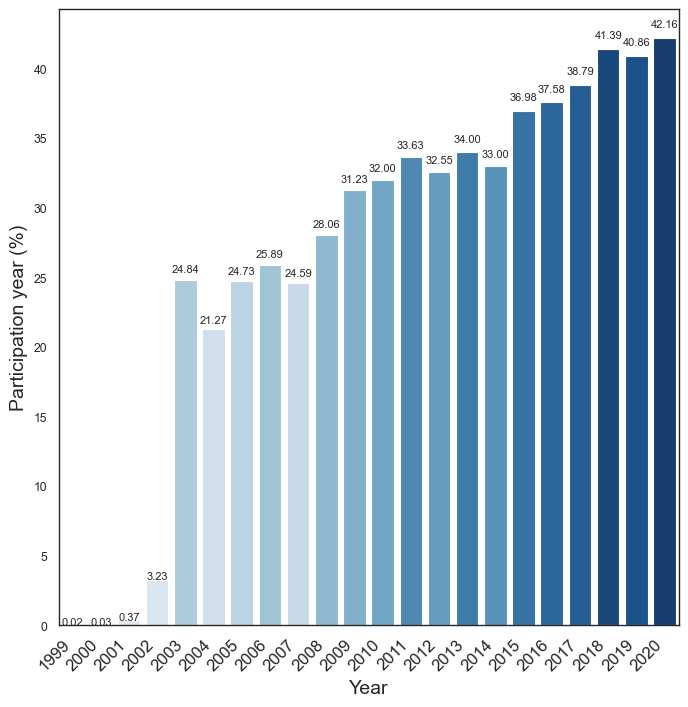

In [13]:
raw_rate_by_year = pd.DataFrame(n_mammo_by_year.set_index('year_invit')['mammo'].div(n_invit_by_year.set_index('year_invit')[0]).mul(100)).reset_index()

pal = sns.color_palette("Blues", len(n_mammo_by_year))
rank = raw_rate_by_year[0].argsort().argsort()   # http://stackoverflow.com/a/6266510/1628638

fig, ax = plt.subplots(1, 1, figsize=(8, 8))
chart = sns.barplot(x="year_invit", y=0, data=raw_rate_by_year, palette = np.array(pal)[rank], ax = ax)
chart.set_xticklabels(chart.get_xticklabels(),size = 12, rotation=45, horizontalalignment='right')
chart.set_xlabel("Year",size = 14)
chart.set_ylabel('Participation year (%)',size = 14)
show_values(chart)
plt.savefig('../Manuscript/Figures - EN/Rate_mammographies_per_year.png', dpi = 300, bbox_inches = 'tight')

## Simplification into hectares

In [14]:
statpop = pd.read_csv('/Users/david/Dropbox/PhD/Data/Databases/OFS/ag-b-00.03-vz2020statpop/STATPOP2020.csv',sep = ';')
statpop_ha = statpop.copy()
geometry = [Point(xy) for xy in zip(statpop['E_KOORD'], statpop['N_KOORD'])]
statpop_gdf_point = gpd.GeoDataFrame(statpop, crs=2056, geometry=geometry)   

In [15]:
statpop_communes_ge_point = gpd.sjoin(statpop_gdf_point,communes, predicate = 'intersects').drop('index_right',axis = 1) #Get ha that are in VD canton
_ = statpop_communes_ge_point.copy()
geometry = [Polygon(zip([xy[0],xy[0],xy[0]+100,xy[0]+100],[xy[1],xy[1]+100,xy[1]+100,xy[1]])) for xy in zip(_.E_KOORD, _.N_KOORD)]
statpop_communes_ge_ha = gpd.GeoDataFrame(_, crs=2056, geometry=geometry)      

### Data from Specchio

In [16]:
## Specchio into ha
gdf_specchio_ha = gpd.sjoin(gdf_specchio_mammo,statpop_communes_ge_ha[['RELI','geometry']], predicate = 'intersects').drop('index_right', axis = 1)

In [17]:
df_ha_specchio = pd.DataFrame(gdf_specchio_ha.RELI.unique(), columns = ['RELI'])
df_ha_specchio = pd.merge(df_ha_specchio, statpop_communes_ge_ha[['RELI','geometry']], on = 'RELI')
df_ha_specchio = gpd.GeoDataFrame(df_ha_specchio, crs = 2056, geometry = df_ha_specchio['geometry'])

In [18]:
gdf_specchio_ha['mammo_status'] = 0
gdf_specchio_ha.loc[gdf_specchio_ha.mammography_when == 'Moins de 2 ans', 'mammo_status'] = 1

In [19]:
n_specchio_mammo_by_ha = pd.DataFrame(gdf_specchio_ha.groupby(['RELI']).mammo_status.sum()).reset_index()
n_specchio_by_ha = pd.DataFrame(gdf_specchio_ha.groupby(['RELI']).size()).reset_index()

In [20]:
n_specchio_by_ha.columns = ['RELI','n_participant']
n_specchio_mammo_by_ha.columns = ['RELI','n_mammo']

In [21]:
df_ha_specchio = pd.merge(df_ha_specchio, n_specchio_by_ha, on = 'RELI').merge(n_specchio_mammo_by_ha, on = 'RELI', suffixes = ('_invit','_mammo'))

In [22]:
wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_ha_specchio.geometry.centroid)),16)
e = np.array(df_ha_specchio['n_mammo'])
b = np.array(df_ha_specchio['n_participant'])
ebs_rate, risk, eb_rate = sm.Spatial_Empirical_Bayes(e, b, wnn16), sm.Excess_Risk(e, b), sm.Empirical_Bayes(e, b)

df_ha_specchio['tx_screening'] = df_ha_specchio['n_mammo'].div(df_ha_specchio['n_participant']).mul(100)
df_ha_specchio['eb_rate'] = eb_rate.r
df_ha_specchio['eb_rate'] = df_ha_specchio['eb_rate'].fillna(0).mul(100)
df_ha_specchio['ebs_rate'] = ebs_rate.r
df_ha_specchio['ebs_rate'] = df_ha_specchio['ebs_rate'].fillna(0).mul(100)
df_ha_specchio['excess_risk'] = risk.r
df_ha_specchio['excess_risk'] = df_ha_specchio['excess_risk'].fillna(0)

df_ha_specchio['diff_rawrate_vs_ebsrate'] = df_ha_specchio['tx_screening'] - df_ha_specchio['ebs_rate']

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 2 disconnected components.



### Data from the Fondation

In [23]:
gdf_participation_ha = gpd.sjoin(gdf_participation,statpop_communes_ge_ha[['RELI','geometry']], predicate = 'intersects').drop('index_right', axis = 1)

In [24]:
# n_ovam_reli = df_soc_final_ctrl[df_soc_final_ctrl.stat_ovam == 1].groupby('reli')['stat_ovam'].size()
n_groupage = gdf_participation_ha.groupby(['RELI','groupeage']).size().unstack(fill_value = 0)
n_etatcivil = gdf_participation_ha.groupby(['RELI','etatcivil']).size().unstack(fill_value = 0)
n_year = gdf_participation_ha.groupby(['RELI','year_invit']).size().unstack(fill_value = 0)
income = gdf_participation_ha.groupby(['RELI']).income_ss.mean()
closest_center = gdf_participation_ha.groupby(['RELI'])['center_nearest'].mean()
density_center = gdf_participation_ha.groupby(['RELI'])['center_density'].mean()
max_center = gdf_participation_ha.groupby(['RELI'])['centre'].sum()

In [25]:
RELI_geom = statpop_communes_ge_ha.set_index('RELI')['geometry'].to_dict()

<Axes: >

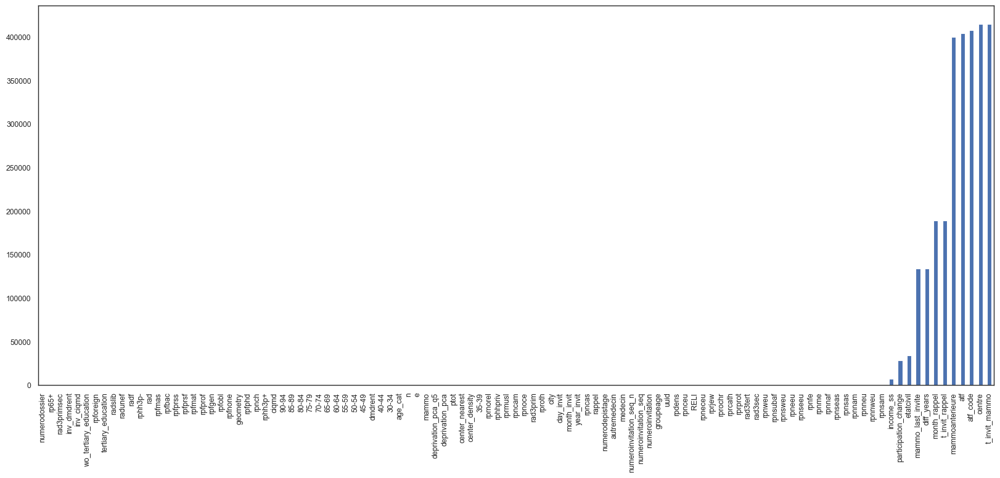

In [26]:
fig, ax =plt.subplots(figsize = (20,8))
gdf_participation_ha.isna().sum().sort_values().plot.bar(ax = ax)

In [214]:
gdf_participation_ha

AttributeError: 'GeoDataFrame' object has no attribute 'atc'

In [27]:
gdf_participation_ha = pd.merge(gdf_participation_ha,pd.get_dummies(gdf_participation_ha['etatcivil']), left_index = True, right_index = True)

In [28]:
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([1999,2000]), 'year_invit_2y'] = '2000'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2001,2002]), 'year_invit_2y'] = '2002'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2003,2004]), 'year_invit_2y'] = '2004'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2005,2006]), 'year_invit_2y'] = '2006'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2007,2008]), 'year_invit_2y'] = '2008'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2009,2010]), 'year_invit_2y'] = '2010'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2011,2012]), 'year_invit_2y'] = '2012'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2013,2014]), 'year_invit_2y'] = '2014'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2015,2016]), 'year_invit_2y'] = '2016'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2017,2018]), 'year_invit_2y'] = '2018'
gdf_participation_ha.loc[gdf_participation_ha['year_invit'].isin([2019,2020]), 'year_invit_2y'] = '2020'

In [29]:
# _ha = pd.DataFrame(gdf_participation_ha.groupby(['RELI','year_invit']).mammo.sum()).reset_index()
n_mammo_by_ha = pd.DataFrame(gdf_participation_ha.groupby(['RELI','year_invit_2y']).mammo.sum()).reset_index()
n_invit_by_ha = pd.DataFrame(gdf_participation_ha.groupby(['RELI','year_invit_2y']).size()).reset_index()

n_mammo_by_ha.columns = ['RELI','year_invit','n_mammo']
n_invit_by_ha.columns = ['RELI','year_invit','n_invit']

#f.pivot(index='foo', columns='bar', values='baz')
n_mammo_by_ha = n_mammo_by_ha.pivot(index ='RELI',columns = 'year_invit',values = 'n_mammo').fillna(0).reset_index()
n_invit_by_ha = n_invit_by_ha.pivot(index ='RELI',columns = 'year_invit',values = 'n_invit').fillna(0).reset_index()

In [30]:
# _ha = pd.DataFrame(gdf_participation_ha.groupby(['RELI','year_invit']).mammo.sum()).reset_index()
n_mammo_by_ha_1st = pd.DataFrame(gdf_participation_ha[gdf_participation.numeroinvitation_seq == 1].groupby(['RELI','year_invit_2y']).mammo.sum()).reset_index()
n_invit_by_ha_1st = pd.DataFrame(gdf_participation_ha[gdf_participation.numeroinvitation_seq == 1].groupby(['RELI','year_invit_2y']).size()).reset_index()

n_mammo_by_ha_1st.columns = ['RELI','year_invit','n_mammo']
n_invit_by_ha_1st.columns = ['RELI','year_invit','n_invit']

#f.pivot(index='foo', columns='bar', values='baz')
n_mammo_by_ha_1st = n_mammo_by_ha_1st.pivot(index ='RELI',columns = 'year_invit',values = 'n_mammo').fillna(0).reset_index()
n_invit_by_ha_1st = n_invit_by_ha_1st.pivot(index ='RELI',columns = 'year_invit',values = 'n_invit').fillna(0).reset_index()

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/geopandas/geodataframe.py:1415: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/geopandas/geodataframe.py:1415: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



### Most visited center for each ha

In [31]:
_ = gdf_participation_ha.groupby(['RELI','centre'], observed = True).size()
n_mammo_by_ha_by_center = pd.DataFrame(_, columns = ['n']).reset_index()
max_center_by_ha = n_mammo_by_ha_by_center[n_mammo_by_ha_by_center.index.isin(n_mammo_by_ha_by_center.groupby('RELI').n.idxmax().values)]
max_center_by_ha['geometry'] = max_center_by_ha['RELI'].map(RELI_geom)
max_center_by_ha = gpd.GeoDataFrame(max_center_by_ha, crs = 2056, geometry=max_center_by_ha['geometry'])

/var/folders/vs/k61m7qc90ds735nc0468d1x80000gn/T/ipykernel_25678/447814832.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [32]:
_2020 = gdf_participation_ha[gdf_participation_ha.year_invit_2y == '2020'].groupby(['RELI','centre'], observed = True).size()
n_mammo_by_ha_by_center_2020 = pd.DataFrame(_2020, columns = ['n']).reset_index()
max_center_by_ha_2020 = n_mammo_by_ha_by_center_2020[n_mammo_by_ha_by_center_2020.index.isin(n_mammo_by_ha_by_center_2020.groupby('RELI').n.idxmax().values)]
max_center_by_ha_2020['geometry'] = max_center_by_ha_2020['RELI'].map(RELI_geom)
max_center_by_ha_2020 = gpd.GeoDataFrame(max_center_by_ha_2020, crs = 2056, geometry=max_center_by_ha['geometry'])

/var/folders/vs/k61m7qc90ds735nc0468d1x80000gn/T/ipykernel_25678/758062345.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [33]:
max_center_by_ha_2020['geometry'] = max_center_by_ha_2020['RELI'].map(RELI_geom)

In [34]:
colors_centre = ['#a6cee3',
'#1f78b4',
'#b2df8a',
'#33a02c',
'#fb9a99',
'#e31a1c',
'#fdbf6f',
'#ff7f00',
'#4d4d4d',
'#6a3d9a',
'#fccde5',
'#b15928',
'#8dd3c7',
'#ffffb3',
'#bebada',
'#fb8072',
'#80b1d3']

In [35]:
dict_color_centre = {i:j for i,j in zip(max_center_by_ha_2020.centre.unique(),colors_centre)}

In [36]:
hmap_centre = colors.ListedColormap([dict_color_centre[i] for i in max_center_by_ha_2020['centre'].sort_values().unique()])

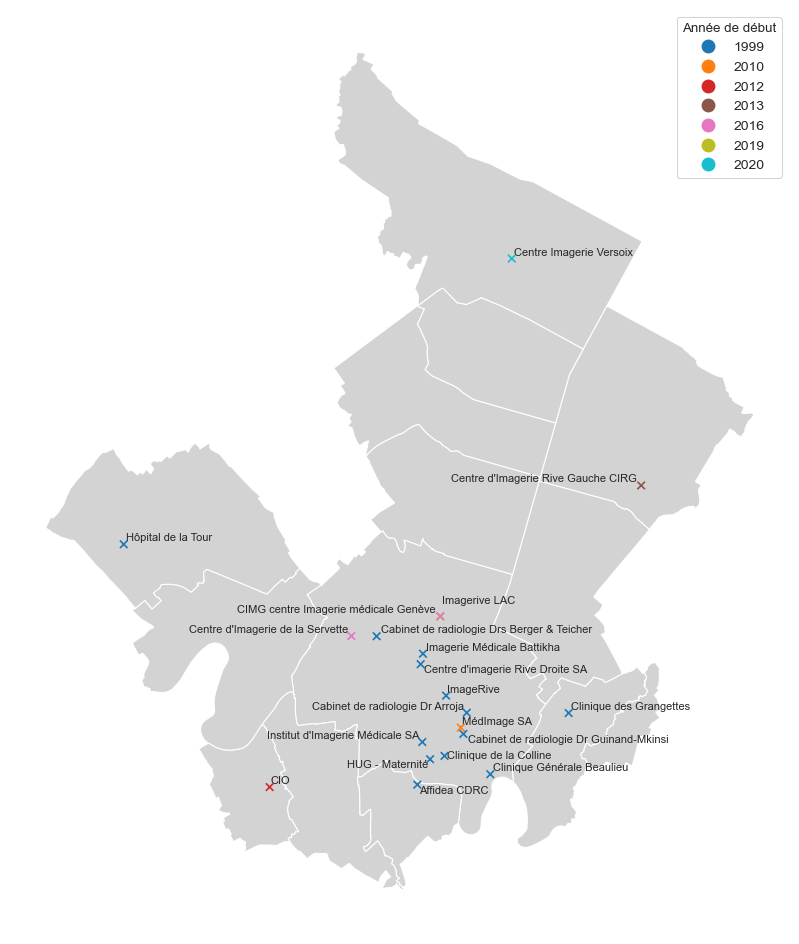

In [37]:
gdf_centre = gpd.read_file('../Data/BC_ScreeningCenters.geojson',driver = 'GeoJSON')
gdf_centre.crs = 4326
gdf_centre['geometry'] = gpd.points_from_xy(gdf_centre.lon, gdf_centre.lat)
gdf_centre = gdf_centre.to_crs(2056)
gdf_centre['year_start'] = gdf_centre['year_start'].astype(int)

from adjustText import adjust_text

ax = communes[communes.NAME.isin(['Genève','Carouge (GE)','Cologny','Pregny-Chambésy','Bellevue','Vernier','Collonge-Bellerive','Chêne-Bougeries','Chêne-Bourg','Onex','Lancy','Meyrin','Genthod','Versoix'])].plot(color = 'lightgrey', zorder = 1, figsize = (12,12))
# lake.plot(color = 'lightblue',ax = ax, zorder = 2)
ax.set_axis_off()
gdf_centre.plot('year_start', categorical = True
                , markersize = 30, alpha = 1, marker = 'x', legend = True, ax = ax, zorder = 6, legend_kwds = {'title':'Année de début','fontsize':10})
texts = gdf_centre.apply(lambda x: ax.annotate(text=x.center_name, xy=x.geometry.centroid.coords[0], ha='center', size=8, alpha = 1),
               axis=1)
adjust_text(texts)

plt.savefig('../Manuscript/Figures/Centres de dépistage.png', dpi = 300, bbox_inches = 'tight')

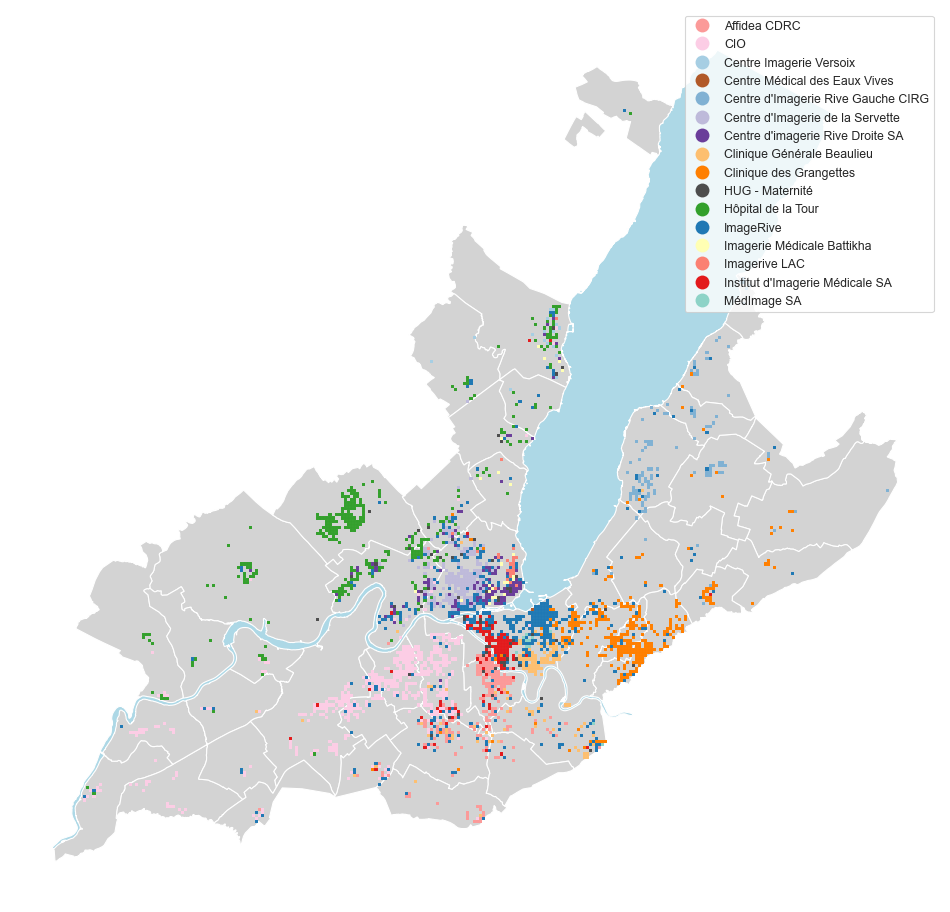

In [38]:
ax = max_center_by_ha_2020[max_center_by_ha_2020.n > 1].plot('centre',categorical = True,cmap = hmap_centre, linewidth = 0.01, legend = True, figsize = (12,12), zorder = 3)
communes.plot(color = 'lightgrey', ax = ax, zorder = 1)
lake.plot(color = 'lightblue',ax = ax, zorder = 2)
ax.set_axis_off()
plt.savefig('../Manuscript/Figures/Most visited centre by ha.png', dpi=300, bbox_inches = 'tight')

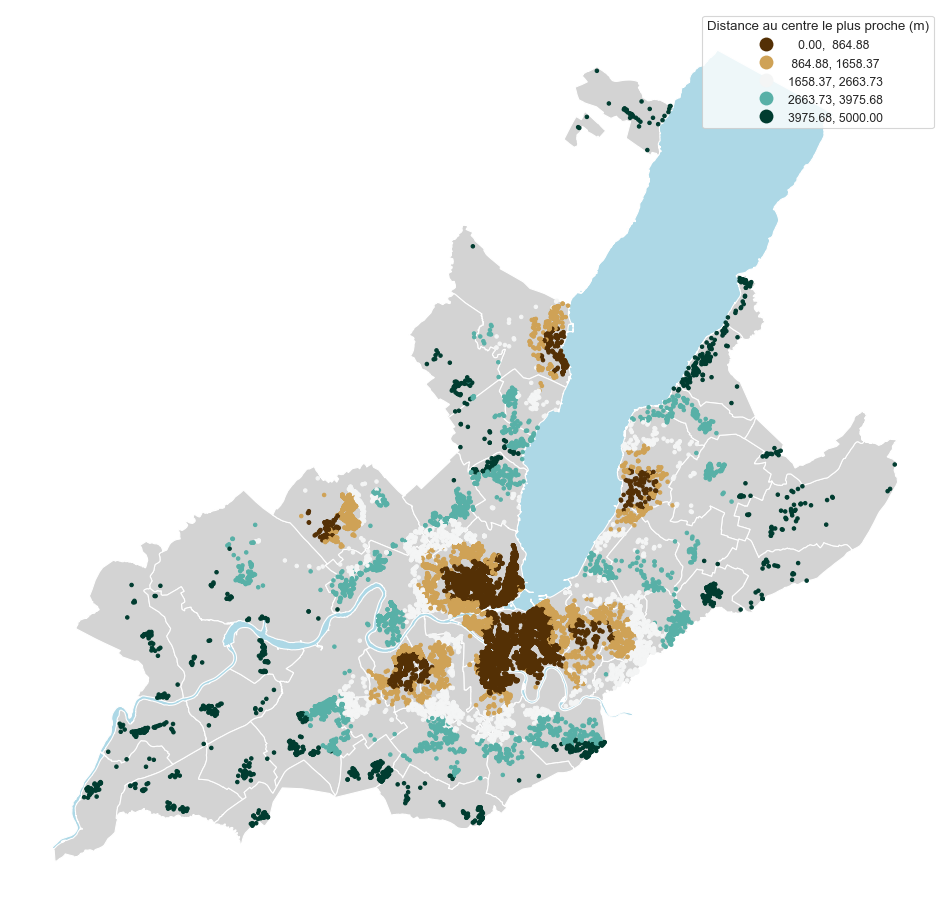

In [39]:
fig, ax = plt.subplots( figsize = (12,12))
gdf_participation_ha[gdf_participation_ha.year_invit == 1999].plot('center_nearest', categorical = True, scheme = 'naturalbreaks', cmap = 'BrBG', legend = True, markersize = 6, ax = ax, legend_kwds = {'title':'Distance au centre le plus proche (m)'}, zorder = 3)
communes.plot(ax = ax, color = 'lightgrey', zorder = 1)
lake.plot(ax = ax, color = 'lightblue',zorder = 2)
ax.set_axis_off()

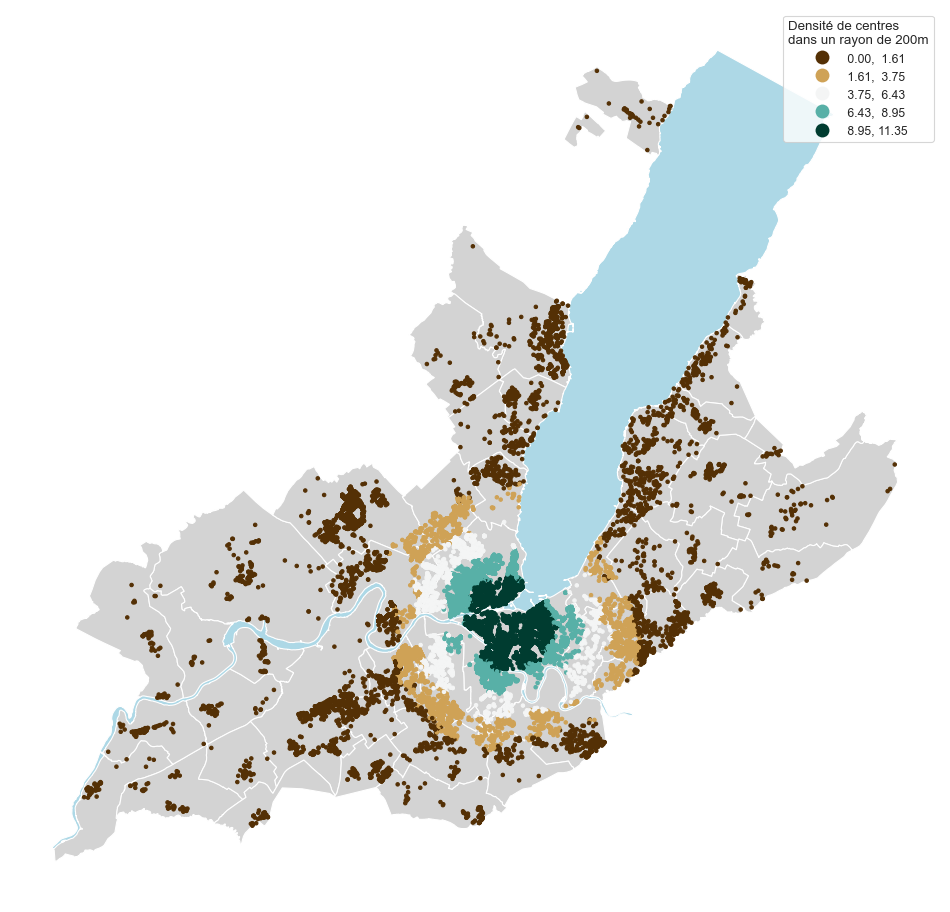

In [40]:
fig, ax = plt.subplots( figsize = (12,12))
gdf_participation_ha[gdf_participation_ha.year_invit == 1999].plot('center_density', categorical = True, scheme = 'naturalbreaks', cmap = 'BrBG', legend = True, markersize = 6, ax = ax, legend_kwds = {'title':'Densité de centres \ndans un rayon de 200m'}, zorder = 3)
communes.plot(ax = ax, color = 'lightgrey', zorder = 1)
lake.plot(ax = ax, color = 'lightblue',zorder = 2)
ax.set_axis_off()

In [41]:
df_ha = pd.DataFrame(gdf_participation_ha.RELI.unique(), columns = ['RELI'])
df_ha = pd.merge(df_ha, statpop_communes_ge_ha[['RELI','geometry']], on = 'RELI')
df_ha = gpd.GeoDataFrame(df_ha, crs = 2056, geometry = df_ha['geometry'])
df_ha = pd.merge(df_ha, n_invit_by_ha, on = 'RELI').merge(n_mammo_by_ha, on = 'RELI', suffixes = ('_invit','_mammo'))

In [42]:
df_ha_1st = pd.DataFrame(gdf_participation_ha[gdf_participation_ha.numeroinvitation_seq == 1].RELI.unique(), columns = ['RELI'])
df_ha_1st = pd.merge(df_ha_1st, statpop_communes_ge_ha[['RELI','geometry']], on = 'RELI')
df_ha_1st = gpd.GeoDataFrame(df_ha_1st, crs = 2056, geometry = df_ha_1st['geometry'])

df_ha_1st = pd.merge(df_ha_1st, n_invit_by_ha_1st, on = 'RELI').merge(n_mammo_by_ha_1st, on = 'RELI', suffixes = ('_invit','_mammo'))

### Group by 2 years to account for the biannual pattern

#### Calculate participation rates - Any participation

In [43]:
dfs_year = []
for year in range(2000, 2022, 2):
    invit_year, mammo_year = f"{year}_invit", f"{year}_mammo"

    df_ha_year = df_ha[df_ha[invit_year] > 0][['RELI', invit_year, mammo_year, 'geometry']]
    wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_ha_year.geometry.centroid)), 16)
    e, b = np.array(df_ha_year[mammo_year]), np.array(df_ha_year[invit_year])
    ebs_rate, risk, eb_rate = sm.Spatial_Empirical_Bayes(e, b, wnn16), sm.Excess_Risk(e, b), sm.Empirical_Bayes(e, b)

    df_ha_year['tx_screening'] = df_ha_year[mammo_year].div(df_ha_year[invit_year]).mul(100)
    df_ha_year['eb_rate'] = eb_rate.r
    df_ha_year['eb_rate'] = df_ha_year['eb_rate'].fillna(0).mul(100)
    df_ha_year['ebs_rate'] = ebs_rate.r
    df_ha_year['ebs_rate'] = df_ha_year['ebs_rate'].fillna(0).mul(100)
    df_ha_year['excess_risk'] = risk.r
    df_ha_year['excess_risk'] = df_ha_year['excess_risk'].fillna(0)

    er_bins = [0, 0.25, 0.5, 0.75, 1, 1.25, 2, 4, 10]
    ebs_bins = [0, 20, 40, 60, 80, 100]

    df_ha_year['er_bins'] = pd.cut(df_ha_year['excess_risk'], bins=er_bins)
    df_ha_year['ebs_bins'] = pd.cut(df_ha_year['ebs_rate'], bins=ebs_bins)

    df_ha_year['diff_rawrate_vs_ebsrate'] = df_ha_year['tx_screening'] - df_ha_year['ebs_rate']

    dfs_year.append(df_ha_year)

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in divide

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in divide

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in div

#### Calculate participation rates - First participation

In [44]:
dfs_year_1st = []
for year in range(2000,2022,2):
    invit_year = str(year)+'_invit'
    mammo_year = str(year)+'_mammo'

    df_ha_year_1st = df_ha_1st[df_ha_1st[invit_year] > 0][['RELI',invit_year,mammo_year,'geometry']]
    wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_ha_year_1st.geometry.centroid)),16)
    e = np.array(df_ha_year_1st[mammo_year])
    b = np.array(df_ha_year_1st[invit_year])
    eb_rate = sm.Empirical_Bayes(e, b)
    ebs_rate = sm.Spatial_Empirical_Bayes(e, b, wnn16)
    risk = sm.Excess_Risk(e, b)
    df_ha_year_1st['tx_screening'] = df_ha_year_1st[mammo_year].div(df_ha_year_1st[invit_year]).mul(100)
    df_ha_year_1st['eb_rate'] = eb_rate.r
    df_ha_year_1st['eb_rate'] = df_ha_year_1st['eb_rate'].fillna(0)
    df_ha_year_1st['eb_rate'] = df_ha_year_1st['eb_rate'].mul(100)
    df_ha_year_1st['ebs_rate'] = ebs_rate.r
    df_ha_year_1st['ebs_rate'] = df_ha_year_1st['ebs_rate'].fillna(0)
    df_ha_year_1st['ebs_rate'] = df_ha_year_1st['ebs_rate'].mul(100)
    df_ha_year_1st['excess_risk'] = risk.r
    df_ha_year_1st['excess_risk'] = df_ha_year['excess_risk'].fillna(0)
    df_ha_year_1st['er_bins'] = pd.cut(df_ha_year_1st['excess_risk'], bins = [0,0.25,0.5,0.75,1,1.25,2,4,10])
    df_ha_year_1st['ebs_bins'] = pd.cut(df_ha_year_1st['ebs_rate'], bins = [0,20,40,60,80,100])
    df_ha_year_1st['diff_rawrate_vs_ebsrate'] = df_ha_year_1st['tx_screening']-(df_ha_year_1st['ebs_rate'])
    dfs_year_1st.append(df_ha_year_1st)

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in divide

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in divide

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in divide

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in divide

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in divide

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning

In [45]:
res_folder = Path('../Results/Rate maps/')
year = 2000
for df_year in dfs_year:
    ax = communes.plot(color = 'darkgrey',figsize = (15,15))

    df_year.plot('tx_screening',cmap = 'Blues', linewidth = 0.01, scheme = 'quantiles', legend = True,legend_kwds = {'title': "Taux de participation (brut) (%)",'fmt':"{:.1f}",'loc': 'upper left'},ax = ax)

    lake.plot(color = 'lightblue',ax = ax)
    ctx.add_basemap(ax, source=ctx.providers.Stamen.TonerLite,crs = 'EPSG:2056')
    lake.apply(lambda x: ax.annotate(text=x.NOM, xy=x.geometry.centroid.coords[0], ha='center',size = 8),axis=1);
    communes.apply(lambda x: ax.annotate(text=x.NAME, xy=x.geometry.centroid.coords[0], ha='center',size = 6),axis=1);

    # add scale bar
    scalebar = ScaleBar(1, units="m", location="lower right")
    ax.add_artist(scalebar)
    ax.set_title('Taux de dépistage du cancer du sein en %s (Brut)'% str(year))
    # ax.set_facecolor('black')
    ax.set_axis_off()
    filename = '%s.png' % str(year)
    filepath = res_folder/'Raw'/filename
    plt.savefig(filepath,dpi = 120)
    plt.clf()
    plt.close(fig)
    
    year += 2

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning:

Not enough unique values in array to form 5 classes. Setting k to 2.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning:

Not enough unique values in array to form 5 classes. Setting k to 2.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning:

Not enough unique values in array to form 5 classes. Setting k to 4.



<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [46]:
res_folder = Path('../Results/Rate maps/')
year = 2000
for df_year in dfs_year:
    ax = communes.plot(color = 'darkgrey',figsize = (15,15))

    df_year.plot('ebs_rate',cmap = 'Blues', linewidth = 0.01, scheme = 'quantiles', legend = True,legend_kwds = {'title': "Taux de participation (EBS) (%)",'fmt':"{:.1f}",'loc': 'upper left'},ax = ax)

    lake.plot(color = 'lightblue',ax = ax)
    ctx.add_basemap(ax, source=ctx.providers.Stamen.TonerLite,crs = 2056)
    lake.apply(lambda x: ax.annotate(text=x.NOM, xy=x.geometry.centroid.coords[0], ha='center',size = 8),axis=1);
    communes.apply(lambda x: ax.annotate(text=x.NAME, xy=x.geometry.centroid.coords[0], ha='center',size = 6),axis=1);

    # add scale bar
    scalebar = ScaleBar(1, units="m", location="lower right")
    ax.add_artist(scalebar)
    ax.set_title('Taux de dépistage du cancer du sein en %s (Empirical Bayes Smoothing)'% str(year))
    # ax.set_facecolor('black')
    ax.set_axis_off()
    filename = '%s.png' % str(year)
    filepath = res_folder/'Empirical Bayes Smoothing'/filename
    plt.savefig(filepath,dpi = 120)
    plt.clf()
    plt.close(fig)
    
    year += 2

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/mapclassify/classifiers.py:255: UserWarning:

Not enough unique values in array to form 5 classes. Setting k to 2.



<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

In [47]:
res_folder = Path('../Results/Rate maps/')
year = 2000
for df_year in dfs_year:
    ax = communes.plot(color = 'darkgrey',figsize = (15,15))

    df_year.plot('ebs_bins', cmap = 'bwr', legend = True, linewidth = 0.01,legend_kwds = {'title': "Taux de participation (EBS) (%)",'fmt':"{:.1f}",'loc': 'upper left'},ax = ax)

    lake.plot(color = 'lightblue',ax = ax)
    ctx.add_basemap(ax, source=ctx.providers.Stamen.TonerLite,crs = 'EPSG:2056')
    lake.apply(lambda x: ax.annotate(text=x.NOM, xy=x.geometry.centroid.coords[0], ha='center',size = 8),axis=1);
    communes.apply(lambda x: ax.annotate(text=x.NAME, xy=x.geometry.centroid.coords[0], ha='center',size = 6),axis=1);

    # add scale bar
    scalebar = ScaleBar(1, units="m", location="lower right")
    ax.add_artist(scalebar)
    ax.set_title('Taux de dépistage du cancer du sein en %s (Empirical Bayes Smoothing)'% str(year))
    # ax.set_facecolor('black')
    ax.set_axis_off()
    filename = '%s_binned.png' % str(year)
    filepath = res_folder/'Empirical Bayes Smoothing'/filename
    plt.savefig(filepath,dpi = 120)
    plt.clf()
    plt.close(fig)
    
    year += 2

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

<Figure size 1500x1500 with 0 Axes>

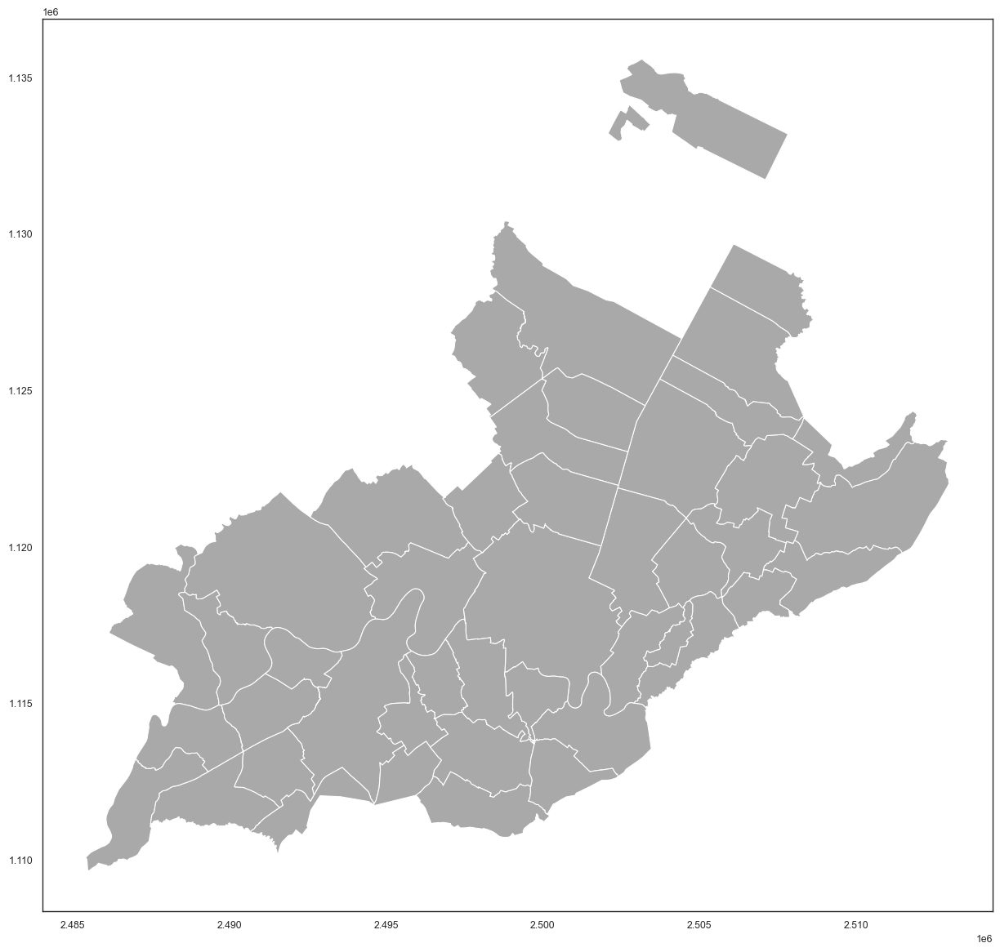

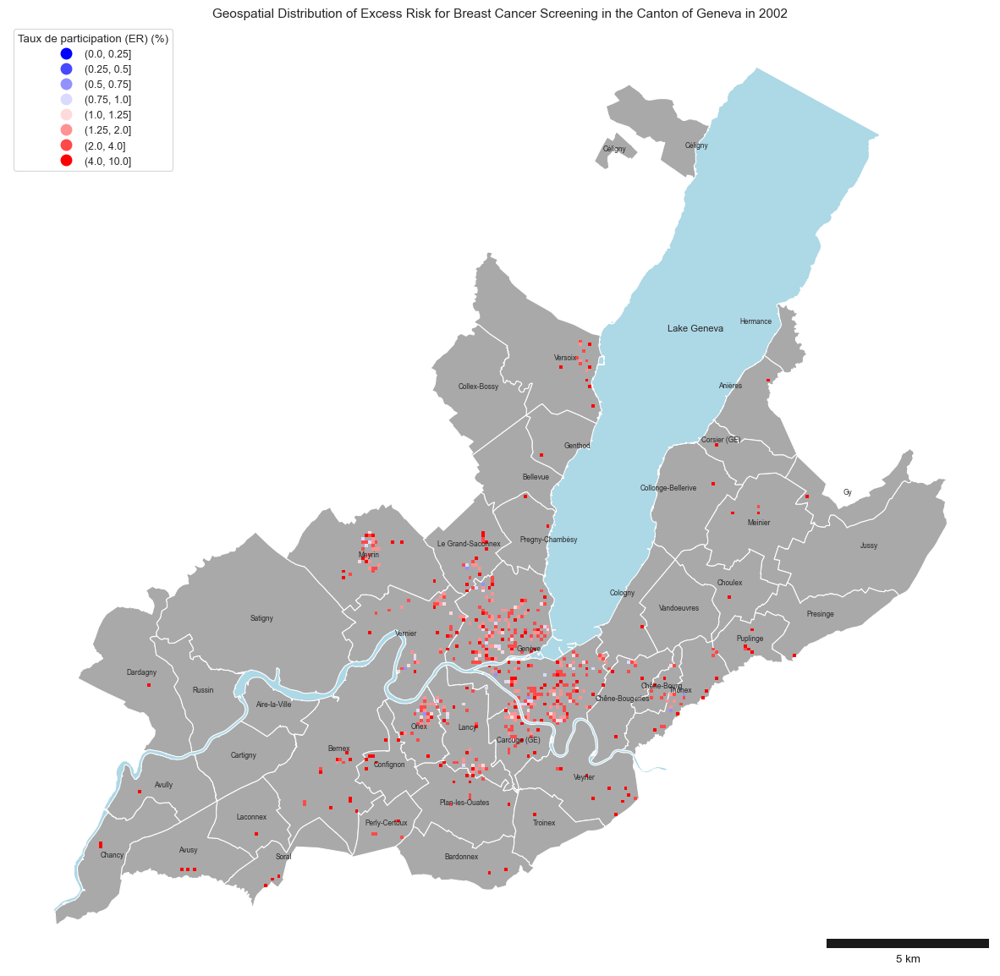

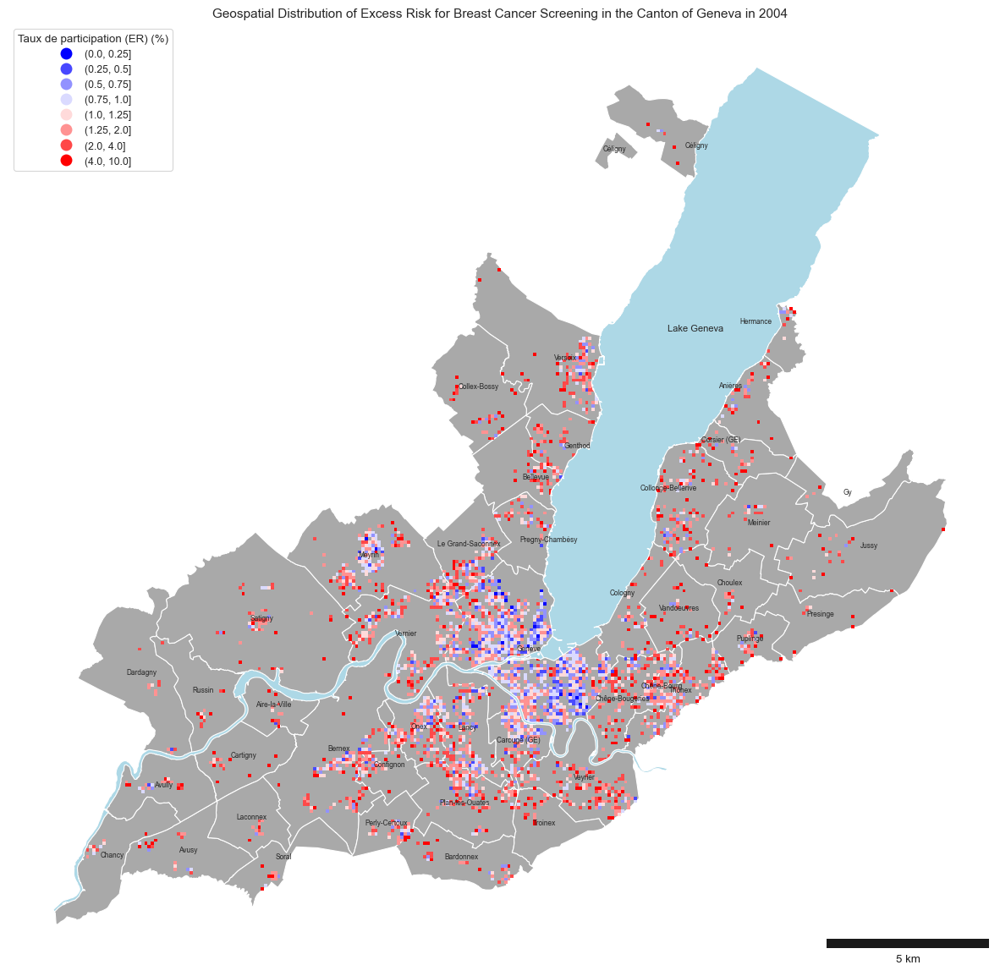

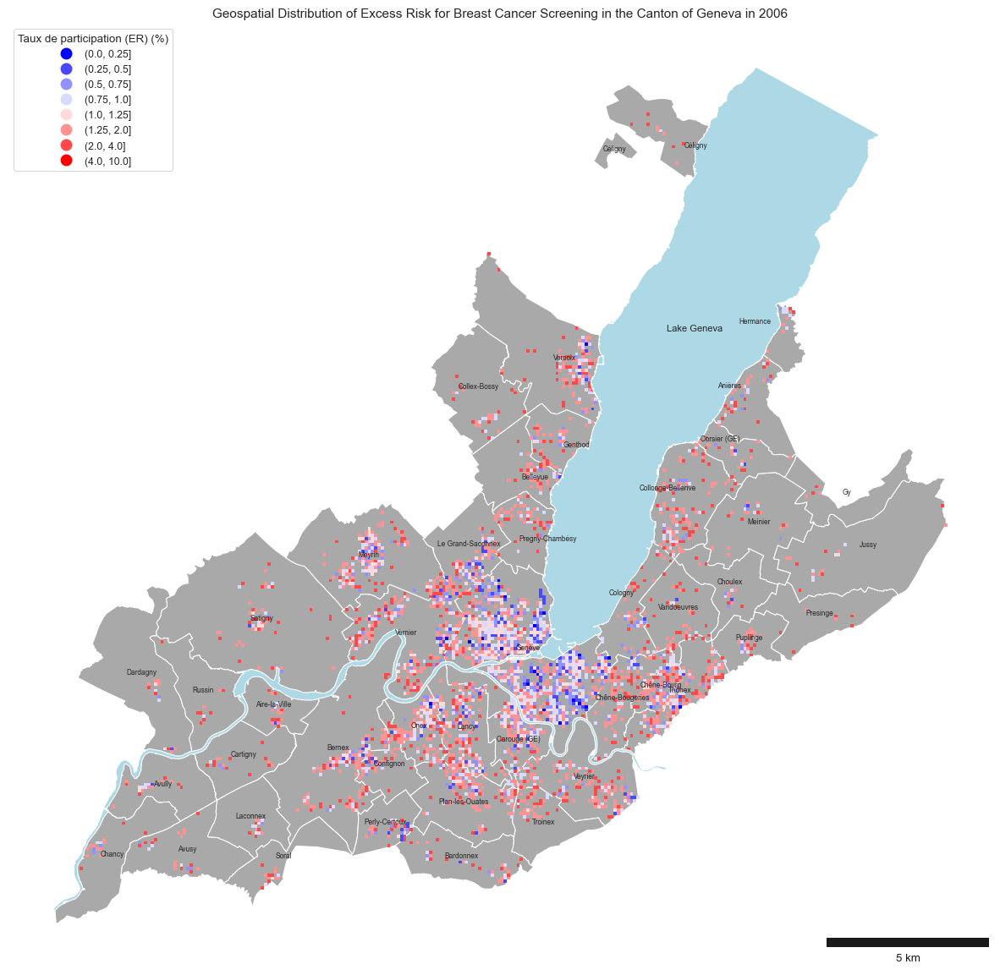

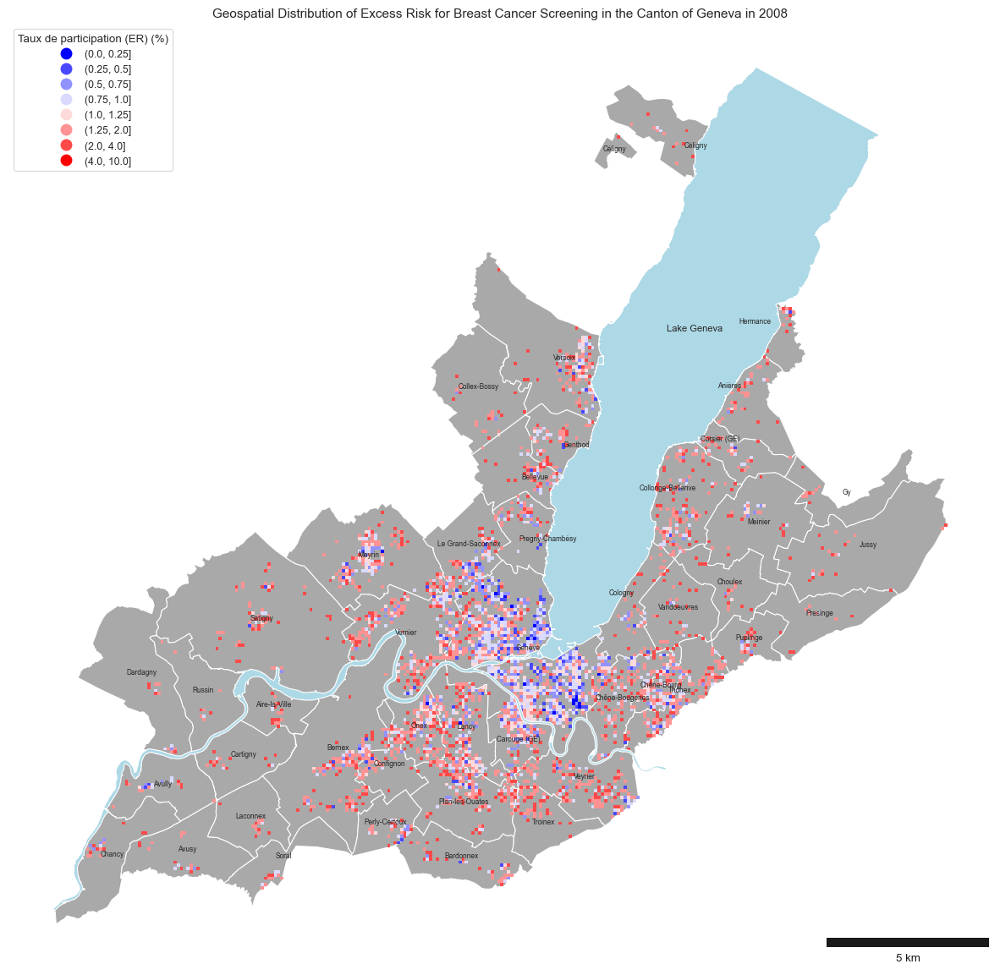

...

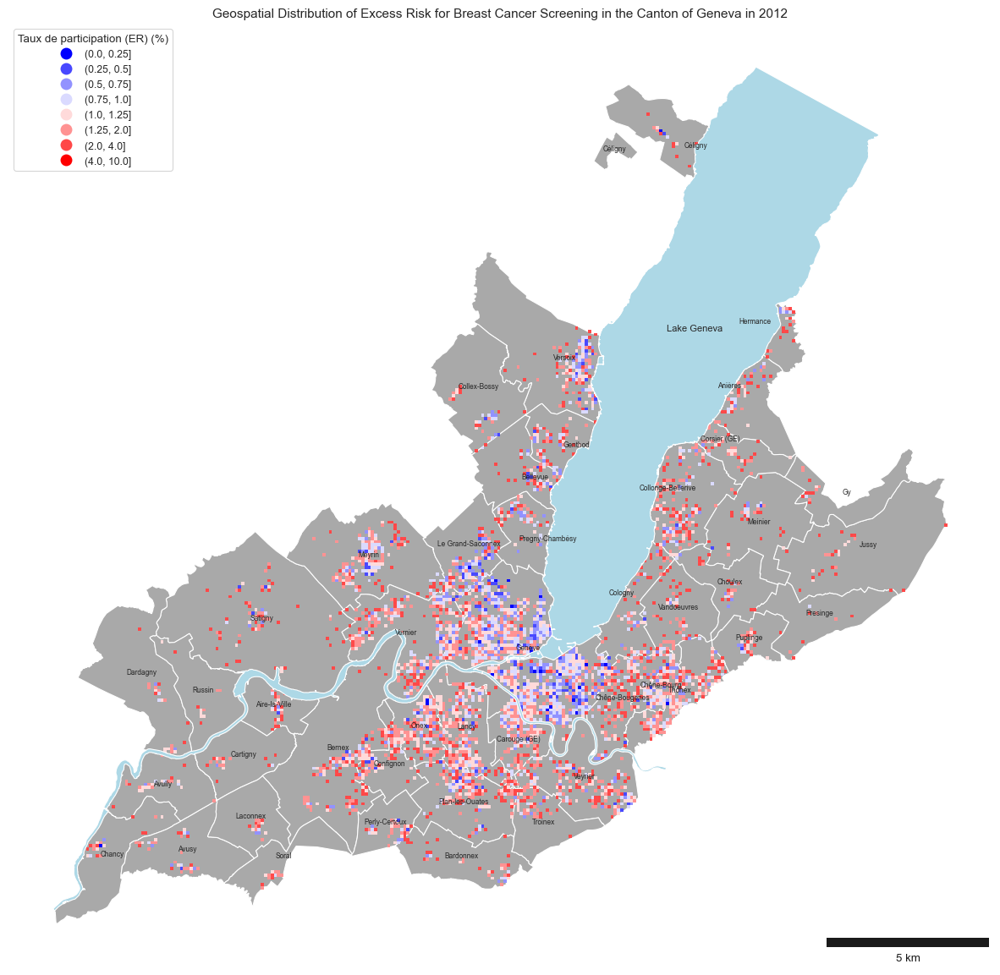

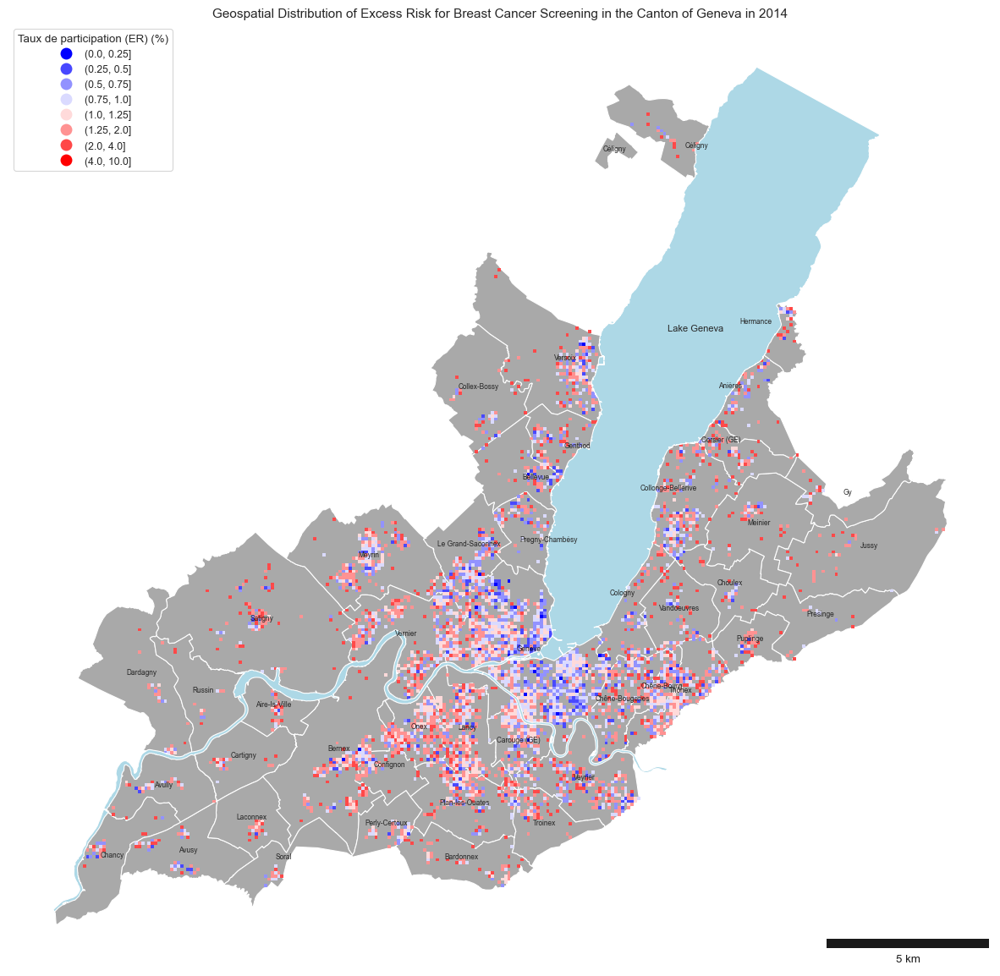

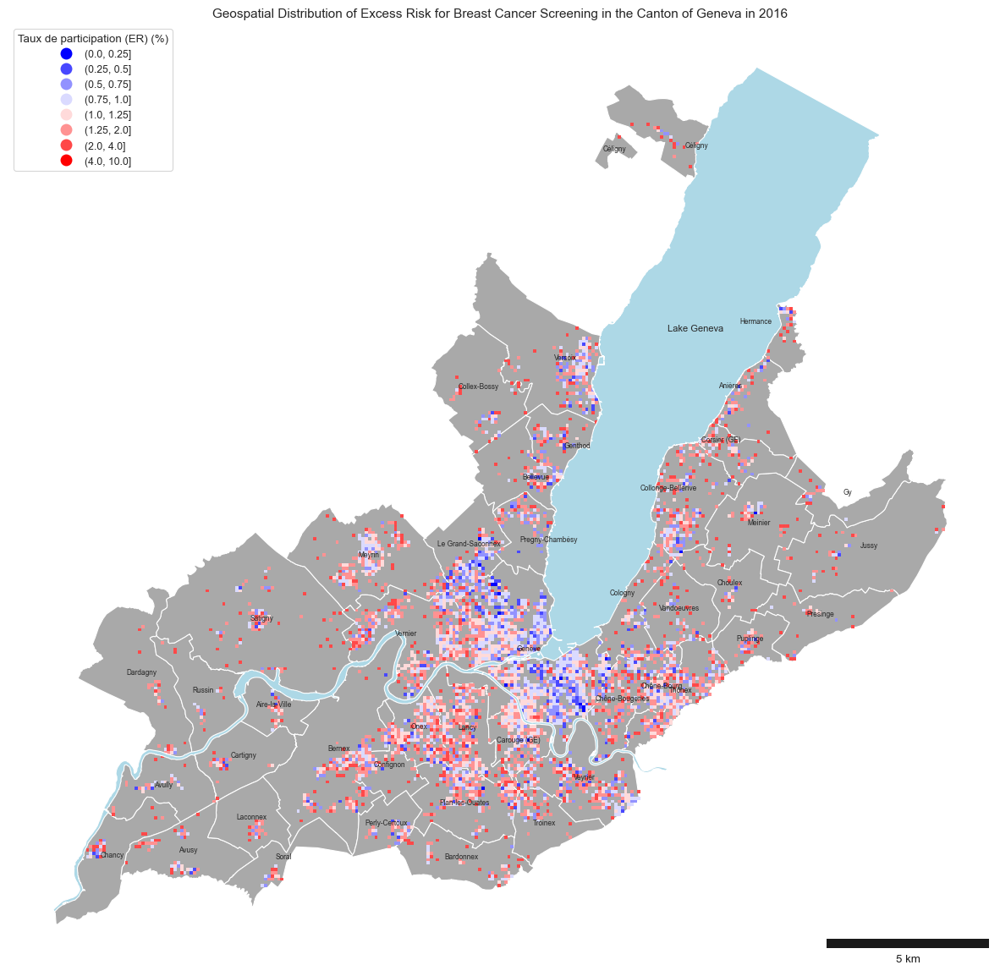

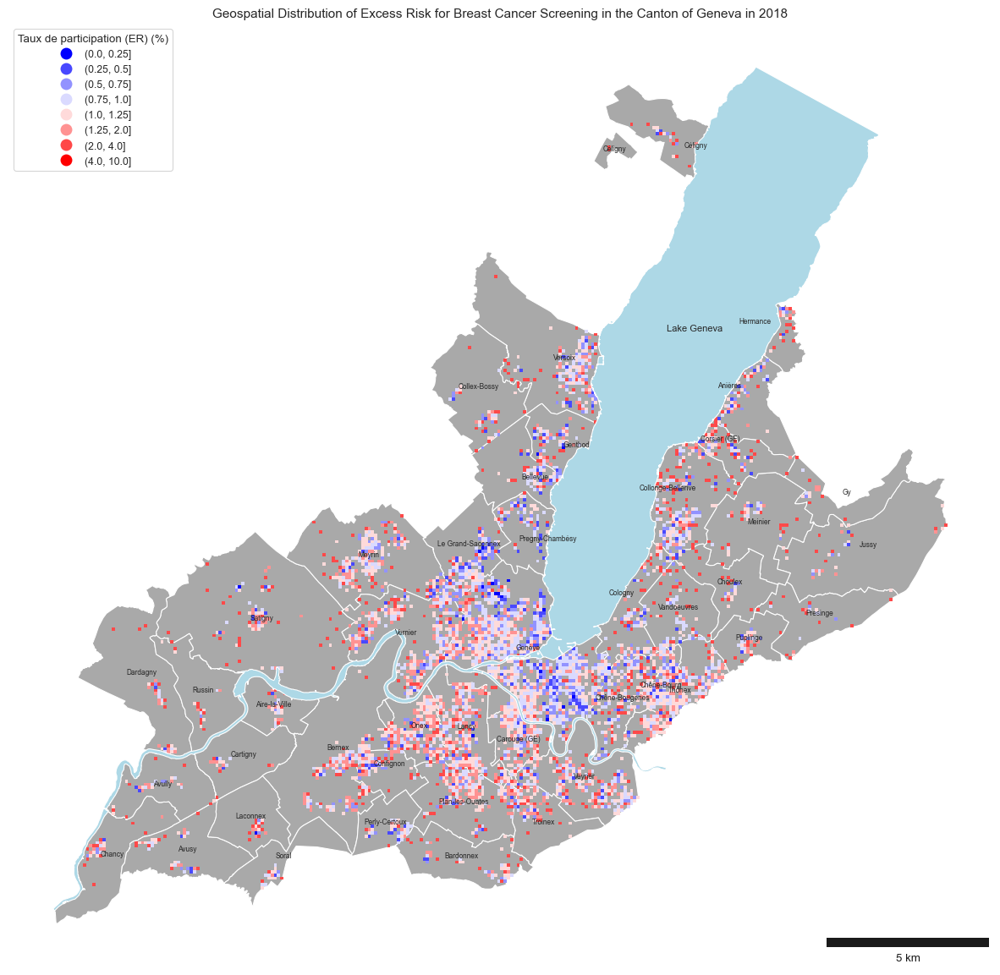

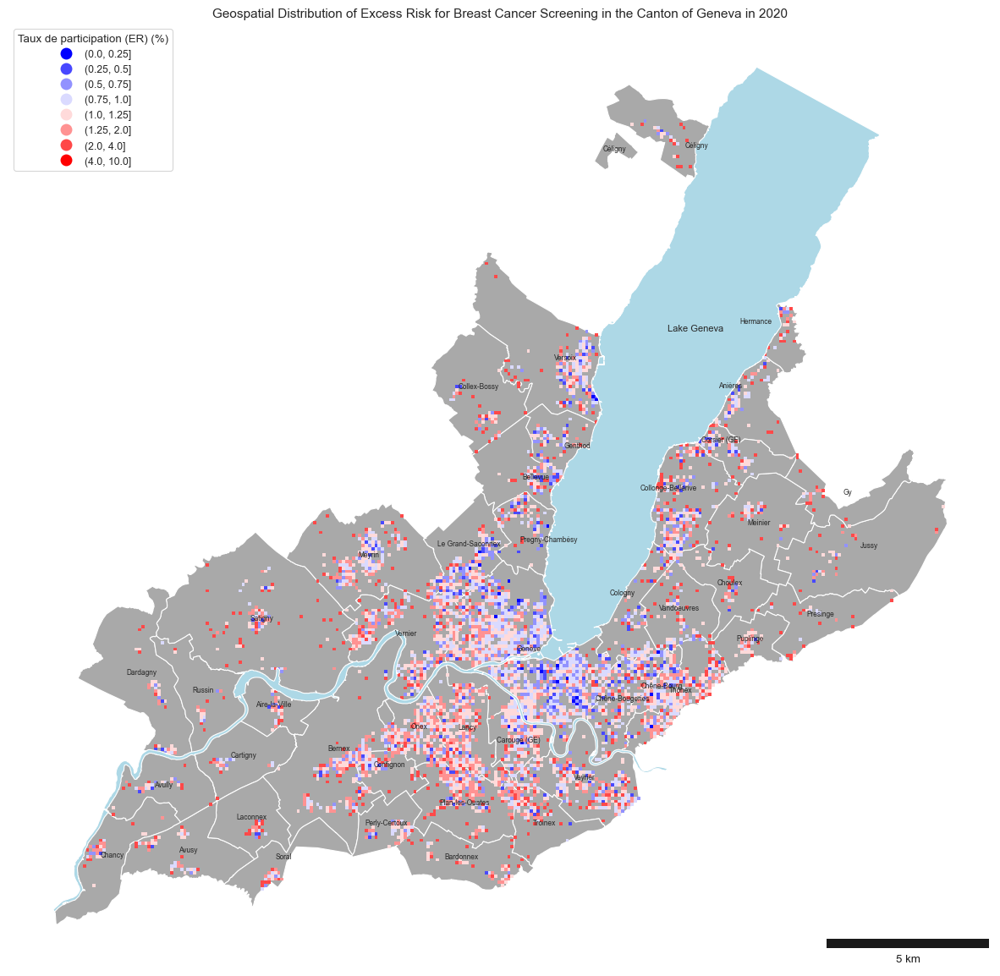

In [48]:
res_folder = Path('../Results/Rate maps/')
figures_folder = Path('../Manuscript/Figures - EN/')
year = 2000
for df_year in dfs_year:
    try:
        ax = communes.plot(color = 'darkgrey',figsize = (15,15))
        df_year.plot('er_bins', cmap = 'bwr', legend = True, linewidth = 0.01, legend_kwds = {'title': "Taux de participation (ER) (%)",'fmt':"{:.1f}",'loc': 'upper left'}, ax = ax)
        lake.plot(color = 'lightblue',ax = ax)
        lake.apply(lambda x: ax.annotate(text=x.NOM, xy=x.geometry.centroid.coords[0], ha='center',size = 8),axis=1);
        communes.apply(lambda x: ax.annotate(text=x.NAME, xy=x.geometry.centroid.coords[0], ha='center',size = 6),axis=1);
        # add scale bar
        scalebar = ScaleBar(1, units="m", location="lower right")
        ax.add_artist(scalebar)
        ax.set_title('Geospatial Distribution of Excess Risk for Breast Cancer Screening in the Canton of Geneva in %s'% str(year), size=11)
        ax.set_axis_off()
        filename = 'Excess risk_%s.png' % str(year)
        filepath = figures_folder/filename
        plt.savefig(filepath, dpi = 300, bbox_inches = 'tight')
        year += 2
    except:
        year += 2
        pass

In [49]:
print("Overall participation rate is : ",round(gdf_participation[gdf_participation.numerodepistage > 0].numerodossier.nunique()/118963, 3))

Overall participation rate is :  0.507


## Local spatial autocorrelation

In [50]:
from importlib import reload
from esda import fdr
reload(pyspace)

<module 'pyspace' from '/Users/david/Dropbox/PhD/Scripts/Spatial analyses/pyspace.py'>

## LISA analysis

In [51]:
from esda import Moran_Local_Rate
from esda import Moran_Local

### Subanalysis - Figuring out the different rates

- Tried to used Moran_Local_rate but getting NaN values due to negative variance values (ebi_v). 
- Setting negative values to 0 doesn't work
- The rate calculated in the Moran_Local_rate is not the same as the usual EB rate... (Assuncao rate)
- The usual EB rate returns weird values (-1900, 1300) on the whole dataset while it looks fine when only including the first 2000 ha...No explanation
- 

In [52]:
e = np.array(df_year['2020_mammo'])
b = np.array(df_year['2020_invit'])

In [53]:
e_sum, b_sum = sum(e), sum(b)
r_mean = e_sum / b_sum
rate = e / b
r_variat = rate - r_mean
r_var_left = (b * r_variat * r_variat).sum() * 1.0 / b_sum
r_var_right = r_mean * 1.0 / b.mean()
r_var = r_var_left - r_var_right
weight = r_var / (r_var + r_mean / b)
r = weight * rate + (1.0 - weight) * r_mean
r[:200]

array([  0.48996469,   1.67972083,  -0.17078598,   1.50174117,
         0.4890206 ,   0.42378871,   0.33227529,   1.04203569,
         0.62615054,   1.26695371,   0.42366794,  -0.06900965,
         0.15078808,   0.16804431,   4.36793494,   0.47133271,
         0.1360902 ,   0.4697676 ,   0.09040318,   0.55221065,
         0.58367324,   0.44271446,   0.4890206 ,   0.47207022,
        -0.11891602,   0.38949062,  -0.2071218 ,   0.41158012,
        -0.53476936,   0.23356396,   0.97110178,   0.03861643,
         0.30163611,   0.67253308,   0.65690205,  13.10397899,
         0.4286061 ,   0.79879425,   1.97131611,   0.41953492,
         0.41120018,   0.04278705,   0.17536193,   0.60560256,
         0.95001457,   0.55086287,  -0.05877209,   0.41120018,
         0.33504728,   0.17216472,   0.44271446,   0.1614154 ,
         0.486476  ,   0.50872871,   0.08470258,   0.57789985,
         0.45866746,   0.51098912,   0.41482563,   0.39494355,
         0.62091671,   0.42366794,   0.30163611,   0.75

In [54]:
e = np.asarray(e)
b = np.asarray(b)
e_sum, b_sum = sum(e), sum(b)
ebi_b = e_sum / b_sum
y = e / b
r_variat = y - ebi_b

r_var_left = (b * r_variat * r_variat).sum() / b_sum
r_var_right = ebi_b / b.mean()
r_var = r_var_left - r_var_right
weight = r_var / (r_var + ebi_b / b)
r = weight * y + (1.0 - weight) * ebi_b
r

array([ 0.48996469,  1.67972083, -0.17078598, ...,  0.42855175,
        0.42855175,  0.42855175])

In [55]:
y = e / b
e_sum, b_sum = sum(e), sum(b)
ebi_b = e_sum / b_sum
r_variat = y - ebi_b

s2 = sum(b * ((r_variat) ** 2)) / b_sum
ebi_a = s2 - ebi_b / (float(b_sum) / len(e))
ebi_v = ebi_a + ebi_b / b

# Set negative ebi_v values to zero
ebi_v = abs(ebi_v)

rate = (r_variat) / np.sqrt(ebi_v)
rate


array([-1.05838888,  3.11869366, -3.44109813, ..., -0.65463864,
       -0.65463864, -0.65463864])

In [56]:
# dfs_year[5].drop(['er_bins','ebs_bins'], axis=1).to_file(res_folder/'test_geoda.gpkg', driver='GPKG')

### End subanalysis on rates

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


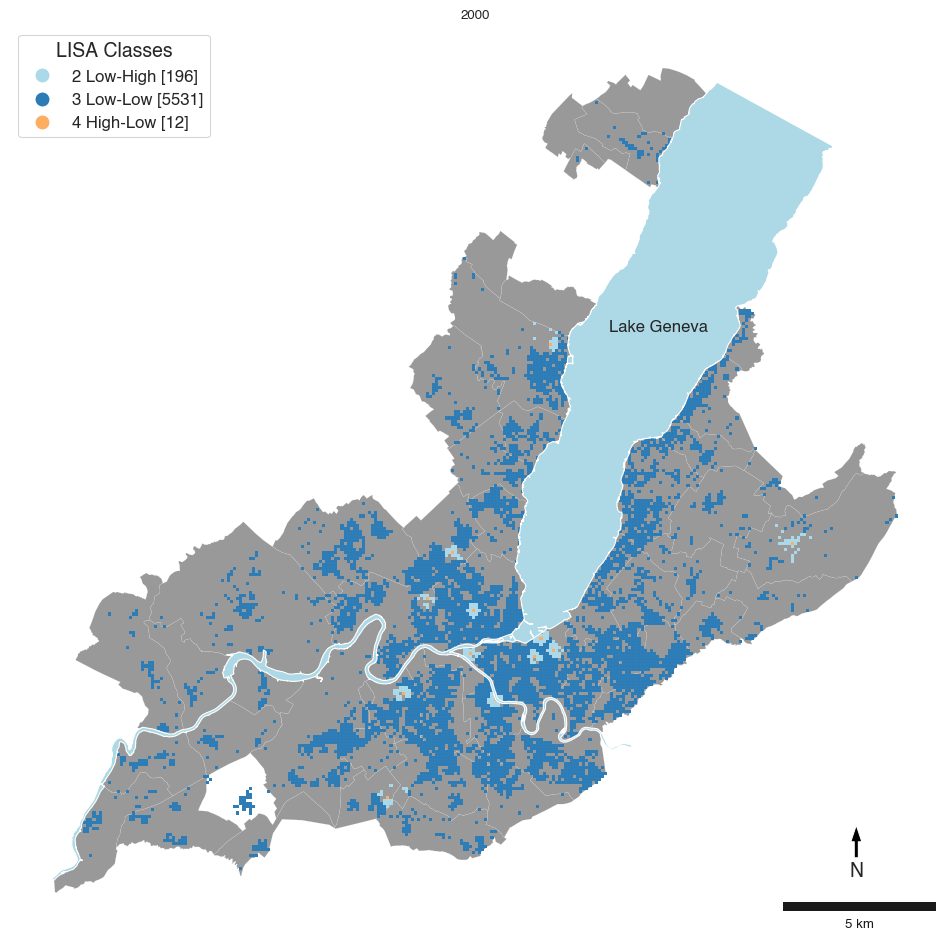

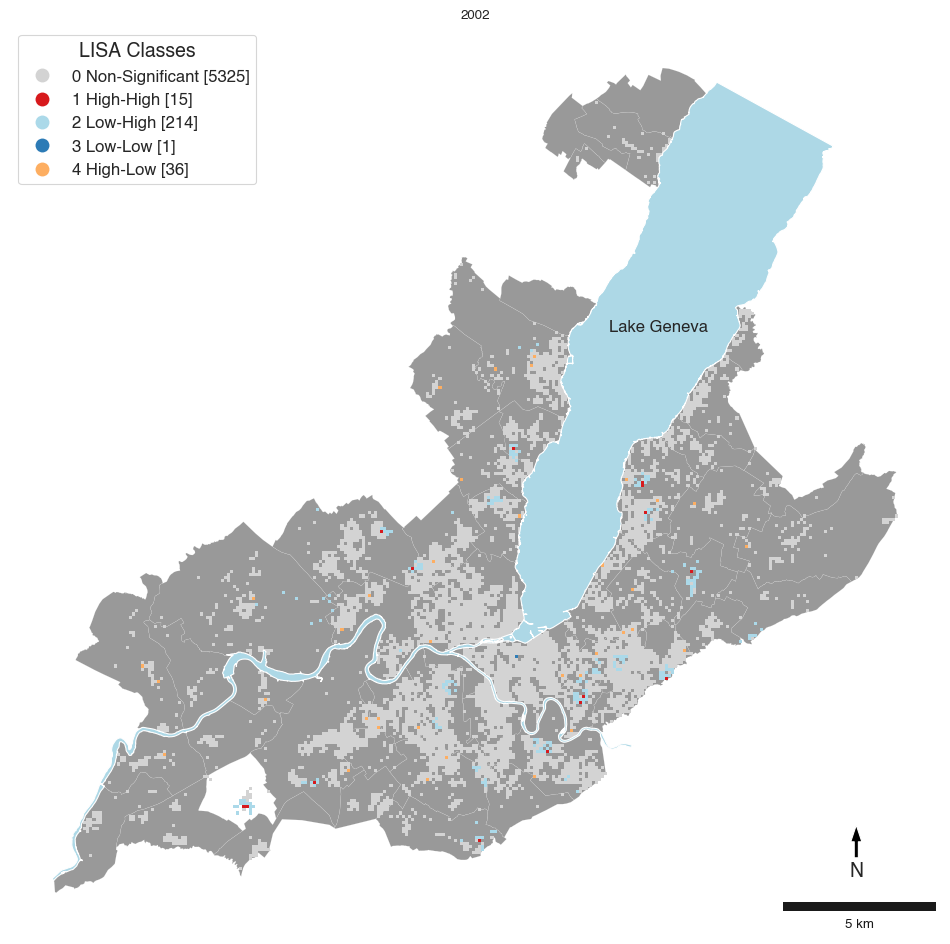

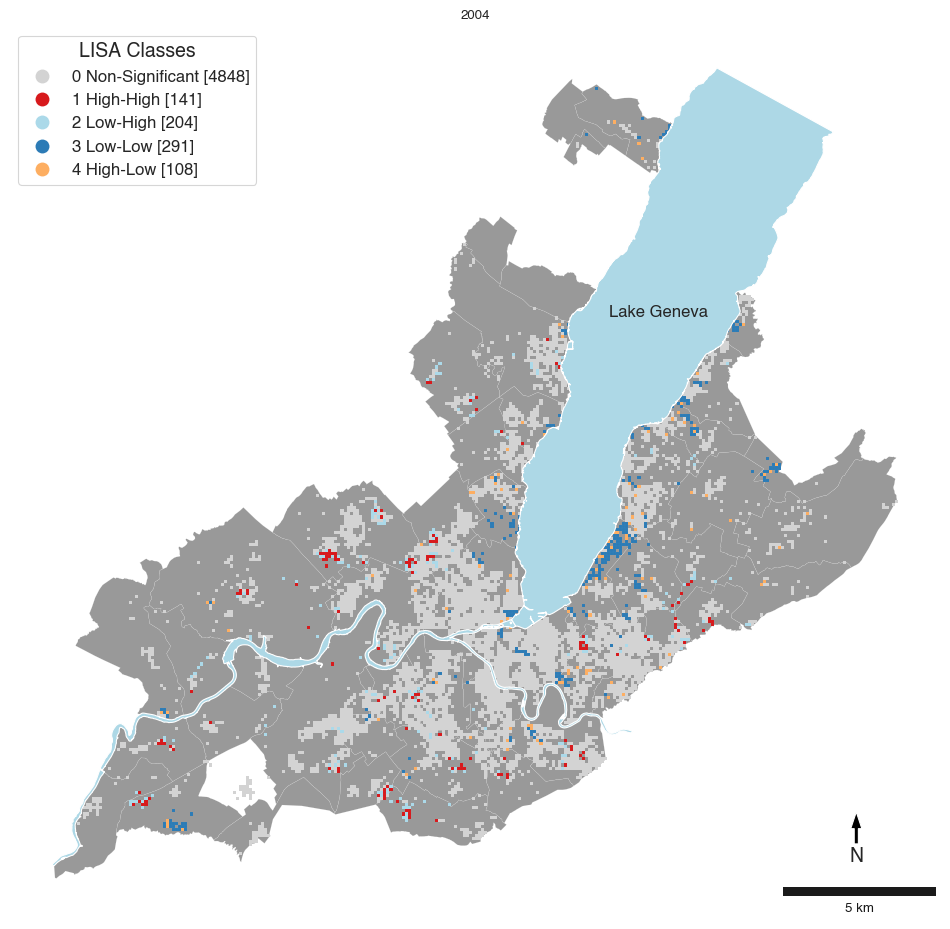

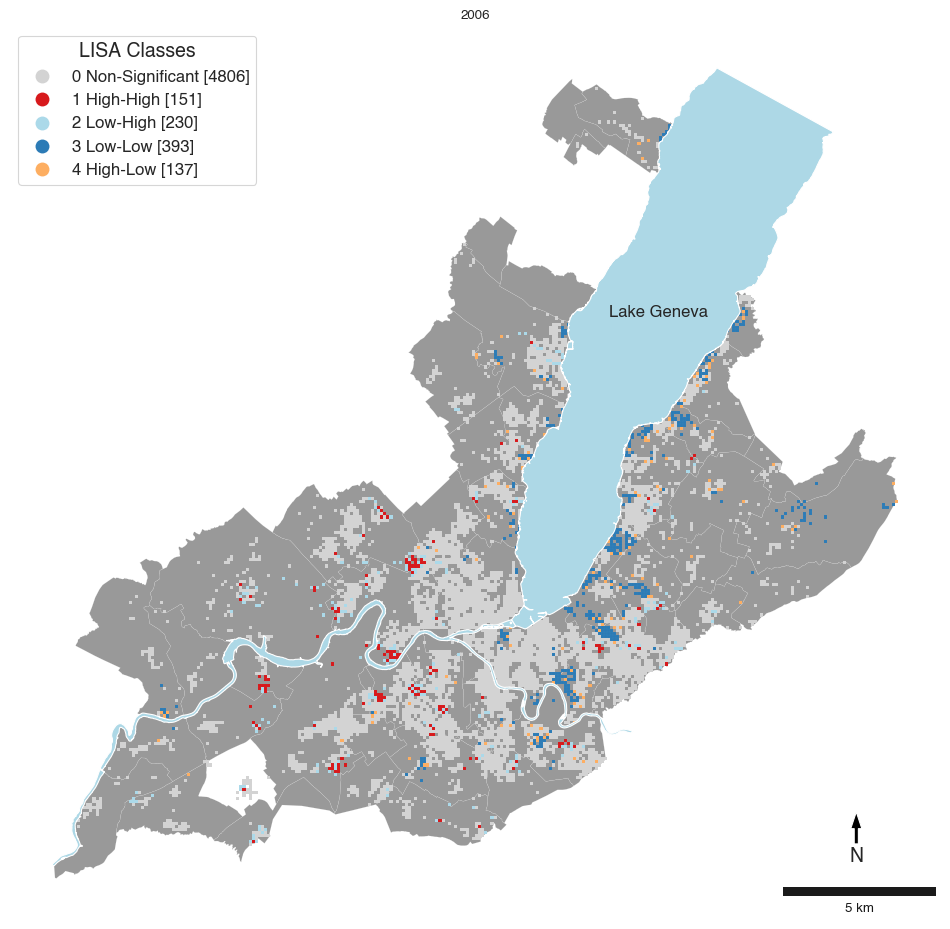

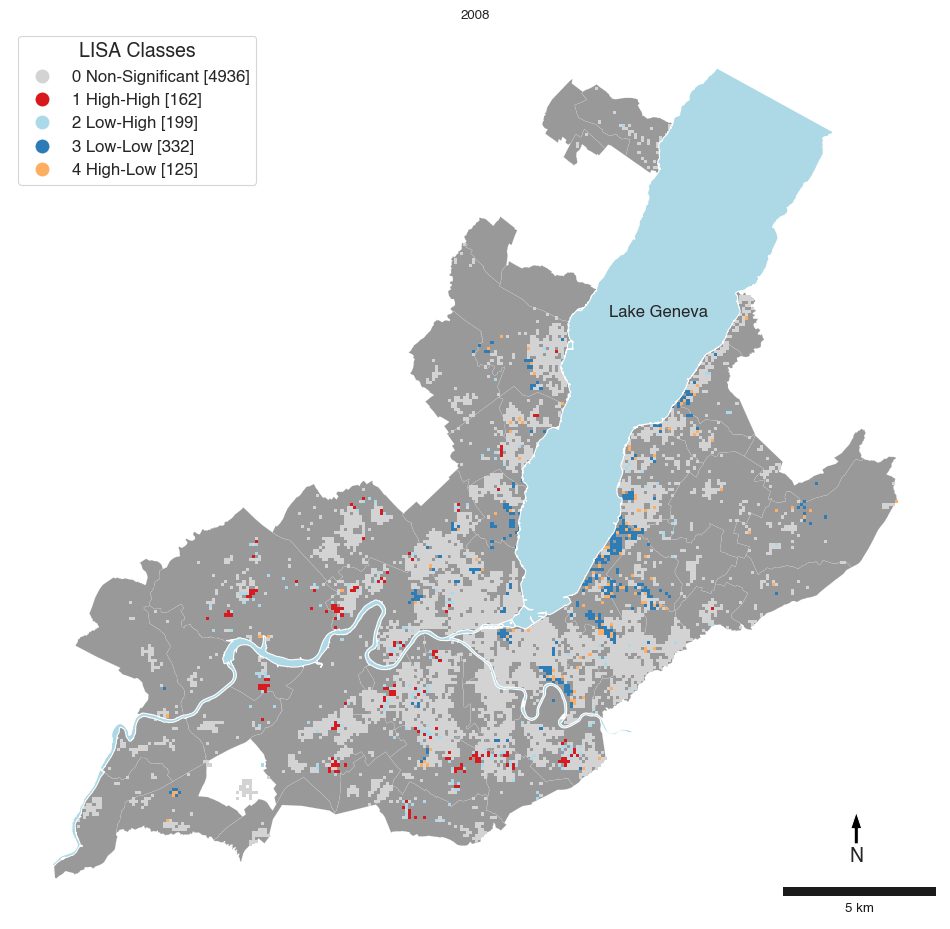

...

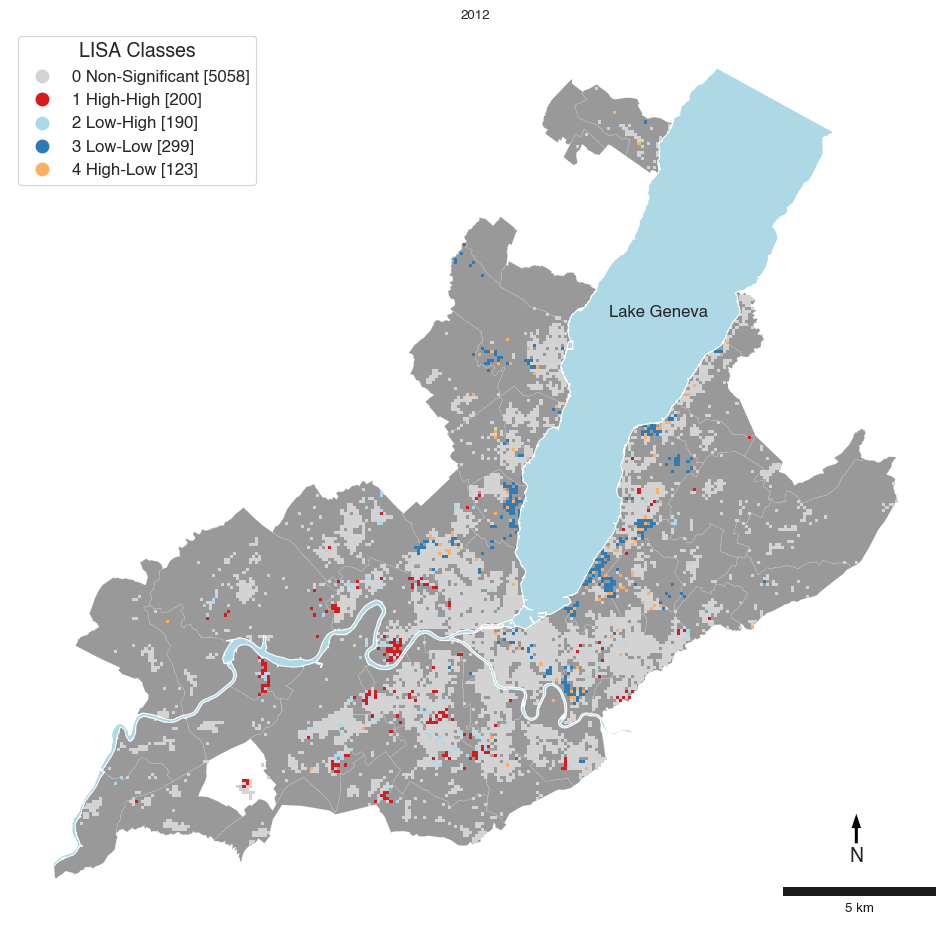

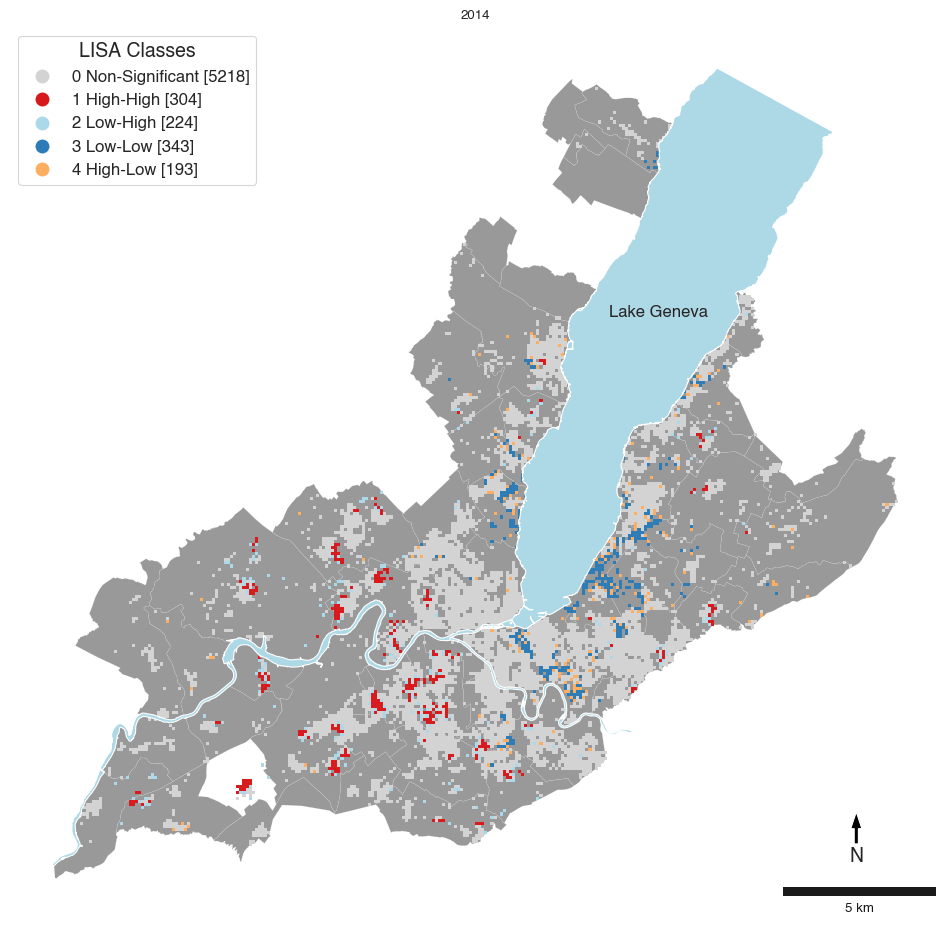

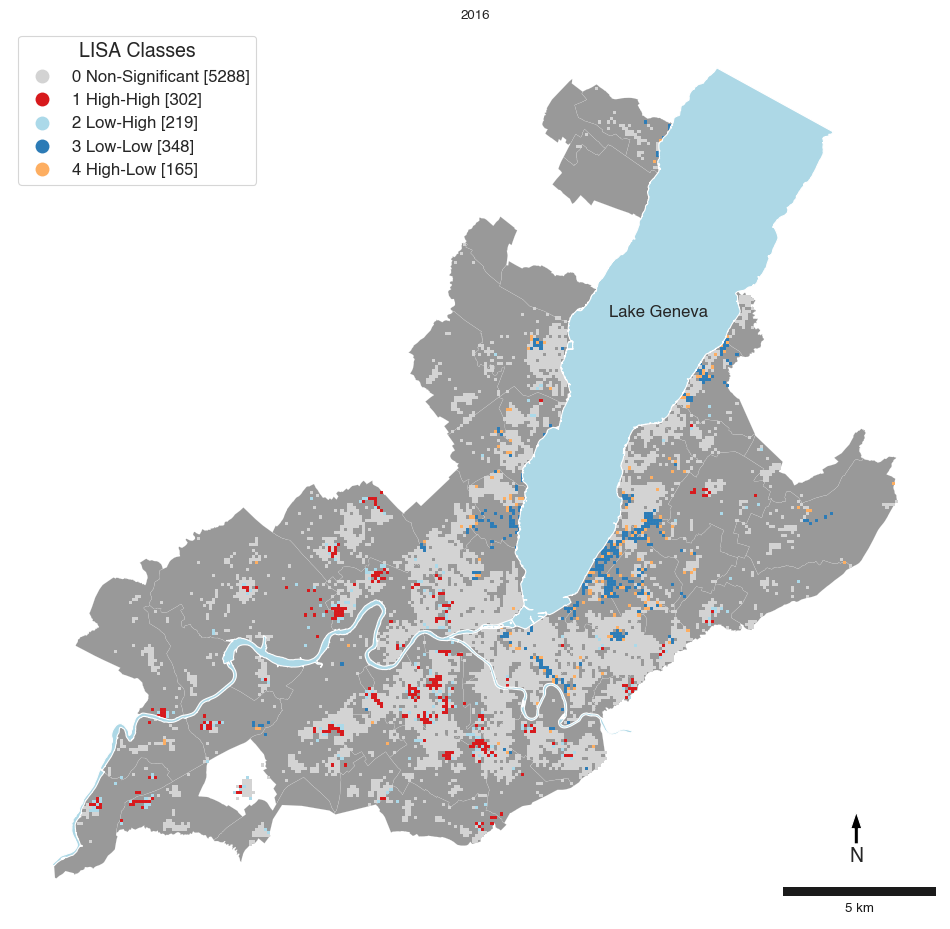

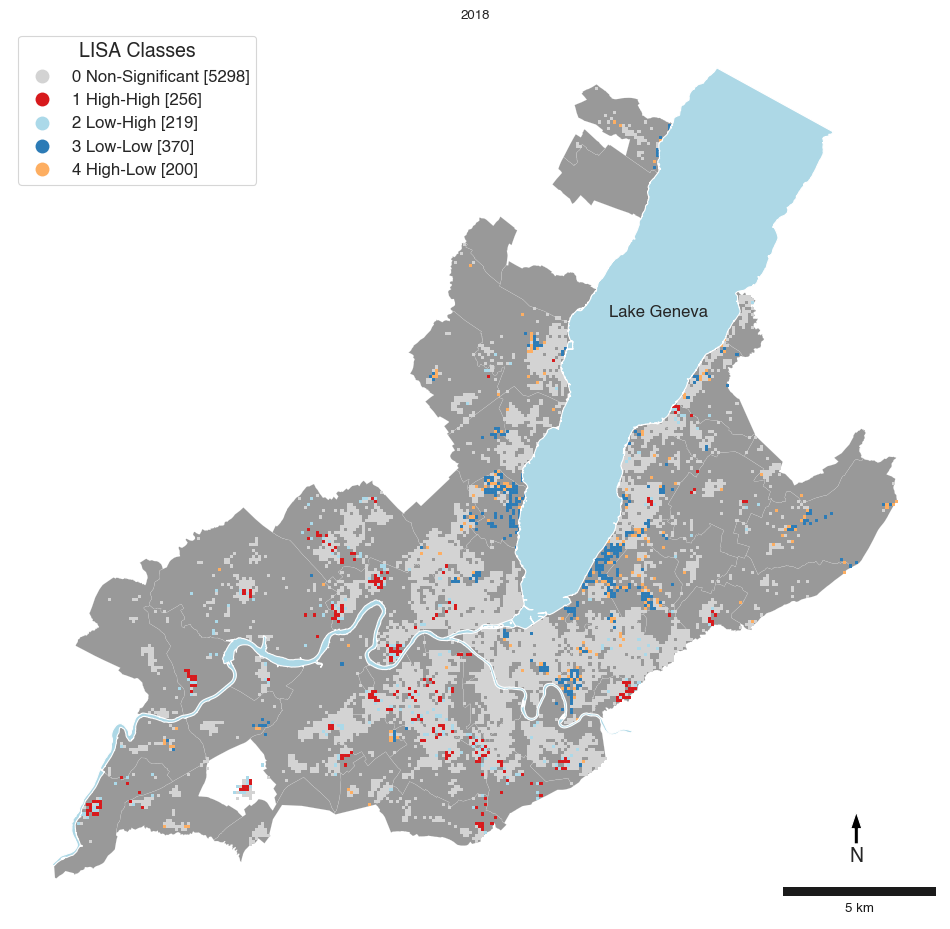

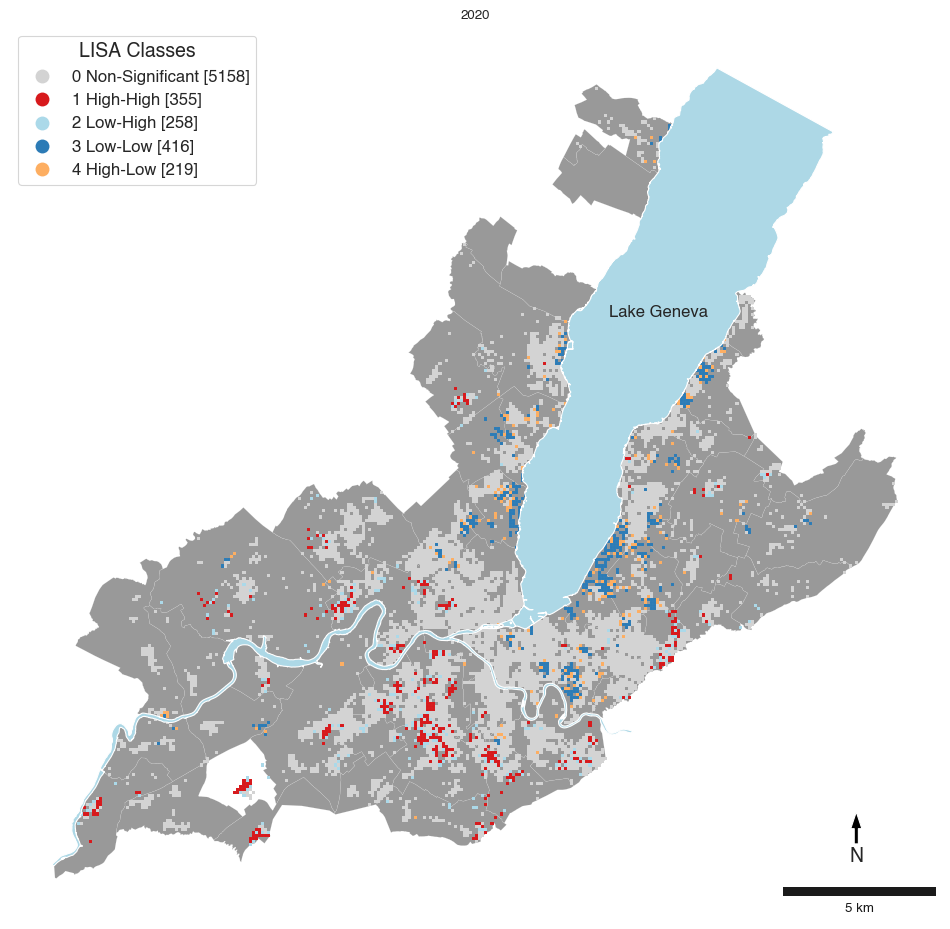

In [57]:
year = 2000
for df_year in dfs_year:
    e, b = f"{year}_mammo", f"{year}_invit"
    wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_year.geometry.centroid)),16)
#     lisawnn16 = pyspace.compute_lisa_rate(df_year,col='lisa_rate', e=df_year[e], b=df_year[b], w=wnn16, adjusted=True, transformation='b', n_perm=999, p_value=0.05)
    lisawnn16 = pyspace.compute_lisa(df_year,col='tx_screening', w=wnn16, transformation='B', n_perm=9999, p_value=0.05)
    fdr_pvalue = fdr(lisawnn16.p_sim, 0.05)
    df_year['tx_screening_cl_fdr'] = df_year['tx_screening_cl']  
    df_year.loc[df_year['tx_screening_psim'] >= fdr_pvalue, 'tx_screening_cl_fdr'] = '0 Non-Significant'
    fig, ax = pyspace.plotLISAMap_polygons(df_year,'tx_screening_cl','')
    ax.set_title(year)
    filename = 'raw_rate_giracs_ha_wnn16_005_%s.png' % (str(year))
    plt.savefig(figures_folder/filename,dpi = 300, bbox_inches = 'tight')
    year+=2

(<Figure size 800x800 with 1 Axes>,
 <Axes: xlabel='Classes LISA', ylabel='Participation rates (%)'>)

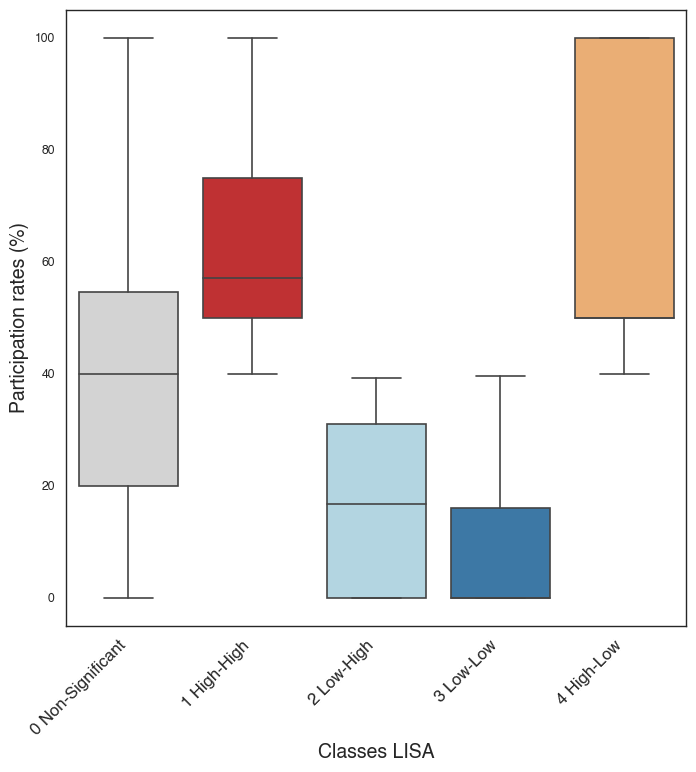

In [58]:
pyspace.plot_lisa_by_class(df_year,'tx_screening_cl','tx_screening','Participation rates (%)' )

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


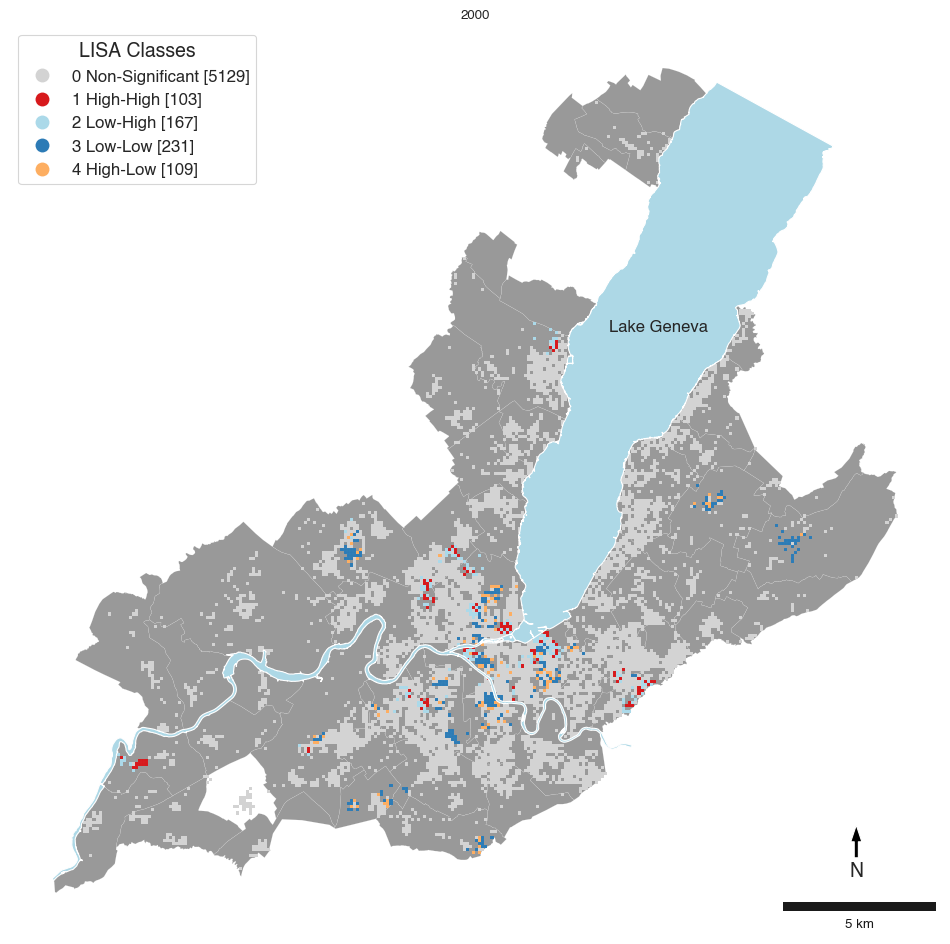

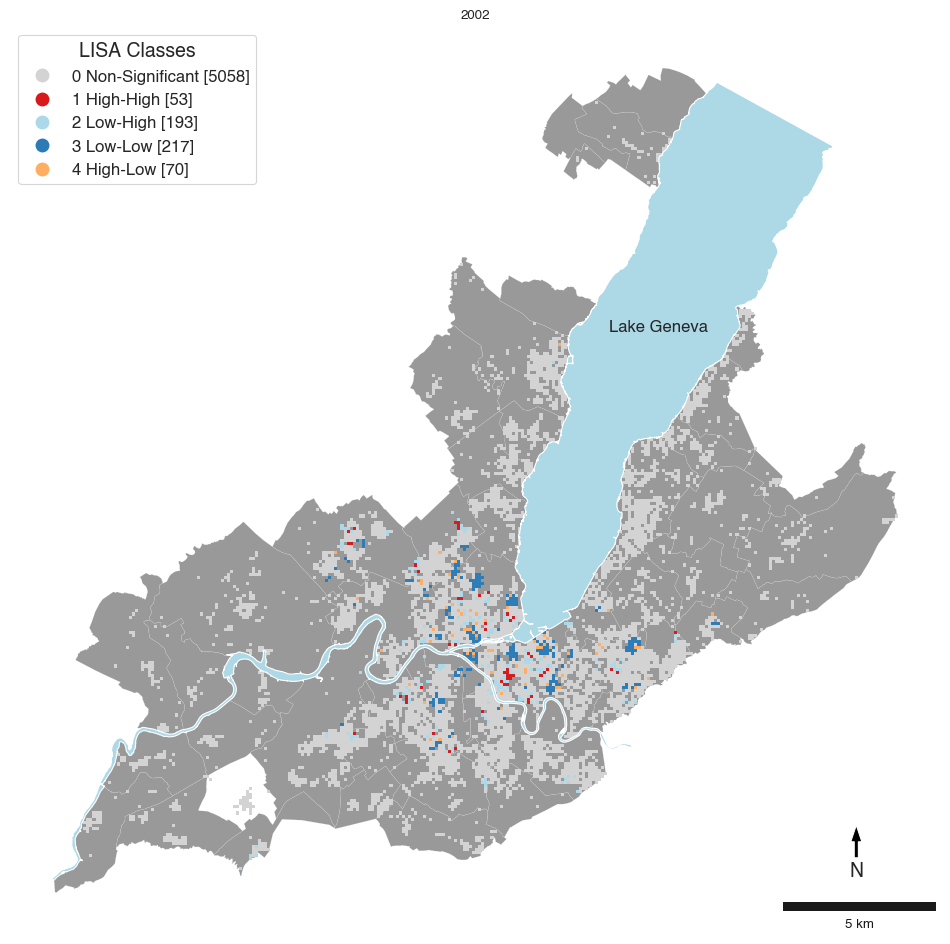

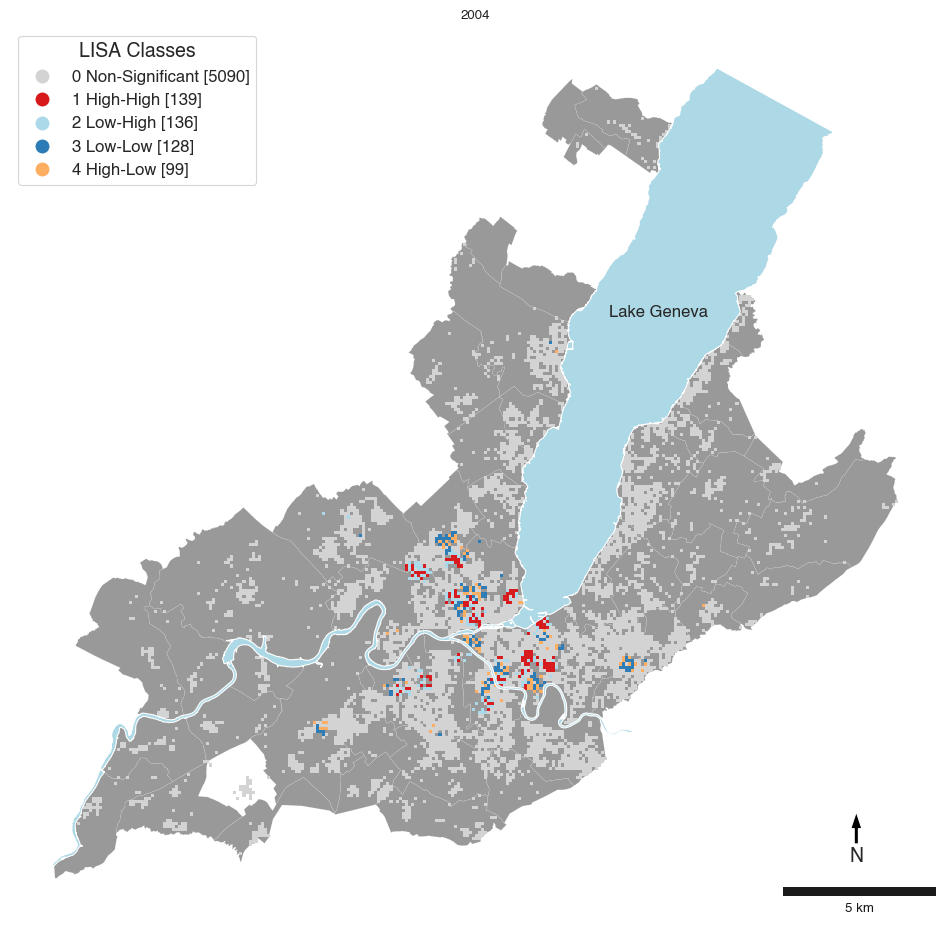

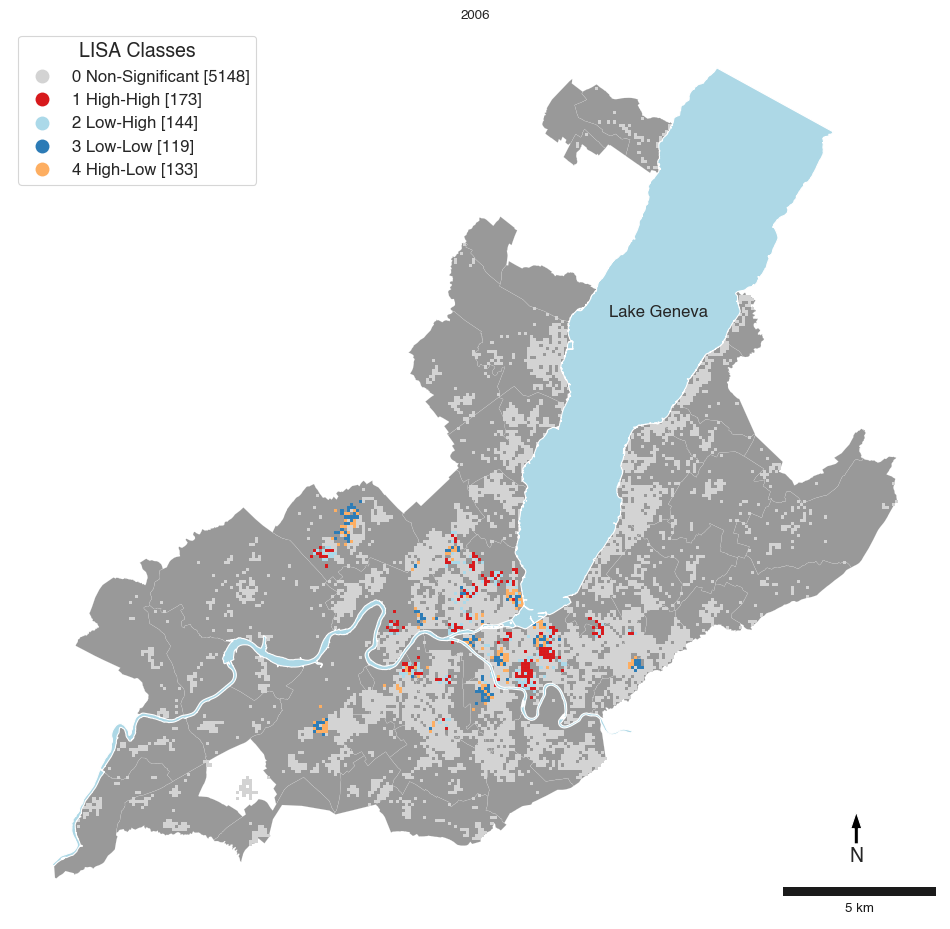

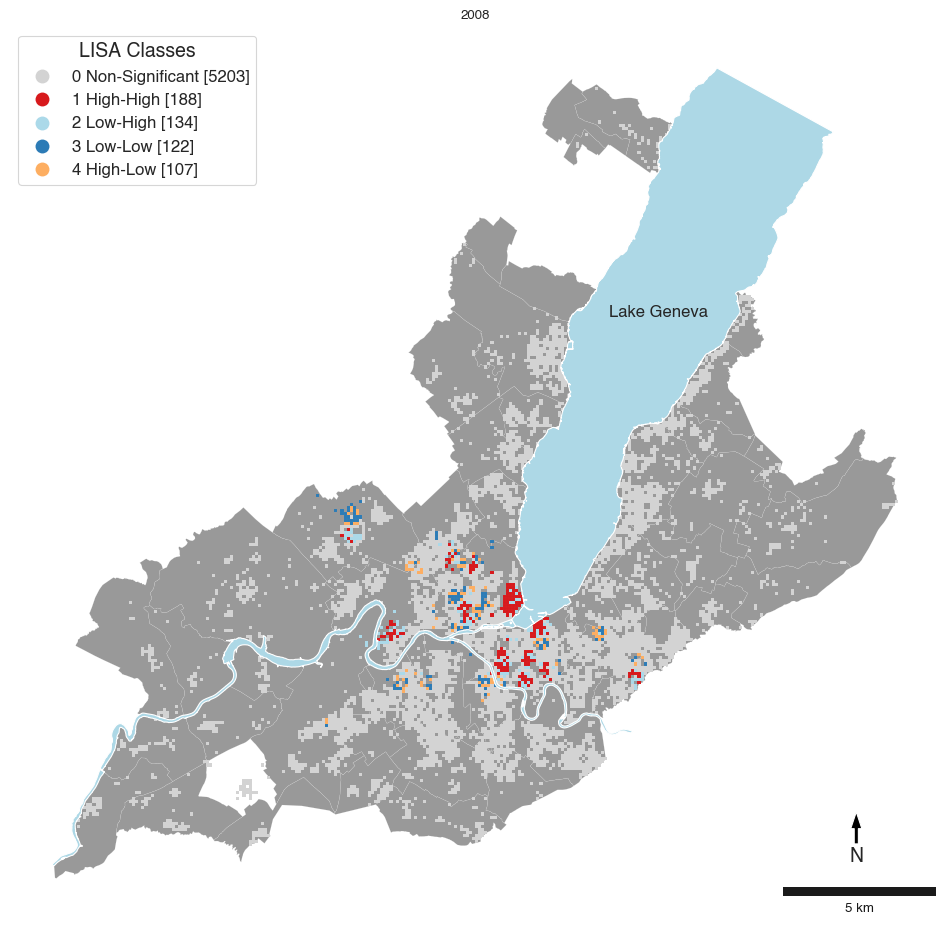

...

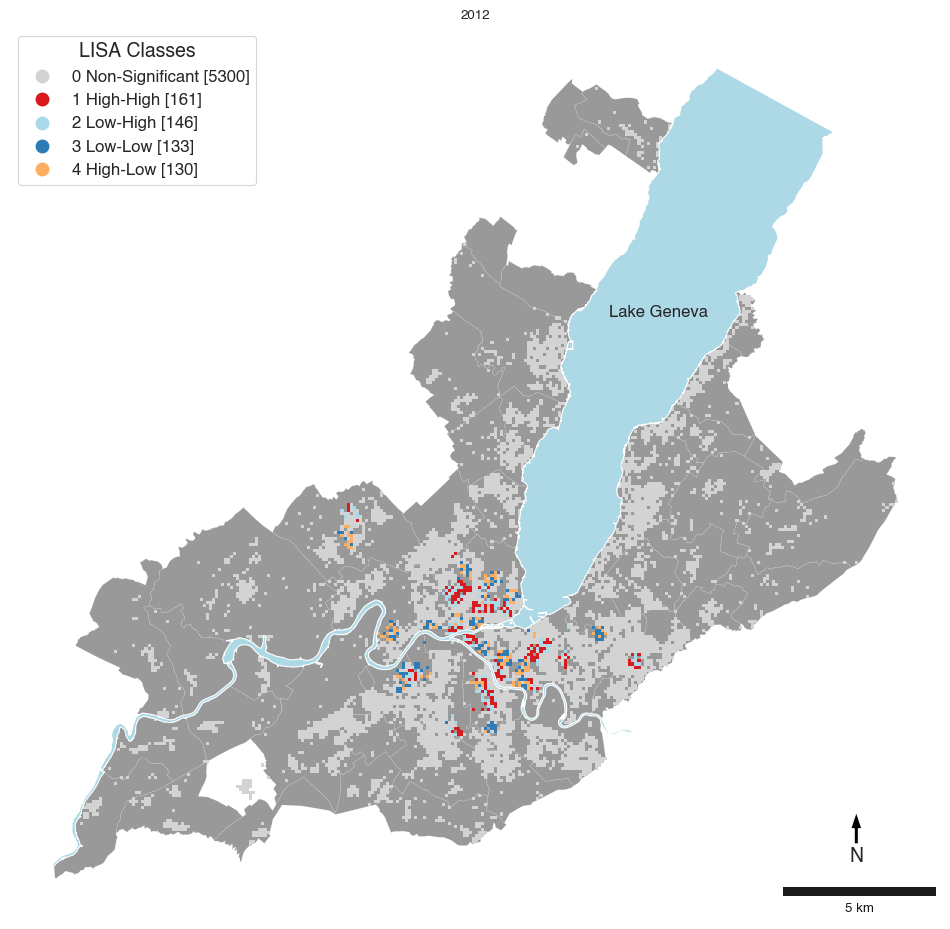

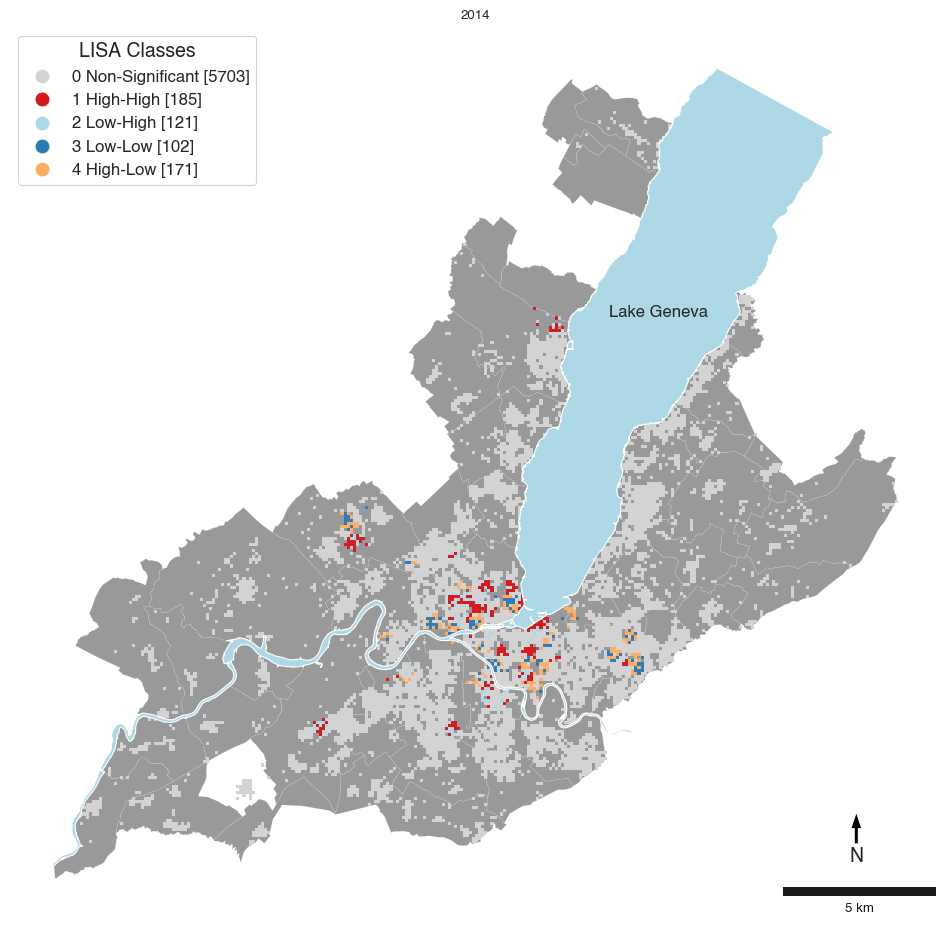

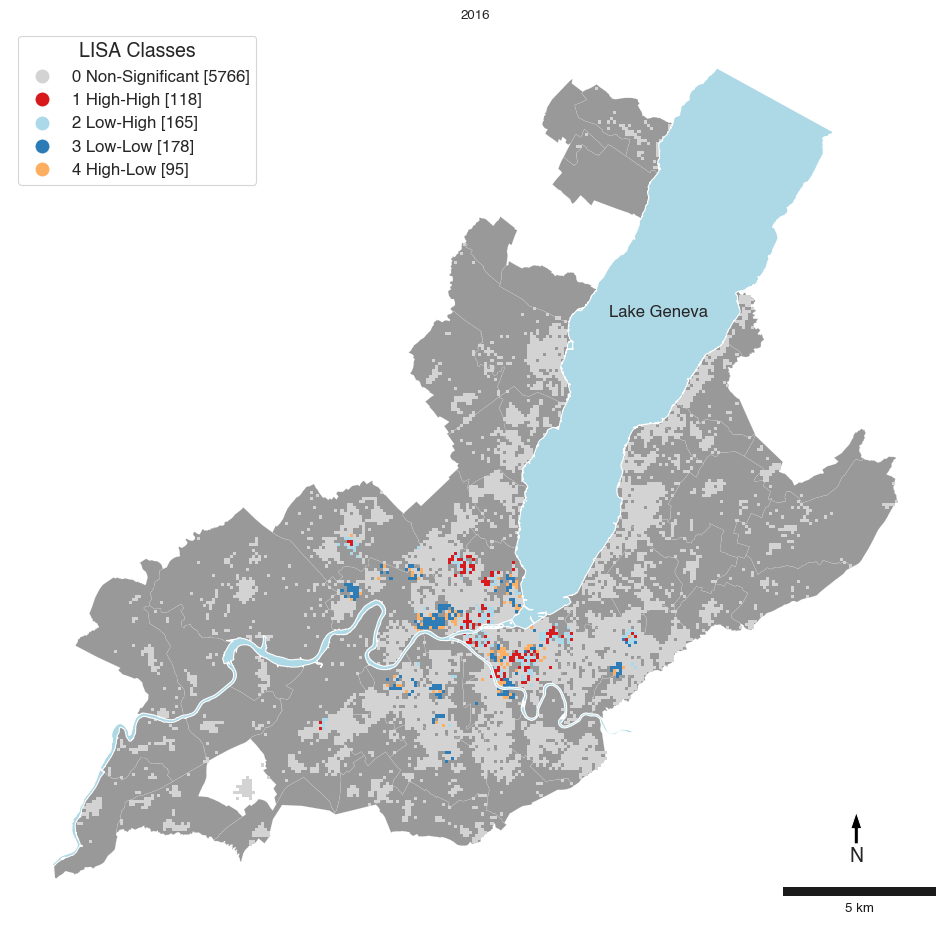

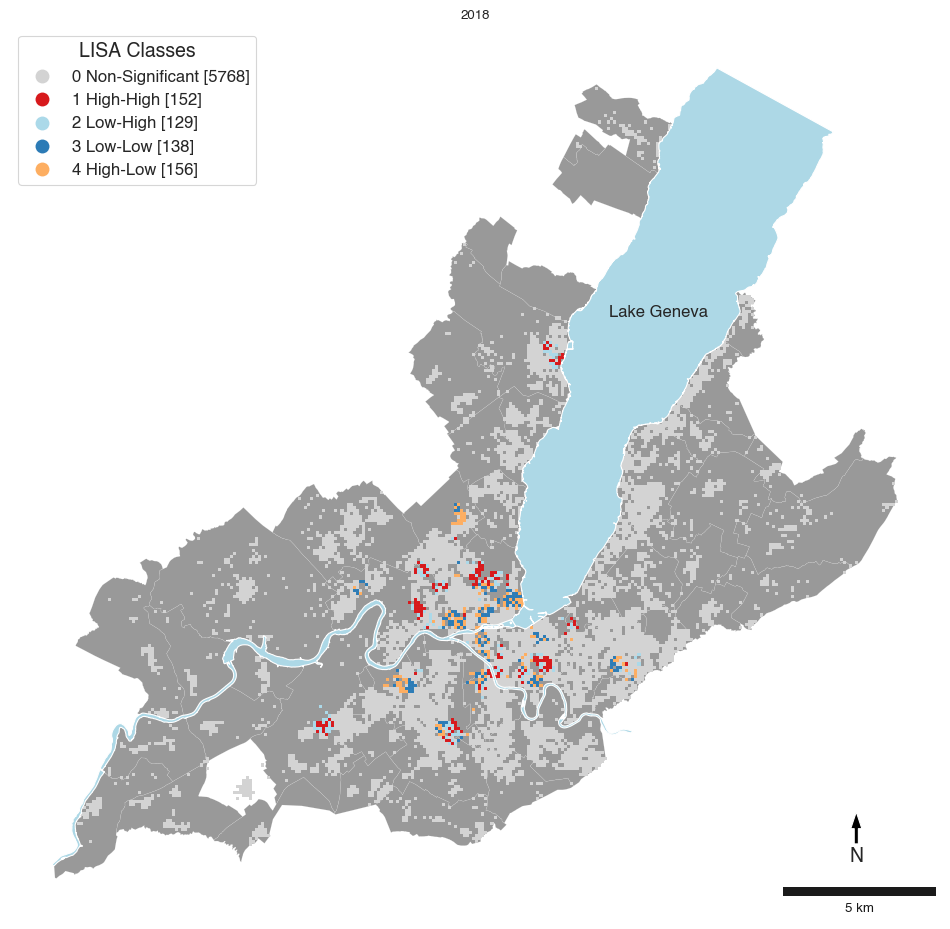

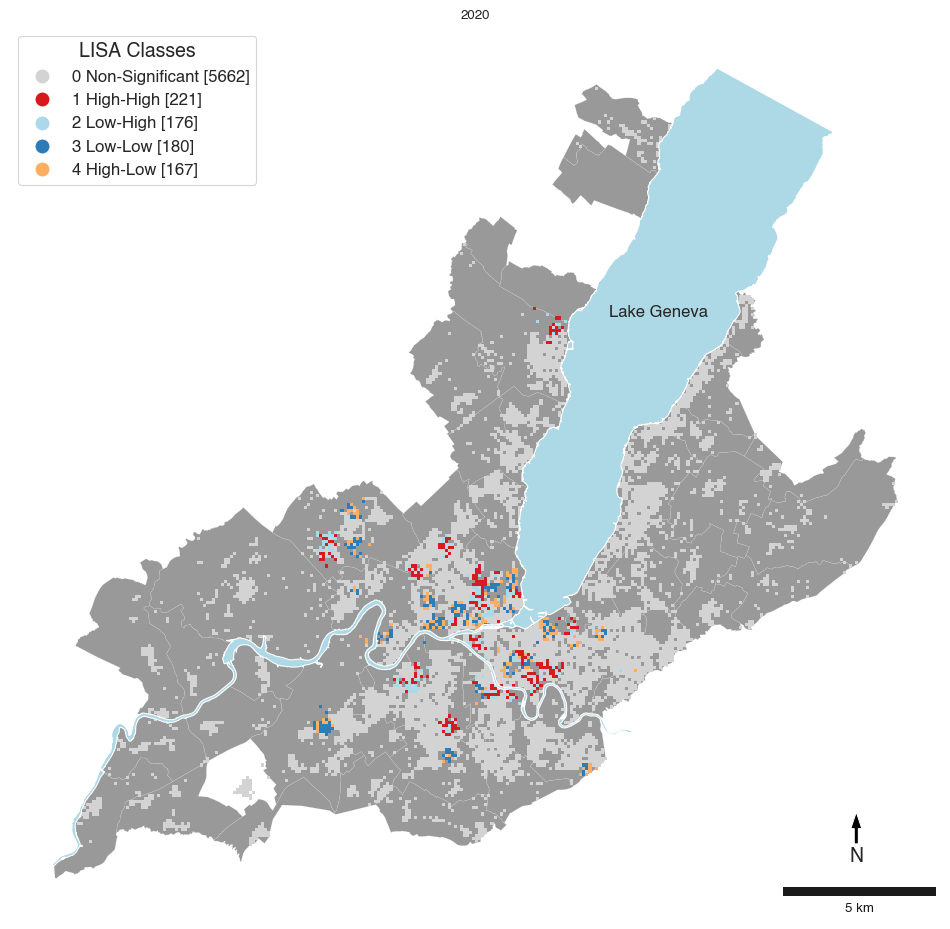

In [59]:
year = 2000
for df_year in dfs_year:
    e, b = f"{year}_mammo", f"{year}_invit"
    wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_year.geometry.centroid)),16)
#     lisawnn16 = pyspace.compute_lisa_rate(df_year,col='lisa_rate', e=df_year[e], b=df_year[b], w=wnn16, adjusted=True, transformation='b', n_perm=999, p_value=0.05)
    lisawnn16 = pyspace.compute_lisa(df_year,col='eb_rate', w=wnn16, transformation='B', n_perm=9999, p_value=0.05)
    fdr_pvalue = fdr(lisawnn16.p_sim, 0.05)
    df_year['eb_rate_cl_fdr'] = df_year['eb_rate_cl']  
    df_year.loc[df_year['eb_rate_psim'] >= fdr_pvalue, 'eb_rate_cl_fdr'] = '0 Non-Significant'
    fig, ax = pyspace.plotLISAMap_polygons(df_year,'eb_rate_cl','')
    ax.set_title(year)
    filename = 'eb_giracs_ha_wnn16_005_%s.png' % (str(year))
    plt.savefig(figures_folder/filename,dpi = 300, bbox_inches = 'tight')
    year+=2

(<Figure size 800x800 with 1 Axes>,
 <Axes: xlabel='Classes LISA', ylabel='EBS Participation rates (%)'>)

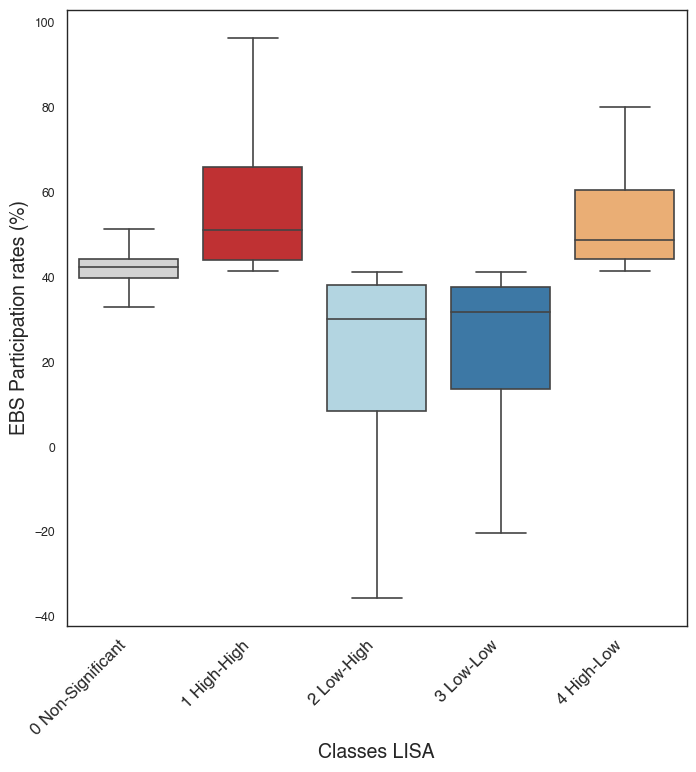

In [60]:
pyspace.plot_lisa_by_class(df_year,'eb_rate_cl','eb_rate','EBS Participation rates (%)' )

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



******************************  Done  ******************************


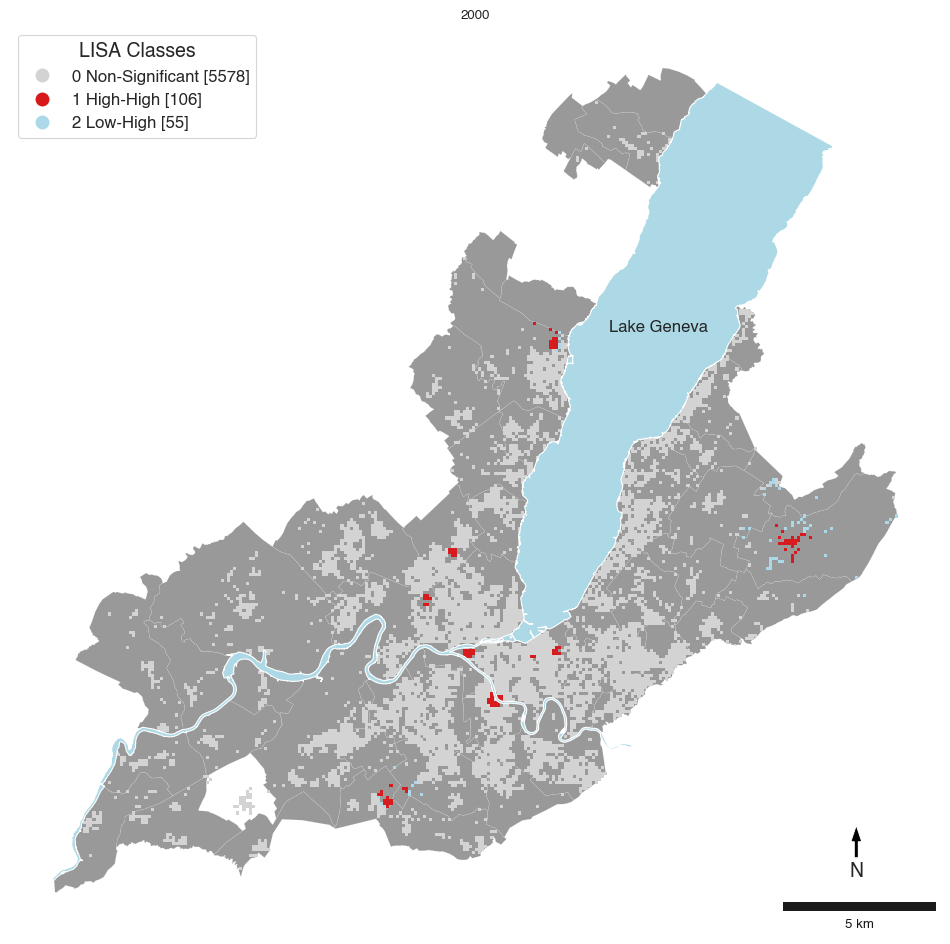

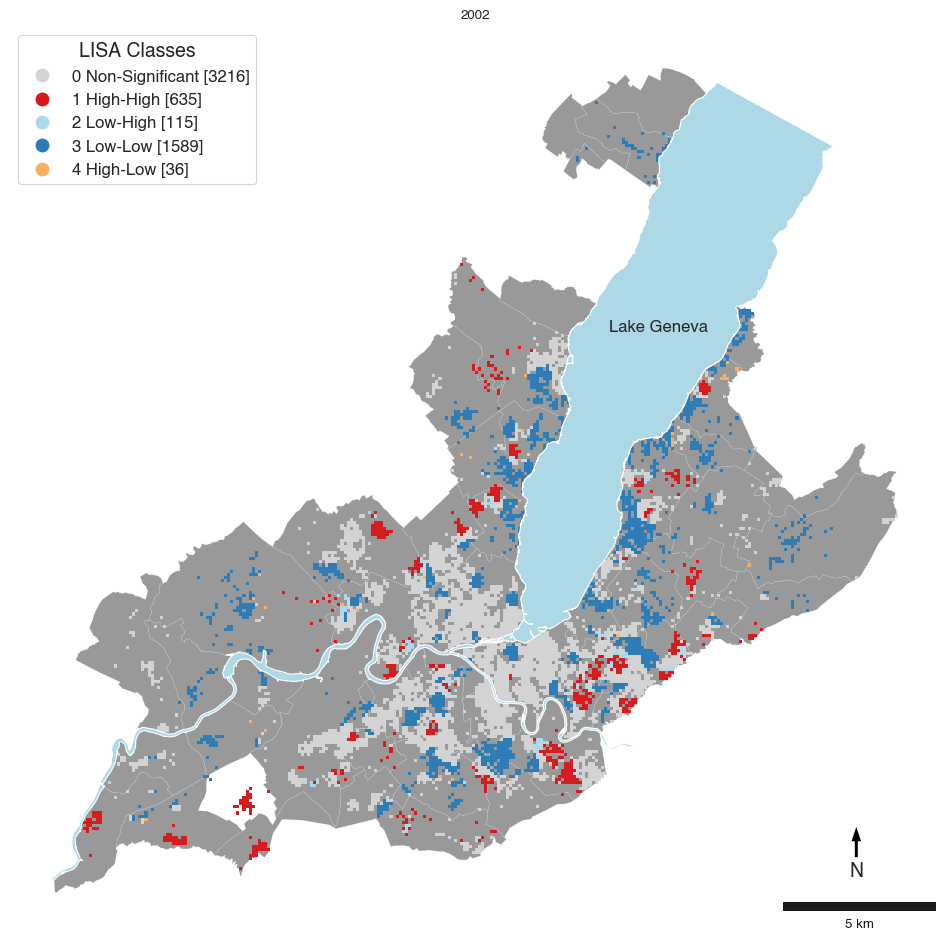

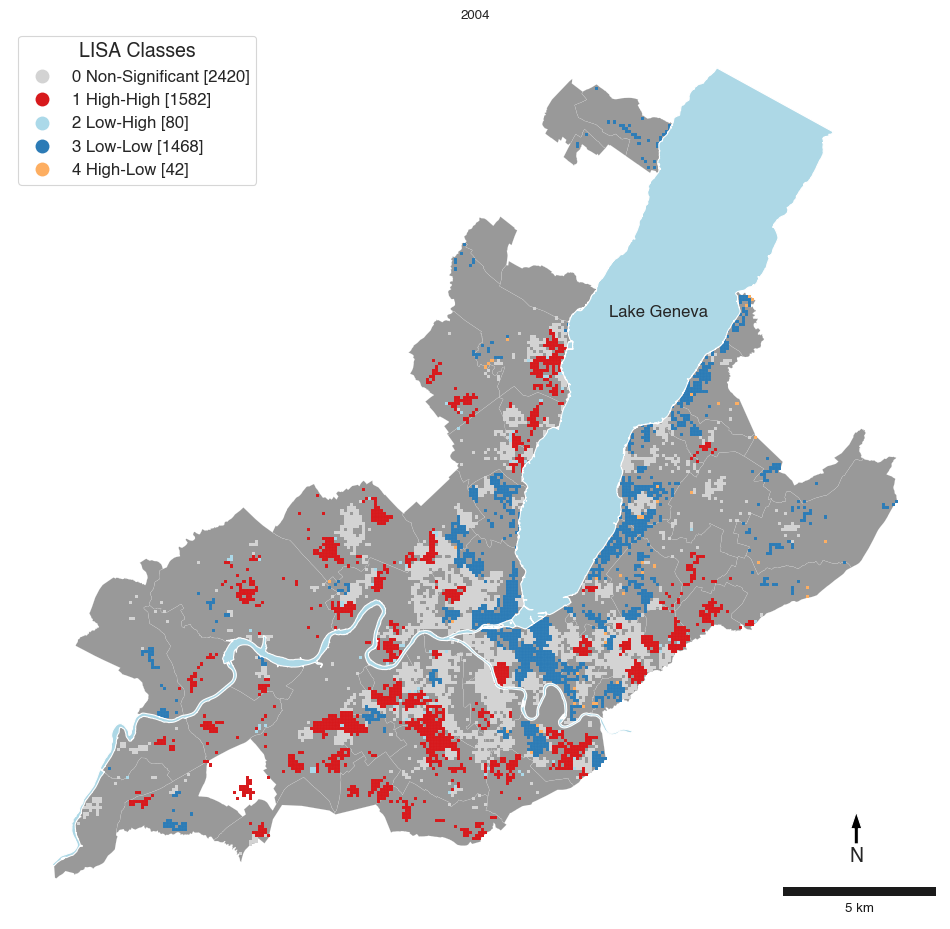

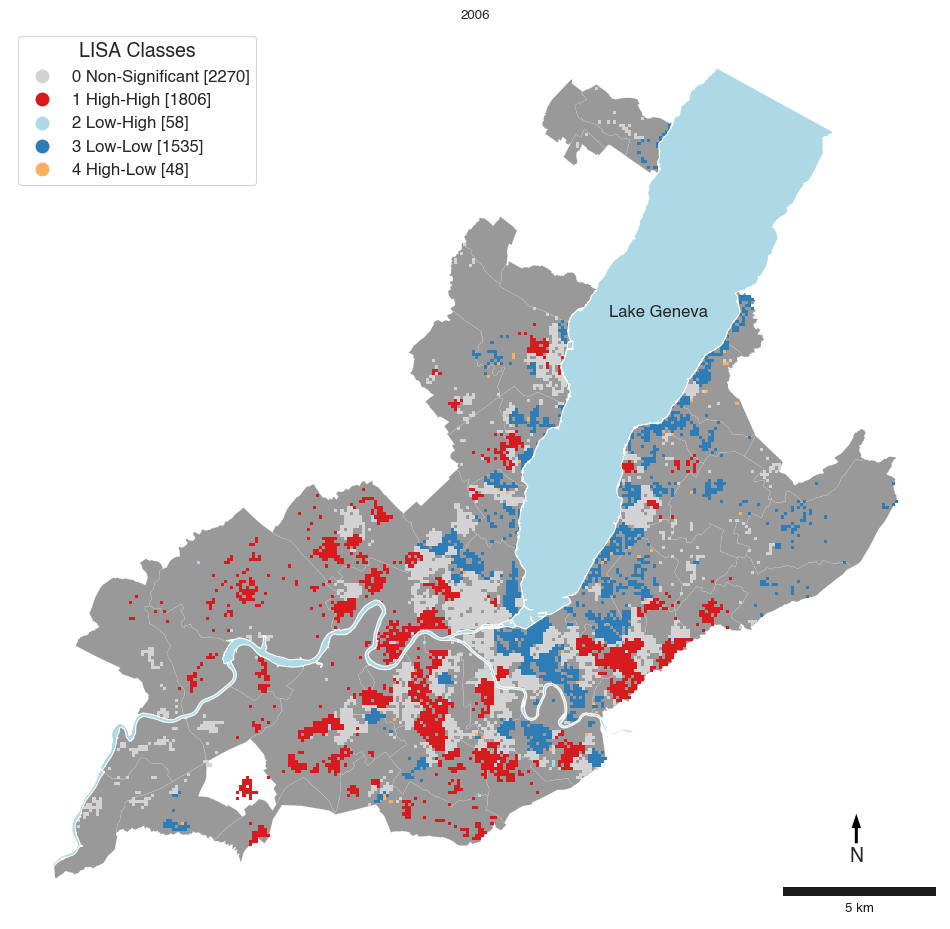

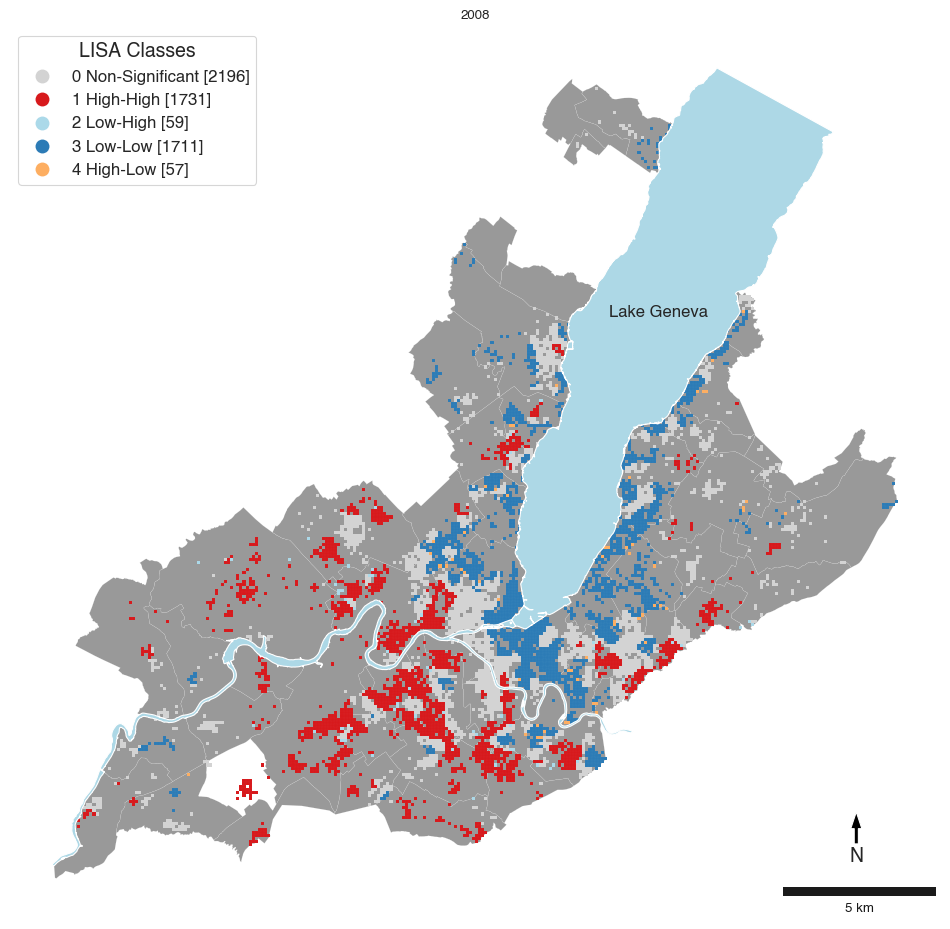

...

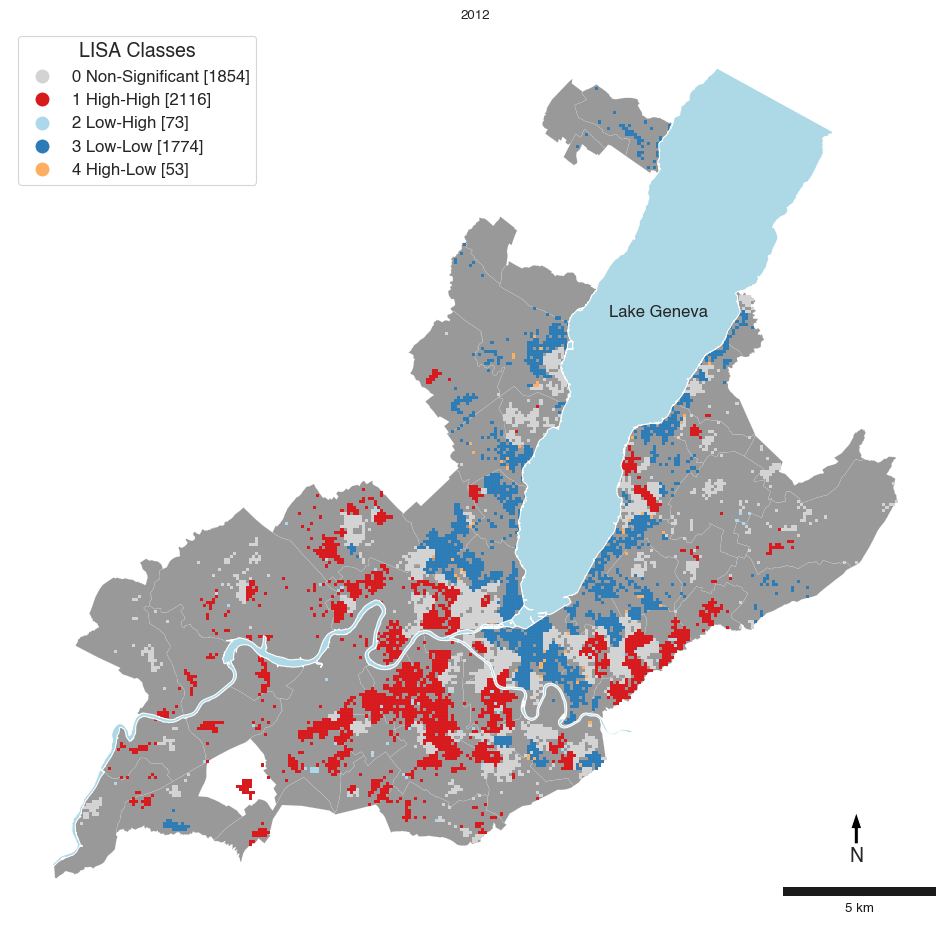

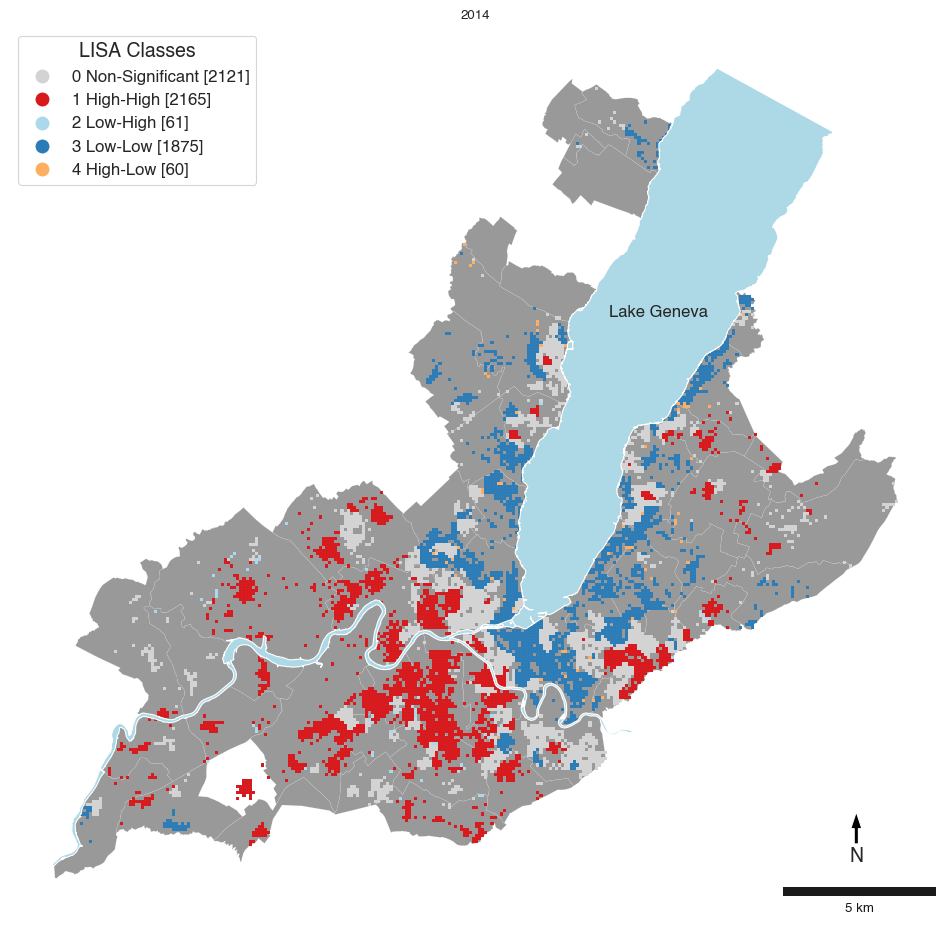

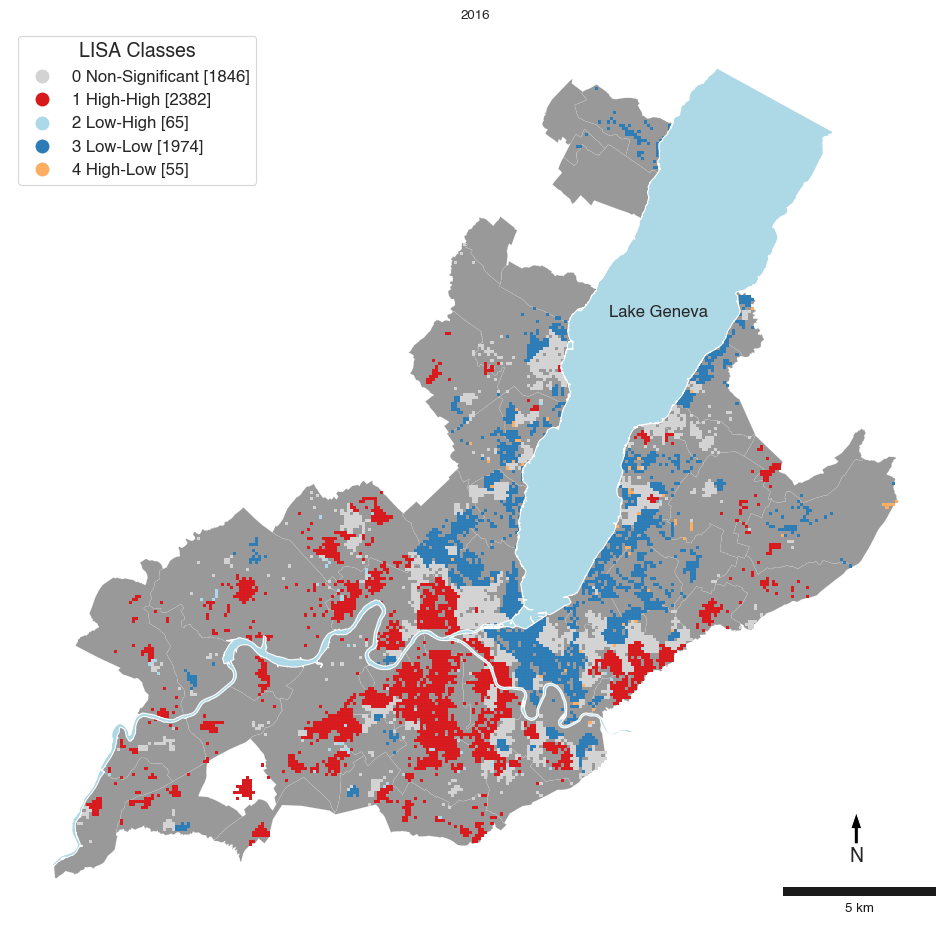

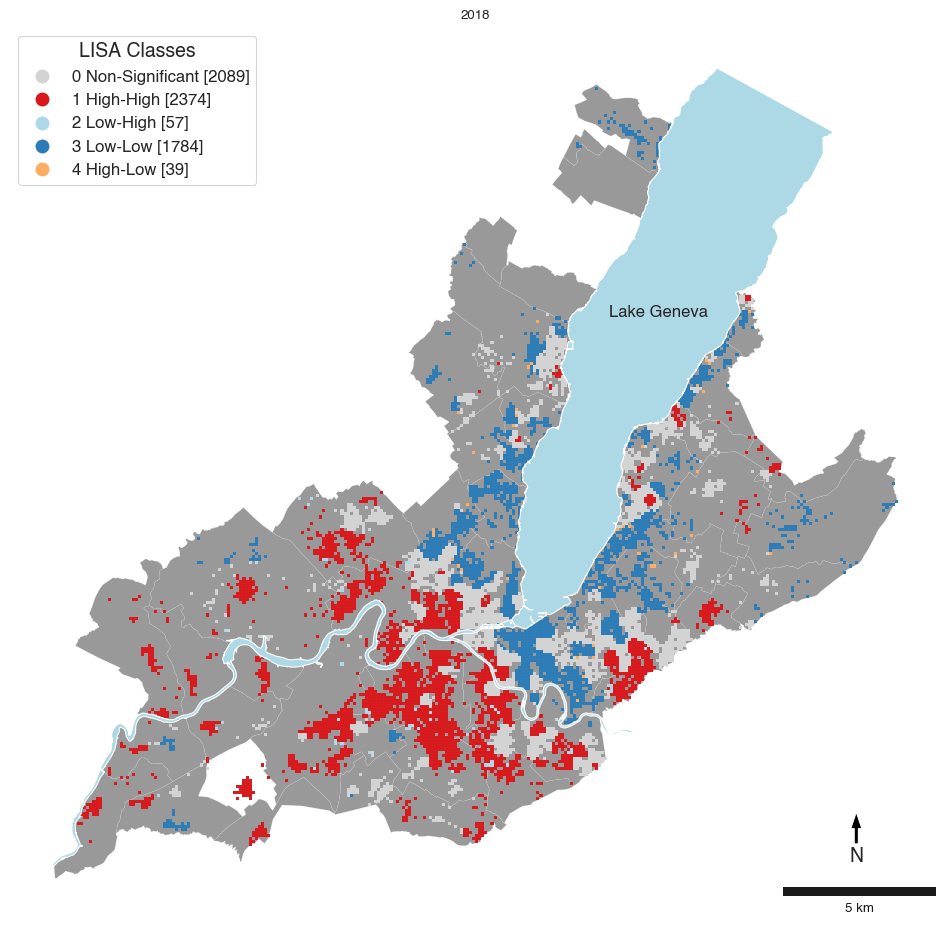

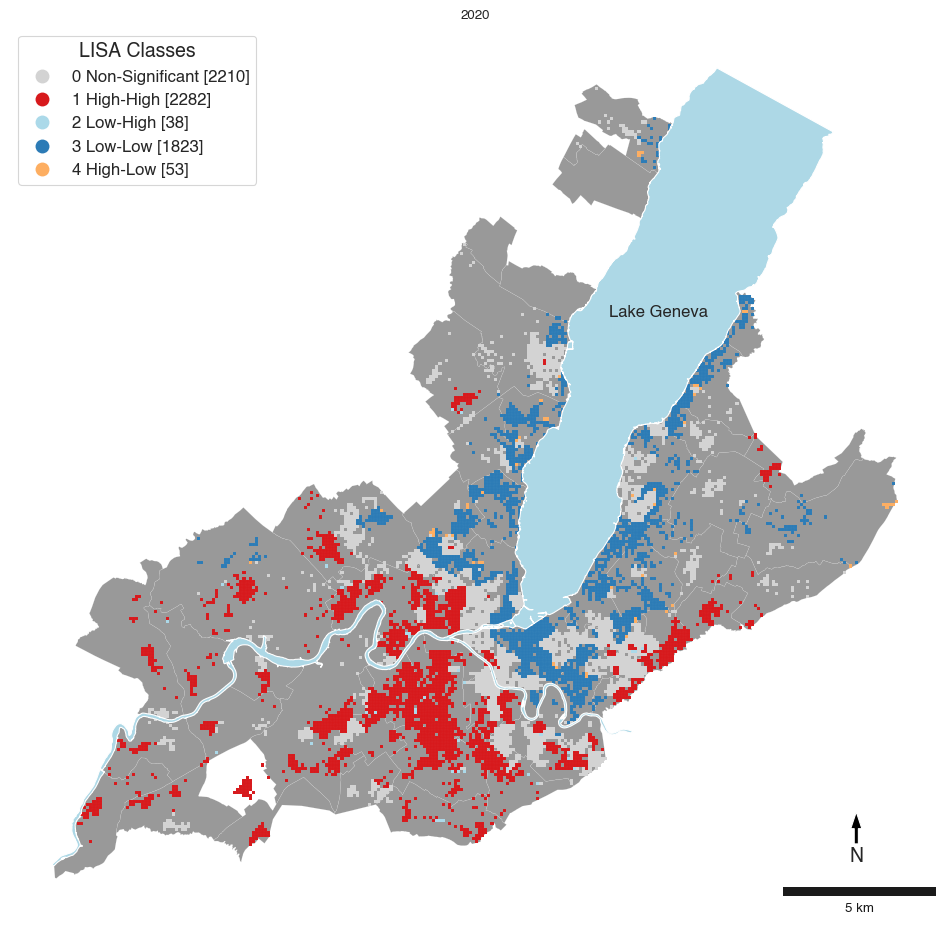

In [61]:
year = 2000
for df_year in dfs_year:
    e, b = f"{year}_mammo", f"{year}_invit"
    wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_year.geometry.centroid)),16)
#     lisawnn16 = pyspace.compute_lisa_rate(df_year,col='lisa_rate', e=df_year[e], b=df_year[b], w=wnn16, adjusted=True, transformation='b', n_perm=999, p_value=0.05)
    lisawnn16 = pyspace.compute_lisa(df_year,col='ebs_rate', w=wnn16, transformation='B', n_perm=9999, p_value=0.05)
    fdr_pvalue = fdr(lisawnn16.p_sim, 0.05)
    df_year['ebs_rate_cl_fdr'] = df_year['ebs_rate_cl']  
    df_year.loc[df_year['ebs_rate_psim'] >= fdr_pvalue, 'ebs_rate_cl_fdr'] = '0 Non-Significant'
    fig, ax = pyspace.plotLISAMap_polygons(df_year,'ebs_rate_cl','')
    ax.set_title(year)
    filename = 'ebs_giracs_ha_wnn16_005_%s.png' % (str(year))
    plt.savefig(figures_folder/filename,dpi = 300, bbox_inches = 'tight')
    year+=2

(<Figure size 800x800 with 1 Axes>,
 <Axes: xlabel='Classes LISA', ylabel='SEBS Participation rates (%)'>)

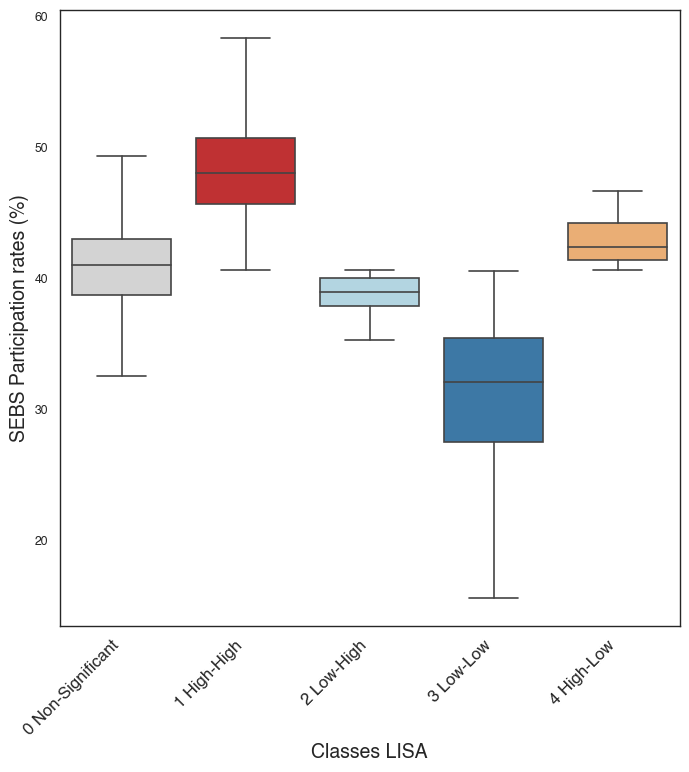

In [62]:
pyspace.plot_lisa_by_class(df_year,'ebs_rate_cl','ebs_rate','SEBS Participation rates (%)' )

## Getis analysis

In [63]:
colors_getis = ['#1c4978', '#2166ac', '#67a9cf', '#d1e5f0', '#991d2c', '#b2182b', '#ef8a62', '#fddbc7', '#f7f7f7']

### Specchio data

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 2 disconnected components.



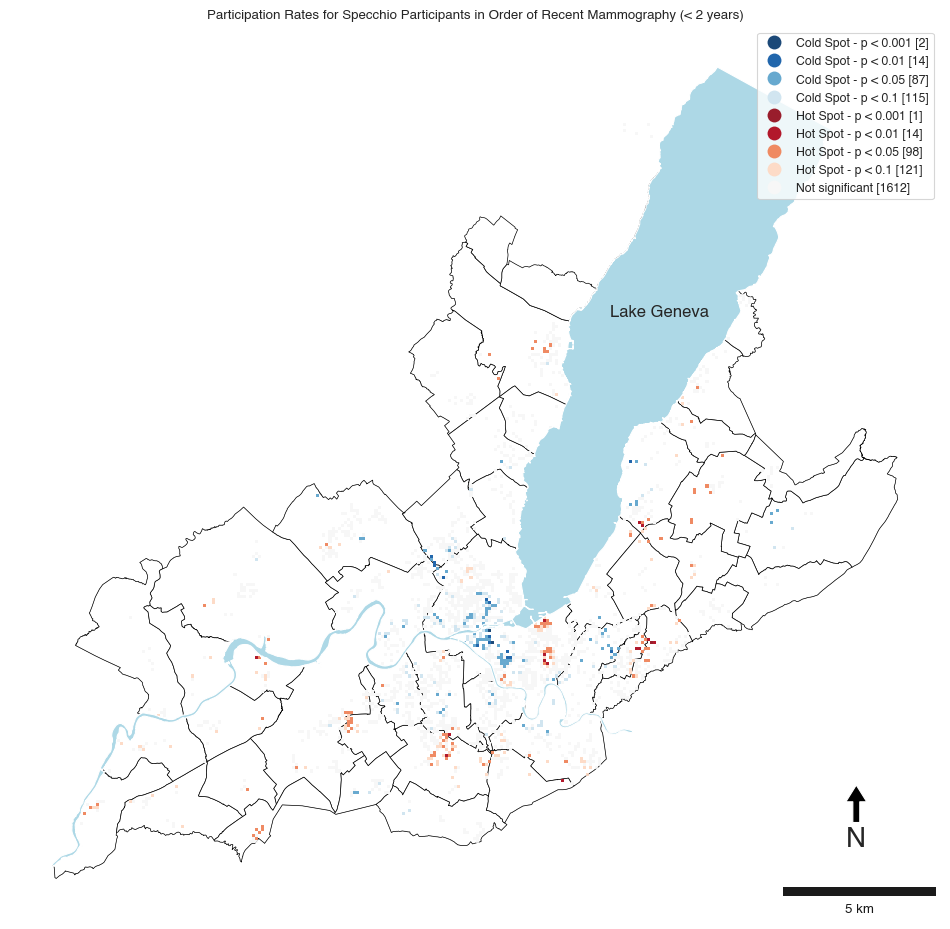

In [64]:
wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_ha_specchio.geometry.centroid)),16)
getiswnn16 = pyspace.compute_getis(df_ha_specchio,'tx_screening',wnn16, 9999, transform_type='B', p_001 = True)
fdr_pvalue = fdr(getiswnn16.p_sim, 0.05)
df_ha_specchio['tx_screening_G_cl_fdr'] = df_ha_specchio['tx_screening_G_cl']  
df_ha_specchio.loc[df_ha_specchio['tx_screening_G_psim'] >= fdr_pvalue, 'tx_screening_G_cl_fdr'] = 'Not significant'
fig, ax = pyspace.plotGetisMap(df_ha_specchio,'tx_screening_G_cl',p_001 = True, commune_name = False)
ax.set_title('Participation Rates for Specchio Participants in Order of Recent Mammography (< 2 years)')
filename = 'getis_specchio_ha_raw_wnn16_005.png'
plt.savefig(figures_folder/filename,dpi = 300, bbox_inches = 'tight')

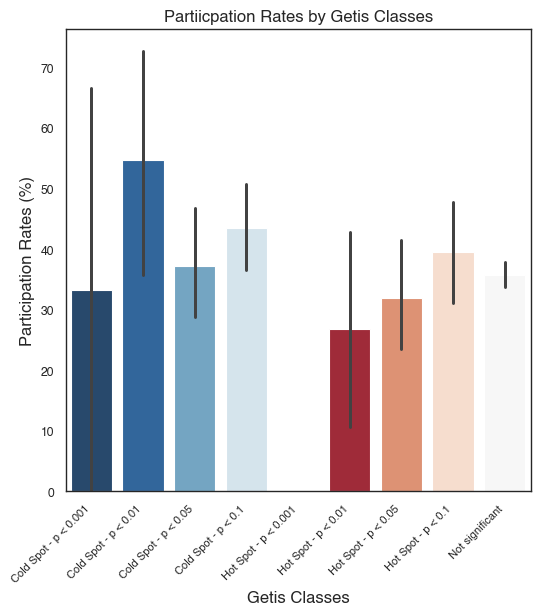

In [65]:
fig, ax = plt.subplots(figsize = (6, 6))
chart = sns.barplot(x = 'tx_screening_G_cl', y = 'tx_screening', data = df_ha_specchio,order=
    ['Cold Spot - p < 0.001','Cold Spot - p < 0.01', 'Cold Spot - p < 0.05', 'Cold Spot - p < 0.1','Hot Spot - p < 0.001', 'Hot Spot - p < 0.01',
     'Hot Spot - p < 0.05', 'Hot Spot - p < 0.1', 'Not significant'],
                        palette=colors_getis,errorbar=('ci', 95),  ax = ax)
chart.set_xlabel('Getis Classes', size=12)
chart.set_ylabel('Participation Rates (%)', size=12)
chart.set_xticklabels(chart.get_xticklabels(), size=8, rotation=45, horizontalalignment='right')

plt.title('Partiicpation Rates by Getis Classes', size = 12)
plt.savefig(figures_folder/'Bar plot - Getis 2020.png', dpi = 300, bbox_inches = 'tight')

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 2 disconnected components.



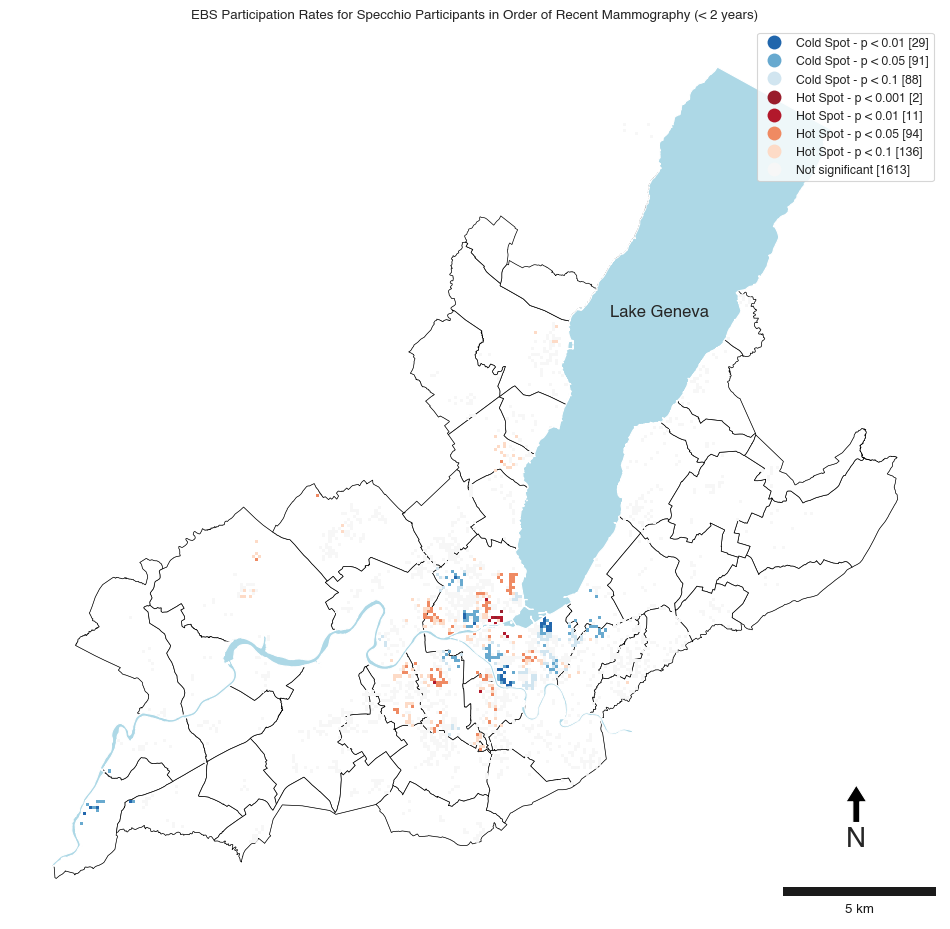

In [66]:
wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_ha_specchio.geometry.centroid)),16)
getiswnn16 = pyspace.compute_getis(df_ha_specchio,'eb_rate',wnn16, 9999, transform_type='B', p_001 = True)
fdr_pvalue = fdr(getiswnn16.p_sim, 0.05)
df_ha_specchio['eb_rate_G_cl_fdr'] = df_ha_specchio['eb_rate_G_cl']  
df_ha_specchio.loc[df_ha_specchio['eb_rate_G_psim'] >= fdr_pvalue, 'eb_rate_G_cl_fdr'] = 'Not significant'
fig, ax = pyspace.plotGetisMap(df_ha_specchio,'eb_rate_G_cl',p_001 = True, commune_name = False)
ax.set_title('EBS Participation Rates for Specchio Participants in Order of Recent Mammography (< 2 years)')
filename = 'getis_specchio_ha_ebs_wnn16_005.png'
plt.savefig(figures_folder/filename,dpi = 300, bbox_inches = 'tight')

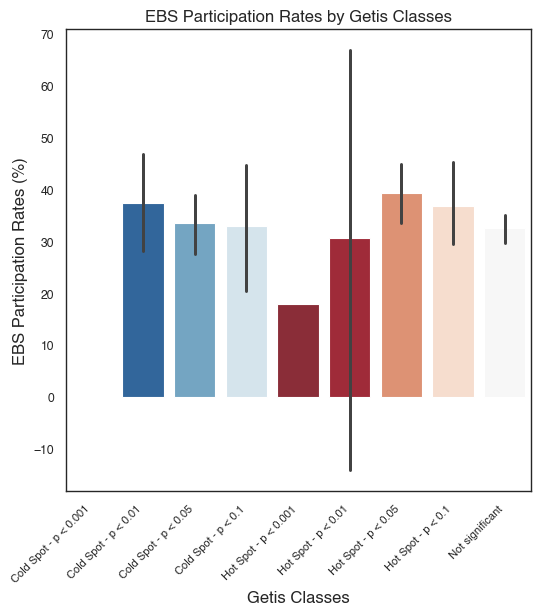

In [67]:
fig, ax = plt.subplots(figsize = (6, 6))
chart = sns.barplot(x = 'eb_rate_G_cl', y = 'eb_rate', data = df_ha_specchio,order=
    ['Cold Spot - p < 0.001','Cold Spot - p < 0.01', 'Cold Spot - p < 0.05', 'Cold Spot - p < 0.1','Hot Spot - p < 0.001', 'Hot Spot - p < 0.01',
     'Hot Spot - p < 0.05', 'Hot Spot - p < 0.1', 'Not significant'],
                        palette=colors_getis,errorbar=('ci', 95),  ax = ax)
chart.set_xlabel('Getis Classes', size=12)
chart.set_ylabel('EBS Participation Rates (%)', size=12)
chart.set_xticklabels(chart.get_xticklabels(), size=8, rotation=45, horizontalalignment='right')

plt.title('EBS Participation Rates by Getis Classes', size = 12)
plt.savefig(figures_folder/'Bar plot - Getis 2020 - EBS Rates.png', dpi = 300, bbox_inches = 'tight')

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 2 disconnected components.



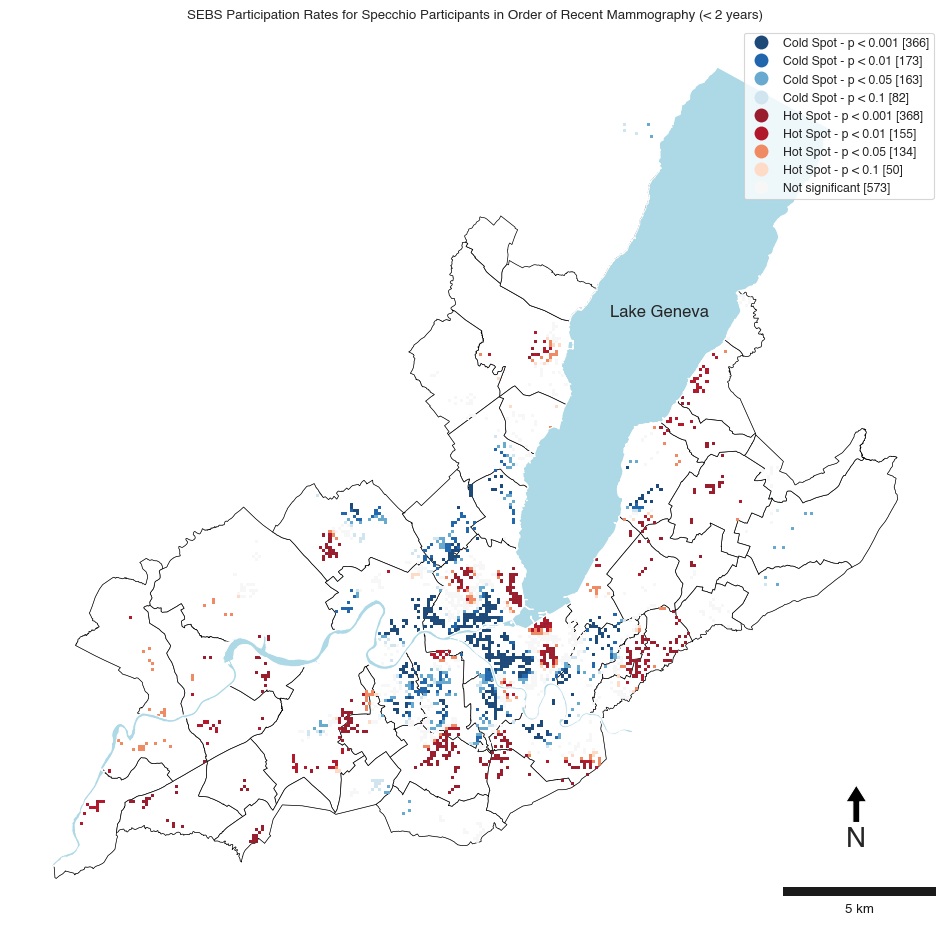

In [68]:
wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_ha_specchio.geometry.centroid)),16)
getiswnn16 = pyspace.compute_getis(df_ha_specchio,'ebs_rate',wnn16, 9999, transform_type='B', p_001 = True)
fdr_pvalue = fdr(getiswnn16.p_sim, 0.05)
df_ha_specchio['ebs_rate_G_cl_fdr'] = df_ha_specchio['ebs_rate_G_cl']  
df_ha_specchio.loc[df_ha_specchio['ebs_rate_G_psim'] >= fdr_pvalue, 'ebs_rate_G_cl_fdr'] = 'Not significant'
fig, ax = pyspace.plotGetisMap(df_ha_specchio,'ebs_rate_G_cl',p_001 = True, commune_name = False)
ax.set_title('SEBS Participation Rates for Specchio Participants in Order of Recent Mammography (< 2 years)')
filename = 'getis_specchio_ha_sebs_wnn16_005.png'
plt.savefig(figures_folder/filename,dpi = 300, bbox_inches = 'tight')

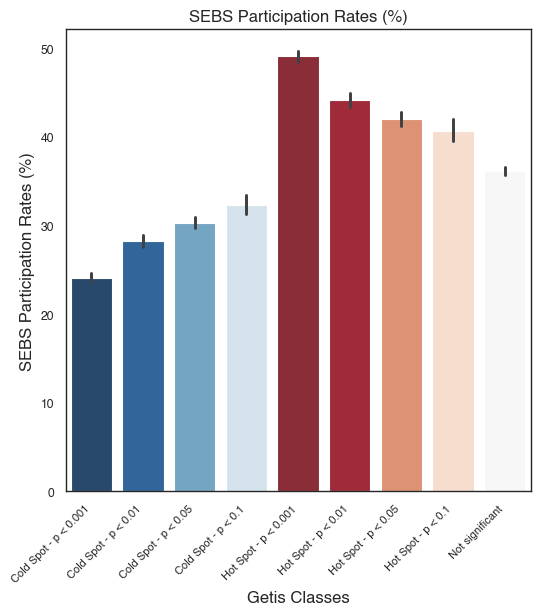

In [69]:
fig, ax = plt.subplots(figsize = (6, 6))
chart = sns.barplot(x = 'ebs_rate_G_cl', y = 'ebs_rate', data = df_ha_specchio,order=
    ['Cold Spot - p < 0.001','Cold Spot - p < 0.01', 'Cold Spot - p < 0.05', 'Cold Spot - p < 0.1','Hot Spot - p < 0.001', 'Hot Spot - p < 0.01',
     'Hot Spot - p < 0.05', 'Hot Spot - p < 0.1', 'Not significant'],
                        palette=colors_getis, errorbar=('ci', 95),  ax = ax)
chart.set_xlabel('Getis Classes', size=12)
chart.set_ylabel('SEBS Participation Rates (%)', size=12)
chart.set_xticklabels(chart.get_xticklabels(), size=8, rotation=45, horizontalalignment='right')

plt.title('SEBS Participation Rates (%)', size = 12)
plt.savefig(figures_folder/'Bar plot - Getis 2020 - SEBS Rates.png', dpi = 300, bbox_inches = 'tight')

## Sensitivity analysis : SEBS with different lags

The Getis Ord Gi statistic is a measure of spatial autocorrelation that is used to identify clusters of similar values across a geographic area. When applied to a rate that has been smoothed using a Spatial Empirical Bayes (SEB) procedure, it may have several implications.

**Reduced variability**: SEB smoothing is often used to reduce random variability that may be present when rates are calculated with small denominators. This can help to reveal underlying spatial patterns that may be obscured by the random noise. By smoothing the rates before applying the Getis Ord Gi statistic, it might be easier to identify significant clusters of high or low rates.

**Increased reliability**: The SEB smoothing procedure adjusts rates towards the global mean rate, based on the reliability of the rate. This can make the Getis Ord Gi results more reliable, as it reduces the influence of extremely high or low rates that are based on small population sizes.

**Risk of oversmoothing**: One potential downside is that SEB smoothing could potentially obscure local variations in the data. This is particularly the case if the level of smoothing is too high (which can happen if the variance of the rates is high). This could potentially lead to overestimating the spatial autocorrelation.

**Assumption of spatial homogeneity**: The SEB smoothing procedure assumes that the underlying risk is spatially homogeneous. If this assumption is not met, the smoothing procedure could introduce bias into the rates, which could then affect the results of the Getis Ord Gi statistic.

Overall, the use of SEB smoothing before calculating the Getis Ord Gi statistic can be a useful way to reduce random variability and increase the reliability of the results. However, it's important to be aware of the potential risks, including the possibility of oversmoothing and the assumption of spatial homogeneity. As with any statistical procedure, it's important to understand the underlying assumptions and potential limitations.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 105 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in divide

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 2 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 18 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/smoothing.py:906: RuntimeWarning:

invalid value encountered in divide

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is 

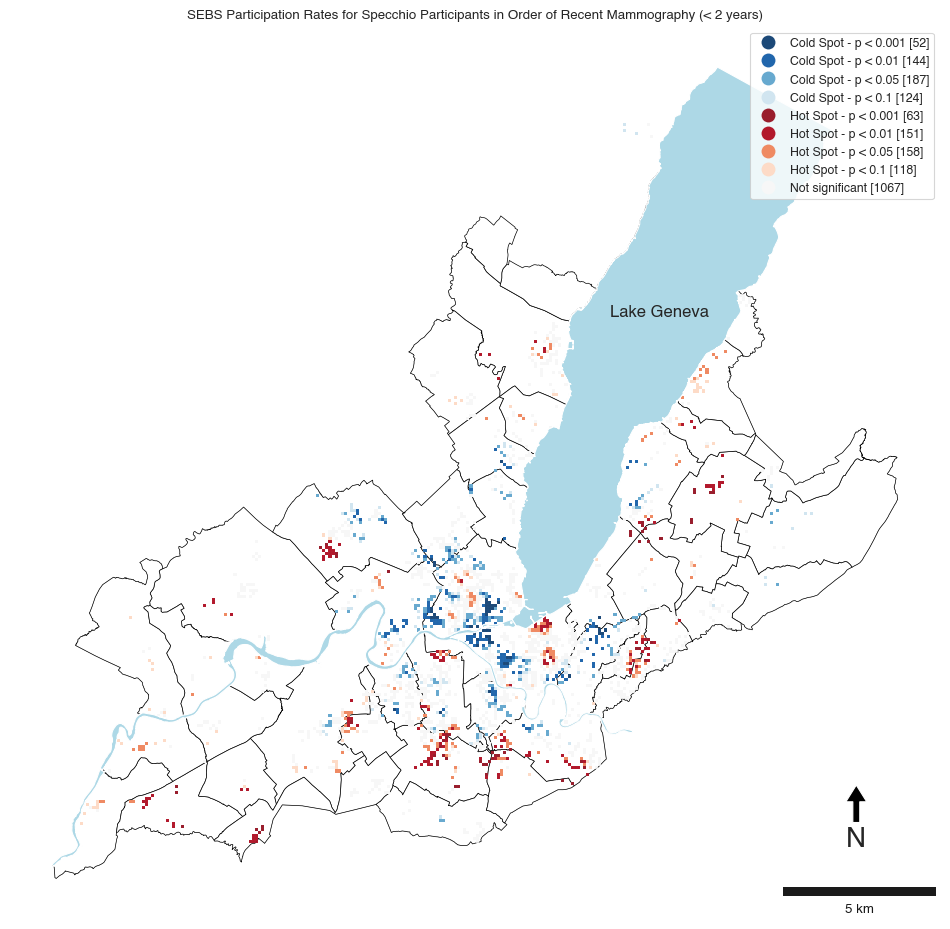

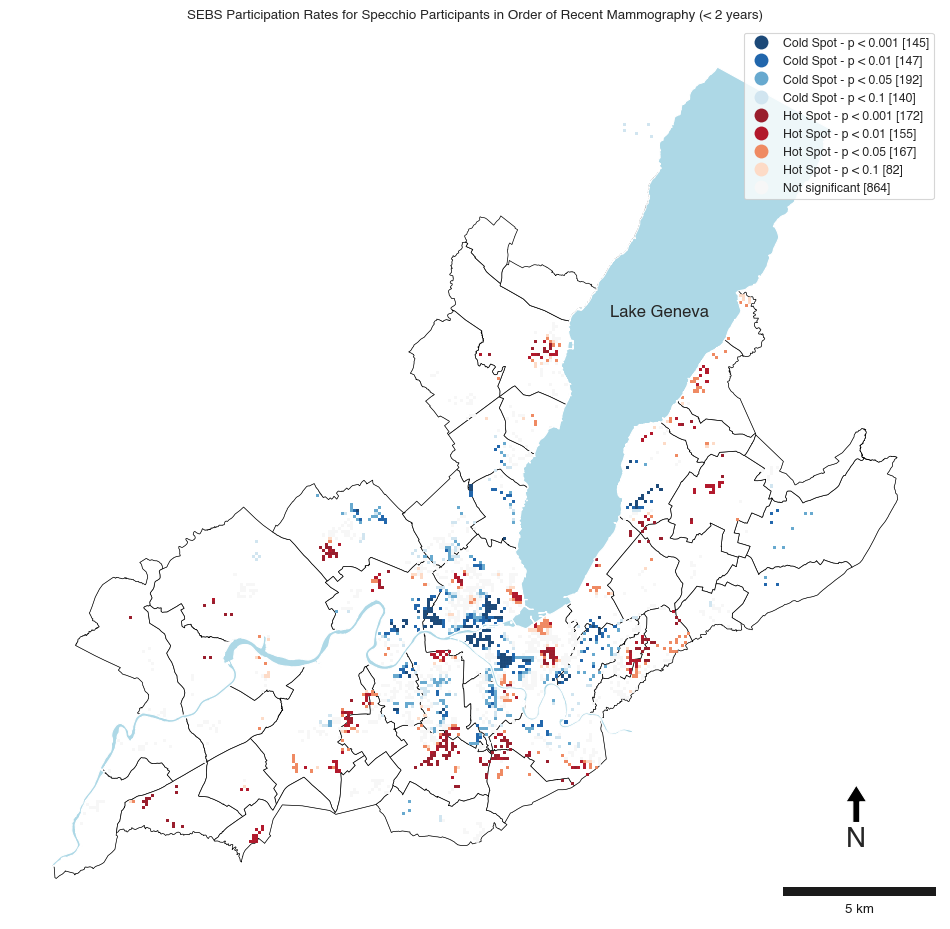

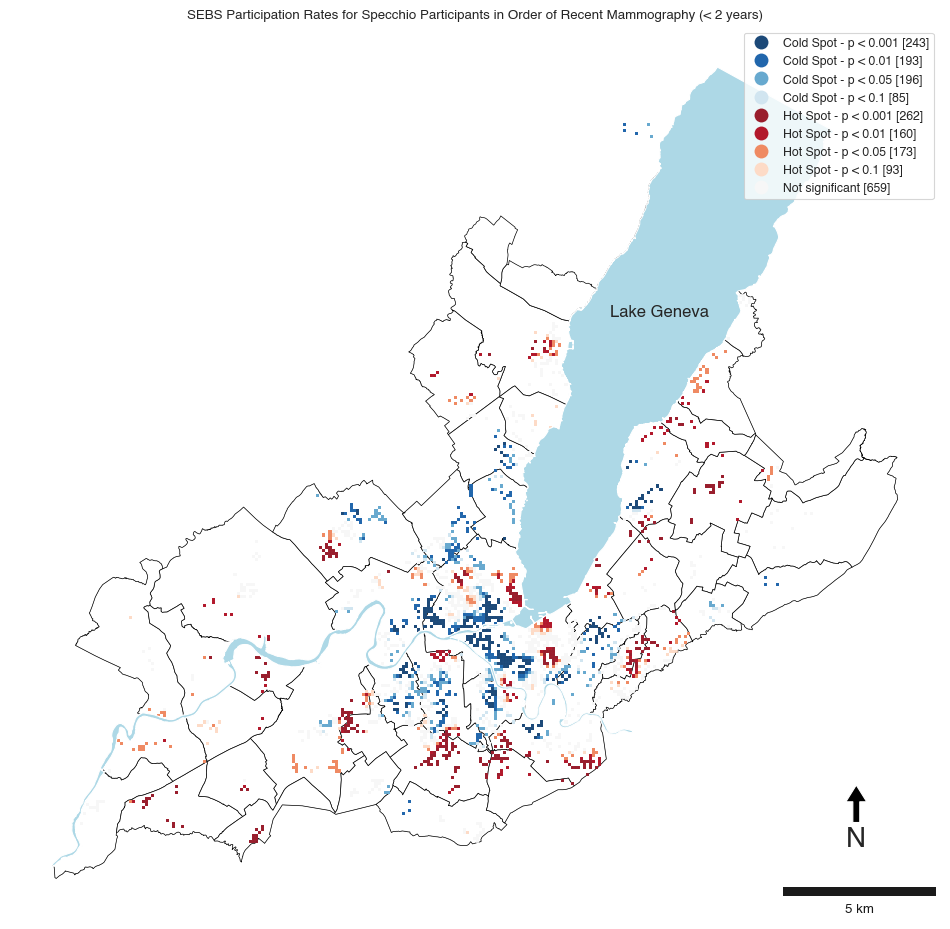

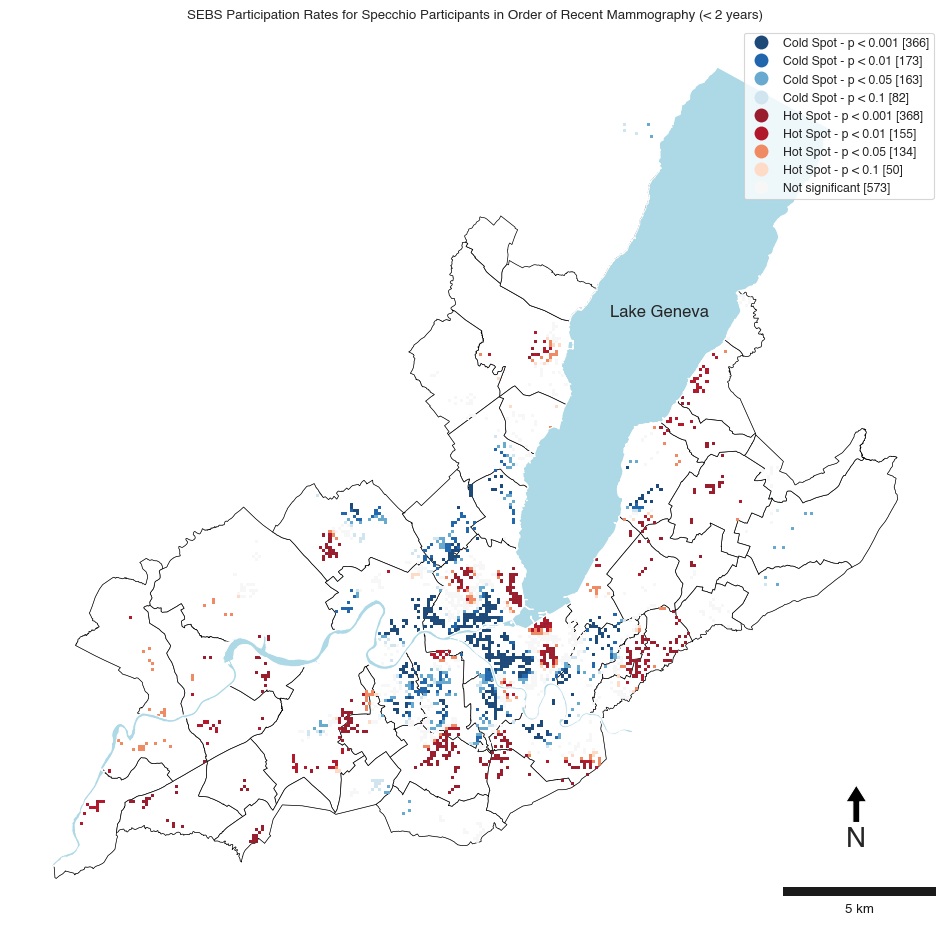

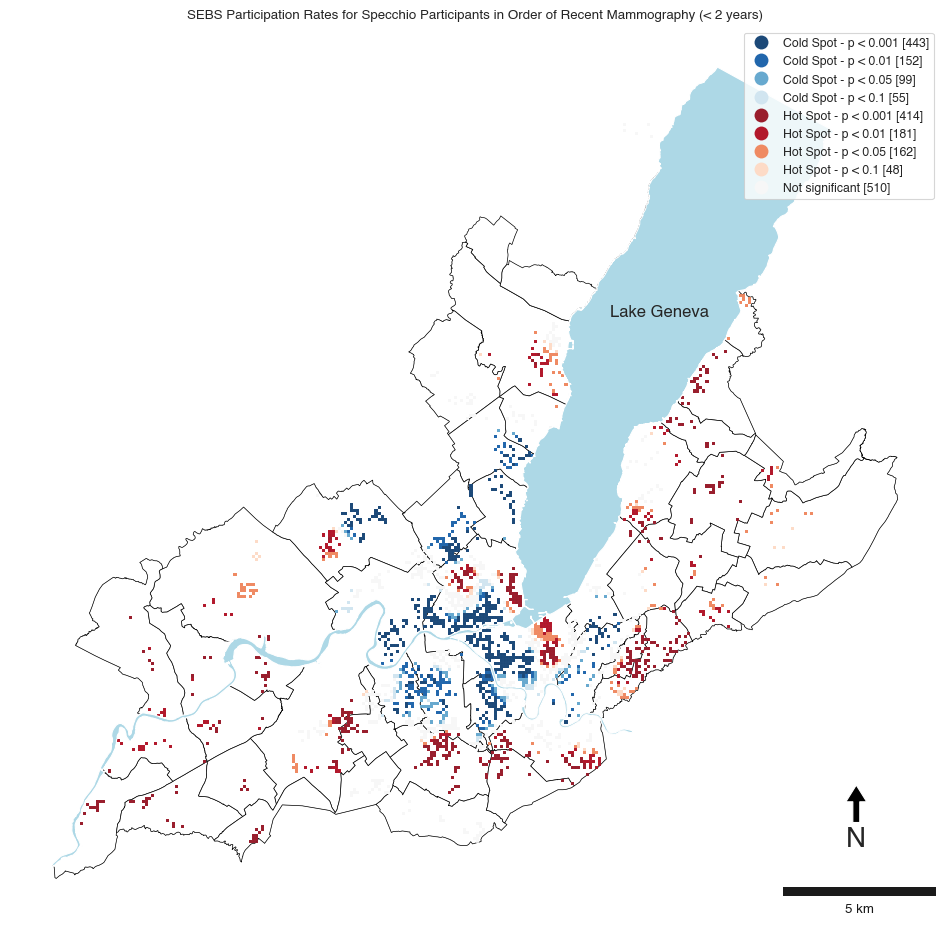

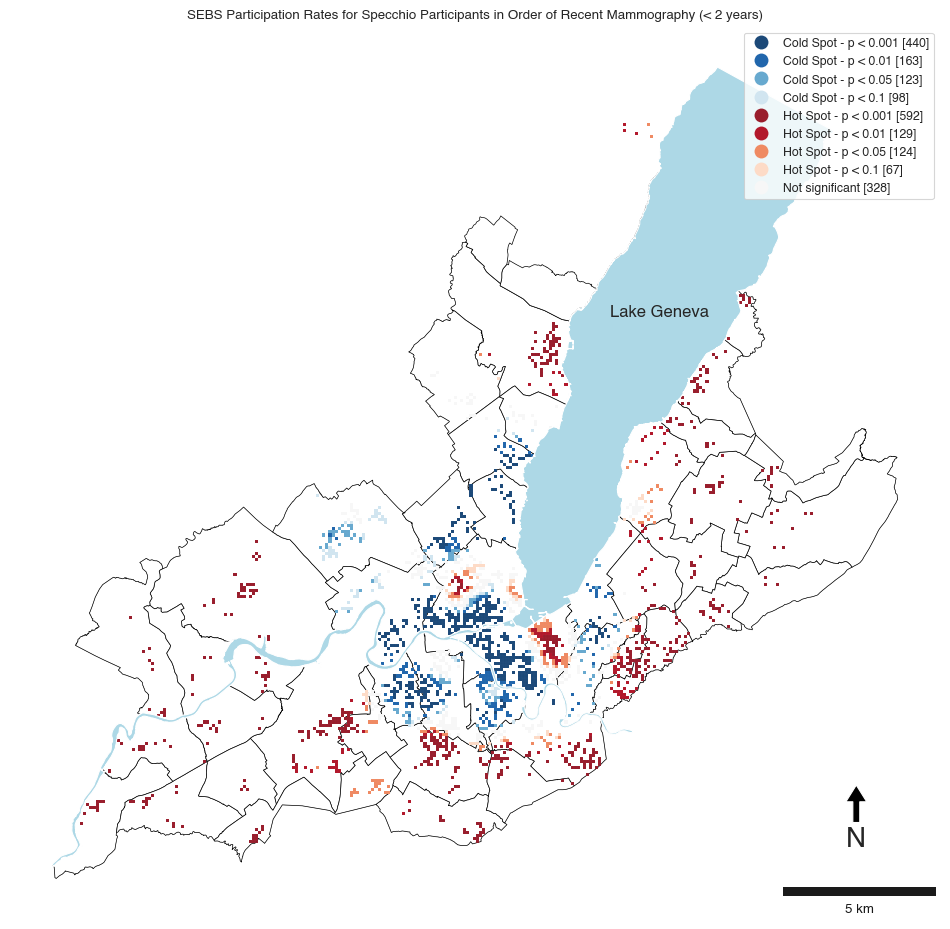

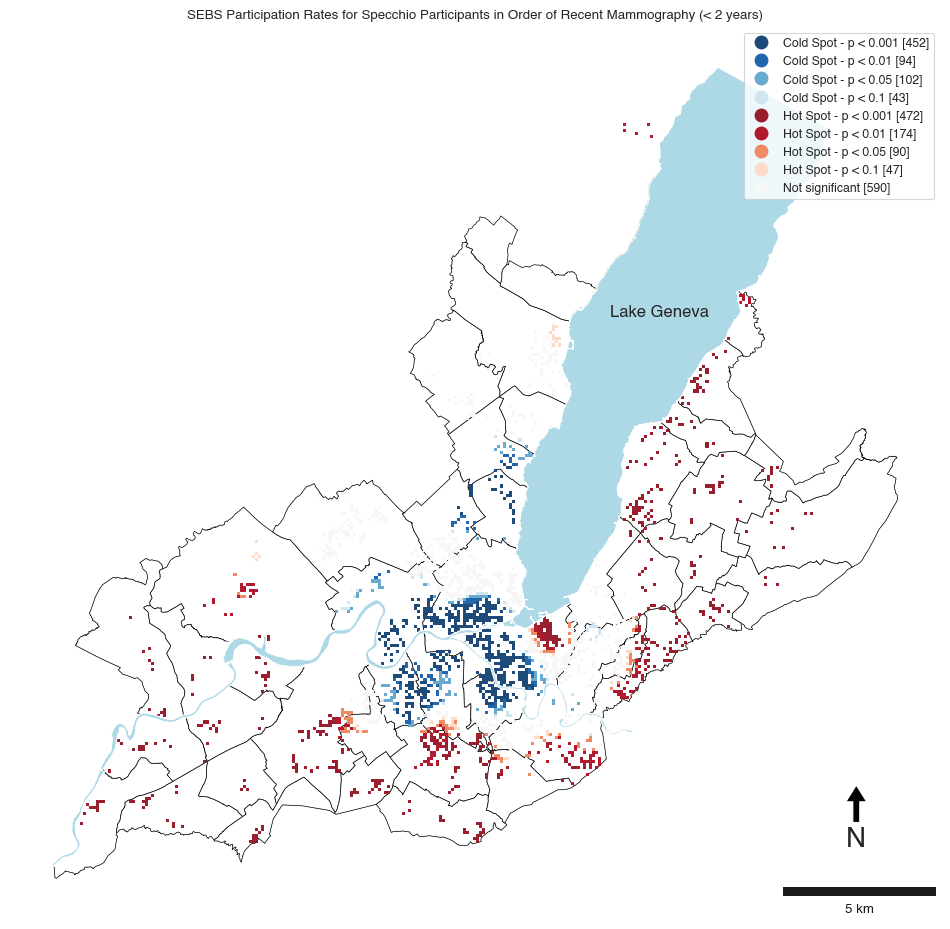

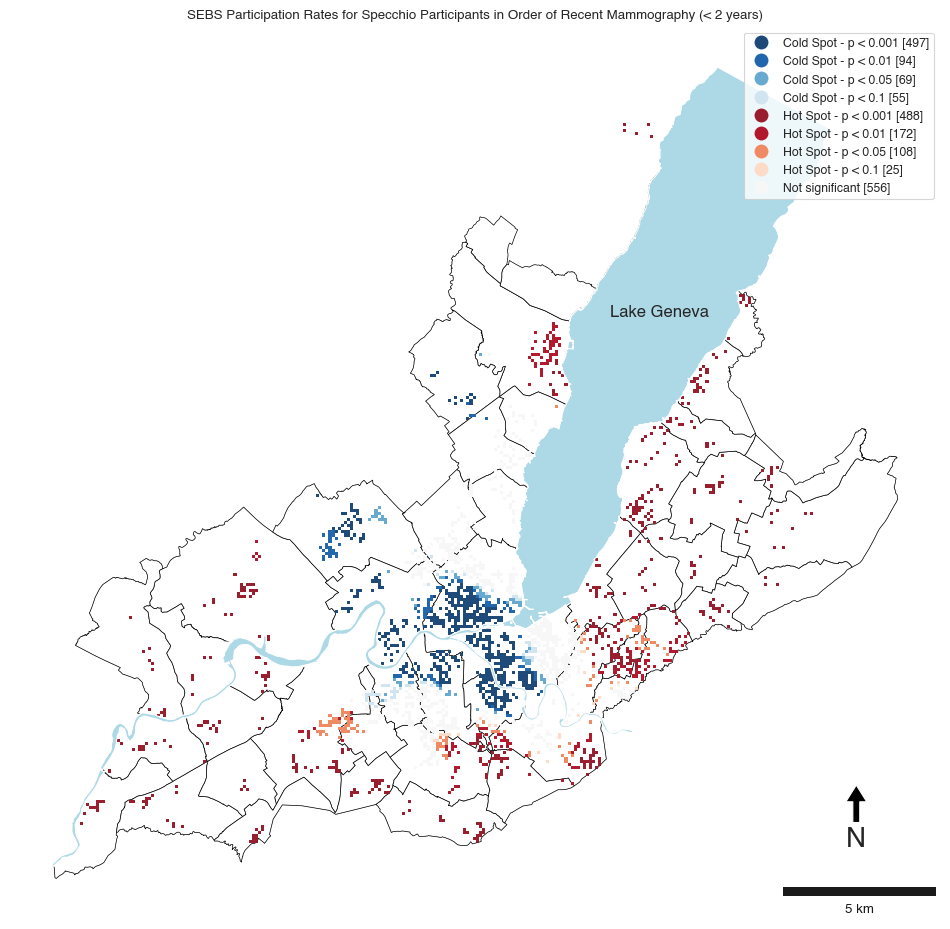

In [70]:
for n in [2,4,8,16,32,64,128,256]:
    wnn_k = lps.weights.KNN(cKDTree(get_points_array(df_ha_specchio.geometry.centroid)),n)
    e = np.array(df_ha_specchio['n_mammo'])
    b = np.array(df_ha_specchio['n_participant'])
    ebs_rate = sm.Spatial_Empirical_Bayes(e, b, wnn_k)
    df_ha_specchio['ebs_rate_k'] = ebs_rate.r
    df_ha_specchio['ebs_rate_k'] = df_ha_specchio['ebs_rate_k'].fillna(0).mul(100)
    
    getiswnn_k = pyspace.compute_getis(df_ha_specchio,'ebs_rate_k',wnn16, 9999, transform_type='B', p_001 = True)
    fdr_pvalue = fdr(getiswnn_k.p_sim, 0.05)
    df_ha_specchio['ebs_rate_k_G_cl_fdr'] = df_ha_specchio['ebs_rate_k_G_cl']  
    df_ha_specchio.loc[df_ha_specchio['ebs_rate_k_G_psim'] >= fdr_pvalue, 'ebs_rate_k_G_cl_fdr'] = 'Not significant'
    fig, ax = pyspace.plotGetisMap(df_ha_specchio,'ebs_rate_k_G_cl',p_001 = True, commune_name = False)
    ax.set_title('SEBS Participation Rates for Specchio Participants in Order of Recent Mammography (< 2 years)')
    filename = 'getis_specchio_ha_sebs_wnn_{}_005.png'.format(n)
    plt.savefig(figures_folder/filename,dpi = 300, bbox_inches = 'tight')

## GIRACS data

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/p

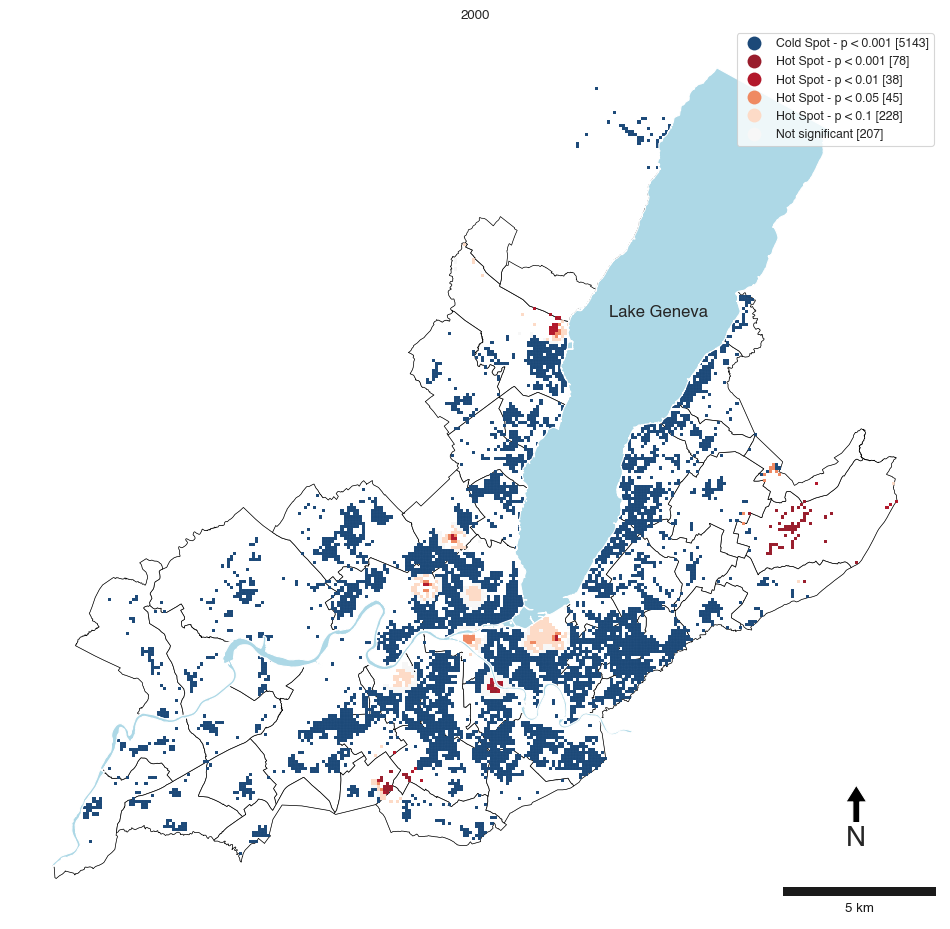

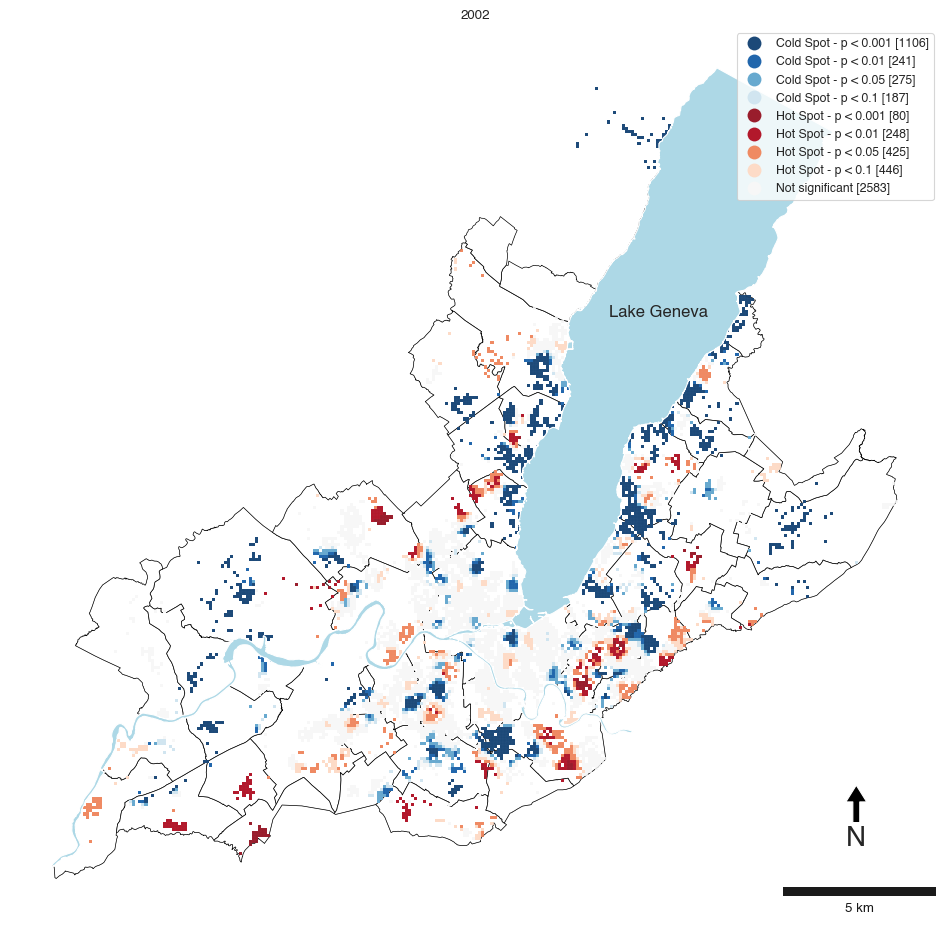

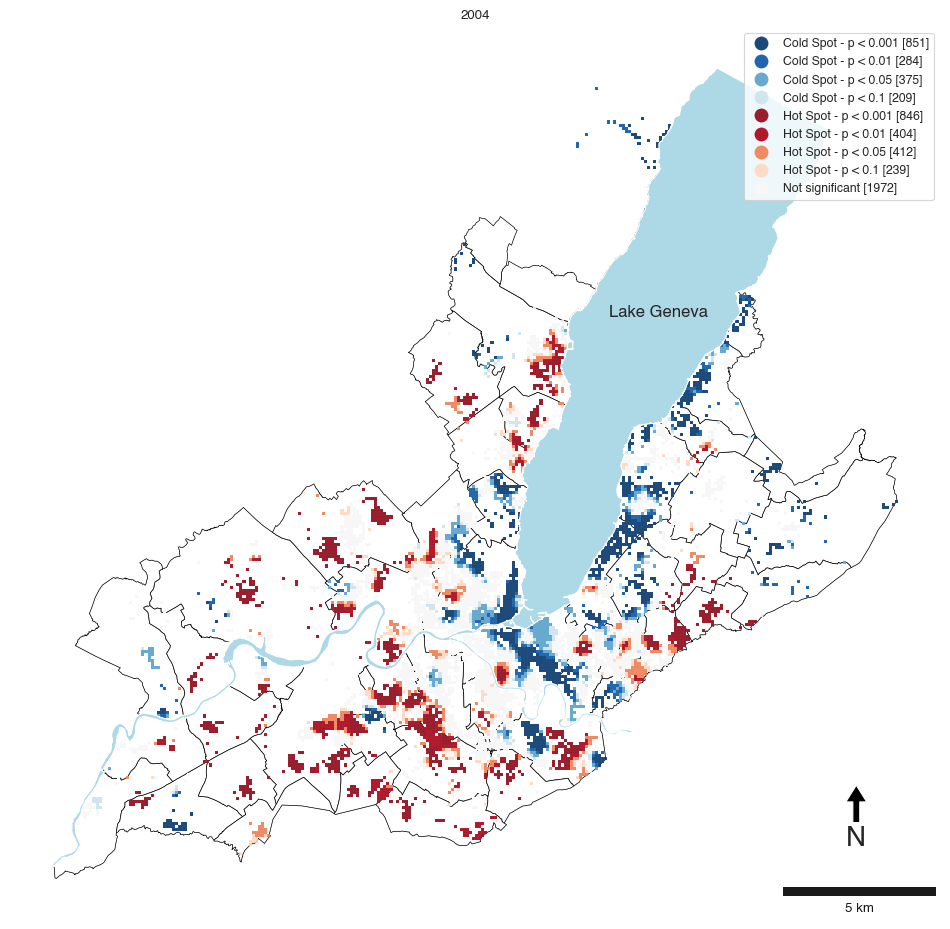

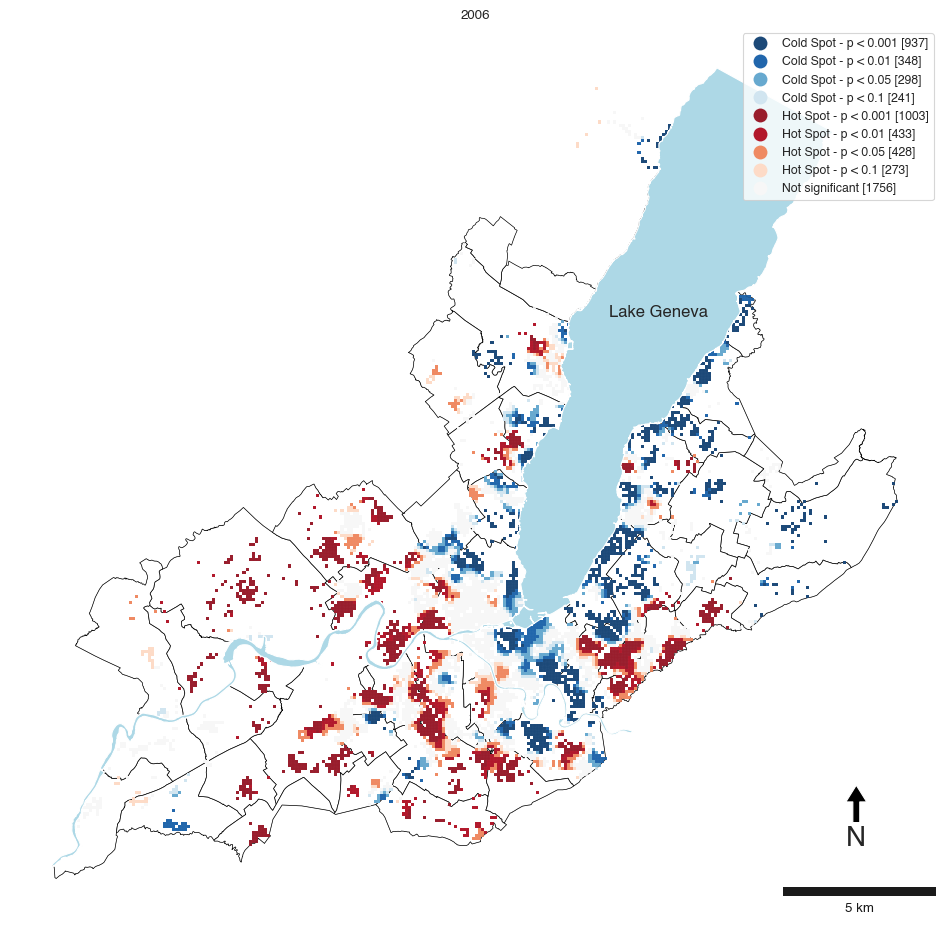

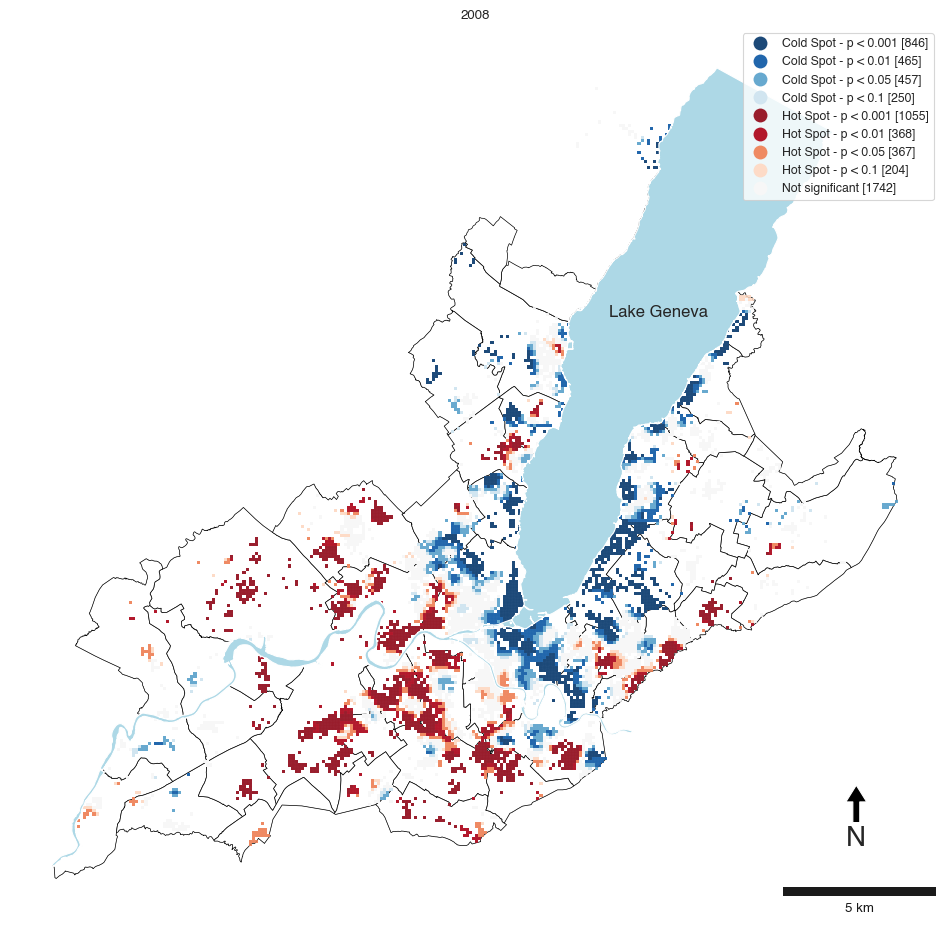

...

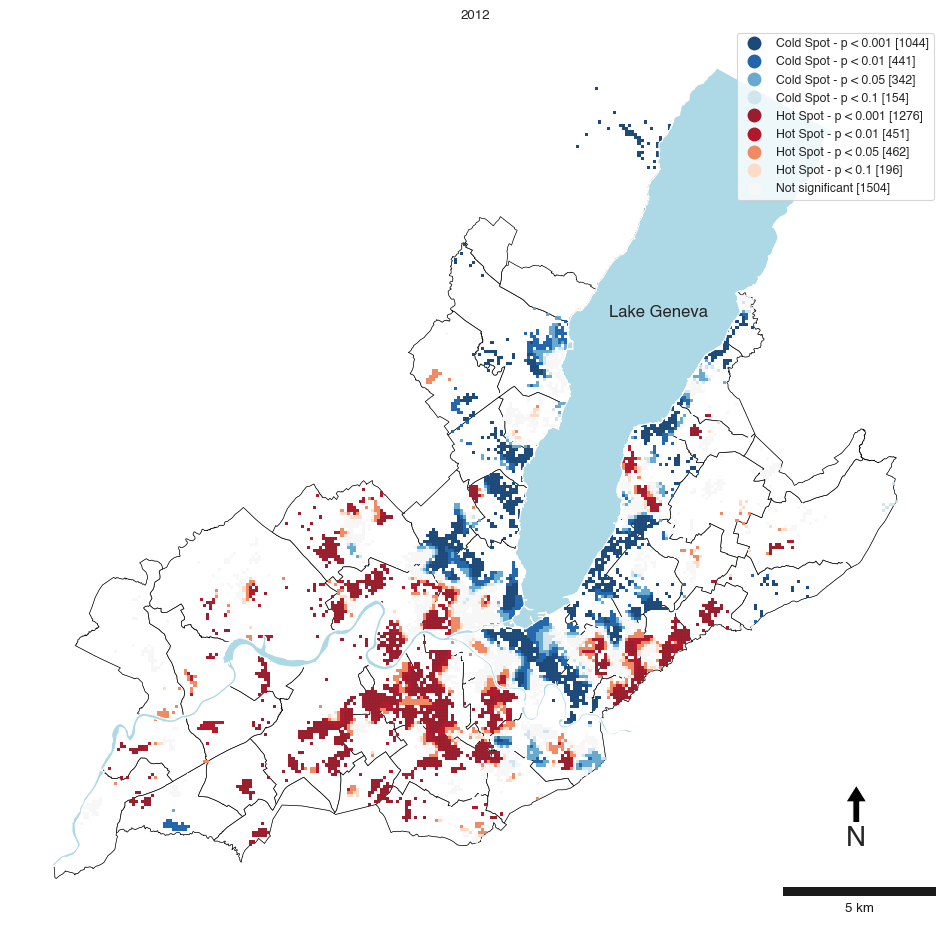

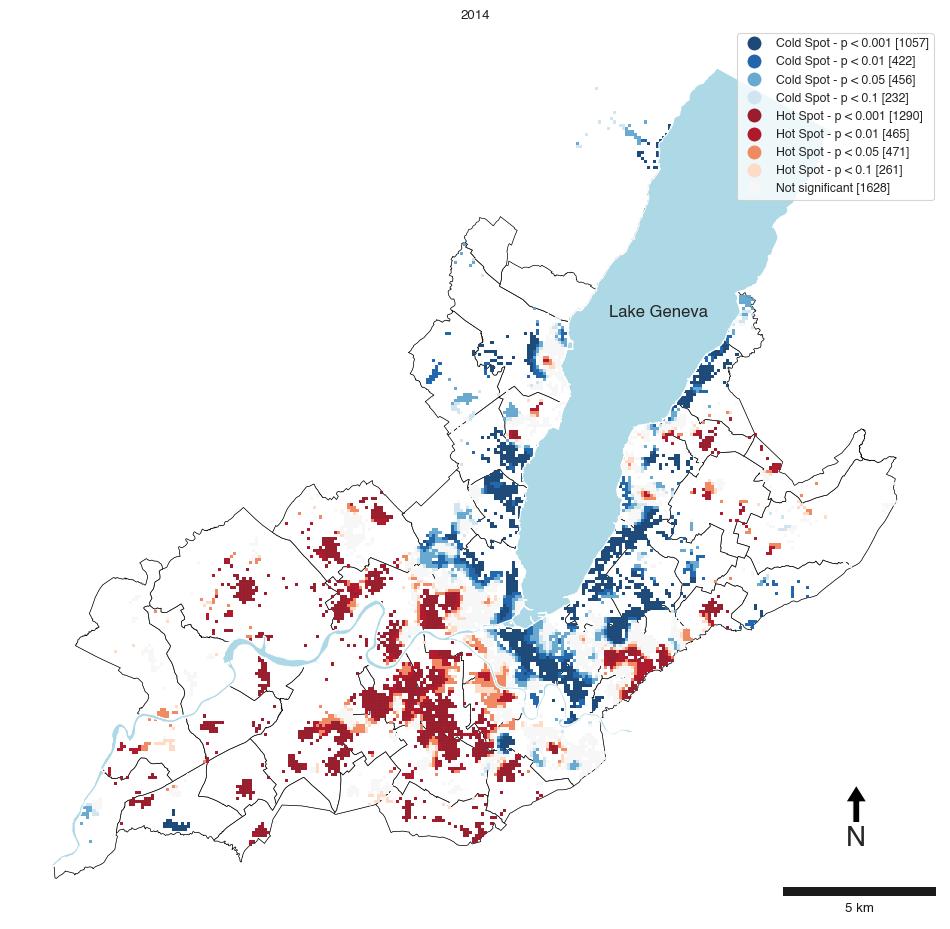

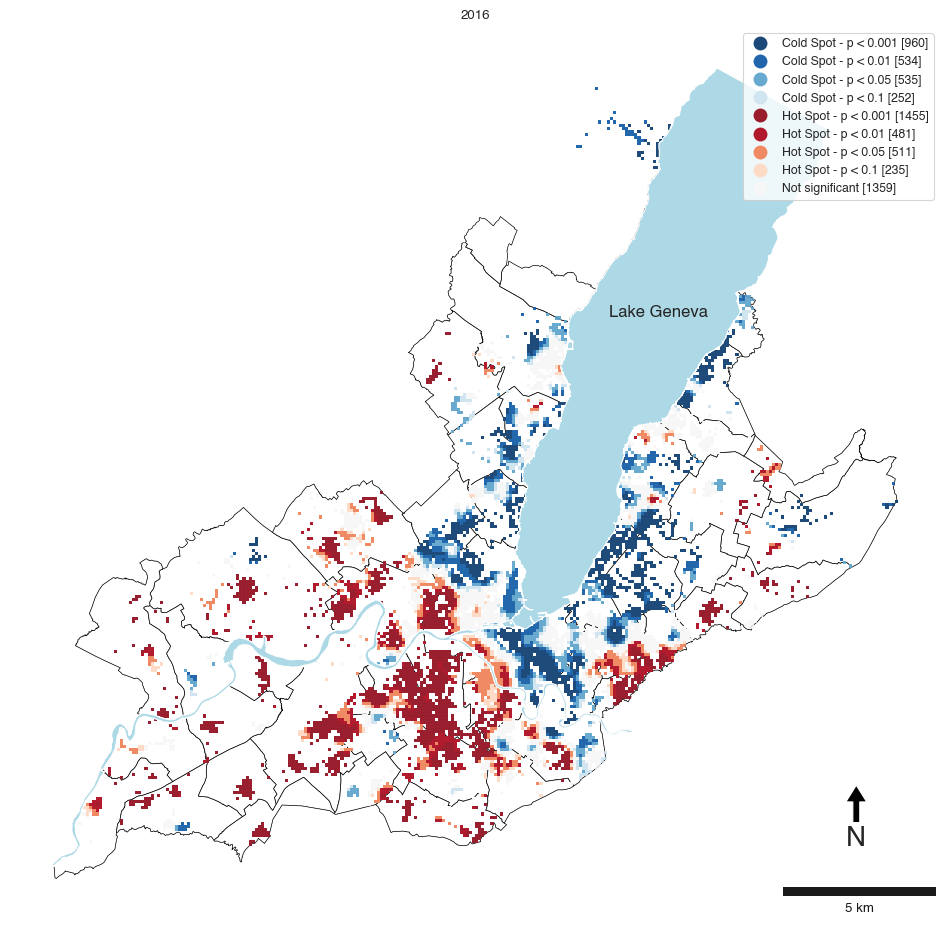

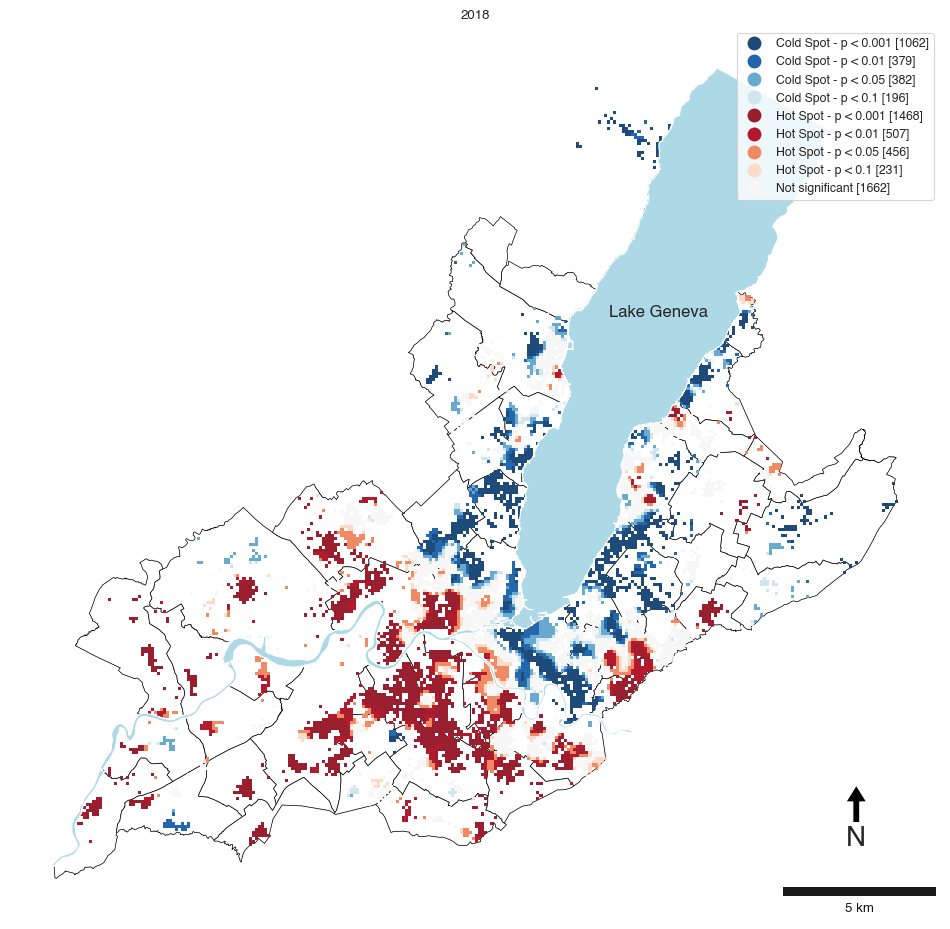

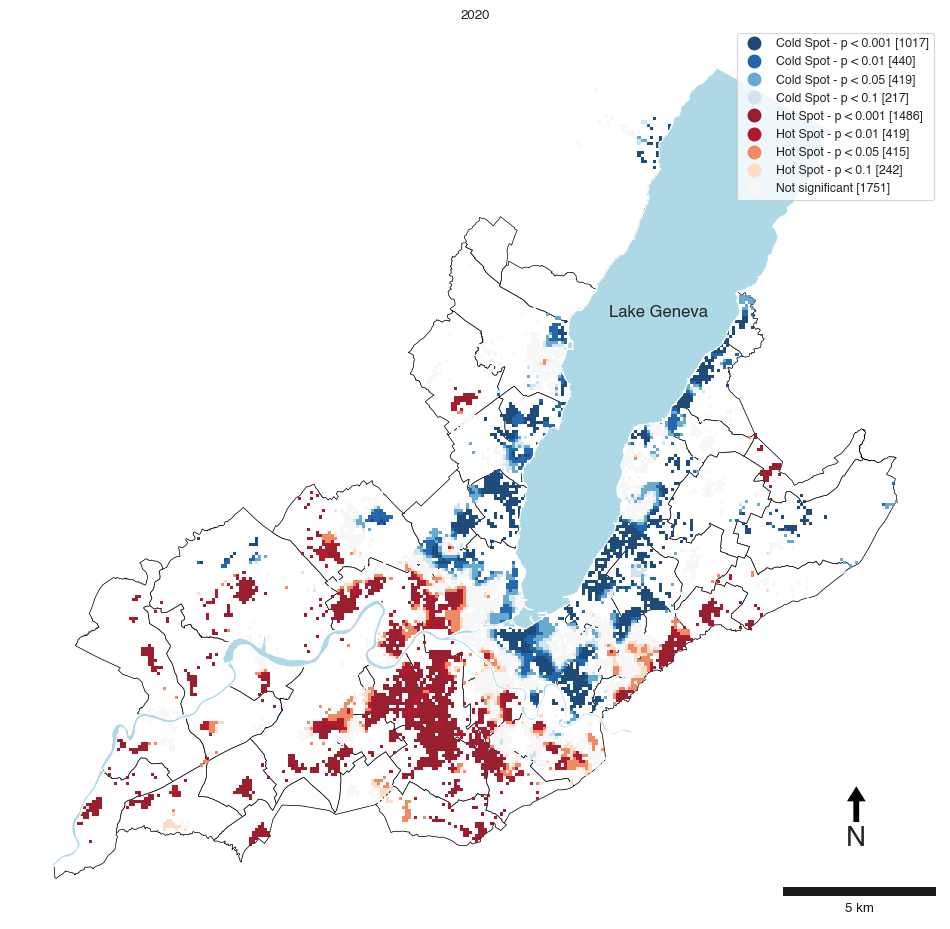

In [71]:
year = 2000
for df_year in dfs_year:
    wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_year.geometry.centroid)),16)
    getiswnn16 = pyspace.compute_getis(df_year,'ebs_rate',wnn16, 9999, transform_type='B', p_001 = True)
    fdr_pvalue = fdr(getiswnn16.p_sim, 0.05)
    df_year['ebs_rate_G_cl_fdr'] = df_year['ebs_rate_G_cl']  
    df_year.loc[df_year['ebs_rate_G_psim'] >= fdr_pvalue, 'ebs_rate_G_cl_fdr'] = 'Not significant'
    fig, ax = pyspace.plotGetisMap(df_year,'ebs_rate_G_cl',p_001 = True, commune_name = False)
    ax.set_title(year)
    filename = 'getis_giracs_ha_wnn16_005_%s.png' % (str(year))
    plt.savefig(figures_folder/filename,dpi = 300, bbox_inches = 'tight')
    year+=2

### Participation by Getis class

In [72]:
colors_getis = ['#1c4978', '#2166ac', '#67a9cf', '#d1e5f0', '#991d2c', '#b2182b', '#ef8a62', '#fddbc7', '#f7f7f7']

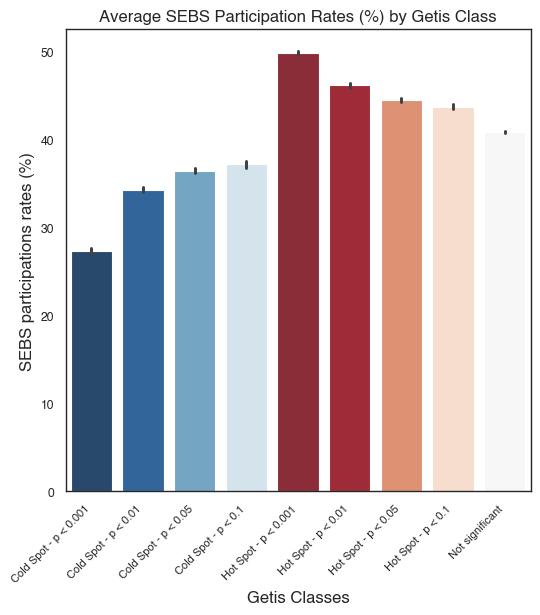

In [73]:
fig, ax = plt.subplots(figsize = (6, 6))
chart = sns.barplot(x = 'ebs_rate_G_cl', y = 'ebs_rate', data = df_year,order=
    ['Cold Spot - p < 0.001','Cold Spot - p < 0.01', 'Cold Spot - p < 0.05', 'Cold Spot - p < 0.1','Hot Spot - p < 0.001', 'Hot Spot - p < 0.01',
     'Hot Spot - p < 0.05', 'Hot Spot - p < 0.1', 'Not significant'],
                        palette=colors_getis, errorbar=('ci', 95),  ax = ax)
chart.set_xlabel('Getis Classes', size=12)
chart.set_ylabel('SEBS participations rates (%)', size=12)
chart.set_xticklabels(chart.get_xticklabels(), size=8, rotation=45, horizontalalignment='right')

plt.title('Average SEBS Participation Rates (%) by Getis Class', size = 12)
plt.savefig(figures_folder/'Bar plot - Getis 2020.png', dpi = 300, bbox_inches = 'tight')

## Shared hectares (GIRACS in Specchio) - GIRACS vs Specchio

In [74]:
df_giracs_2020_specchio = df_year.copy()

In [75]:
df_giracs_2020_specchio = df_giracs_2020_specchio[df_giracs_2020_specchio.RELI.isin(df_ha_specchio.RELI)]

In [76]:
wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_giracs_2020_specchio.geometry.centroid)),16)

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 2 disconnected components.



In [77]:
getiswnn16 = pyspace.compute_getis(df_giracs_2020_specchio,'ebs_rate',wnn16, 9999, transform_type='B', p_001 = True)

In [78]:
fdr_pvalue = fdr(getiswnn16.p_sim, 0.05)
df_giracs_2020_specchio['ebs_rate_G_cl_fdr'] = df_giracs_2020_specchio['ebs_rate_G_cl']  
df_giracs_2020_specchio.loc[df_giracs_2020_specchio['ebs_rate_G_psim'] >= fdr_pvalue, 'ebs_rate_G_cl_fdr'] = 'Not significant'

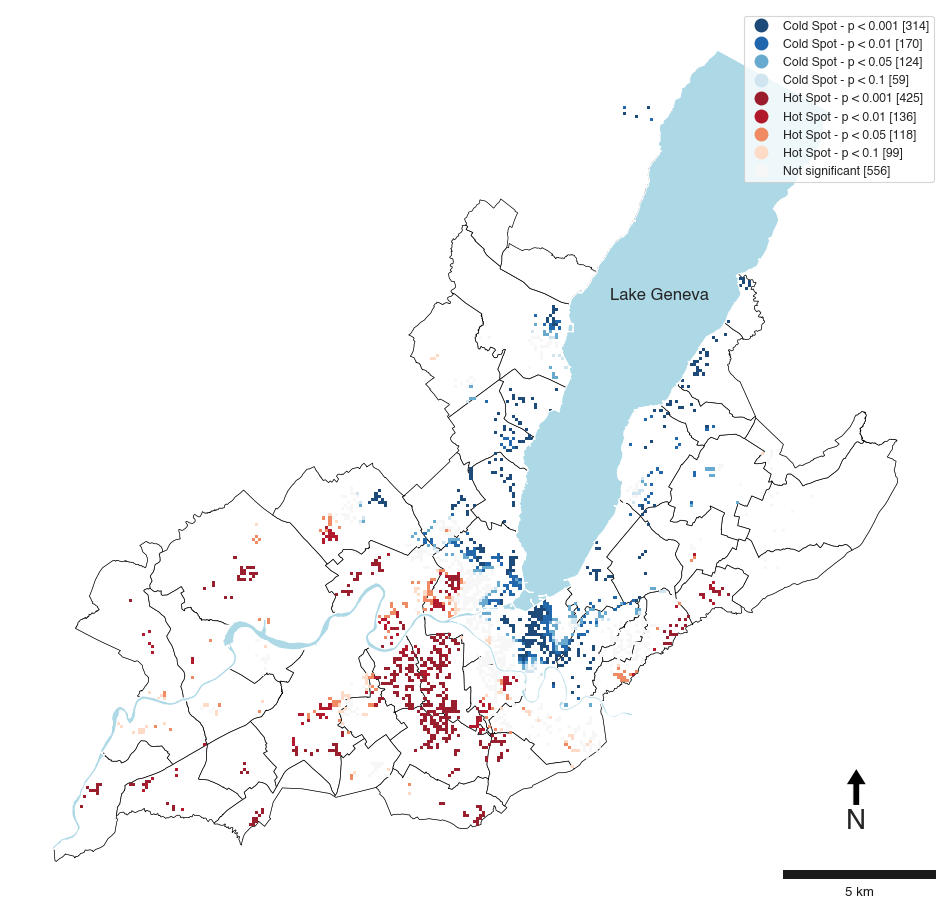

In [79]:
fig, ax = pyspace.plotGetisMap(df_giracs_2020_specchio,'ebs_rate_G_cl',p_001 = True, commune_name = False)

## Combinaison bivariée GIRACS - Specchio

In [80]:
df_ha_bivariate = pd.merge(df_ha_specchio, df_giracs_2020_specchio, on = 'RELI', how = 'left', suffixes = ['_specchio','_giracs'])

In [81]:
df_ha_bivariate = gpd.GeoDataFrame(df_ha_bivariate, crs = 2056, geometry = df_ha_bivariate['geometry_specchio'])

In [82]:
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_giracs.str.contains('Hot', na = False) ,'cat_giracs'] = 100
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_giracs.str.contains('Not', na = False) ,'cat_giracs'] = 50
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_giracs.str.contains('Cold', na = False) ,'cat_giracs'] = 25

df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_specchio.str.contains('Hot', na = False) ,'cat_specchio'] = 100
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_specchio.str.contains('Not', na = False) ,'cat_specchio'] = 50
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_specchio.str.contains('Cold', na = False) ,'cat_specchio'] = 25

In [83]:
df_ha_bivariate = df_ha_bivariate.dropna(subset='ebs_rate_G_cl_giracs')

In [84]:
df_ha_bivariate.drop(['geometry_specchio','geometry_giracs','er_bins','ebs_bins'], axis = 1).to_crs(21781).to_file('../Data/Specchio Data/df_giracs_and_specchio_ha.geojson')

In [85]:
from matplotlib.patches import Rectangle
from matplotlib.collections import PatchCollection
from matplotlib.colors import rgb2hex
from generativepy.color import Color
from PIL import ImageColor
import contextily as cx
### percentile bounds defining upper boundaries of color classes
percentile_bounds = [25, 50, 100]
 
### function to convert hex color to rgb to Color object (generativepy package)
def hex_to_Color(hexcode):
    rgb = ImageColor.getcolor(hexcode, 'RGB')
    rgb = [v/256 for v in rgb]
    rgb = Color(*rgb)
    return rgb
 
### get corner colors from https://www.joshuastevens.net/cartography/make-a-bivariate-choropleth-map/
c00 = hex_to_Color('#3610e0')
c10 = hex_to_Color('#e68422')
c01 = hex_to_Color('#369ed1')
c11 = hex_to_Color('#db0d0d')
 
### now create square grid of colors, using color interpolation from generativepy package
num_grps = len(percentile_bounds)
c00_to_c10 = []
c01_to_c11 = []
colorlist = []
for i in range(num_grps):
    c00_to_c10.append(c00.lerp(c10, 1/(num_grps-1) * i))
    c01_to_c11.append(c01.lerp(c11, 1/(num_grps-1) * i))
for i in range(num_grps):
    for j in range(num_grps):
        colorlist.append(c00_to_c10[i].lerp(c01_to_c11[i], 1/(num_grps-1) * j))
### convert back to hex color
colorlist = [rgb2hex([c.r, c.g, c.b]) for c in colorlist]

In [86]:
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_giracs.str.contains('Hot', na = False) ,'cat_giracs'] = 100
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_giracs.str.contains('Not', na = False) ,'cat_giracs'] = 50
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_giracs.str.contains('Cold', na = False) ,'cat_giracs'] = 25

df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_specchio.str.contains('Hot', na = False) ,'cat_specchio'] = 100
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_specchio.str.contains('Not', na = False) ,'cat_specchio'] = 50
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_specchio.str.contains('Cold', na = False) ,'cat_specchio'] = 25

In [87]:
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_giracs.str.contains('Hot', na = False) ,'cat_giracs_str'] = 'HS'
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_giracs.str.contains('Not', na = False) ,'cat_giracs_str'] = 'NS'
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_giracs.str.contains('Cold', na = False) ,'cat_giracs_str'] = 'CS'

df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_specchio.str.contains('Hot', na = False) ,'cat_specchio_str'] = 'HS'
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_specchio.str.contains('Not', na = False) ,'cat_specchio_str'] = 'NS'
df_ha_bivariate.loc[df_ha_bivariate.ebs_rate_G_cl_specchio.str.contains('Cold', na = False) ,'cat_specchio_str'] = 'CS'

In [88]:
df_ha_bivariate ['cat'] = df_ha_bivariate['cat_giracs'].astype(str)+'-'+df_ha_bivariate['cat_specchio'].astype(str)
df_ha_bivariate ['cat_str'] = df_ha_bivariate['cat_giracs_str'].astype(str)+'-'+df_ha_bivariate['cat_specchio_str'].astype(str)

In [89]:
# df_ha_bivariate.loc[df_ha_bivariate['cat'] == '50-25','cat'] = '25-50'
# df_ha_bivariate.loc[df_ha_bivariate['cat'] == '100-25','cat'] = '25-100'
# df_ha_bivariate.loc[df_ha_bivariate['cat'] == '100-50','cat'] = '50-100'

In [90]:
df_ha_bivariate.cat_str.value_counts()

HS-HS    300
CS-CS    257
HS-CS    253
NS-CS    252
HS-NS    225
CS-HS    213
CS-NS    197
NS-HS    172
NS-NS    132
Name: cat_str, dtype: int64

In [91]:
(df_ha_bivariate.cat_str.value_counts()/df_ha_bivariate.shape[0]).mul(100).round(1)

HS-HS    15.0
CS-CS    12.8
HS-CS    12.6
NS-CS    12.6
HS-NS    11.2
CS-HS    10.6
CS-NS     9.8
NS-HS     8.6
NS-NS     6.6
Name: cat_str, dtype: float64

In [92]:
colorlist = ['#3610df',
 '#4f89c2',
 '#0aa5ff',
 '#844aa8',
 '#9c9a9b',
 '#c98671',
 '#e58322',
 '#dbc046',
 '#da0d0d']

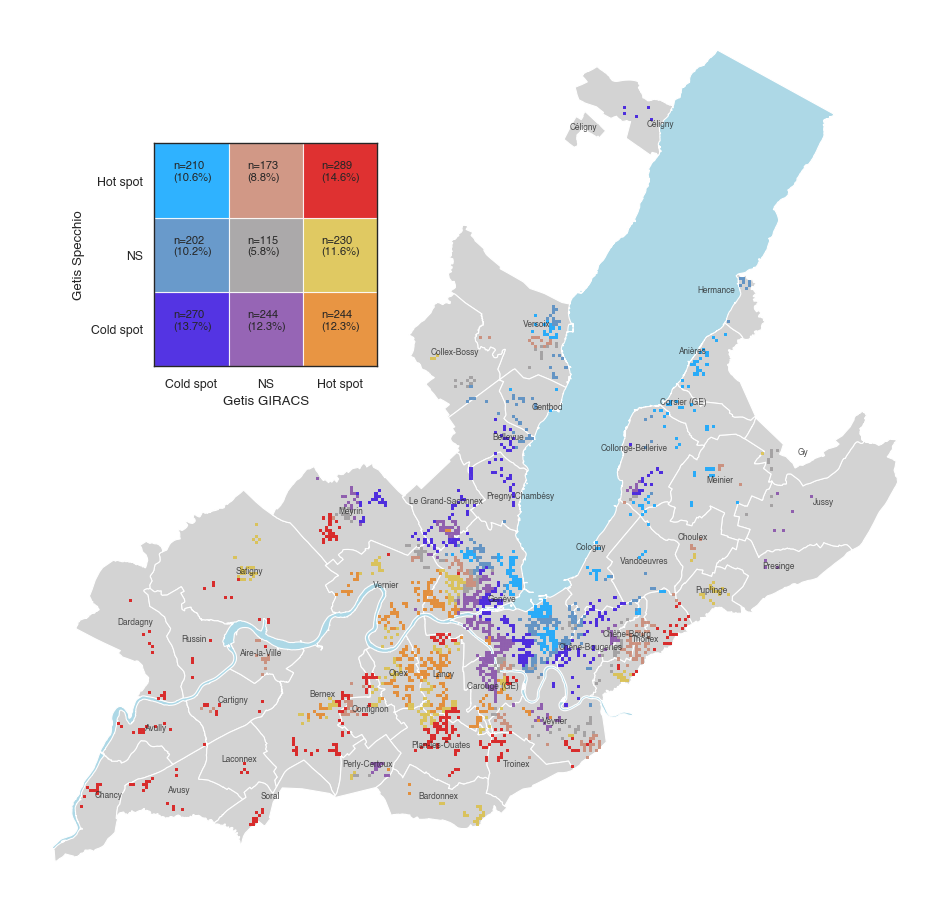

In [93]:
### function to get bivariate color given two percentiles
def get_bivariate_choropleth_color(p1, p2):
    if p1>=0 and p2>=0:
        count = 0
        stop = False
        for percentile_bound_p1 in percentile_bounds:
            for percentile_bound_p2 in percentile_bounds:
                if (not stop) and (p1 <= percentile_bound_p1):
                    if (not stop) and (p2 <= percentile_bound_p2):
                        color = colorlist[count]
                        stop = True
                count += 1
    else:
        color = [0.8,0.8,0.8,1]
    return color

alpha=0.85
dpi=300

### plot map based on bivariate choropleth
fig, ax = plt.subplots(1,1, figsize=(12,12))
attr = 'CIscoreP'
df_ha_bivariate['color_bivariate'] = [get_bivariate_choropleth_color(p1, p2) for p1,p2 in zip(df_ha_bivariate['cat_giracs'].values, df_ha_bivariate['cat_specchio'].values)]
df_ha_bivariate.plot(ax=ax, color=df_ha_bivariate['color_bivariate'], linewidth = 0.01, alpha=alpha, legend=False, zorder=3)
communes.plot(color = 'lightgrey', ax = ax, zorder = 1)
lake.plot(color = 'lightblue',ax = ax, zorder = 2)
communes.apply(lambda x: ax.annotate(text=x.NAME, xy=x.geometry.centroid.coords[0], ha='center', size=6, alpha = 0.8),
               axis=1)
# cx.add_basemap(ax = ax, crs=df_ha_bivariate.crs, source=cx.providers.Stamen.TonerLite)
ax.set_xticks([])
ax.set_yticks([])
ax.set_axis_off()
### now create inset legend
ax = ax.inset_axes([0.15,0.6,0.25,0.25])
ax.set_aspect('equal', adjustable='box')
count = 0
xticks = [0]
yticks = [0]
for i,percentile_bound_p1 in enumerate(percentile_bounds):
    for j,percentile_bound_p2 in enumerate(percentile_bounds):
        percentileboxes = [Rectangle((i,j), 1, 1)]
        pc = PatchCollection(percentileboxes, facecolor=colorlist[count], alpha=alpha)
        count += 1
        ax.add_collection(pc)
        if i == 0:
            yticks.append(percentile_bound_p2)
    xticks.append(percentile_bound_p1)
ticks_pos = [x + 0.5 for x in list(range(len(percentile_bounds)))]
ax.annotate('n=289\n(14.6%)',xy=(2.25,2.5), size = 8)
ax.annotate('n=270\n(13.7%)',xy=(0.25,0.5), size = 8)
ax.annotate('n=244\n(12.3%)',xy=(2.25,0.5), size = 8)
ax.annotate('n=244\n(12.3%)',xy=(1.25,0.5), size = 8)
ax.annotate('n=230\n(11.6%)',xy=(2.25,1.5), size = 8)
ax.annotate('n=210\n(10.6%)',xy=(0.25,2.5), size = 8)
ax.annotate('n=202\n(10.2%)',xy=(0.25,1.5), size = 8)
ax.annotate('n=173\n(8.8%)',xy=(1.25,2.5), size = 8)
ax.annotate('n=115\n(5.8%)',xy=(1.25,1.5), size = 8)




_=ax.set_xlim([0,len(percentile_bounds)])
_=ax.set_ylim([0,len(percentile_bounds)])
_=ax.set_xticks(ticks_pos, ['Cold spot','NS','Hot spot'])
_=ax.set_xlabel('Getis GIRACS')
_=ax.set_yticks(ticks_pos, ['Cold spot','NS','Hot spot'])
_=ax.set_ylabel('Getis Specchio')

plt.savefig(figures_folder/'Bivariate Getis - GIRACS vs Specchio - No basemap.png', dpi = 300, bbox_inches = 'tight')
# plt.savefig('../Manuscript/Figures/Bivariate Getis - GIRACS vs Specchio.png', dpi = 300, bbox_inches = 'tight')

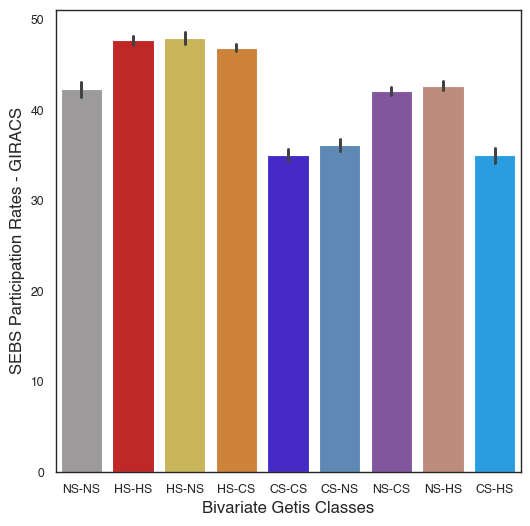

In [94]:
fig, ax = plt.subplots(figsize = (6, 6))
chart = sns.barplot(x = 'cat_str', y = 'ebs_rate_giracs',palette=df_ha_bivariate[['color_bivariate','cat_str']].drop_duplicates().color_bivariate.to_list(), data = df_ha_bivariate, errorbar=('ci', 95),  ax = ax)
chart.set_xlabel('Bivariate Getis Classes', size=12)
chart.set_ylabel('SEBS Participation Rates - GIRACS', size=12)
plt.savefig(figures_folder/'Bivariate Getis - GIRACS Participation Rates.png', dpi = 300, bbox_inches = 'tight')


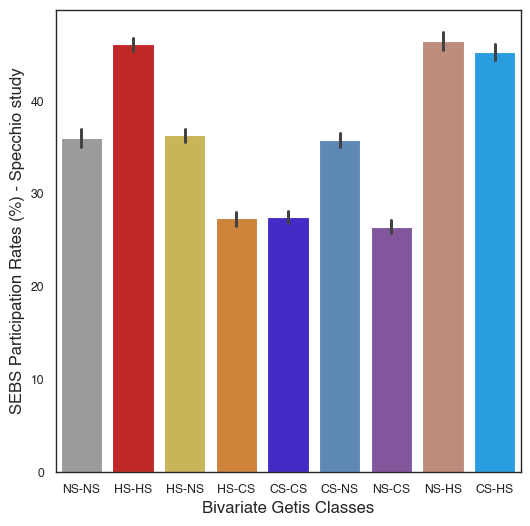

In [95]:
fig, ax = plt.subplots(figsize = (6, 6))
chart = sns.barplot(x = 'cat_str', y = 'ebs_rate_specchio',palette=df_ha_bivariate[['color_bivariate','cat_str']].drop_duplicates().color_bivariate.to_list(), data = df_ha_bivariate, errorbar=('ci', 95),  ax = ax)
chart.set_xlabel('Bivariate Getis Classes', size=12)
chart.set_ylabel('SEBS Participation Rates (%) - Specchio study', size=12)
plt.savefig(figures_folder/'Bivariate Getis - Specchio Participation Rates.png', dpi = 300, bbox_inches = 'tight')

## Evolution des classes 2020 entre 1999 et 2020

In [96]:
df_all_years = pd.DataFrame()
year = 2000
for df_year in dfs_year:
    df_year['year_invit'] = str(year)
    df_all_years = pd.concat([df_all_years, df_year])
    year +=2

In [97]:
reli_2020 = df_all_years[df_all_years['2020_mammo'].isnull()==False].RELI.tolist()
df_all_years_2020ha = df_all_years[(df_all_years.RELI.isin(reli_2020))]

In [98]:
df_all_years_2020ha  = df_all_years_2020ha.set_index('RELI')
df_all_years_2020ha = df_all_years_2020ha.reset_index()

In [99]:
# res_folder = Path('../Results/LISA - Hectares')
# year = 2000
# for df_year in dfs_year:
    
#     wnn8 = lps.weights.KNN(cKDTree(get_points_array(df_year.geometry.centroid)),8)
#     lisawnn8 = pyspace.compute_lisa(df_year,'ebs_rate',wnn8,9999,0.05)
#     fdr_pvalue = fdr(lisawnn8.p_sim, 0.05)
#     df_year['ebs_rate_cl_fdr'] = df_year['ebs_rate_cl']  
#     df_year.loc[df_year['ebs_rate_psim'] >= fdr_pvalue, 'ebs_rate_cl_fdr'] = '0 Non-Significant'
#     fig, ax = pyspace.plotLISAMap_polygons(df_year,'ebs_rate_cl_fdr','')
#     ax.set_title(year)
#     filename = 'lisa_giracs_ha_wnn8_005_%s.jpg' % (str(year))
#     plt.savefig(res_folder/'LISA - WNN16'/filename,dpi = 200, bbox_inches = 'tight')
#     year+= 2

In [100]:
colors_cl_getis = {'Cold Spot - p < 0.001':'#1c4978',
                    'Cold Spot - p < 0.01':'#2166ac',
                    'Cold Spot - p < 0.05':'#67a9cf',
                    'Cold Spot - p < 0.1':'#d1e5f0',
                    'Hot Spot - p < 0.001':'#991d2c',
                    'Hot Spot - p < 0.01':'#b2182b',
                    'Hot Spot - p < 0.05':'#ef8a62',
                    'Hot Spot - p < 0.1':'#fddbc7',
                    'Not significant':'#f7f7f7'}

In [101]:
colors_cl = {'0 Non-Significant': 'lightgrey',
             '1 High-High': '#d7191c',
             '2 Low-High': '#abd9e9',
             '3 Low-Low': '#2c7bb6',
             '4 High-Low': '#fdae61'}

In [102]:
dfs_year[-3].groupby('ebs_rate_G_cl').ebs_rate.mean()

ebs_rate_G_cl
Cold Spot - p < 0.001    24.839885
Cold Spot - p < 0.01     30.529921
Cold Spot - p < 0.05     32.425829
Cold Spot - p < 0.1      33.616238
Hot Spot - p < 0.001     45.292569
Hot Spot - p < 0.01      41.566520
Hot Spot - p < 0.05      40.362647
Hot Spot - p < 0.1       39.536569
Not significant          36.448397
Name: ebs_rate, dtype: float64

In [103]:
df_all_years_2020ha_test = df_all_years_2020ha.copy()

In [104]:
df_all_years_2020ha_test['ebs_rate_G_cl_2020'] = df_all_years_2020ha_test['RELI'].map(dfs_year[-1].set_index('RELI')['ebs_rate_G_cl'].to_dict())

## Tendances au cour du temps

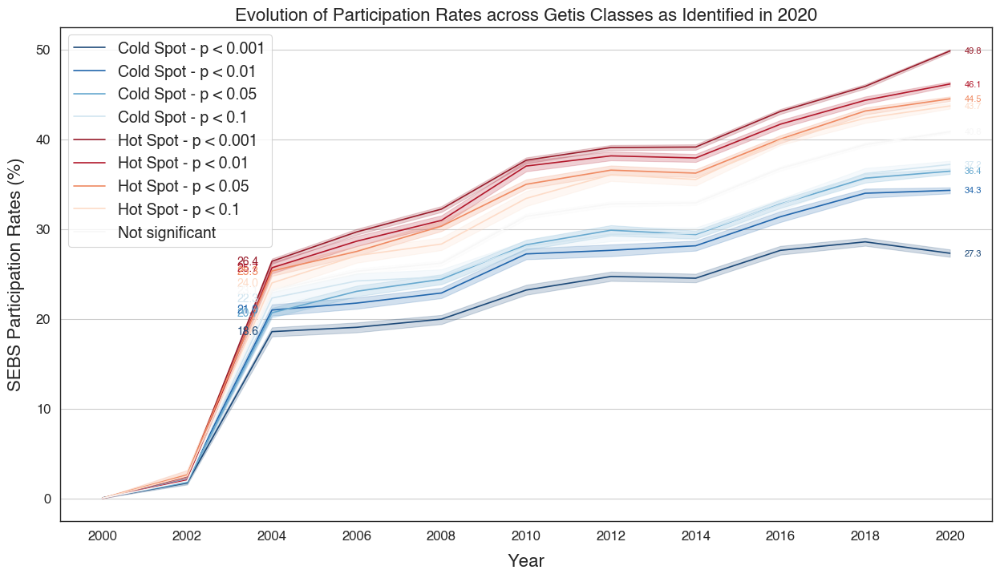

In [105]:
fig, ax = plt.subplots(figsize = (15,8))
# the size of A4 paper
g = sns.lineplot(data=df_all_years_2020ha_test, x="year_invit", y="ebs_rate", hue = 'ebs_rate_G_cl_2020',hue_order=
    ['Cold Spot - p < 0.001','Cold Spot - p < 0.01', 'Cold Spot - p < 0.05', 'Cold Spot - p < 0.1','Hot Spot - p < 0.001', 'Hot Spot - p < 0.01',
     'Hot Spot - p < 0.05', 'Hot Spot - p < 0.1', 'Not significant'], palette = colors_cl_getis,ax = ax)
for l in g.lines:
    y = l.get_ydata()
    if len(y)>0:
        g.annotate(f'{y[-1]:.1f}', xy=(0.97,y[-1]), xycoords=('axes fraction', 'data'), 
                     ha='left', va='center', color=l.get_color(), size = 8)
        g.annotate(f'{y[-9]:.1f}', xy=(0.19,y[-9]), xycoords=('axes fraction', 'data'), 
             ha='left', va='center', color=l.get_color(), size = 10)
ax.set_xlabel('Year',labelpad = 10, size = 16)
ax.set_ylabel('SEBS Participation Rates (%)',labelpad = 10, size = 16)
plt.legend(prop={'size': 14})
plt.xticks(size = 12)
plt.yticks(size = 12)
ax.grid('on', which='minor', axis='x' )
ax.grid('on', which='major', axis='y')
plt.title('Evolution of Participation Rates across Getis Classes as Identified in 2020',size = 16)
plt.savefig(figures_folder/'Evolution temporelle Getis - selon situation 2020.png', dpi = 300, bbox_inches = 'tight')

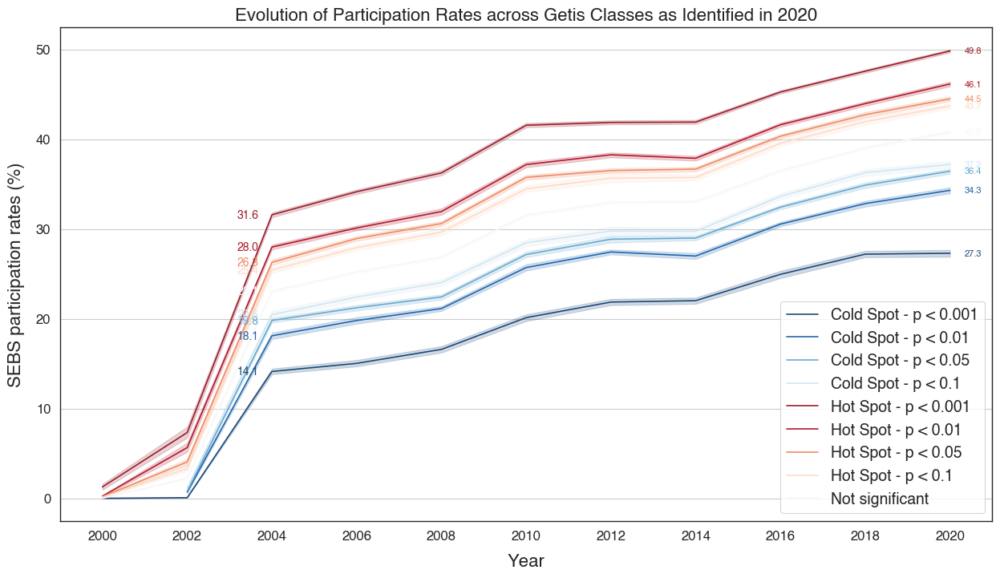

In [106]:
fig, ax = plt.subplots(figsize = (15,8))
# the size of A4 paper
g = sns.lineplot(data=df_all_years_2020ha, x="year_invit", y="ebs_rate", hue = 'ebs_rate_G_cl',hue_order=
    ['Cold Spot - p < 0.001','Cold Spot - p < 0.01', 'Cold Spot - p < 0.05', 'Cold Spot - p < 0.1','Hot Spot - p < 0.001', 'Hot Spot - p < 0.01',
     'Hot Spot - p < 0.05', 'Hot Spot - p < 0.1', 'Not significant'], palette = colors_cl_getis,ax = ax)
for l in g.lines:
    y = l.get_ydata()
    if len(y)>0:
        g.annotate(f'{y[-1]:.1f}', xy=(0.97,y[-1]), xycoords=('axes fraction', 'data'), 
                     ha='left', va='center', color=l.get_color(), size = 8)
        g.annotate(f'{y[-9]:.1f}', xy=(0.19,y[-9]), xycoords=('axes fraction', 'data'), 
             ha='left', va='center', color=l.get_color(), size = 10)
ax.set_xlabel('Year',labelpad = 10, size = 16)
ax.set_ylabel('SEBS participation rates (%)',labelpad = 10, size = 16)
plt.legend(prop={'size': 14})
plt.xticks(size = 12)
plt.yticks(size = 12)
ax.grid('on', which='minor', axis='x' )
ax.grid('on', which='major', axis='y')
plt.title('Evolution of Participation Rates across Getis Classes as Identified in 2020',size = 16)
plt.savefig(figures_folder/'Evolution temporelle Getis.png', dpi = 300, bbox_inches = 'tight')

In [107]:
data = pd.read_excel('/Users/david/Downloads/Muslim_pop.xlsx')
data['Total Population'] = data['Total Population'].str.replace(',','').str.replace('<','').str.replace("≤",'').astype(float)
data.loc[data['Muslim Population'] == '< 1,000','Muslim Population'] = '1000'
data['Muslim Population'] = data['Muslim Population'].str.replace(',','').str.replace('<','').str.replace("≤",'').astype(float)
data['Muslim percentage of total population'] = data['Muslim percentage of total population'].astype('str').str.replace('<','').str.replace("≤",'').astype(float)
data['Country/Region'] = data['Country/Region'].str.replace('\xa0','')

In [108]:
test = df_all_years[df_all_years.year_invit.isin(['1999','2000'])]

In [109]:
# Interactive mapping
# fig = px.choropleth_mapbox(test,
#                            geojson=df_haa.to_crs(4326),
#                            locations='RELI',
#                            color='ebs_rate_cl',
#                            hover_name='RELI',
#                            hover_data=['ebs_rate_cl'],
#                            color_continuous_scale='Reds',
#                            animation_frame='year_invit',
#                            mapbox_style='carto-positron',
#                            title='Cumulative Numbers of Crimes in Vancouver Neighborhoods',
#                            center={'lat':df_all_years.centroid.to_crs(4326).y.mean(), 'lon':df_all_years.centroid.to_crs(4326).x.mean()},
#                            zoom=11,
#                            opacity=0.75,
#                            labels={'Count':'Count'},
#                            width=1100,
#                            height=800
#                           )

# fig.show()
# fig.write_html("../Results/test_map.html")

In [110]:
df_ha['ebs_rate_2000'] = df_ha.RELI.map(dfs_year[0].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2002'] = df_ha.RELI.map(dfs_year[1].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2004'] = df_ha.RELI.map(dfs_year[2].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2006'] = df_ha.RELI.map(dfs_year[3].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2008'] = df_ha.RELI.map(dfs_year[4].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2010'] = df_ha.RELI.map(dfs_year[5].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2012'] = df_ha.RELI.map(dfs_year[6].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2014'] = df_ha.RELI.map(dfs_year[7].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2016'] = df_ha.RELI.map(dfs_year[8].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2018'] = df_ha.RELI.map(dfs_year[9].set_index("RELI").ebs_rate.to_dict())
df_ha['ebs_rate_2020'] = df_ha.RELI.map(dfs_year[10].set_index("RELI").ebs_rate.to_dict())

In [111]:
df_ha['2020_mammo'].sum()/df_ha['2020_invit'].sum()

0.41526710532370126

In [112]:
reli_deprivation = gdf_participation_ha.groupby('RELI').deprivation_pca.mean().to_dict()

In [113]:
df_ha['index_socio_pca'] = df_ha.RELI.map(reli_deprivation)

In [114]:
df_ha['cumul_LISA'] = 0
df_ha['cumul_LISA_9909'] = 0
df_ha['cumul_LISA_1020'] = 0

df_ha['cumul_LISA_zscore'] = 0
df_ha['cumul_LISA_9909_zscore'] = 0
df_ha['cumul_LISA_1020_zscore'] = 0

In [115]:
for df_year in dfs_year:
    _dict = df_year.set_index('RELI')['ebs_rate_Zs'].to_dict()
    df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_cl'].isin(['1 High-High','4 High-Low'])].RELI),'cumul_LISA'] +=1
    df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_cl'].isin(['3 Low-Low','2 Low-High'])].RELI),'cumul_LISA'] -=1
    df_ha['cumul_LISA_zscore'] += df_ha['RELI'].map(_dict)
    if df_year.year_invit.astype(int).unique()[0] < 2010:
        df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_cl'].isin(['1 High-High','4 High-Low'])].RELI),'cumul_LISA_9909'] +=1
        df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_cl'].isin(['3 Low-Low','2 Low-High'])].RELI),'cumul_LISA_9909'] -=1
    if  df_year.year_invit.astype(int).unique()[0] > 2009 and df_year.year_invit.astype(int).unique()[0] < 2021:
        df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_cl'].isin(['1 High-High','4 High-Low'])].RELI),'cumul_LISA_1020'] +=1
        df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_cl'].isin(['3 Low-Low','2 Low-High'])].RELI),'cumul_LISA_1020'] -=1

In [116]:
df_ha['index_socio_q3'] = pd.qcut(df_ha['index_socio_pca'], 3, labels = False)
reli_q3_deprivation = df_ha.set_index('RELI').index_socio_q3.to_dict()
df_ha['cumul_LISA_q3'] = pd.qcut(df_ha['cumul_LISA'], 3)

In [117]:
dict_cumul_LISA_q3 = df_ha.set_index('RELI')['cumul_LISA_q3'].to_dict()

In [118]:
df_ebs_over_years = pd.DataFrame(df_ha.set_index('RELI')[['ebs_rate_2000','ebs_rate_2002','ebs_rate_2004','ebs_rate_2006','ebs_rate_2008','ebs_rate_2010','ebs_rate_2012','ebs_rate_2014','ebs_rate_2016','ebs_rate_2018','ebs_rate_2020']].stack(), columns = ['ebs_rate']).reset_index()
df_ebs_over_years.columns = ['RELI','year','ebs_rate']
df_ebs_over_years['year'] = df_ebs_over_years['year'].str.replace('ebs_rate_','')
df_ebs_over_years['index_socio_pca'] = df_ebs_over_years.RELI.map(reli_deprivation)
df_ebs_over_years['index_socio_q3'] = df_ebs_over_years.RELI.map(reli_q3_deprivation)
df_ebs_over_years['cumul_LISA_q3'] = df_ebs_over_years.RELI.map(dict_cumul_LISA_q3)

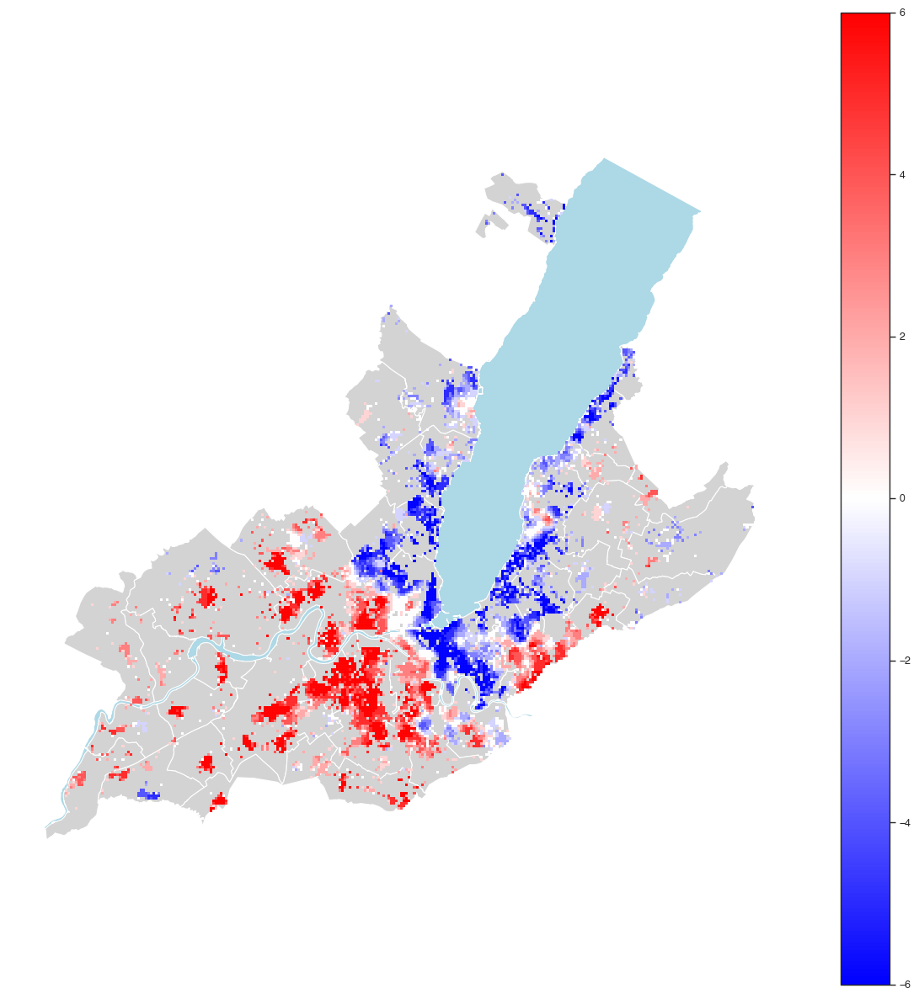

In [119]:
fig, ax = plt.subplots(figsize = (15, 15))
df_ha.plot('cumul_LISA_1020',cmap = 'bwr', ax = ax,linewidth = 0.01, legend = True, zorder = 3)
communes.plot(color = 'lightgrey', ax = ax, zorder = 1)
lake.plot(color = 'lightblue',ax = ax, zorder = 2)
ax.set_axis_off()

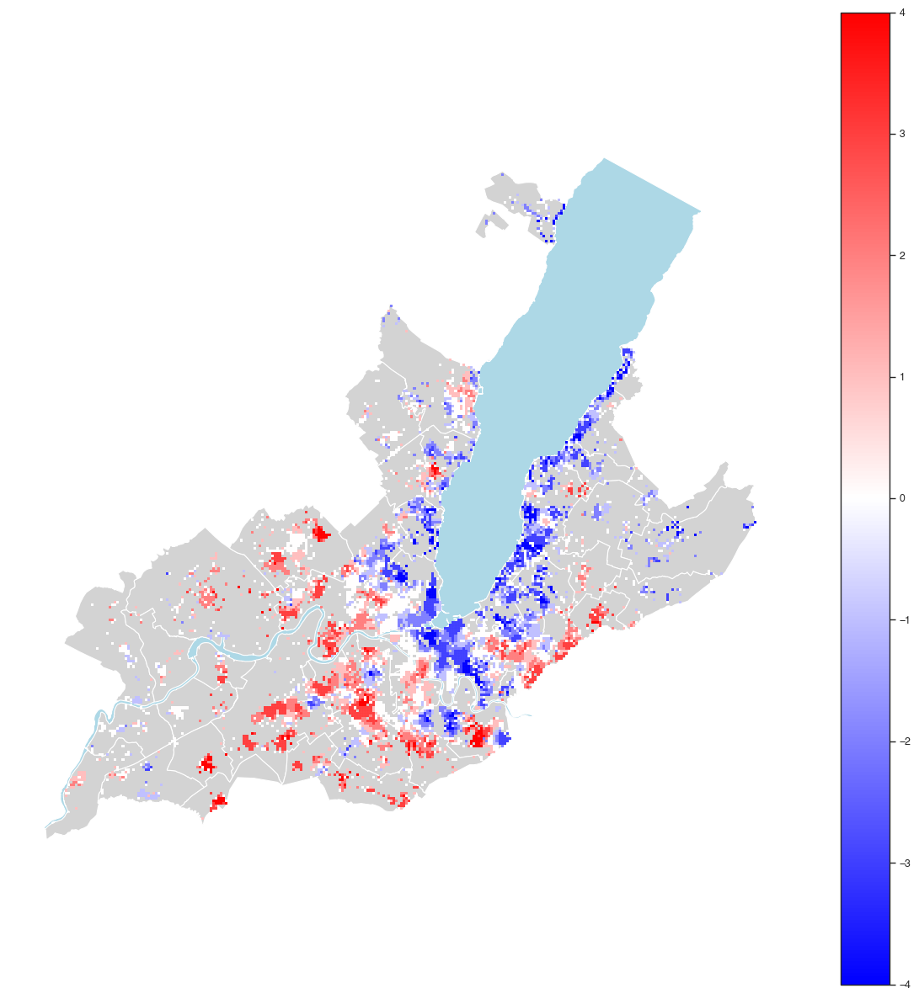

In [120]:
fig, ax = plt.subplots(figsize = (15, 15))
df_ha.plot('cumul_LISA_9909', legend = True, cmap = 'bwr', linewidth = 0.01, ax = ax, zorder = 3)
communes.plot(color = 'lightgrey', ax = ax, zorder = 1)
lake.plot(color = 'lightblue',ax = ax, zorder = 2)
ax.set_axis_off()

In [121]:
df_heatmap = df_ebs_over_years.groupby(['cumul_LISA_q3','index_socio_q3']).mean().reset_index()
df_heatmap = df_heatmap.pivot(index = 'cumul_LISA_q3',columns = 'index_socio_q3', values = 'ebs_rate')
df_heatmap.columns = ['Low','Medium','High']
df_heatmap = df_heatmap.sort_values('cumul_LISA_q3', ascending = False)

/var/folders/vs/k61m7qc90ds735nc0468d1x80000gn/T/ipykernel_25678/1976093051.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [122]:
df_ha.loc[df_ha['index_socio_q3'] == 0,'index_socio_q3'] = 'Low'
df_ha.loc[df_ha['index_socio_q3'] == 1,'index_socio_q3'] = 'Medium'
df_ha.loc[df_ha['index_socio_q3'] == 2,'index_socio_q3'] = 'High'

In [123]:
df_ha['index_socio_q3'] = pd.Categorical(df_ha['index_socio_q3'],categories = ['Low','Medium','High'], ordered = True)

In [124]:
dict_cl = {np.nan:'#bababa',"High":'#d7191c',
3:'#fdae61',
'Medium':'#ffffbf',
1:'#abd9e9',
"Low":'#2c7bb6'}

In [125]:
hmap = colors.ListedColormap([dict_cl[i] for i in df_ha['index_socio_q3'].sort_values().unique()])

In [126]:
# df_ha[['cumul_LISA_q3','cumul_LISA_res_q3','index_socio_q3']] = df_ha[['cumul_LISA_q3','cumul_LISA_res_q3','index_socio_q3']].astype(str)

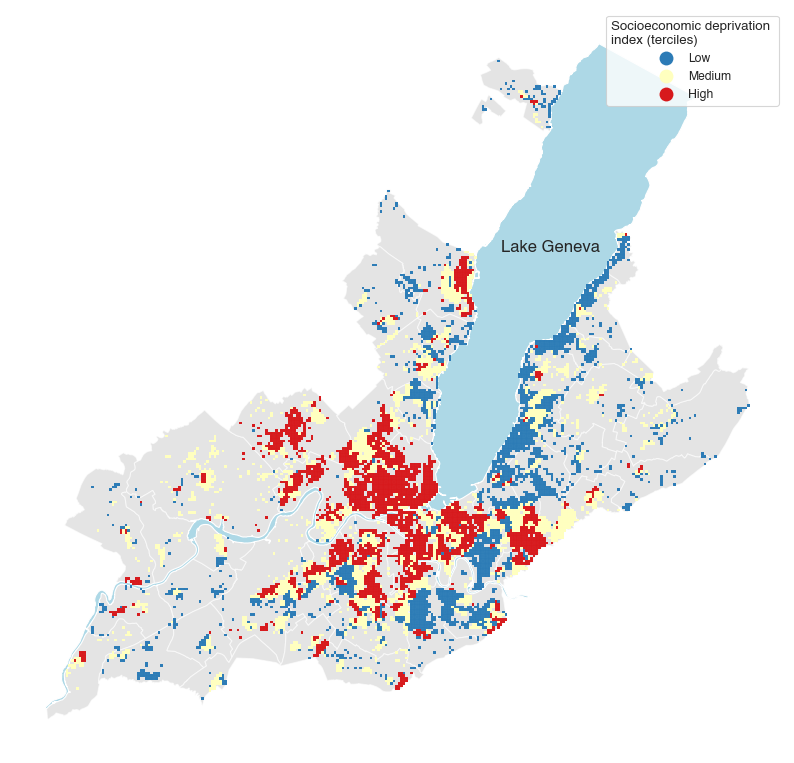

In [127]:
fig, ax = plt.subplots(figsize = (10, 10))
df_ha.plot('index_socio_q3', legend = True, cmap = hmap, categorical = True,linewidth = 0.01, ax = ax, zorder = 3, legend_kwds = {'title':'Socioeconomic deprivation \nindex (terciles)'})
communes.plot(color = 'lightgrey', alpha = 0.6, ax = ax, zorder = 1)
lake.plot(color = 'lightblue',ax = ax, zorder = 2)
lake.apply(lambda x: ax.annotate(text=x.NOM, xy=x.geometry.centroid.coords[0], ha='center', size=12), axis=1)
ax.set_axis_off()
plt.savefig('../Results/Deprivation_index.png', dpi = 98, bbox_inches = 'tight')

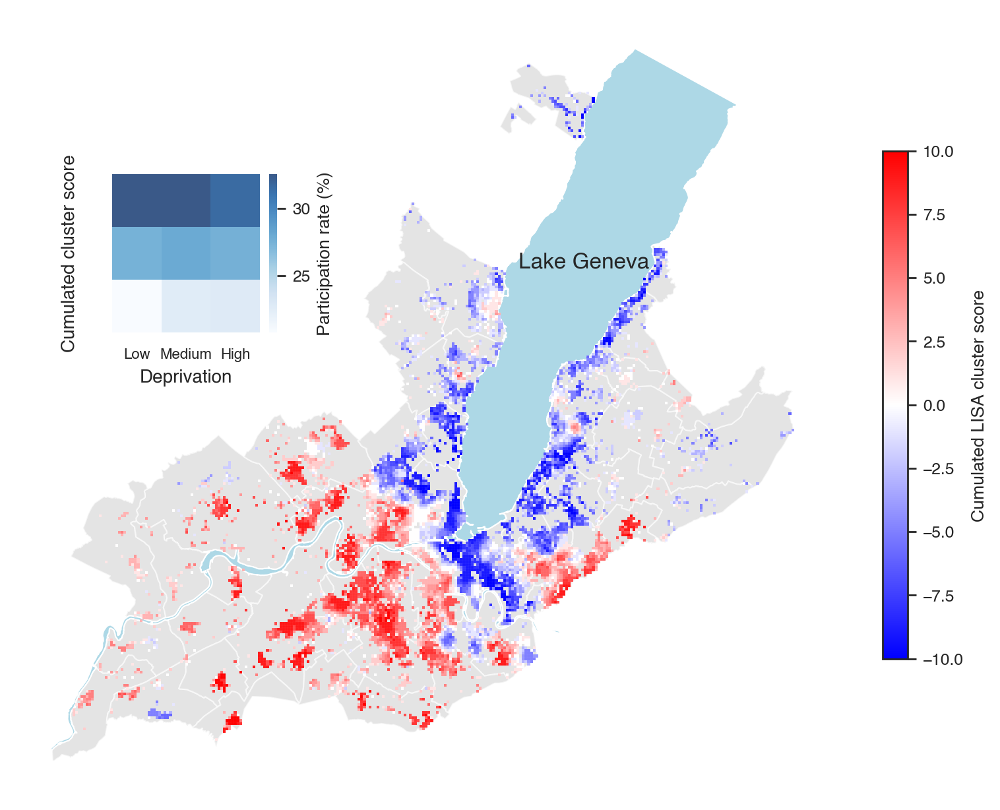

In [128]:
%config InlineBackend.figure_format ='retina'

fig, ax = plt.subplots(figsize = (10, 10))
df_ha.plot('cumul_LISA', legend = True,linewidth = 0.01, cmap = 'bwr', ax = ax, zorder = 3, legend_kwds = {'label':'Cumulated LISA cluster score','shrink':0.5})
communes.plot(color = 'lightgrey', alpha = 0.6, ax = ax, zorder = 1)
lake.plot(color = 'lightblue',ax = ax, zorder = 2)
lake.apply(lambda x: ax.annotate(text=x.NOM, xy=x.geometry.centroid.coords[0], ha='center', size=12), axis=1)
ax.set_axis_off()

left, bottom, width, height = [0.2, 0.55, 0.14, 0.12]
ax2 = fig.add_axes([left, bottom, width, height])
sns.set_context("paper")
x_label = 'Deprivation'
y_label = 'Cumulated cluster score'
chart = sns.heatmap(df_heatmap, cmap = 'Blues', alpha = 0.8, cbar_kws={'label': 'Participation rate (%)'})
chart.set_xticklabels(chart.get_xticklabels(),size=8, rotation=0, horizontalalignment='center')
chart.set_yticklabels(chart.get_yticklabels(),color = 'white', size=0, rotation=0, horizontalalignment='right')

plt.tick_params(bottom = False, left = False)

chart.set_xlabel(x_label, size=10)
chart.set_ylabel(y_label, size=10)


plt.savefig('../Results/LISA - Hectares/Cumulated LISA/Biannual_LISA_cumulated_raw_wnn16_005.png', dpi = 300, bbox_inches = 'tight')
# plt.savefig('../Results/LISA - Hectares/Cumulated LISA/Biannual_LISA_cumulated_raw_wnn16_005.pdf', bbox_inches = 'tight')

In [129]:
high_low_ebs_raw = df_ha. groupby('cumul_LISA_q3').mean().round(1).filter(regex = 'ebs')
# high_low_ebs_adj = df_ha.groupby('cumul_LISA_res_q3').mean().round(1).filter(regex = 'ebs')

/var/folders/vs/k61m7qc90ds735nc0468d1x80000gn/T/ipykernel_25678/4294894189.py:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [130]:
# fig, ax = plt.subplots(figsize = (15,8))
# # the size of A4 paper
# g = sns.lineplot(data=df_all_years_2018ha.groupby(['year_invit','ebs_rate_cl']).mean().reset_index(), x="year_invit", y="ebs_rate", hue = 'ebs_rate_cl', palette = colors_cl, ci = 95,ax = ax)
# for l in g.lines:
#     y = l.get_ydata()
#     if len(y)>0:
#         g.annotate(f'{y[-1]:.1f}', xy=(1,y[-1]), xycoords=('axes fraction', 'data'), 
#                      ha='left', va='center', color=l.get_color(), size = 12)
# ax.set_xlabel('Date',labelpad = 10, size = 16)
# ax.set_ylabel('Taux de vaccination (%)',labelpad = 10, size = 16)
# plt.legend(prop={'size': 14})
# plt.xticks(size = 12)
# plt.yticks(size = 12)
# ax.grid('on', which='minor', axis='x' )
# ax.grid('on', which='major', axis='y')
# plt.title('Evolution du taux de participation au sein des clusters locaux (LISA) identifiés en 2018',size = 16)

In [131]:
# df_ha.groupby('index_socio_q5').agg({'mean','std'}).round(1).filter(regex = 'ebs')

## Space-time cube clustering

In [132]:
import pymannkendall as mk

In [133]:
df_space_time_cube = pd.concat(dfs_year[1:])[['RELI','year_invit','ebs_rate_G_Zs','ebs_rate_G_cl','geometry']]
df_space_time_cube['time'] = df_space_time_cube['year_invit'].astype(int).sub(2002).div(2)
# df_space_time_cube.groupby('RELI').ebs_rate_G_cl.apply(list)

In [134]:
from itertools import groupby
from operator import itemgetter

In [135]:
def get_consecutive(lst, max_time):
    consec_lsts = []
    for k, g in groupby(enumerate(lst), lambda ix : ix[0] - ix[1]):
        consecutive_list = list(map(itemgetter(1), g))
#         print(consecutive_list)
        consec_lsts.append(consecutive_list)
#         print(len(consec_lsts))
        if len(consec_lsts) > 1:
            return np.nan
        else:
            if max_time in consecutive_list and len(consecutive_list)>1:
                
                return consecutive_list
            else:
                return np.nan

Point chaud consécutif

Localisation représentant une série unique ininterrompue d’au moins deux groupes de points chauds statistiquement significatifs dans les intervalles temporels finaux. La localisation n’a jamais été un point chaud statistiquement significatif avant la série finale de points chauds et moins de 90 pour cent de tous les groupes représentent des points chauds statistiquement significatifs.

Intensification de point chaud

Localisation ayant représenté un point chaud statistiquement significatif pour 90 pour cent des intervalles temporels, y compris l’intervalle temporel final. En outre, l'intensité de l'agrégation de nombres élevés dans chaque intervalle temporel augmente globalement et cette augmentation est statistiquement significative.

Point chaud persistant

Localisation ayant représenté un point chaud statistiquement significatif pour 90 pour cent des intervalles temporels, sans tendance perceptible de l’intensité de l’agrégation au fil du temps.

Point chaud diminuant

Localisation ayant représenté un point chaud statistiquement significatif pour 90 pour cent des intervalles temporels, y compris l’intervalle temporel final. En outre, l'intensité de l'agrégation dans chaque intervalle temporel diminue globalement et cette diminution est statistiquement significative.

Point chaud sporadique

Point chaud statistiquement significatif pour l’intervalle temporel final avec un historique de point chaud réactivé, puis désactivé. Moins de 90 % des intervalles temporels ont été des points chauds statistiquement significatifs et aucun des intervalles temporels n’a été un point froid statistiquement significatif.

Point chaud oscillant

Point chaud statistiquement significatif pour l'intervalle temporel final et qui a également été un point froid statistiquement significatif durant un intervalle temporel précédent. Moins de 90 pour cent des intervalles temporels ont été des points chauds statistiquement significatifs.

Point chaud historique

La période la plus récente n’est pas chaude, mais au moins 90 pour cent des intervalles temporels ont été des points chauds statistiquement significatifs.

In [136]:
def spatiotemporal_getis_cats_prep(df,class_col, z_col, max_time):
    df_cats_prep = pd.DataFrame(pd.DataFrame(df.RELI.unique(), columns = ['RELI'])).set_index('RELI')
    getis_cl_lst = df.groupby('RELI')[class_col].apply(list)
    getis_Zs_lst = df.groupby('RELI')[z_col].apply(list)
    getis_hs_index = getis_cl_lst.apply(lambda x: [i for i, s in enumerate(x) if 'Hot' in s])
    getis_cs_index = getis_cl_lst.apply(lambda x: [i for i, s in enumerate(x) if 'Cold' in s])
    df_cats_prep['hs_index'] = getis_hs_index
    df_cats_prep['cs_index'] = getis_cs_index
    df_cats_prep['all_hs_cnt'] = getis_cl_lst.apply(lambda x: sum('Hot' in s for s in x))
    df_cats_prep['all_cs_cnt'] = getis_cl_lst.apply(lambda x: sum('Cold' in s for s in x))
    df_cats_prep['perc_hs'] = df_cats_prep['all_hs_cnt'].div(df['time'].nunique()).mul(100)
    df_cats_prep['perc_cs'] = df_cats_prep['all_cs_cnt'].div(df['time'].nunique()).mul(100)

    # Temporal trend
    df_cats_prep['trend'] = getis_Zs_lst.apply(lambda x: mk.original_test(x).trend if len(x) > 1 else np.nan)

    
    # Consecutive hot spot, consecutive cold spot
    df_cats_prep['consecutive_hs'] = getis_hs_index.apply(lambda x: get_consecutive(x, max_time))
    df_cats_prep['consecutive_cs'] = getis_cs_index.apply(lambda x: get_consecutive(x, max_time))
    df_cats_prep.loc[(df_cats_prep.hs_index.astype(str) == '[%s]'%(max_time)), 'class'] = 'New Hot Spot'
    df_cats_prep.loc[(df_cats_prep.perc_hs < 90)&(df_cats_prep.consecutive_hs.isnull()==False), 'class'] = 'Consecutive Hot Spot'
    df_cats_prep.loc[(df_cats_prep.perc_hs >= 90)&(df_cats_prep.consecutive_hs.isnull()==False)&(df_cats_prep.trend == 'increasing'), 'class'] = 'Intensifying Hot Spot'
    df_cats_prep.loc[(df_cats_prep.perc_hs >= 90)&(df_cats_prep.consecutive_hs.isnull()==False)&(df_cats_prep.trend == 'no trend'), 'class'] = 'Persistent Hot Spot'
    df_cats_prep.loc[(df_cats_prep.perc_hs >= 90)&(df_cats_prep.consecutive_hs.isnull()==False)&(df_cats_prep.trend == 'decreasing'), 'class'] = 'Diminishing Hot Spot'
    df_cats_prep.loc[(df_cats_prep.perc_hs < 90)&(df_cats_prep.hs_index.astype(str).str.contains('%s]'%(max_time)))&(df_cats_prep.all_cs_cnt == 0)&(df_cats_prep.all_hs_cnt > 1), 'class'] = 'Sporadic Hot Spot'
    df_cats_prep.loc[(df_cats_prep.perc_hs < 90)&(df_cats_prep.hs_index.astype(str).str.contains('%s]'%(max_time)))&(df_cats_prep.all_cs_cnt > 0), 'class'] = 'Oscillating Hot Spot'
    df_cats_prep.loc[(df_cats_prep.perc_hs >= 50)&(df_cats_prep.hs_index.astype(str).str.contains('%s]'%(max_time)) == False), 'class'] = 'Historical Hot Spot'

    df_cats_prep.loc[(df_cats_prep.cs_index.astype(str) == '[%s]'%(max_time)), 'class'] = 'New Cold Spot'
    df_cats_prep.loc[(df_cats_prep.perc_cs < 90)&(df_cats_prep.consecutive_cs.isnull()==False), 'class'] = 'Consecutive Cold Spot'
    df_cats_prep.loc[(df_cats_prep.perc_cs >= 90)&(df_cats_prep.consecutive_cs.isnull()==False)&(df_cats_prep.trend == 'increasing'), 'class'] = 'Intensifying Cold Spot'
    df_cats_prep.loc[(df_cats_prep.perc_cs >= 90)&(df_cats_prep.consecutive_cs.isnull()==False)&(df_cats_prep.trend == 'no trend'), 'class'] = 'Persistent Cold Spot'
    df_cats_prep.loc[(df_cats_prep.perc_cs >= 90)&(df_cats_prep.consecutive_cs.isnull()==False)&(df_cats_prep.trend == 'decreasing'), 'class'] = 'Diminishing Cold Spot'
    df_cats_prep.loc[(df_cats_prep.perc_cs < 90)&(df_cats_prep.cs_index.astype(str).str.contains('%s]'%(max_time)))&(df_cats_prep.all_hs_cnt == 0)&(df_cats_prep.all_cs_cnt > 1), 'class'] = 'Sporadic Cold Spot'
    df_cats_prep.loc[(df_cats_prep.perc_cs < 90)&(df_cats_prep.cs_index.astype(str).str.contains('%s]'%(max_time)))&(df_cats_prep.all_cs_cnt > 0), 'class'] = 'Oscillating Cold Spot'
    df_cats_prep.loc[(df_cats_prep.perc_cs >= 50)&(df_cats_prep.cs_index.astype(str).str.contains('%s]'%(max_time)) == False), 'class'] = 'Historical Cold Spot'
    df_cats_prep.loc[df_cats_prep['class'].isnull(),'class'] = 'No Pattern Detected'
    return df_cats_prep

In [137]:
# df_space_time_cube.loc[df_space_time_cube['ebs_rate_G_cl'].str.contains('p < 0.1'),'ebs_rate_G_cl'] = 'Not significant'

In [138]:
df_emergent_getis = spatiotemporal_getis_cats_prep(df_space_time_cube,'ebs_rate_G_cl','ebs_rate_G_Zs', 9)

In [139]:
df_emergent_getis['class'].value_counts()

No Pattern Detected      2658
Historical Cold Spot      906
Historical Hot Spot       810
Oscillating Cold Spot     790
Sporadic Hot Spot         579
Oscillating Hot Spot      564
Persistent Hot Spot       388
Persistent Cold Spot      323
Diminishing Cold Spot     109
Intensifying Hot Spot      71
New Hot Spot               11
Diminishing Hot Spot        7
Name: class, dtype: int64

In [140]:
df_ha = df_ha.set_index('RELI')

In [141]:
df_emergent_getis['geometry'] = df_ha['geometry']

In [142]:
df_all_years_2020ha = df_all_years_2020ha.set_index('RELI')
df_all_years_2020ha['class_emergent_getis'] = df_emergent_getis['class']

In [143]:
df_emergent_getis = gpd.GeoDataFrame(df_emergent_getis, crs = 2056, geometry = df_emergent_getis['geometry'])

In [144]:
# df_ha = df_ha.set_index("RELI")

In [145]:
colors_cl_getis = { 'New Cold Spot':'#eff3ff',
                    'Diminishing Cold Spot': "#80cdc1",
                    'Persistent Cold Spot':'#313695',
                    'Historical Cold Spot':'#2166ac',
                    'Sporadic Cold Spot':'#67a9cf',
                    'Oscillating Cold Spot':'#d1e5f0',
                    'Intensifying Cold Spot':'#c51b8a',
                    'Persistent Hot Spot':'#e41a1c',
                    'Historical Hot Spot':'#b2182b',
                    'Sporadic Hot Spot':'#ef8a62',
                    'Oscillating Hot Spot':'#fddbc7',
                    'Intensifying Hot Spot':'#e7298a',
                    'New Hot Spot':'#ffeda0',
                    'Diminishing Hot Spot': "#fb9a99",
                    'No Pattern Detected':'#f0f0f0'}
hmap = colors.ListedColormap([colors_cl_getis[i] for i in df_emergent_getis['class'].sort_values().unique()])

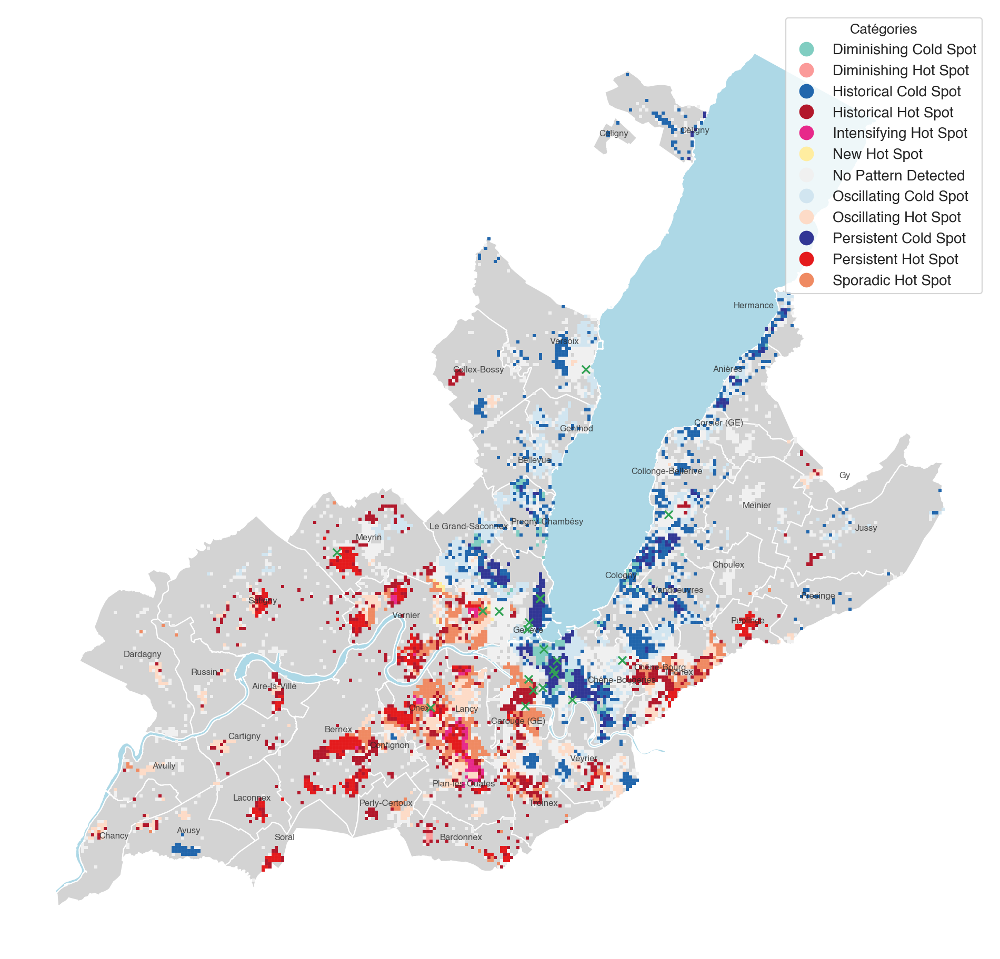

In [146]:
ax = df_emergent_getis.plot('class', cmap = hmap, figsize = (12,12), zorder = 3, linewidth = 0.01, legend = True, legend_kwds = {'title':'Catégories','fontsize':10})
communes.plot(color = 'lightgrey', ax = ax, zorder = 1)
lake.plot(color = 'lightblue',ax = ax, zorder = 2)
ax.set_axis_off()
communes.apply(lambda x: ax.annotate(text=x.NAME, xy=x.geometry.centroid.coords[0], ha='center', size=6, alpha = 0.8),
               axis=1)
gdf_centre.plot(c = '#31a354', markersize = 30, alpha = 1, marker = 'x', ax = ax, zorder = 6)

plt.savefig(figures_folder/'Emergent Getis.png', dpi = 300, bbox_inches = 'tight')

In [207]:
import warnings
def masked_emergent_getis(gdf, category):
    fig, ax = plt.subplots(figsize=(8, 8))
    mask_quadrant = ~(gdf['class'] == category)
    non_quadrant = gdf[mask_quadrant]
    df_quadrant = gdf[~mask_quadrant]
    union2 = df_quadrant.unary_union.boundary
    communes.plot(color = 'lightgrey', ax = ax, zorder = 1)
    lake.plot(color = 'lightblue',ax = ax, zorder = 2)
    with warnings.catch_warnings():  # temorarily surpress geopandas warning
        warnings.filterwarnings('ignore', category=UserWarning)
        gdf.plot('class', linewidth = 0.01, cmap = hmap, ax=ax, alpha=1, zorder=1, legend = True, legend_kwds = {'title':'Categories','fontsize':8})
        non_quadrant.plot(color = 'white',alpha = 0.9,linewidth=0, zorder = 4, ax = ax)
    gpd.GeoSeries([union2]).plot(linewidth=0.3, ax=ax, color='black', zorder = 4)
#     communes.apply(lambda x: ax.annotate(text=x.NAME, xy=x.geometry.centroid.coords[0], ha='center', size=6, alpha = 0.8, zorder = 5), axis=1)
    lake.apply(lambda x: ax.annotate(text=x.NOM, xy=x.geometry.centroid.coords[0], ha='center', size=6, alpha = 0.8, zorder = 5), axis=1)
#     gdf_centre.plot(c = '#31a354', markersize = 25, alpha = 0.8, marker = 'x', ax = ax, zorder = 6)
    ax.set_axis_off()
    ax.set_title(category)
    return fig, ax


Diminishing Cold Spot
No Pattern Detected
Persistent Cold Spot
Historical Cold Spot
Sporadic Hot Spot
Oscillating Cold Spot
Persistent Hot Spot
Historical Hot Spot
Oscillating Hot Spot
Intensifying Hot Spot
New Hot Spot
Diminishing Hot Spot


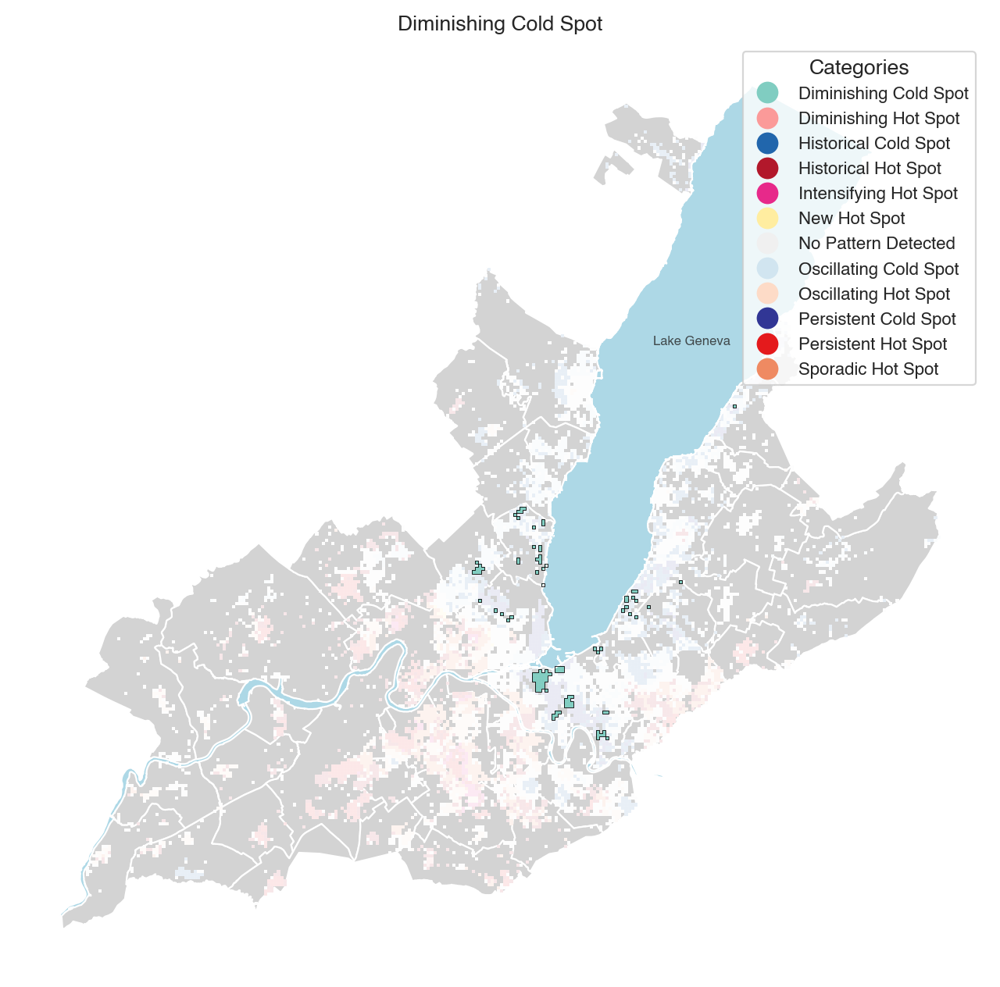

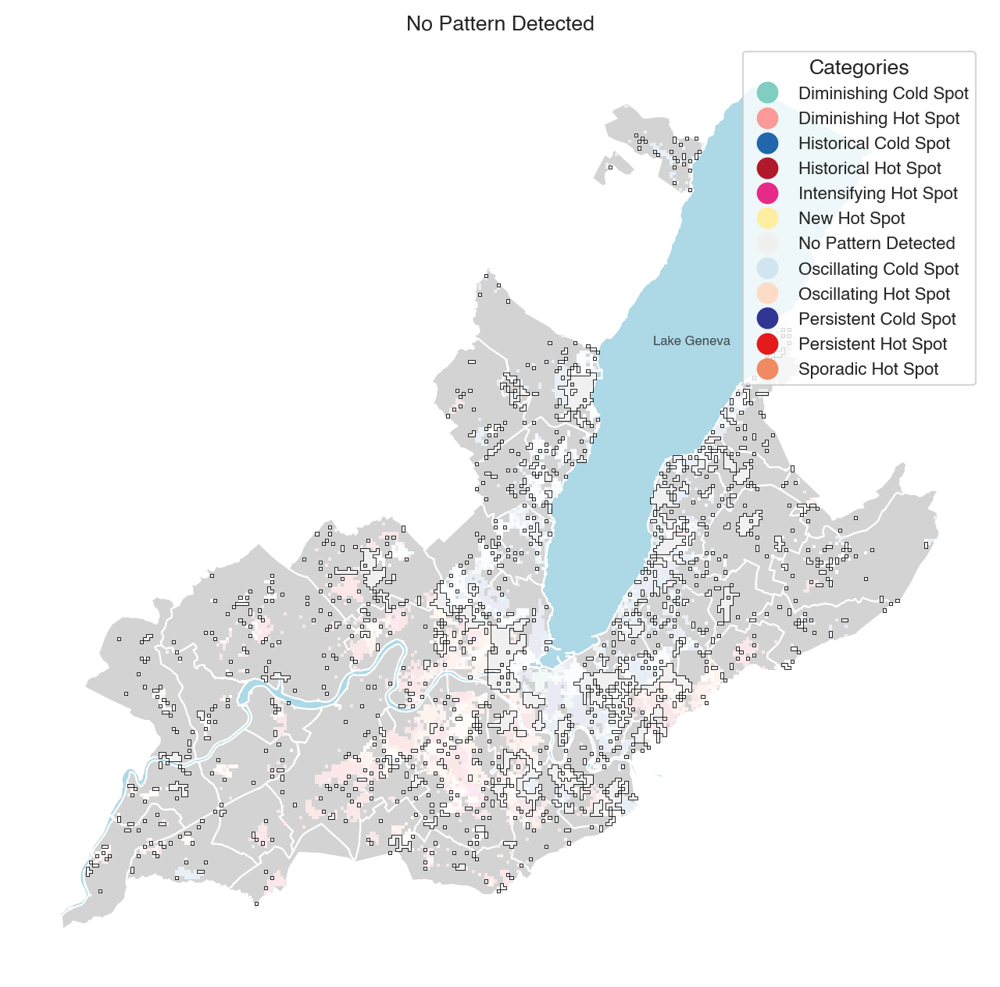

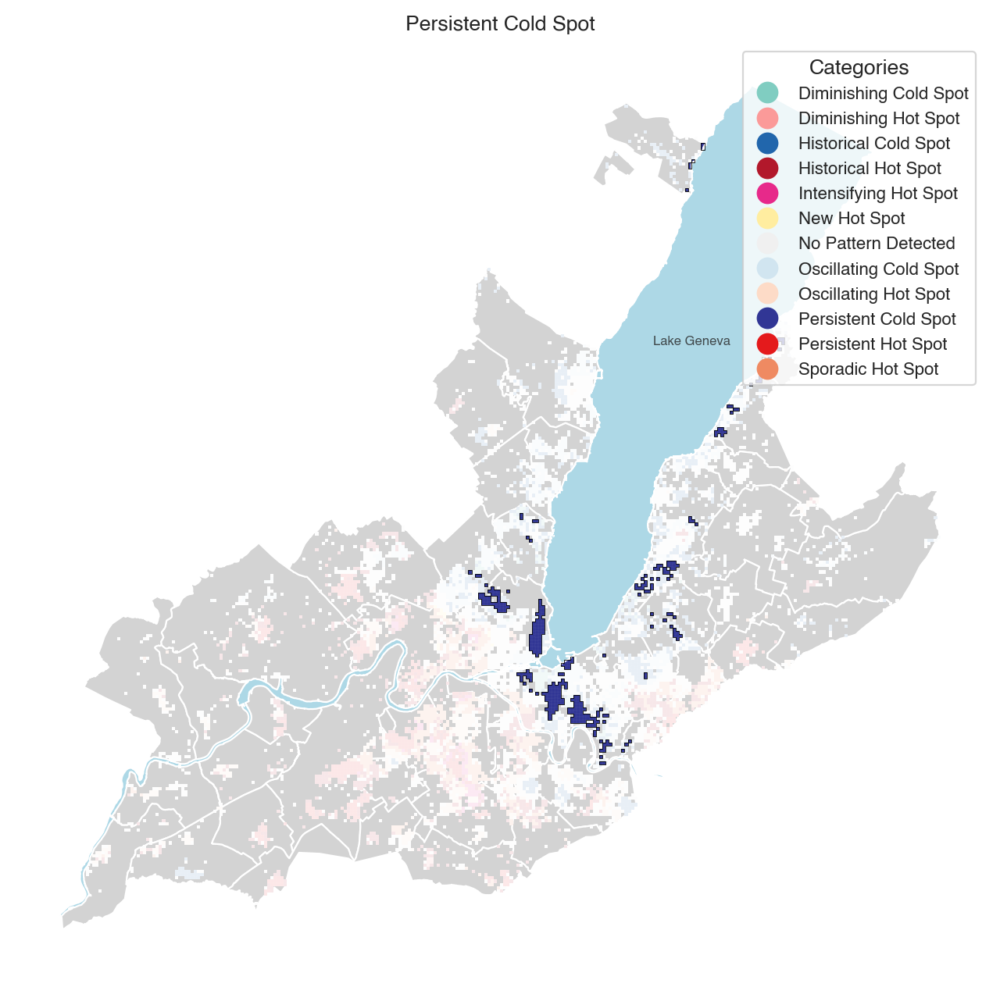

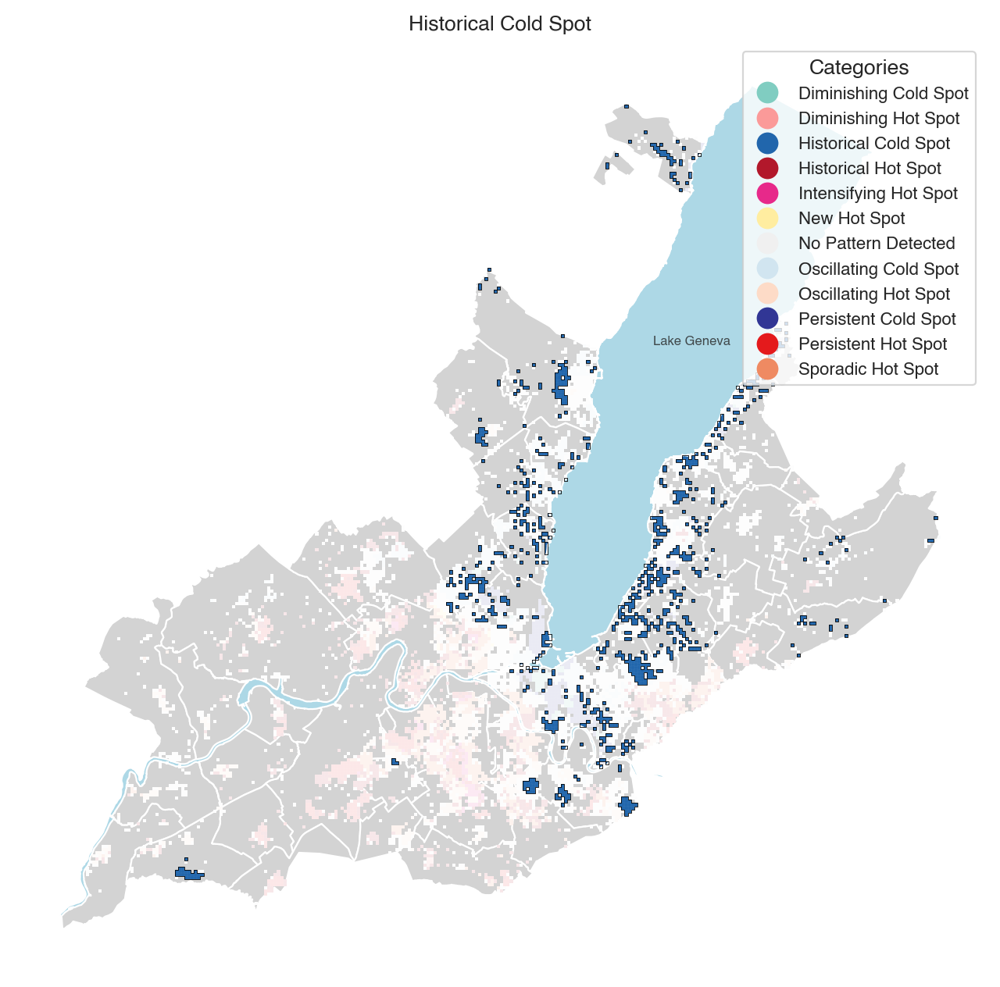

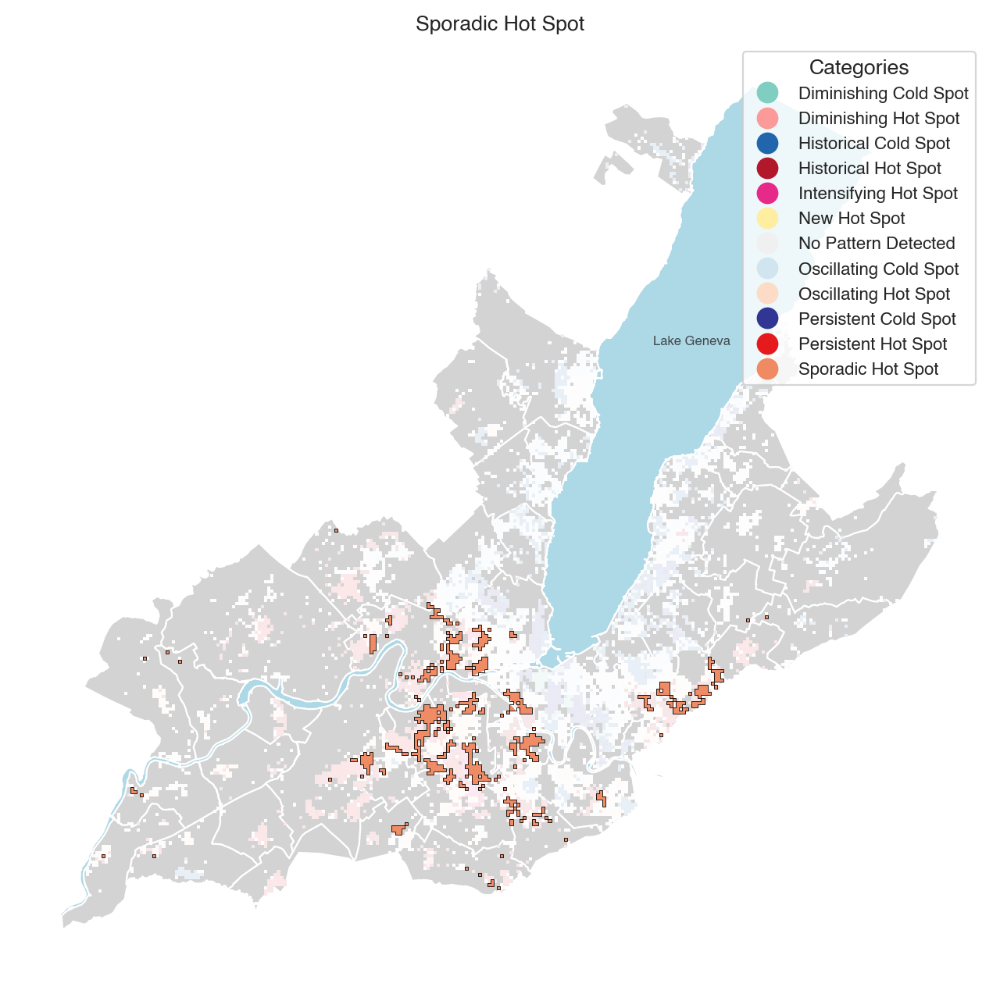

...

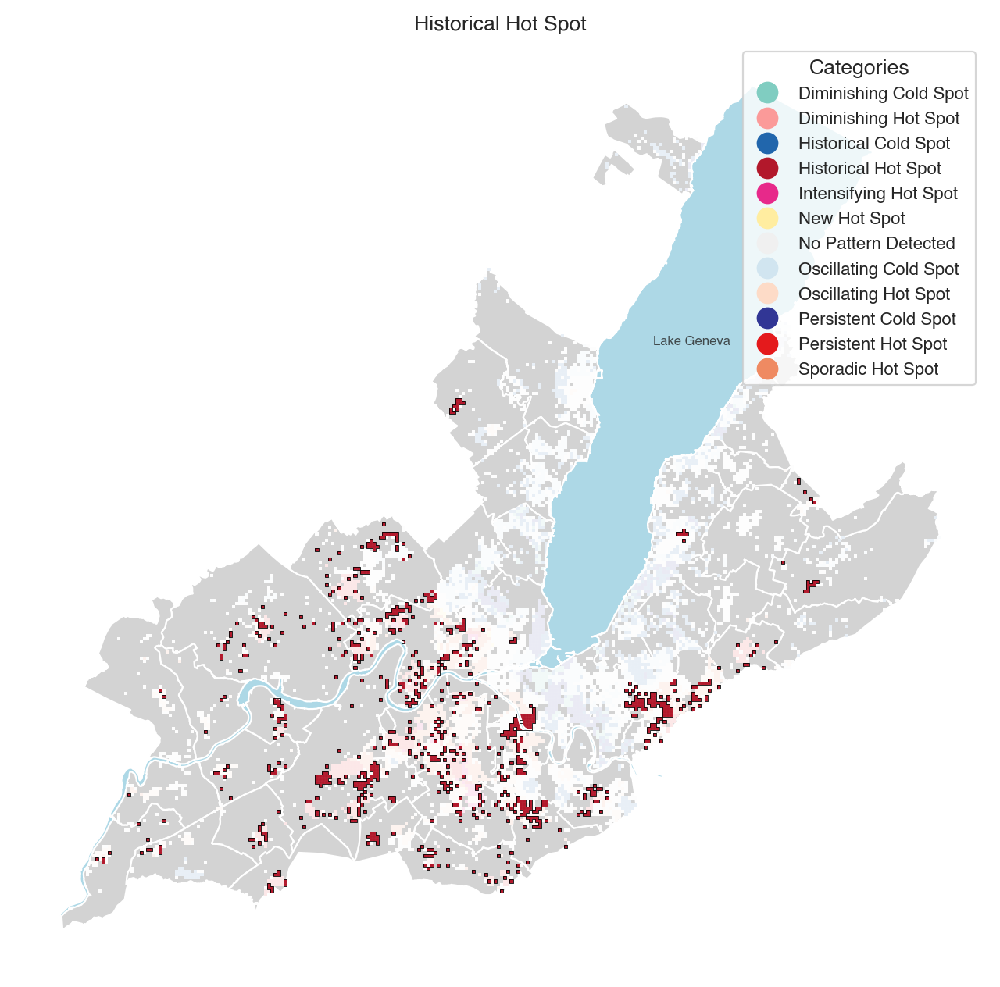

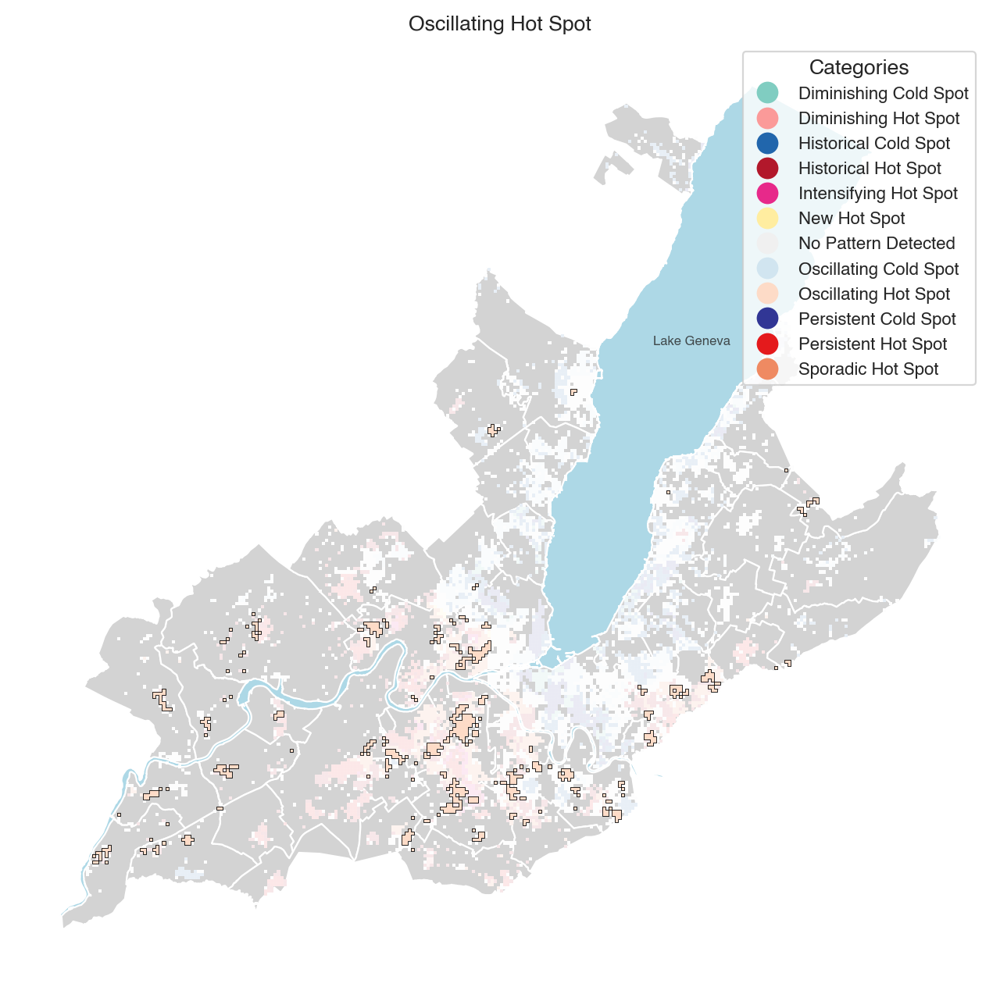

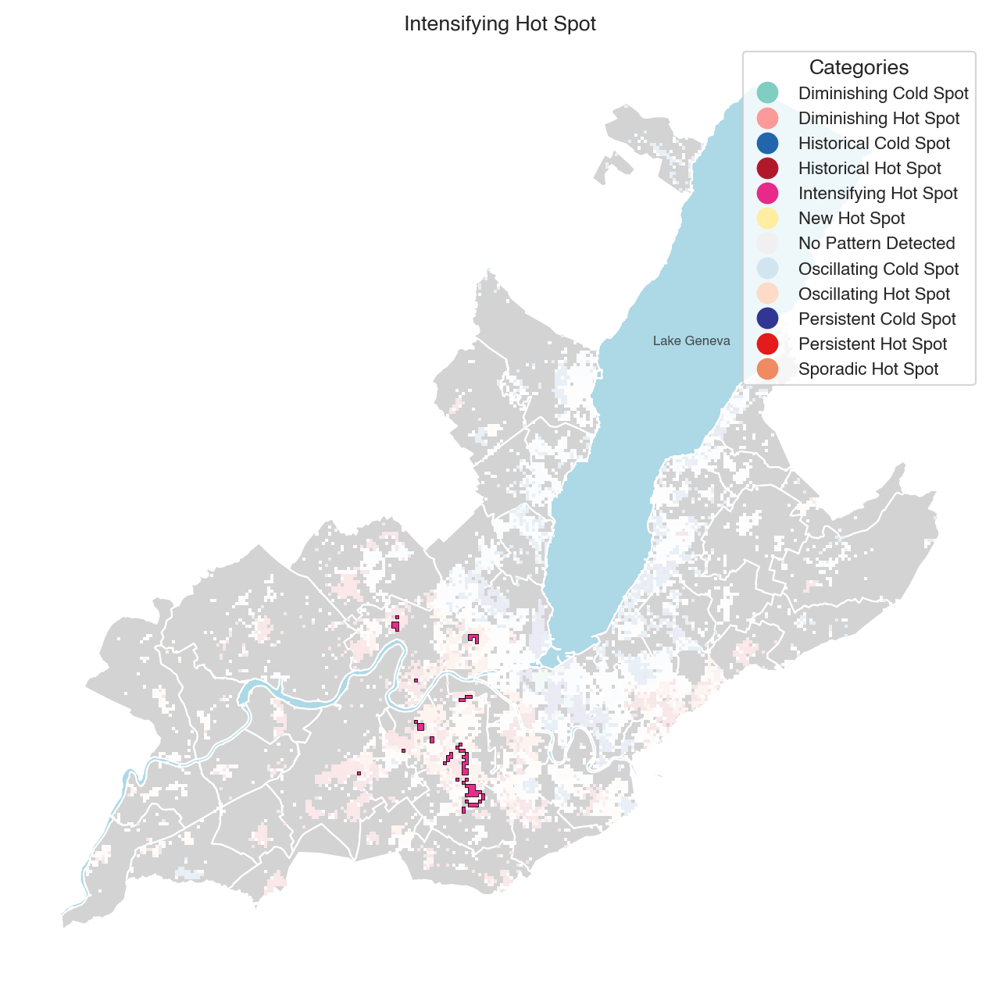

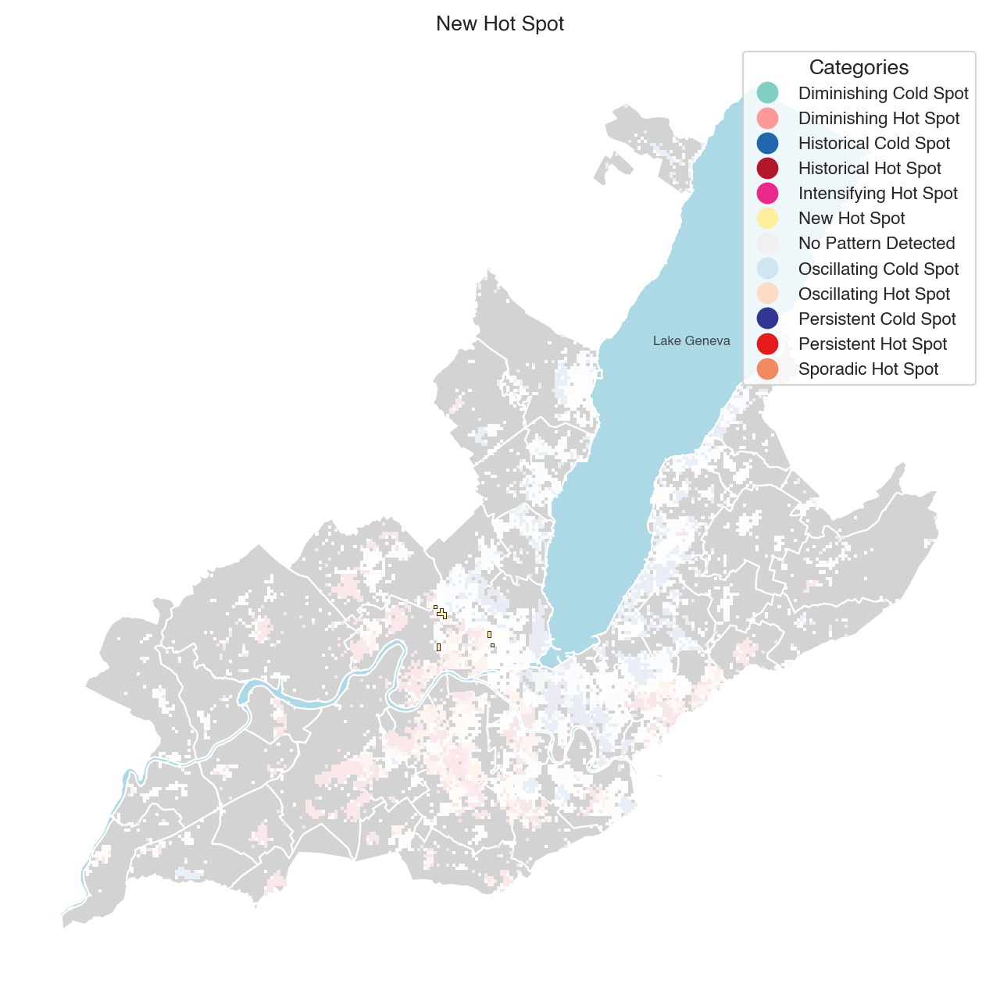

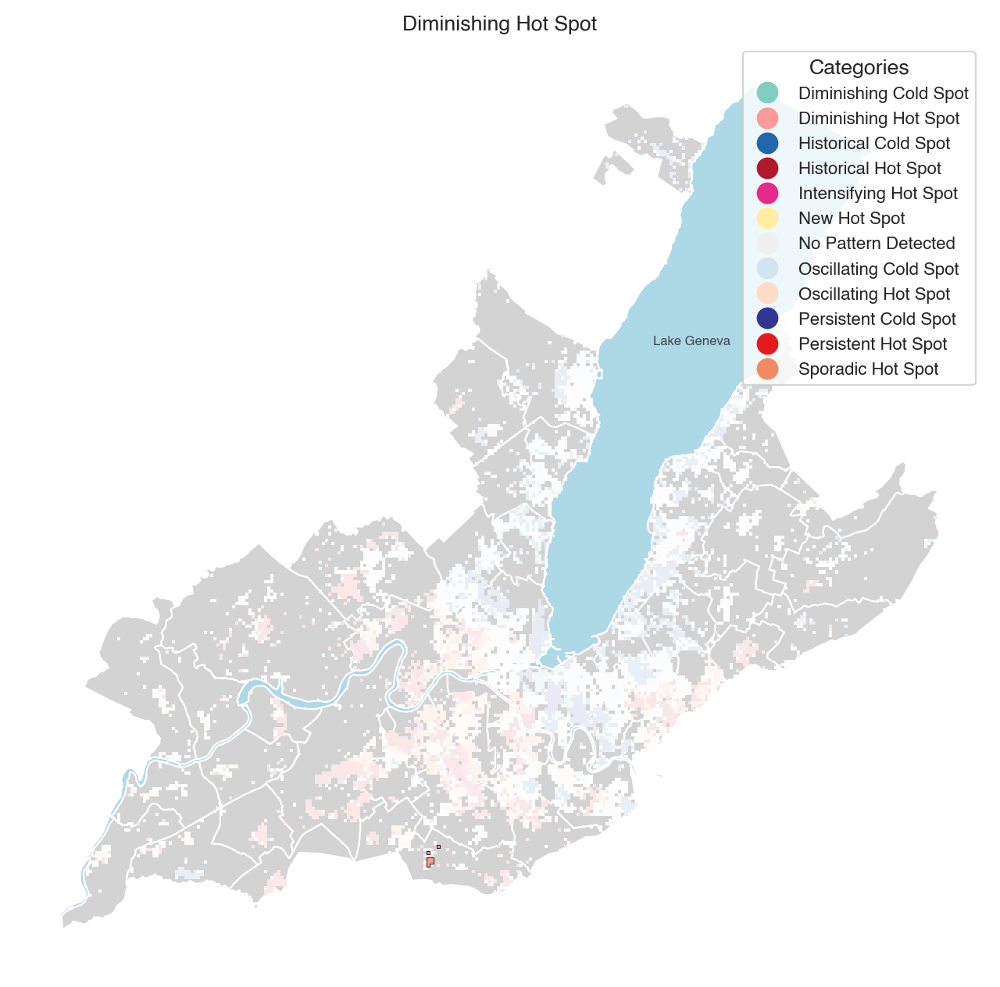

In [212]:
for category in df_emergent_getis['class'].unique():
    print(category)
    masked_emergent_getis(df_emergent_getis, category)
    filename = 'Biannual_2002_2020_emergent_Getis_%s.png'%(category)
    plt.savefig(figures_folder/filename, dpi = 300, bbox_inches = 'tight')

In [208]:
from statannotations.Annotator import Annotator

In [150]:
data_2020 = df_all_years_2020ha[df_all_years_2020ha.year_invit == '2020']

In [151]:
data_2020['class_emergent_getis'] = data_2020['class_emergent_getis'].astype('string')

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



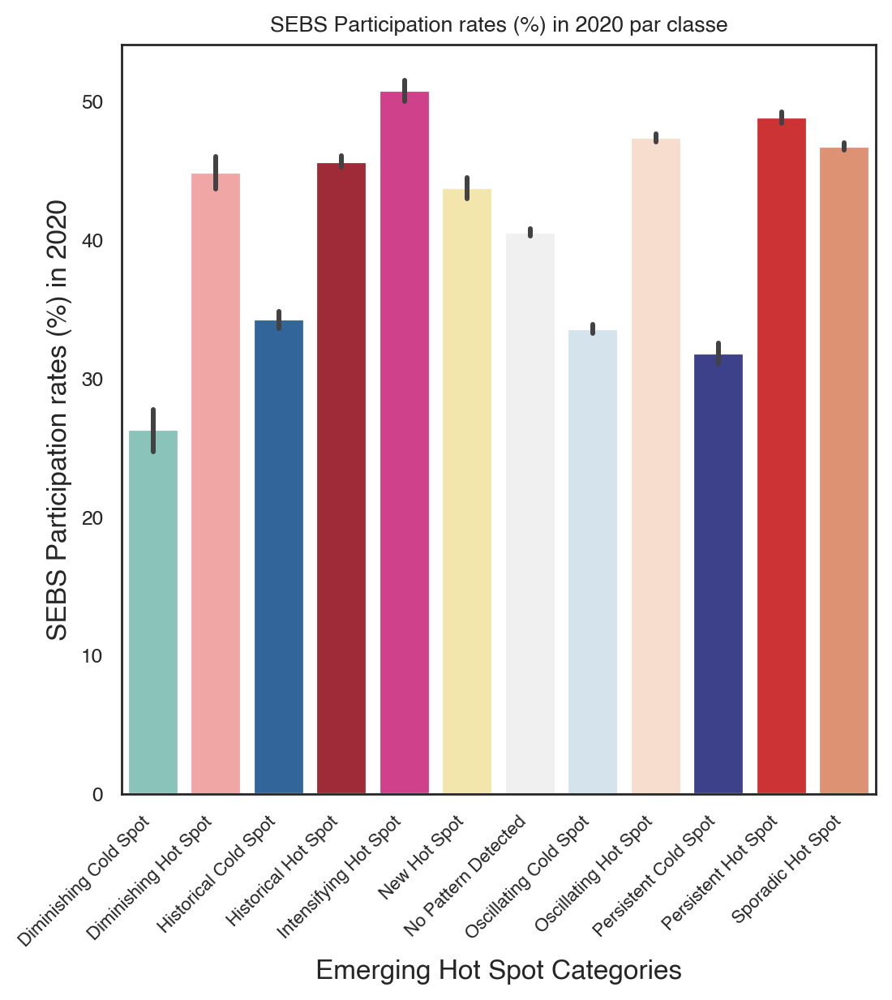

In [192]:
sns.set_context("paper")
y = 'SEBS Participation rates (%) in 2020'
fig, ax = plt.subplots(figsize=(6, 6))
colors_emergentGetis = [colors_cl_getis[i] for i in data_2020['class_emergent_getis'].sort_values().unique()]
ylim_max = data_2020['ebs_rate'].quantile(q=0.99)
x_label = 'Emerging Hot Spot Categories'
chart = sns.barplot(x='class_emergent_getis', y='ebs_rate',order = list([i for i in data_2020['class_emergent_getis'].sort_values().unique()]),
                    palette=colors_emergentGetis, data=data_2020, ax=ax)
chart.set_xticklabels(chart.get_xticklabels(), size=8, rotation=45, horizontalalignment='right')
chart.set_title('{} par classe'.format(y, size=16))
chart.set_xlabel(x_label, size=12)
chart.set_ylabel(y, size=12)
# test_results = statannot.add_stat_annotation(chart, data=df_all_years_2020ha[df_all_years_2020ha.year_invit == '2020'], x=
#                                    'class_emergent_getis', y='ebs_rate',
#                                    box_pairs=[("Point froid persistant", "Point froid oscillant")],
#                                    test='Mann-Whitney', text_format='star',
#                                    loc='inside', verbose=2)
annotator = Annotator(chart, pairs=[("Persistent Cold Spot", "Oscillating Cold Spot"), ('No Pattern Detected','Persistent Hot Spot')],data=data_2020, x=
                                   'class_emergent_getis', y='ebs_rate', order = list([i for i in data_2020['class_emergent_getis'].sort_values().unique()]))
annotator.configure(test='Mann-Whitney', text_format='star', loc='inside',comparisons_correction="Bonferroni")
# annotator.apply_and_annotate()
# chart.set_ylim([0, ylim_max])
plt.savefig(figures_folder/'Bar plot - Emergent Getis - Tx Participation.png', dpi = 300, bbox_inches = 'tight')

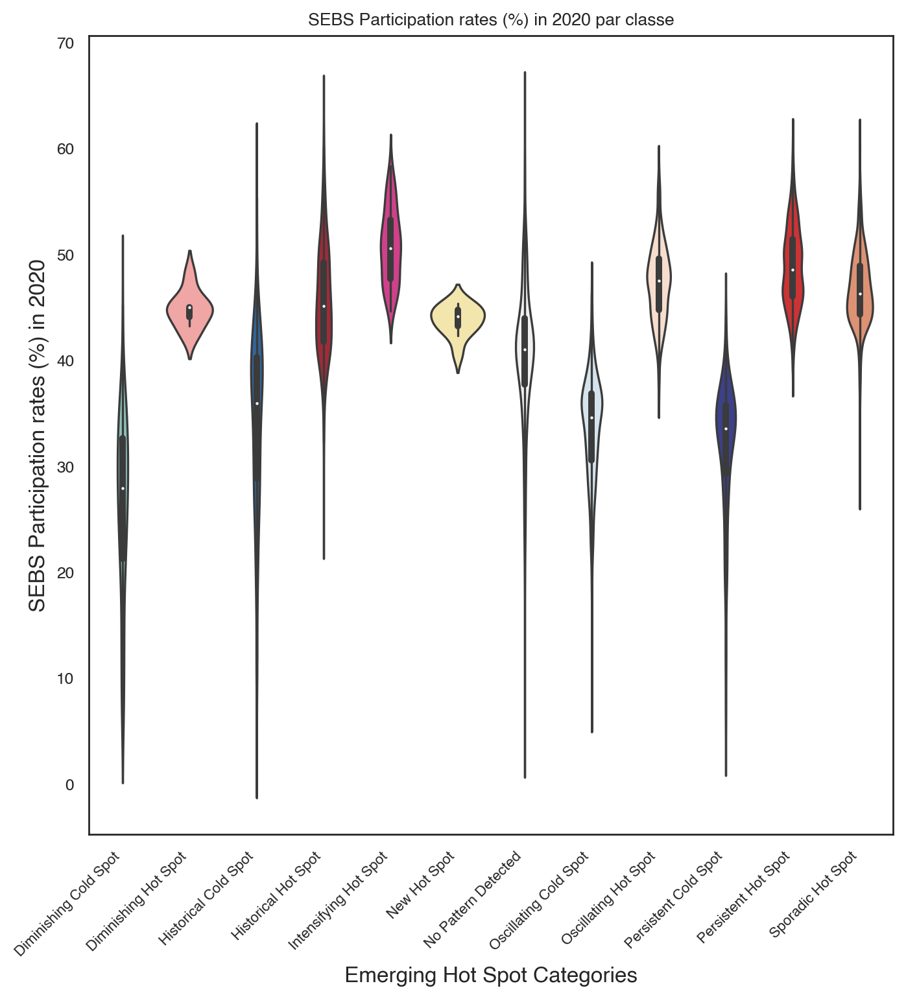

In [153]:
sns.set_context("paper")
y = 'SEBS Participation rates (%) in 2020'
fig, ax = plt.subplots(figsize=(8, 8))
colors_emergentGetis = [colors_cl_getis[i] for i in data_2020['class_emergent_getis'].sort_values().unique()]
ylim_max = data_2020['ebs_rate'].quantile(q=0.99)
x_label = 'Emerging Hot Spot Categories'
chart = sns.violinplot(x='class_emergent_getis', y='ebs_rate',order = list([i for i in data_2020['class_emergent_getis'].sort_values().unique()]),
                    palette=colors_emergentGetis, showfliers=True, data=data_2020, ax=ax)
chart.set_xticklabels(chart.get_xticklabels(), size=8, rotation=45, horizontalalignment='right')
chart.set_title('{} par classe'.format(y, size=16))
chart.set_xlabel(x_label, size=12)
chart.set_ylabel(y, size=12)
# test_results = statannot.add_stat_annotation(chart, data=df_all_years_2020ha[df_all_years_2020ha.year_invit == '2020'], x=
#                                    'class_emergent_getis', y='ebs_rate',
#                                    box_pairs=[("Point froid persistant", "Point froid oscillant")],
#                                    test='Mann-Whitney', text_format='star',
#                                    loc='inside', verbose=2)
annotator = Annotator(chart, pairs=[("Persistent Cold Spot", "Oscillating Cold Spot"), ('No Pattern Detected','Persistent Hot Spot')],data=data_2020, x=
                                   'class_emergent_getis', y='ebs_rate', order = list([i for i in data_2020['class_emergent_getis'].sort_values().unique()]))
annotator.configure(test='Mann-Whitney', text_format='star', loc='inside',comparisons_correction="Bonferroni")
# annotator.apply_and_annotate()
# chart.set_ylim([0, ylim_max])
plt.savefig(figures_folder/'Violin plot - Emergent Getis - Tx Participation.png', dpi = 300, bbox_inches = 'tight')

In [154]:
data_2020[['center_nearest','center_density','ciqmd','income_ss']] = gdf_participation_ha[gdf_participation_ha.year_invit_2y == '2020'].groupby('RELI')[['center_nearest','center_density','ciqmd','income_ss']].mean()


/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer]

In [155]:
df_sociodemo_access_RELI = gdf_participation_ha[['RELI',
 'rpnoce',
 'rpncam',
 'rpncas',
 'rpnceu',
 'rpneeu',
 'rpneceu',
 'rpnfe',
 'rpnme',
 'rpnnaf',
 'rpnnam',
 'rpnneu',
 'rpnnweu',
 'rpnsam',
 'rpnsas',
 'rpnseas',
 'rpnseeu',
 'rpnsweu',
 'rpnsubaf',
 'rpnweu',
 'rad3sec',
 'rad3tert',
 'rprprot',
 'rprcath',
 'rprochr',
 'rprjew',
 'rprmusl',
 'rproth',
 'rprnorel',
 'rpnch',
 'rphhpriv',
 'rpfnone',
 'rpfobl',
 'rpfgen',
 'rpfprof',
 'rpfmat',
 'rpfprsf',
 'rpfprss',
 'rpfbac',
 'rpfmas',
 'rpfphd',
 'rad',
 'radf',
 'radunef',
 'radslib',
 'tertiary_education',
 'rpforeign',
 'wo_tertiary_education',
 'inv_ciqmd',
 'inv_dmdrent',
 'rad3primsec',
 'rp65+',
 'rphh3p-',
 'rphh3p+',
 'dmdrent',
 'ptot',
 'deprivation_pca',
 'deprivation_pca_q5',
 'diff_years',
 'mammo_last_invite',
 'participation_change',
 'mammo',
 'e',
 'n',
 'age_cat',
 '30-34',
 '35-39',
 '40-44',
 '45-49',
 '50-54',
 '55-59',
 '60-64',
 '65-69',
 '70-74',
 '75-79',
 '80-84',
 '85-89',
 '90-94']].groupby('RELI').mean()

In [156]:
df_comparison_emergent_getis = pd.merge(data_2020,df_sociodemo_access_RELI, left_index = True, right_index = True)

In [157]:
df_comparison_emergent_getis['rpam'] = df_comparison_emergent_getis.filter(regex = 'cam|nam|sam').sum(axis = 1)
df_comparison_emergent_getis['rpaf'] = df_comparison_emergent_getis.filter(regex = 'af').sum(axis = 1)
df_comparison_emergent_getis['rpas'] = df_comparison_emergent_getis.filter(regex = 'cas|sas|seas|rpnme').sum(axis = 1)
df_comparison_emergent_getis['rpeu'] = df_comparison_emergent_getis.filter(regex = 'ceu|weu|neu|eeu').sum(axis = 1)

In [158]:
colors_emergentGetis = [colors_cl_getis[i] for i in df_comparison_emergent_getis['class_emergent_getis'].sort_values().unique()]
ylim_max = df_comparison_emergent_getis['ebs_rate'].quantile(q=0.99)
x_label = ''
# y_label = 'Taux de participation (%) en 2020'
features = ['ptot','income_ss','ciqmd','dmdrent','deprivation_pca','center_density','center_nearest','wo_tertiary_education','rpnch',
 '50-54',
 '55-59',
 '60-64',
 '65-69',
 '70-74',
 'rprprot',
 'rprcath',
 'rprochr',
 'rprjew',
 'rprmusl',
 'rprnorel', 'rpncam','rpnnam','rpnsam','rpaf','rpas','rpeu','rpnme']
y_labels = ["Population",'Household Median Income (CHF)', 'Median Income (x1000 CHF)', 'Median Rent (CHF)','SES Deprivation','Access - Center Density','Access - Closest Center (m)','Perc. wo tertiary educ. (%)','Perc. Swiss (%)','Perc. Age 50-54 (%)','Perc. Age 55-59  (%)','Perc. Age 60-64 (%)','Perc. Age 65-69','Perc. Age 70-74 (%)','Perc. Prostestants (%)','Perc. Catholics (%)','Perc. Christians (%)','Perc. Jewish (%)','Perc. Muslims (%)','Perc. non-religious (%)','Perc. Central Americans','Perc. North Americans','Prop. South Americans','Perc. Africans','Perc. Asians','Perc. Europeans','Perc. Middle-Easterns']

/var/folders/vs/k61m7qc90ds735nc0468d1x80000gn/T/ipykernel_25678/630526062.py:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



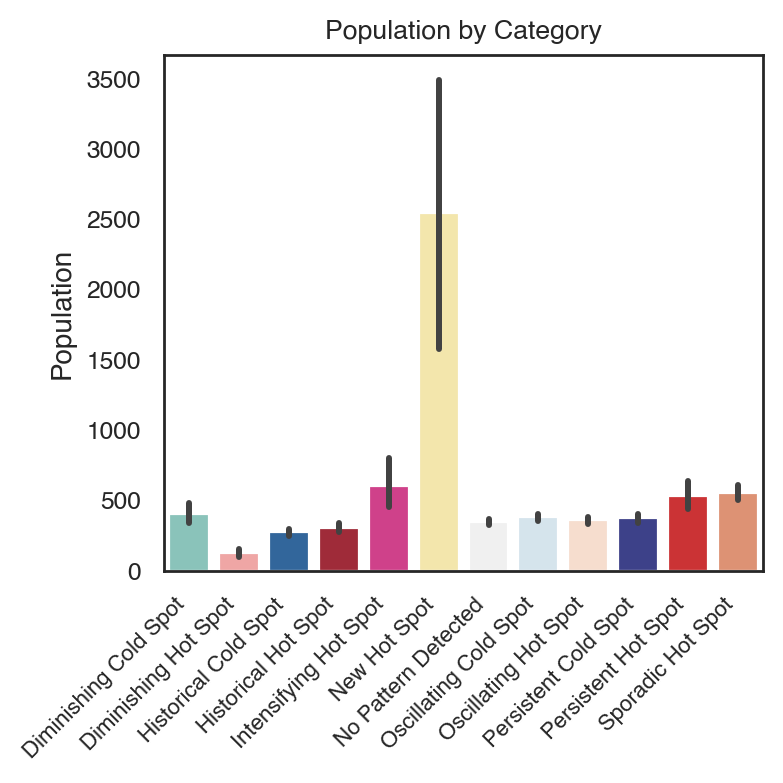

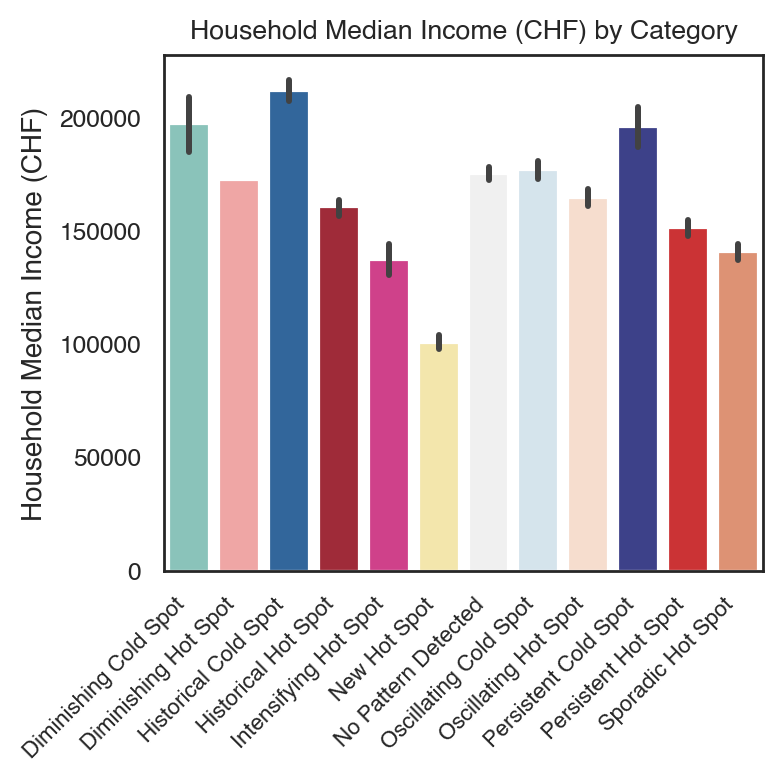

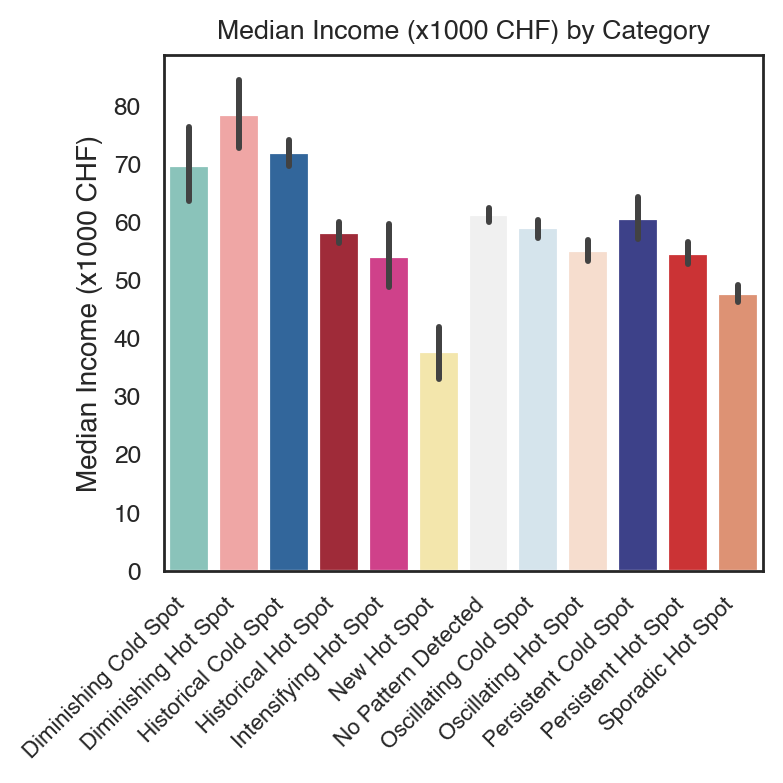

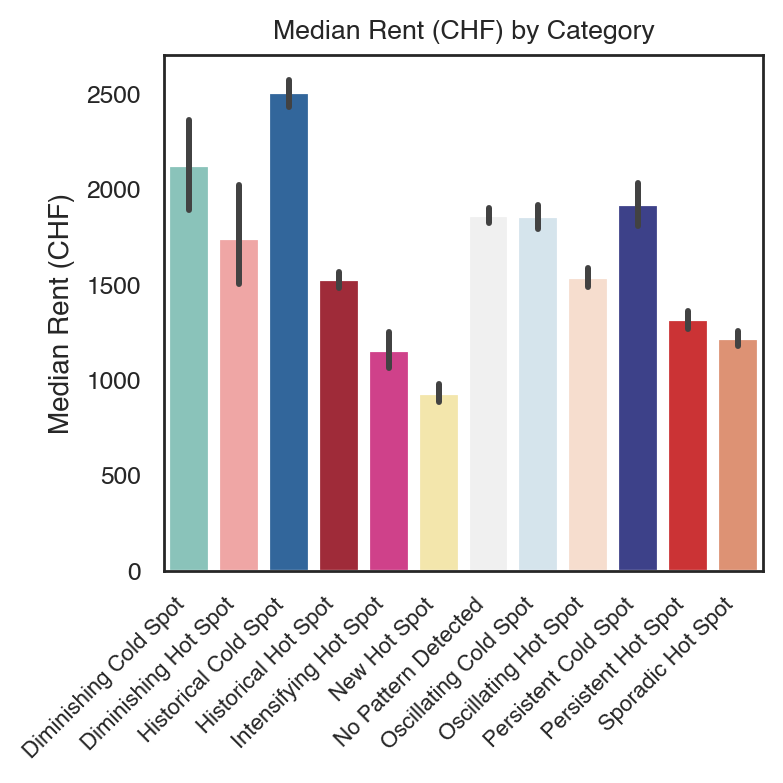

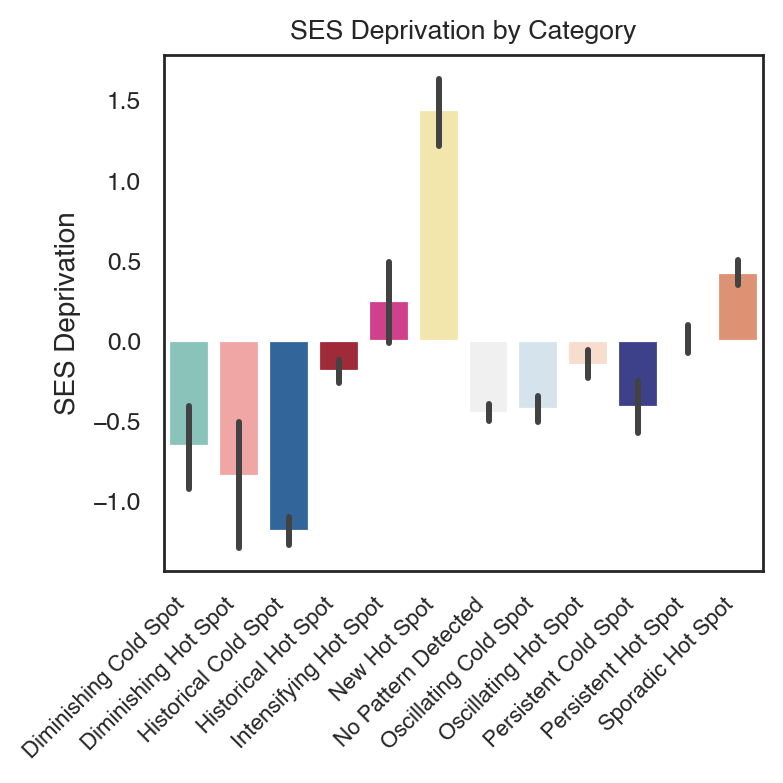

...

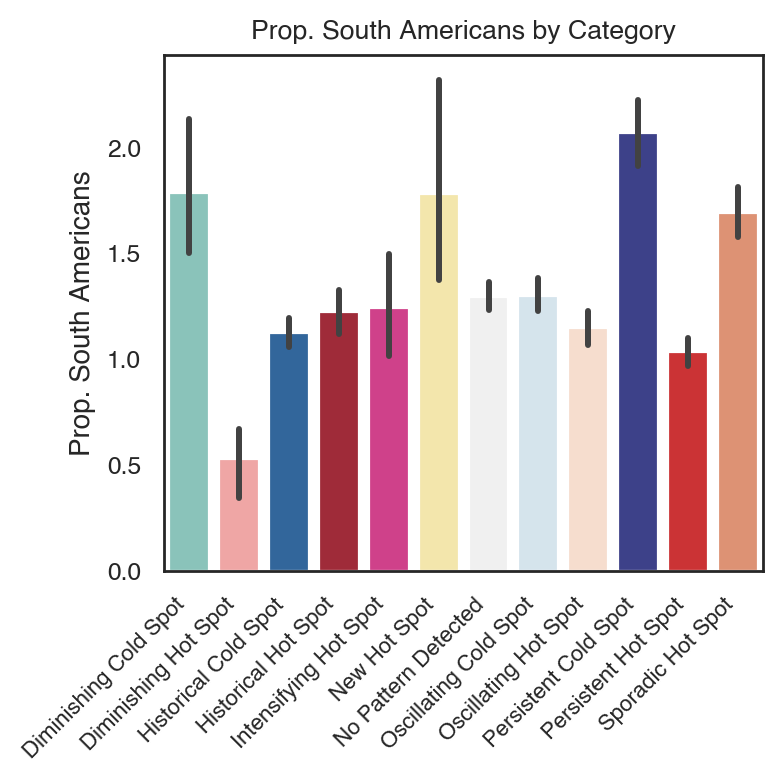

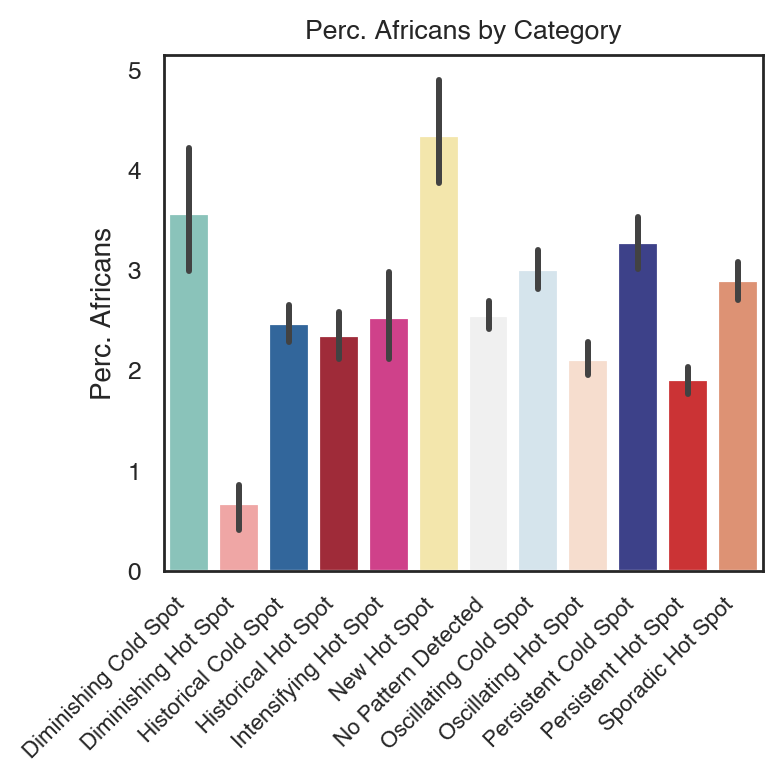

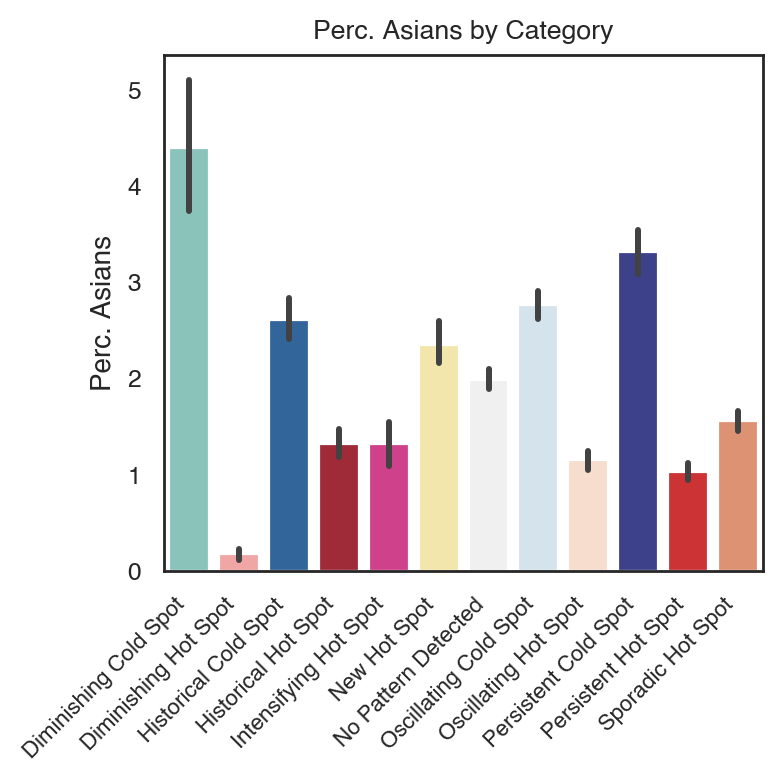

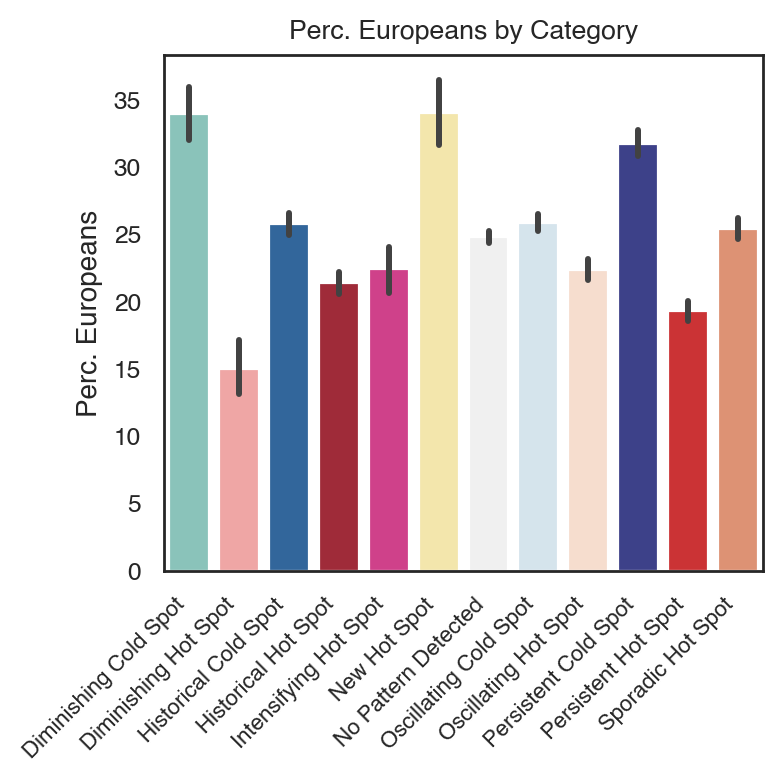

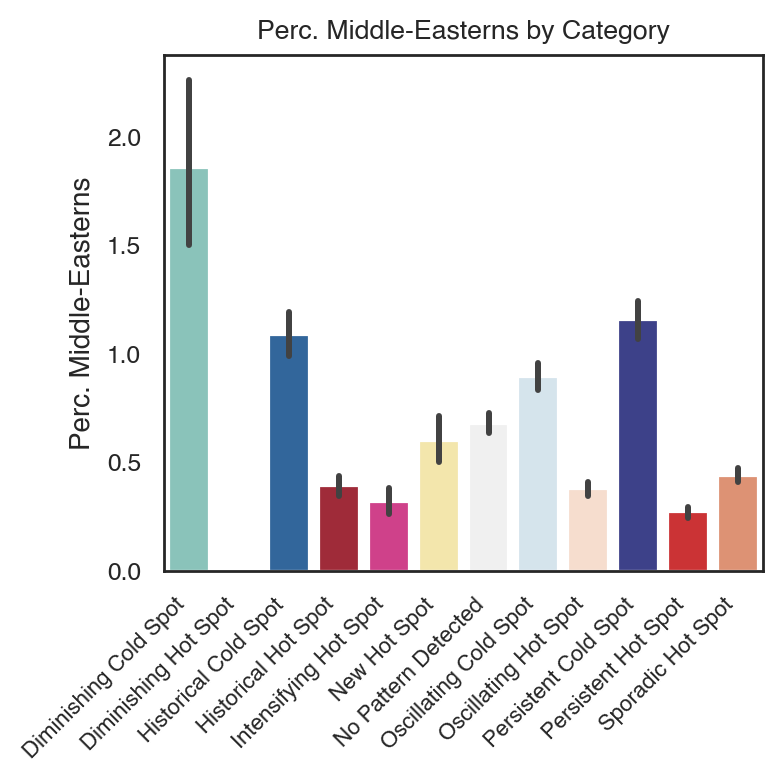

In [159]:
for feature, y_label in zip(features, y_labels):
    fig, ax = plt.subplots(figsize=(4, 4))
#     f = plt.figure(figsize = (5,5))
    chart = sns.barplot(x='class_emergent_getis', y=feature,order = list([i for i in df_comparison_emergent_getis['class_emergent_getis'].sort_values().unique()]),
                        palette=colors_emergentGetis, data=df_comparison_emergent_getis, ax=ax)
    chart.set_xticklabels(chart.get_xticklabels(), size=8, rotation=45, horizontalalignment='right')
    chart.set_title('{} by Category'.format(y_label, size=16))
    chart.set_xlabel(x_label, size=10)
    chart.set_ylabel(y_label, size=10)
    plt.tight_layout()
    filename=y_label+'.png'
    plt.savefig(figures_folder/filename, dpi=300, bbox_inches="tight")

In [160]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np


def randrange(n, vmin, vmax):
    '''
    Helper function to make an array of random numbers having shape (n, )
    with each number distributed Uniform(vmin, vmax).
    '''
    return (vmax - vmin)*np.random.rand(n) + vmin

# fig = plt.figure()
# ax = fig.add_subplot(111, projection='3d')

# n = 100

# # For each set of style and range settings, plot n random points in the box
# # defined by x in [23, 32], y in [0, 100], z in [zlow, zhigh].
# for c, m, zlow, zhigh in [('r', 'o', -50, -25), ('b', '^', -30, -5)]:
#     xs = randrange(n, 23, 32)
#     ys = randrange(n, 0, 100)
#     zs = randrange(n, zlow, zhigh)
#     ax.scatter(xs, ys, zs, c=c, marker=m)
#     ax.add_collection3d(communes)

# ax.set_xlabel('X Label')
# ax.set_ylabel('Y Label')
# ax.set_zlabel('Z Label')

# plt.show()

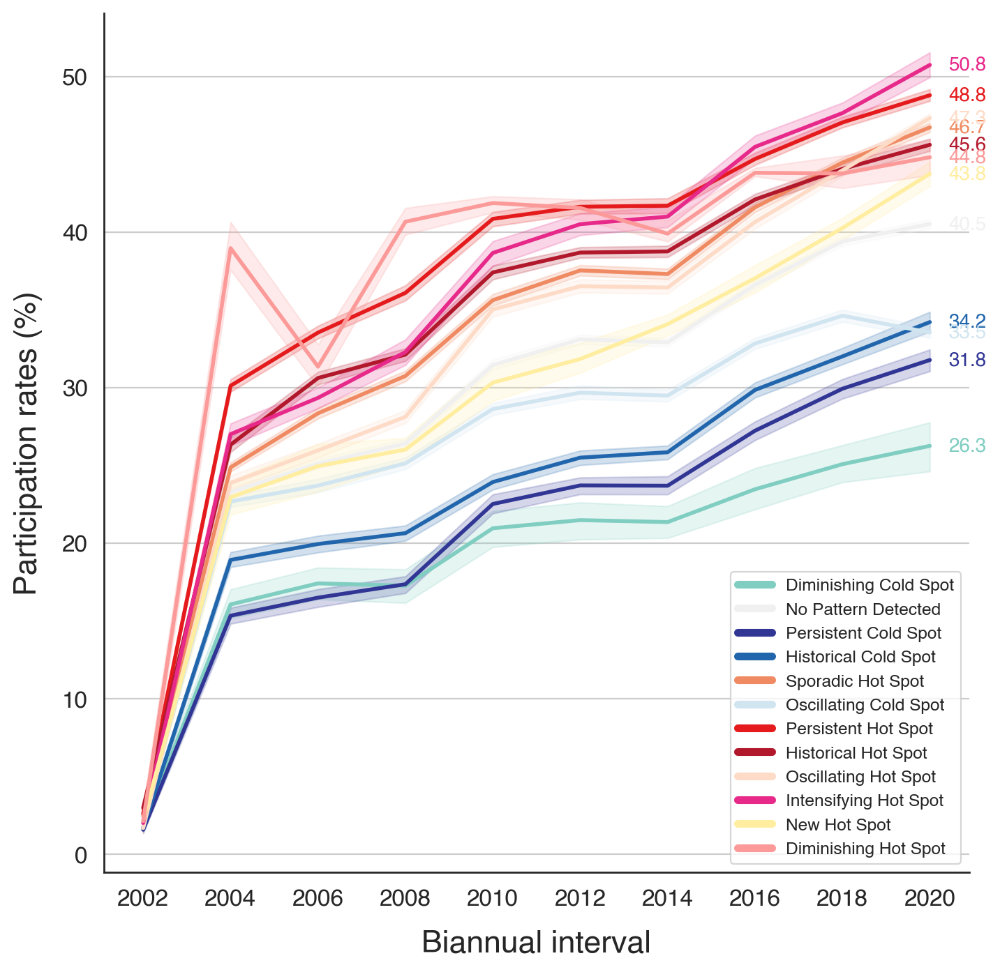

In [199]:
fig, ax = plt.subplots(figsize = (8,8))
# the size of A4 paper
g = sns.lineplot(data=df_all_years_2020ha[df_all_years_2020ha.year_invit != '2000'].reset_index(), x="year_invit", y="ebs_rate", hue = 'class_emergent_getis', linewidth = 2, palette = colors_cl_getis,ax = ax)
for l in g.lines:
    y = l.get_ydata()
    if len(y)>0:
        g.annotate(f'{y[-1]:.1f}', xy=(1.02,y[-1]), xycoords=('axes fraction', 'data'), 
                     ha='right', va='center', color=l.get_color(), size = 10)
ax.set_xlabel('Biannual interval',labelpad = 10, size = 16)
ax.set_ylabel('Participation rates (%)',labelpad = 10, size = 16)
plt.legend(prop={'size': 14})
plt.xticks(size = 12)
plt.yticks(size = 12)
ax.grid('on', which='minor', axis='x' )
ax.grid('on', which='major', axis='y')
# get the legend object
leg = ax.legend()
sns.despine()

# change the line width for the legend
for line in leg.get_lines():
    line.set_linewidth(4.0)
# plt.title('Evolution of Participation Rates across Categories of the Emerging Hot Spot Analysis',size = 16)
plt.savefig(figures_folder/'Emergent Getis - Evolution au cours du temps par classe.png', dpi = 300)

In [162]:
df_all_years_2020ha = df_all_years_2020ha.reset_index()

In [163]:
df_all_years_2020ha['deprivation_pca'] = df_all_years_2020ha['RELI'].map(gdf_participation_ha.groupby("RELI").deprivation_pca.mean().to_dict())
df_all_years_2020ha['income_ss'] = df_all_years_2020ha['RELI'].map(gdf_participation_ha.groupby("RELI").income_ss.mean().to_dict())

## Adjustment for SES deprivation

In [164]:
def run_ols(df,X,y,w):
    g_y = df[y].values.reshape(-1, 1)
    g_X = df[X].values
    ols = OLS(g_y, g_X, w, spat_diag=True, moran=True, name_y=y, name_x=X)
    return ols

In [165]:
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from spreg import OLS

scaler = StandardScaler()
for df_year in dfs_year:
    wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_year.geometry.centroid)),16)
    df_year['index_socio_pca'] = df_year['RELI'].map(reli_deprivation)
    df_year[['index_socio_pca']] = scaler.fit_transform(df_year[['index_socio_pca']])
    X = ['index_socio_pca']
    y = 'ebs_rate'
    ols = run_ols(df_year, X, y, wnn16)
    df_year['ebs_rate_res'] = ols.u
    print(ols.summary)

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :    ebs_rate                Number of Observations:        5739
Mean dependent var  :      0.0244                Number of Variables   :           2
S.D. dependent var  :      0.2280                Degrees of Freedom    :        5737
R-squared           :      0.0000
Adjusted R-squared  :     -0.0002
Sum squared residual:     298.296                F-statistic           :      0.0617
Sigma-square        :       0.052                Prob(F-statistic)     :      0.8038
S.E. of regression  :       0.228                Log likelihood        :     341.693
Sigma-square ML     :       0.052                Akaike info criterion :    -679.386
S.E of regression ML:      0.2280                Schwarz criterion     :    -666.076

-----------------------------------------------------------------------------

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :    ebs_rate                Number of Observations:        5592
Mean dependent var  :     23.1008                Number of Variables   :           2
S.D. dependent var  :      6.3228                Degrees of Freedom    :        5590
R-squared           :      0.0287
Adjusted R-squared  :      0.0285
Sum squared residual:  217109.018                F-statistic           :    165.0509
Sigma-square        :      38.839                Prob(F-statistic)     :   2.988e-37
S.E. of regression  :       6.232                Log likelihood        :  -18165.443
Sigma-square ML     :      38.825                Akaike info criterion :   36334.887
S.E of regression ML:      6.2310                Schwarz criterion     :   36348.145

-----------------------------------------------------------------------------

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :    ebs_rate                Number of Observations:        5754
Mean dependent var  :     26.7947                Number of Variables   :           2
S.D. dependent var  :      7.3437                Degrees of Freedom    :        5752
R-squared           :      0.0384
Adjusted R-squared  :      0.0382
Sum squared residual:  298346.621                F-statistic           :    229.7001
Sigma-square        :      51.868                Prob(F-statistic)     :   6.598e-51
S.E. of regression  :       7.202                Log likelihood        :  -19524.006
Sigma-square ML     :      51.850                Akaike info criterion :   39052.012
S.E of regression ML:      7.2007                Schwarz criterion     :   39065.327

-----------------------------------------------------------------------------

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :    ebs_rate                Number of Observations:        5870
Mean dependent var  :     32.9205                Number of Variables   :           2
S.D. dependent var  :      7.7870                Degrees of Freedom    :        5868
R-squared           :      0.0617
Adjusted R-squared  :      0.0615
Sum squared residual:  333923.760                F-statistic           :    385.7947
Sigma-square        :      56.906                Prob(F-statistic)     :   3.062e-83
S.E. of regression  :       7.544                Log likelihood        :  -20189.675
Sigma-square ML     :      56.887                Akaike info criterion :   40383.349
S.E of regression ML:      7.5423                Schwarz criterion     :   40396.704

-----------------------------------------------------------------------------

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :    ebs_rate                Number of Observations:        6322
Mean dependent var  :     36.5885                Number of Variables   :           2
S.D. dependent var  :      7.7618                Degrees of Freedom    :        6320
R-squared           :      0.0852
Adjusted R-squared  :      0.0851
Sum squared residual:  348348.929                F-statistic           :    588.9038
Sigma-square        :      55.119                Prob(F-statistic)     :  1.856e-124
S.E. of regression  :       7.424                Log likelihood        :  -21643.513
Sigma-square ML     :      55.101                Akaike info criterion :   43291.025
S.E of regression ML:      7.4230                Schwarz criterion     :   43304.529

-----------------------------------------------------------------------------

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



In [166]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
from sklearn.preprocessing import minmax_scale

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/getisord.py:596: UserWarning:

Gi* requested, but (a) weights are already row-standardized, (b) no weights are on the diagonal, and (c) no default value supplied to star. Assuming that the self-weight is equivalent to the maximum weight in the row. To use a different default (like, .5), set `star=.5`, or use libpysal.weights.fill_diagonal() to set the diagonal values of your weights matrix and use `star=None` in Gi_Local.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The w

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/esda/getisord.py:596: UserWarning:

Gi* requested, but (a) weights are already row-standardized, (b) no weights are on the diagonal, and (c) no default value supplied to star. Assuming that the self-weight is equivalent to the maximum weight in the row. To use a different default (like, .5), set `star=.5`, or use libpysal.weights.fill_diagonal() to set the diagonal values of your weights matrix and use `star=None` in Gi_Local.

/Users/david/miniforge3/envs/py310/lib/python3.10/site-packages/libpysal/weights/weights.py:172: UserWarning:

The weights matrix is not fully connected: 
 There are 3 disconnected components.



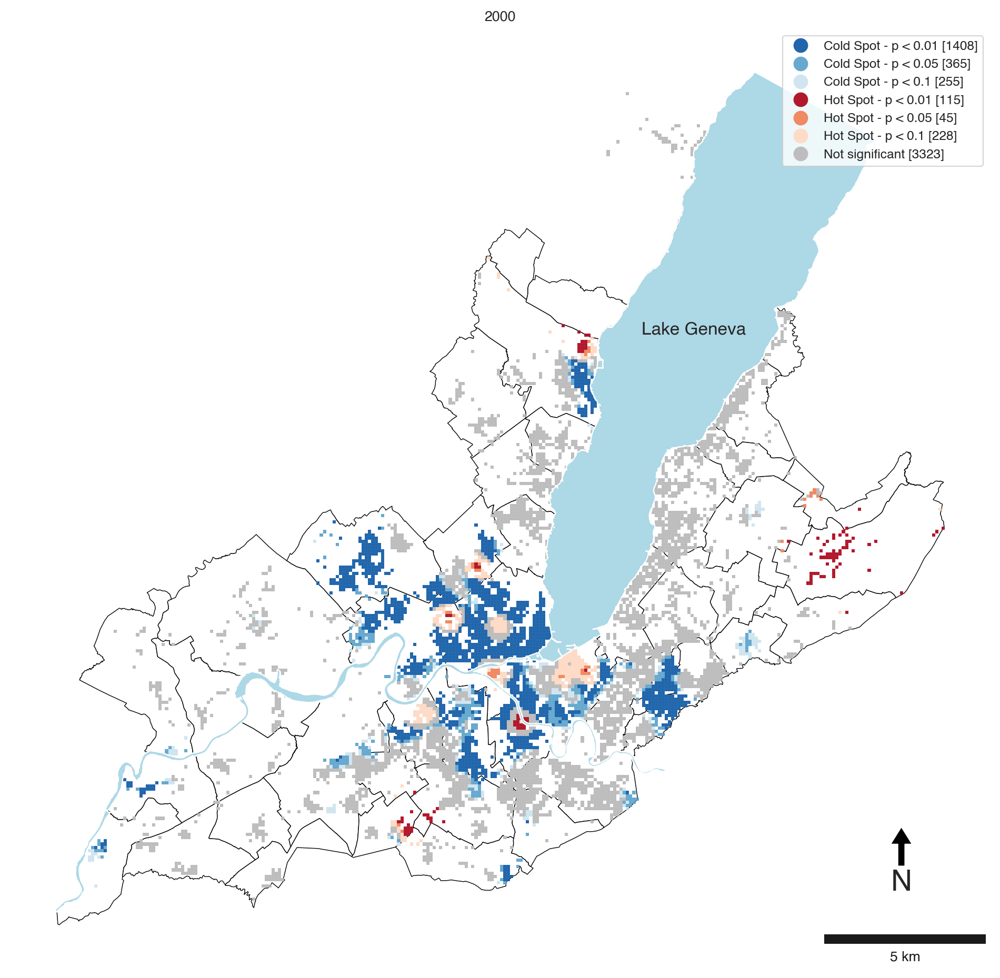

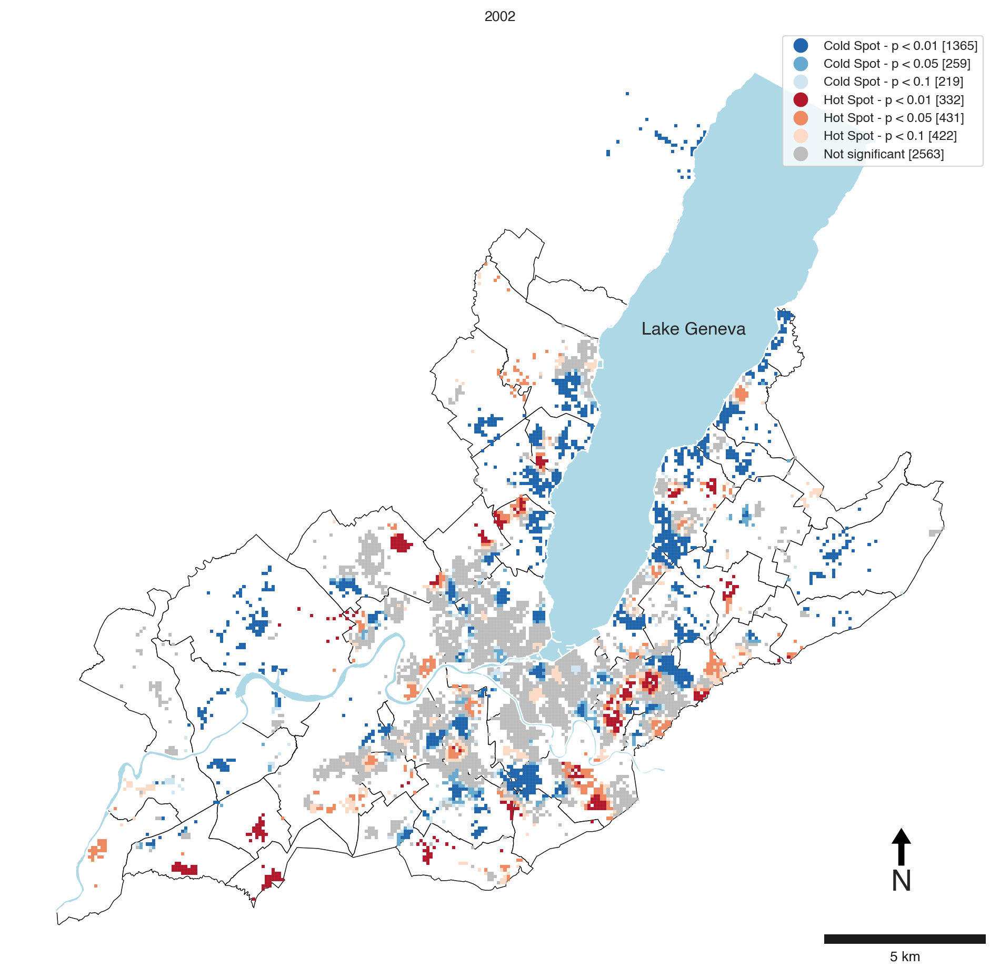

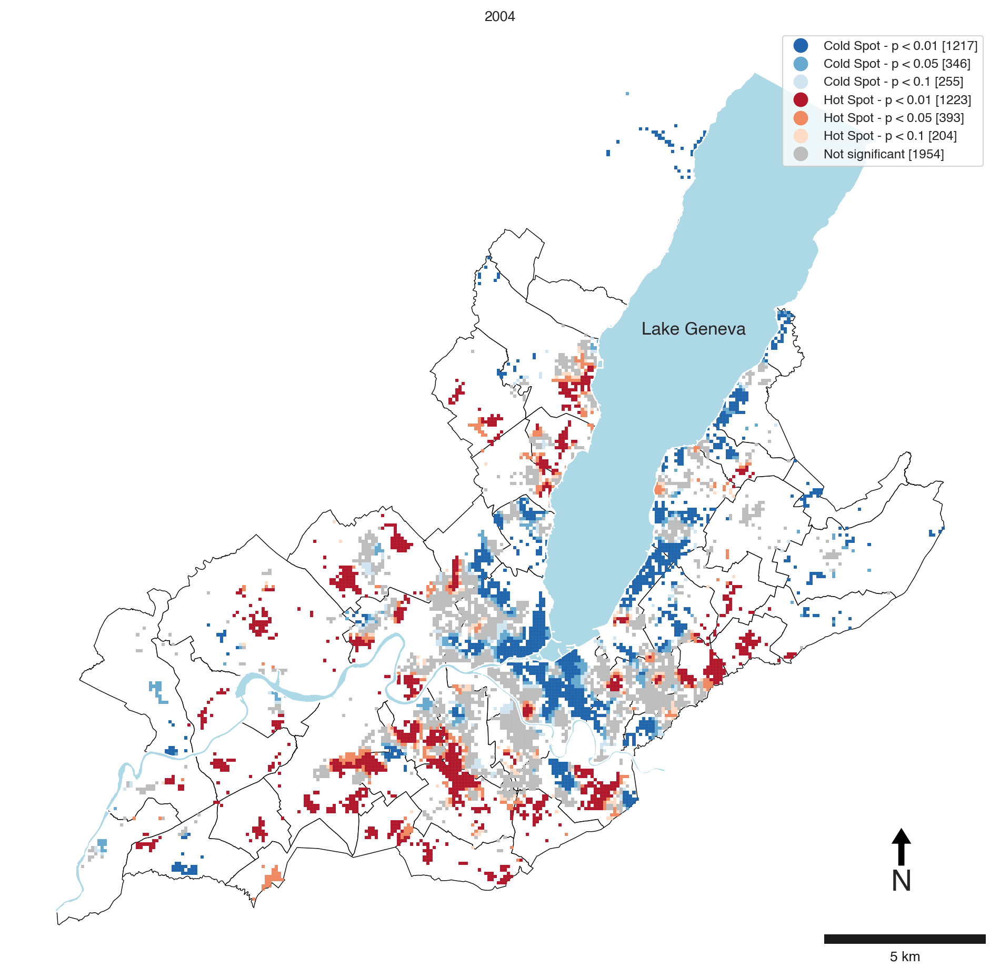

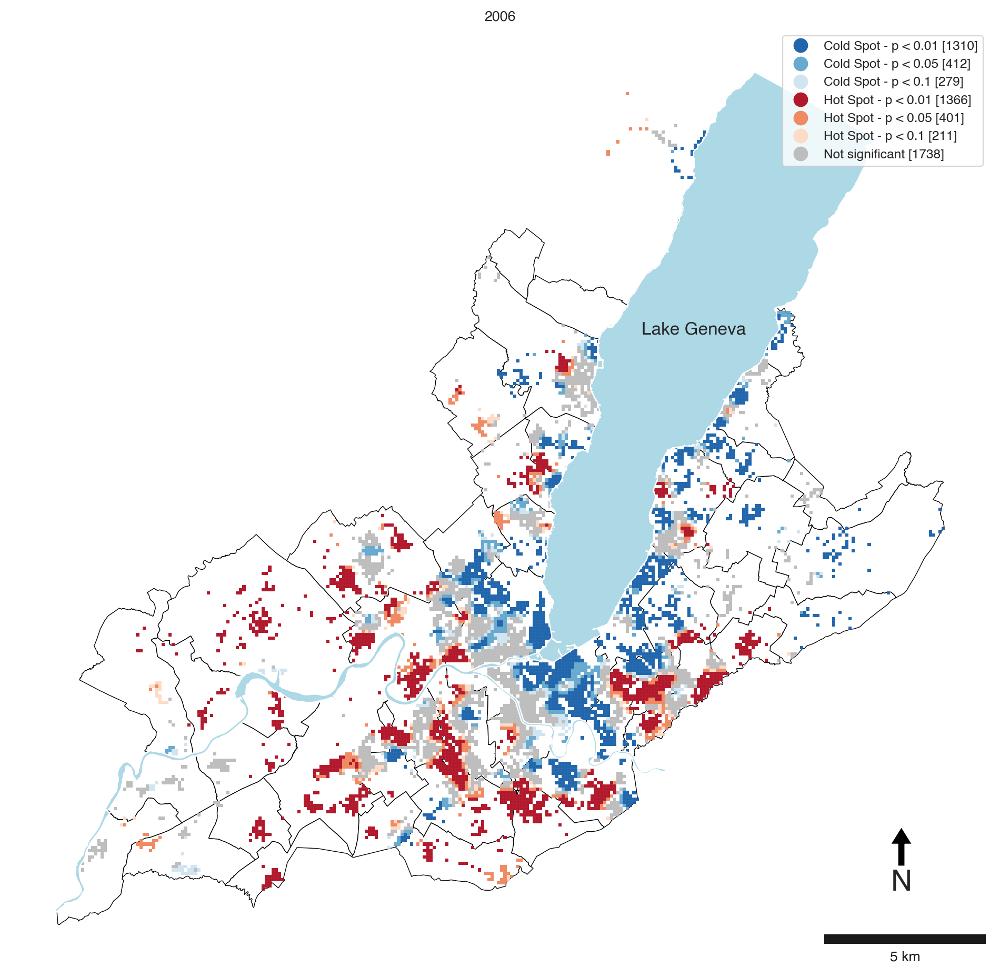

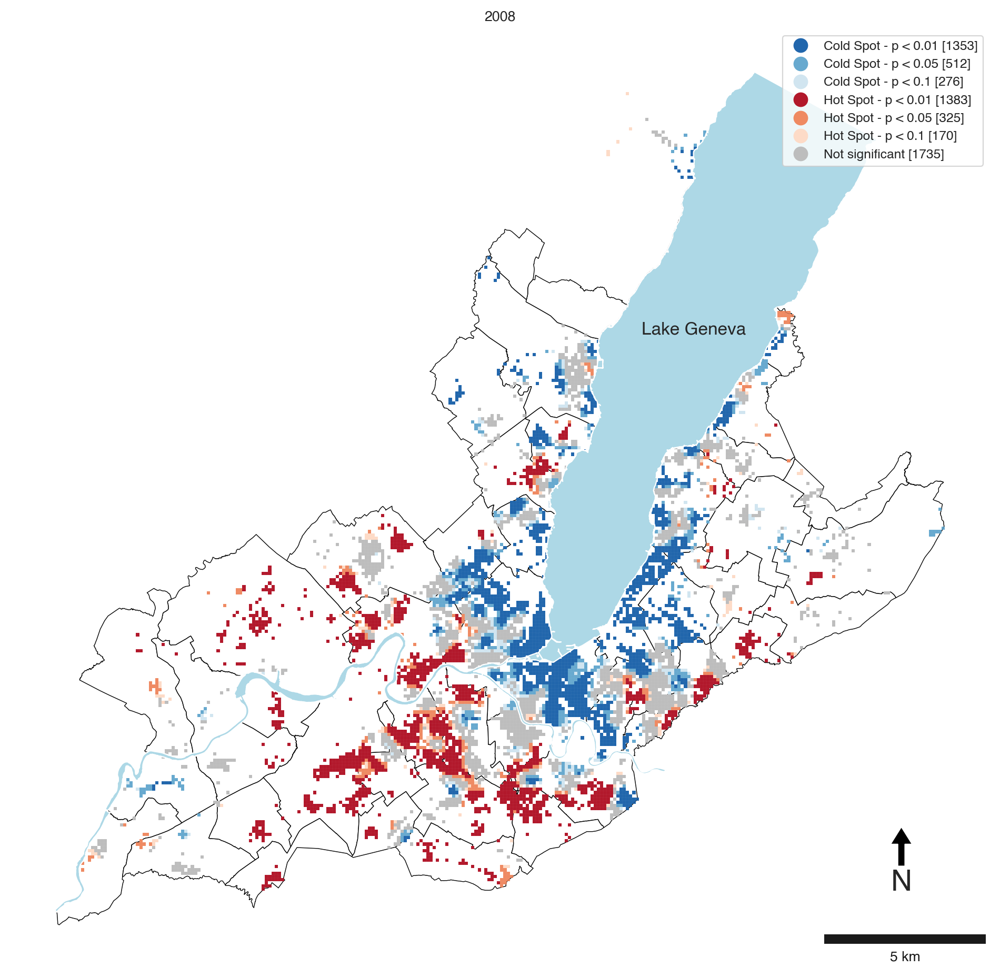

...

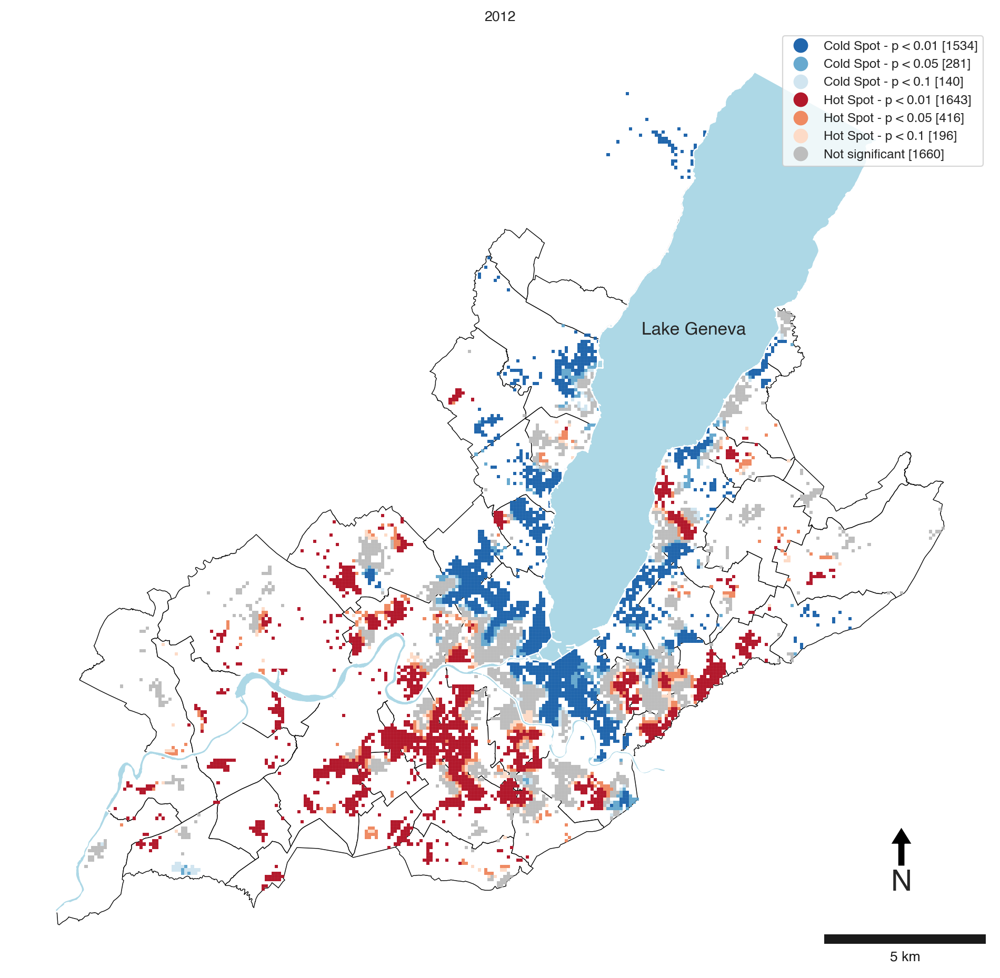

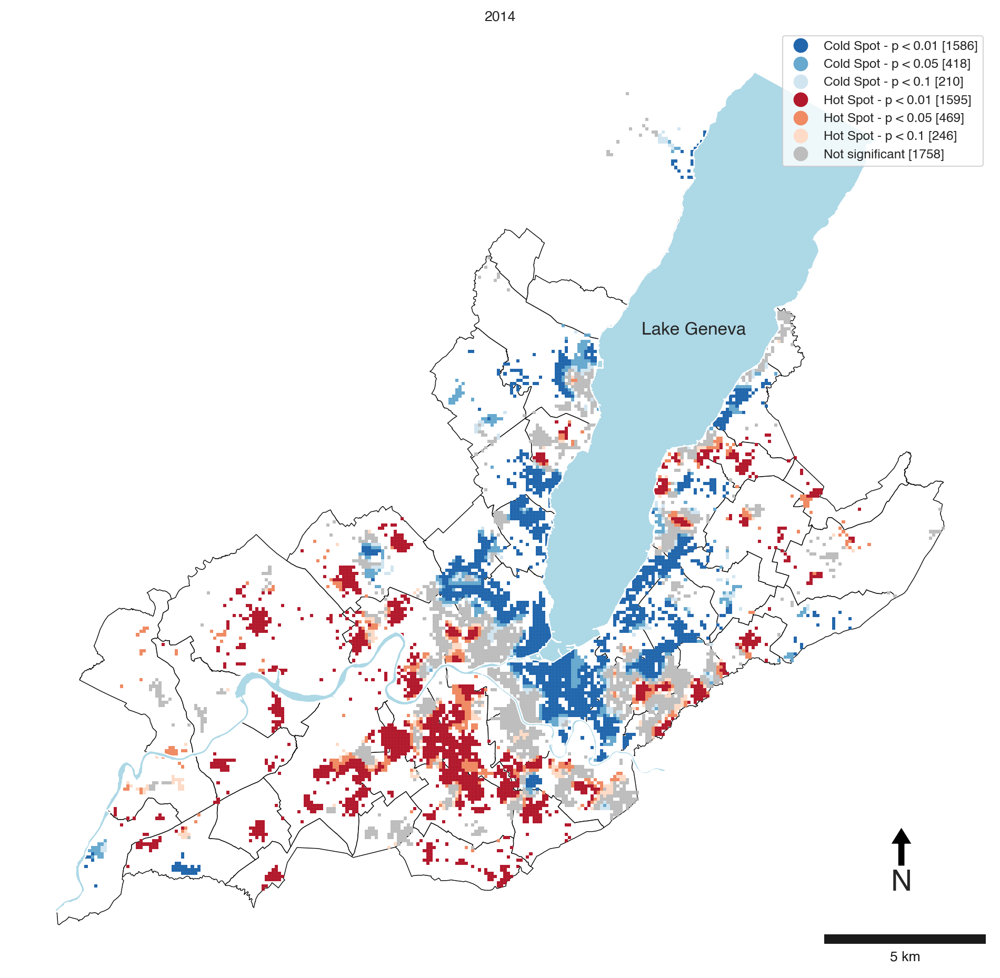

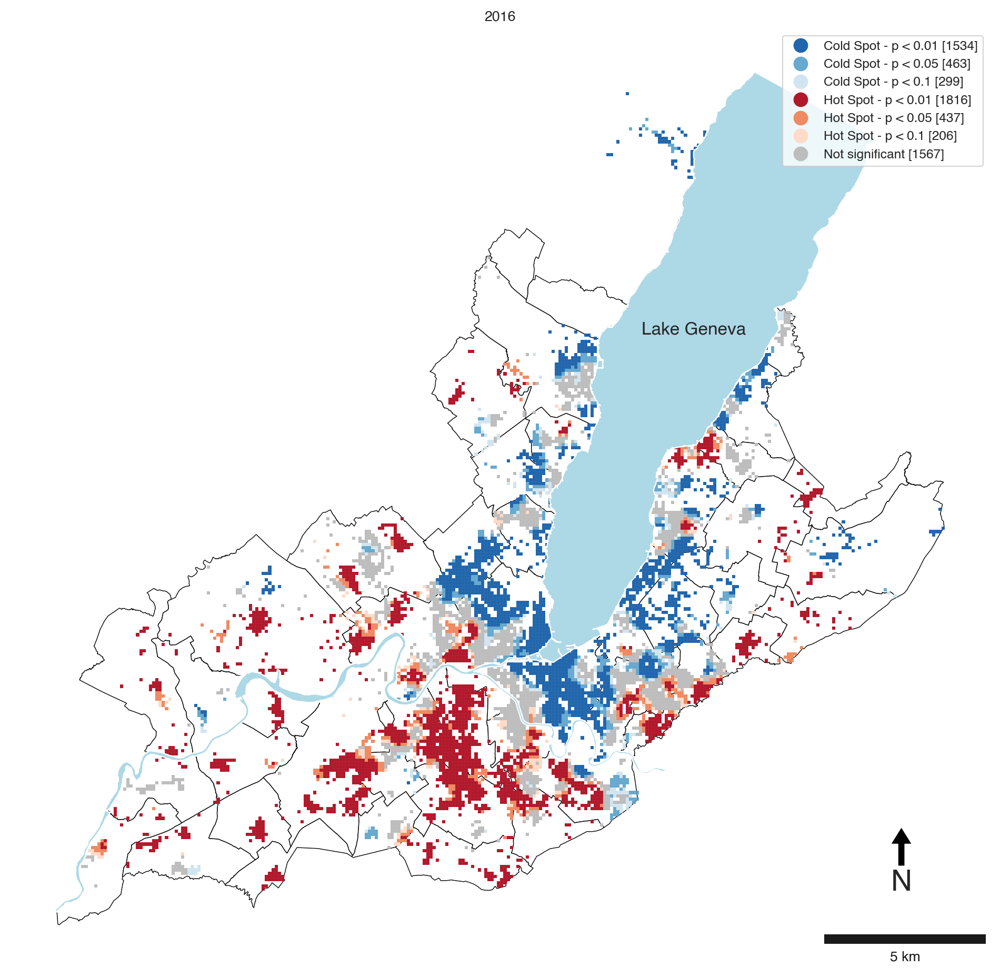

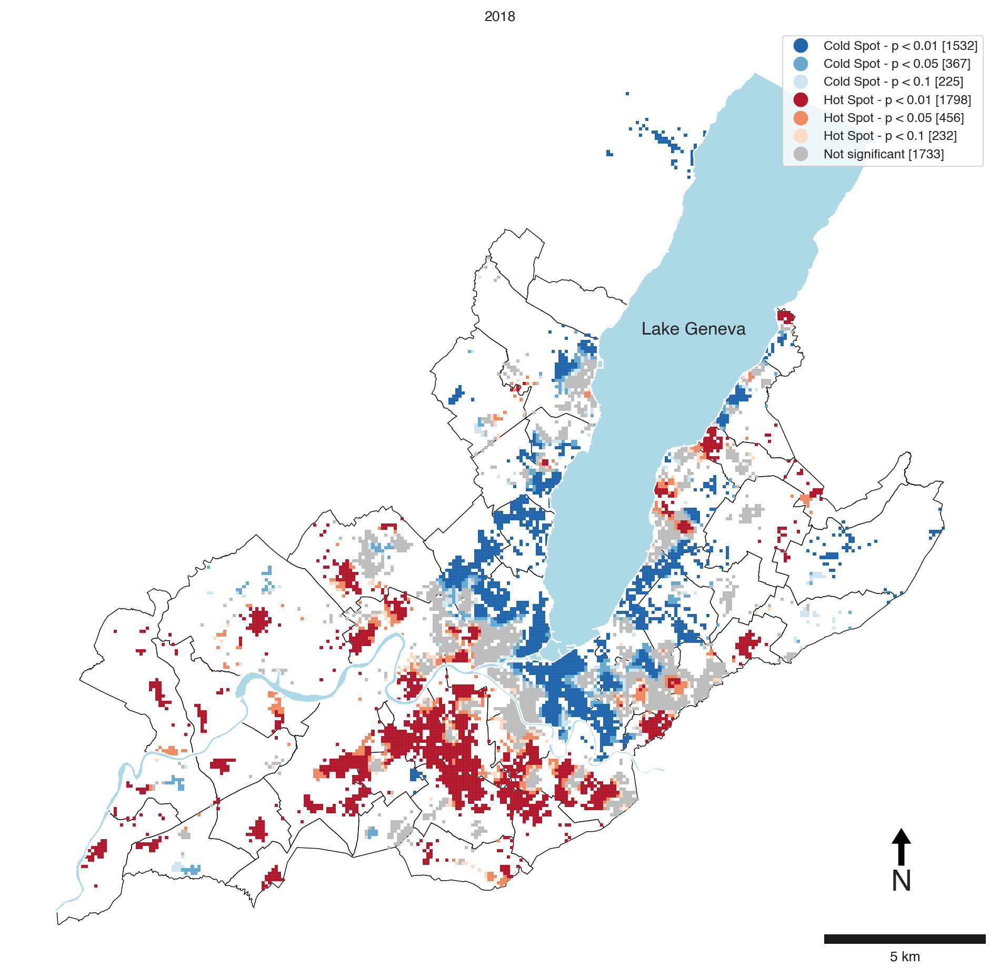

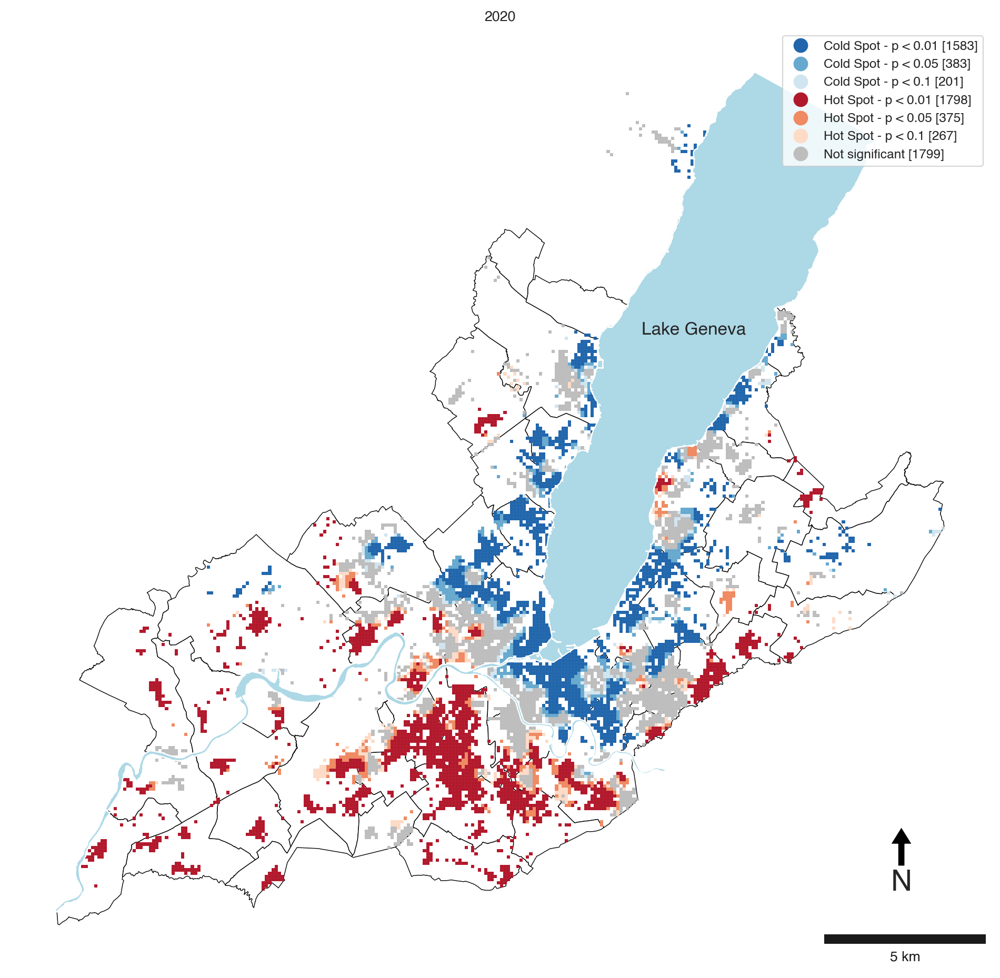

In [167]:
res_folder = Path('../Results/LISA - Hectares')
year = 2000
for df_year in dfs_year:
    
    wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_year.geometry.centroid)),16)
    df_year['ebs_rate_res_scaled'] = minmax_scale(df_year['ebs_rate_res'], feature_range = (0,100))
    getiswnn16 = pyspace.compute_getis(df_year,'ebs_rate_res_scaled',wnn16, 9999,'r')
    fdr_pvalue = fdr(getiswnn16.p_sim, 0.05)
    df_year['ebs_rate_res_scaled_G_cl_fdr'] = df_year['ebs_rate_res_scaled_G_cl']  
    df_year.loc[df_year['ebs_rate_res_scaled_G_psim'] >= fdr_pvalue, 'ebs_rate_res_scaled_G_cl_fdr'] = '0 Non-Significant'
    fig, ax = pyspace.plotGetisMap(df_year,'ebs_rate_res_scaled_G_cl',p_001 = False, commune_name = False)
    ax.set_title(year)
    filename = 'getis_giracs_ha_adjusted_wnn16_005_%s.png' % (str(year))
    plt.savefig(res_folder/filename,dpi = 300, bbox_inches = 'tight')
    year+=2



# res_folder = Path('../Results/LISA - Hectares')
# year = 2000
# for df_year in dfs_year:
    
#     wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_year.geometry.centroid)),16)
#     lisawnn16 = pyspace.compute_lisa(df_year,'ebs_rate_res',wnn16,9999,0.05)
#     fig, ax = pyspace.plotLISAMap_polygons(df_year,'ebs_rate_cl','')
#     ax.set_title(year)
#     filename = 'lisa_giracs_ha_wnn16_005_adjforindexsocio_%s.png' % (str(year))
#     plt.savefig(res_folder/filename,dpi = 300, bbox_inches = 'tight')
#     year+=2

(<Figure size 800x800 with 1 Axes>,
 <Axes: title={'center': 'Taux de participation (%) by Getis Classes'}, xlabel='Getis Classes - Taux de participation (%)', ylabel='Taux de participation (%)'>)

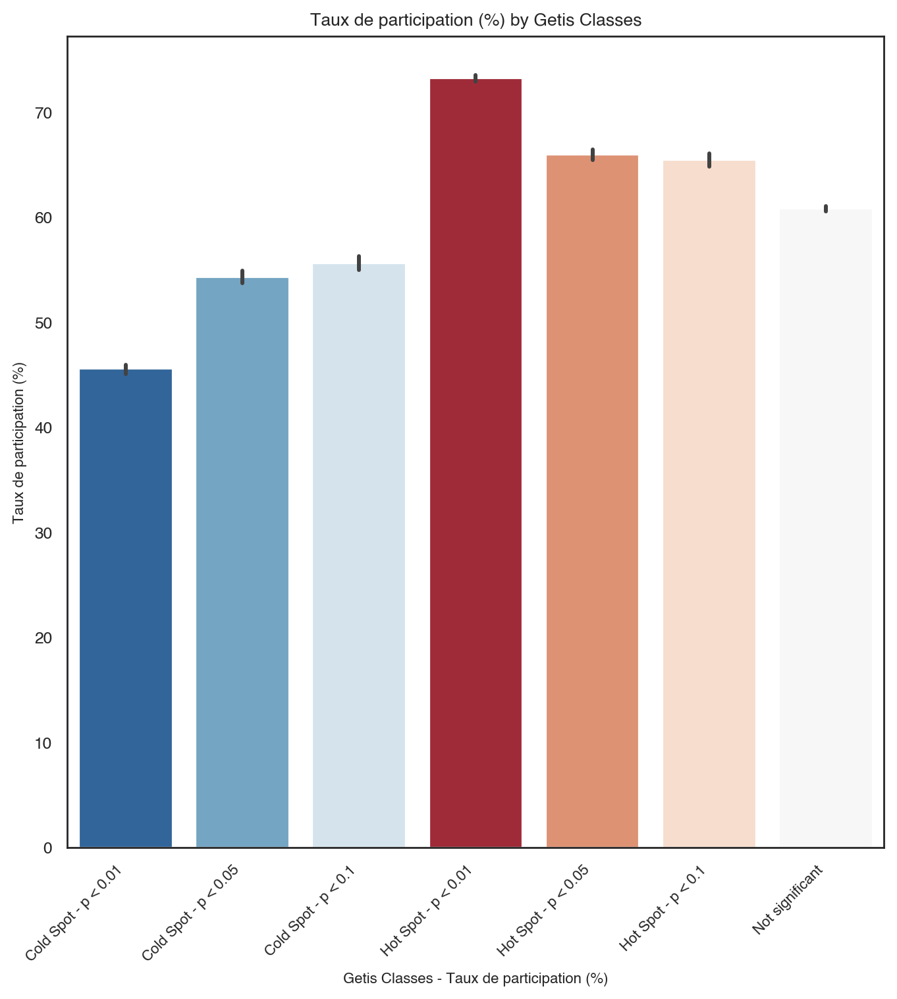

In [168]:
pyspace.plot_getis_by_class(dfs_year[-2], 'ebs_rate_res_scaled_G_cl', 'ebs_rate_res_scaled','Taux de participation (%)',8, 12, 8,8)

In [169]:
df_space_time_cube_adj = pd.concat(dfs_year[1:])[['RELI','year_invit','ebs_rate_res_scaled_G_Zs','ebs_rate_res_scaled_G_cl','geometry']]
df_space_time_cube_adj['time'] = df_space_time_cube_adj['year_invit'].astype(int).sub(2002).div(2)
df_space_time_cube_adj.groupby('RELI').ebs_rate_res_scaled_G_cl.apply(list)

RELI
48621113    [Not significant, Hot Spot - p < 0.05, Hot Spo...
48621114    [Not significant, Not significant, Hot Spot - ...
48621115    [Not significant, Hot Spot - p < 0.05, Hot Spo...
48631114    [Not significant, Cold Spot - p < 0.01, Not si...
48631117    [Cold Spot - p < 0.01, Not significant, Hot Sp...
                                  ...                        
51261218    [Not significant, Cold Spot - p < 0.05, Cold S...
51271218    [Not significant, Cold Spot - p < 0.05, Cold S...
51281218    [Not significant, Cold Spot - p < 0.01, Cold S...
51281225    [Not significant, Cold Spot - p < 0.01, Cold S...
51291219    [Not significant, Cold Spot - p < 0.01, Cold S...
Name: ebs_rate_res_scaled_G_cl, Length: 7216, dtype: object

In [170]:
df_emergent_getis_adj = spatiotemporal_getis_cats_prep(df_space_time_cube_adj,'ebs_rate_res_scaled_G_cl','ebs_rate_res_scaled_G_Zs', 9)

In [171]:
df_emergent_getis_adj['geometry'] = df_ha['geometry']

In [172]:
df_emergent_getis_adj = gpd.GeoDataFrame(df_emergent_getis_adj, crs = 2056, geometry = df_emergent_getis_adj['geometry'])

In [173]:
df_emergent_getis_adj['class_raw'] = df_emergent_getis['class']

In [174]:
df_emergent_getis_adj.groupby('class_raw')['class'].count()

class_raw
Diminishing Cold Spot     109
Diminishing Hot Spot        7
Historical Cold Spot      906
Historical Hot Spot       810
Intensifying Hot Spot      71
New Hot Spot               11
No Pattern Detected      2658
Oscillating Cold Spot     790
Oscillating Hot Spot      564
Persistent Cold Spot      323
Persistent Hot Spot       388
Sporadic Hot Spot         579
Name: class, dtype: int64

In [175]:
df_emergent_getis_adj.drop(['cs_index','hs_index','consecutive_cs','consecutive_hs'], axis = 1).to_file('./df_emergent_getis_adj.geojson', driver = 'GeoJSON')

In [176]:
df_emergent_getis_adj = gpd.read_file('./df_emergent_getis_adj.geojson')

In [177]:
df_emergent_getis_adj['dummy'] = 1

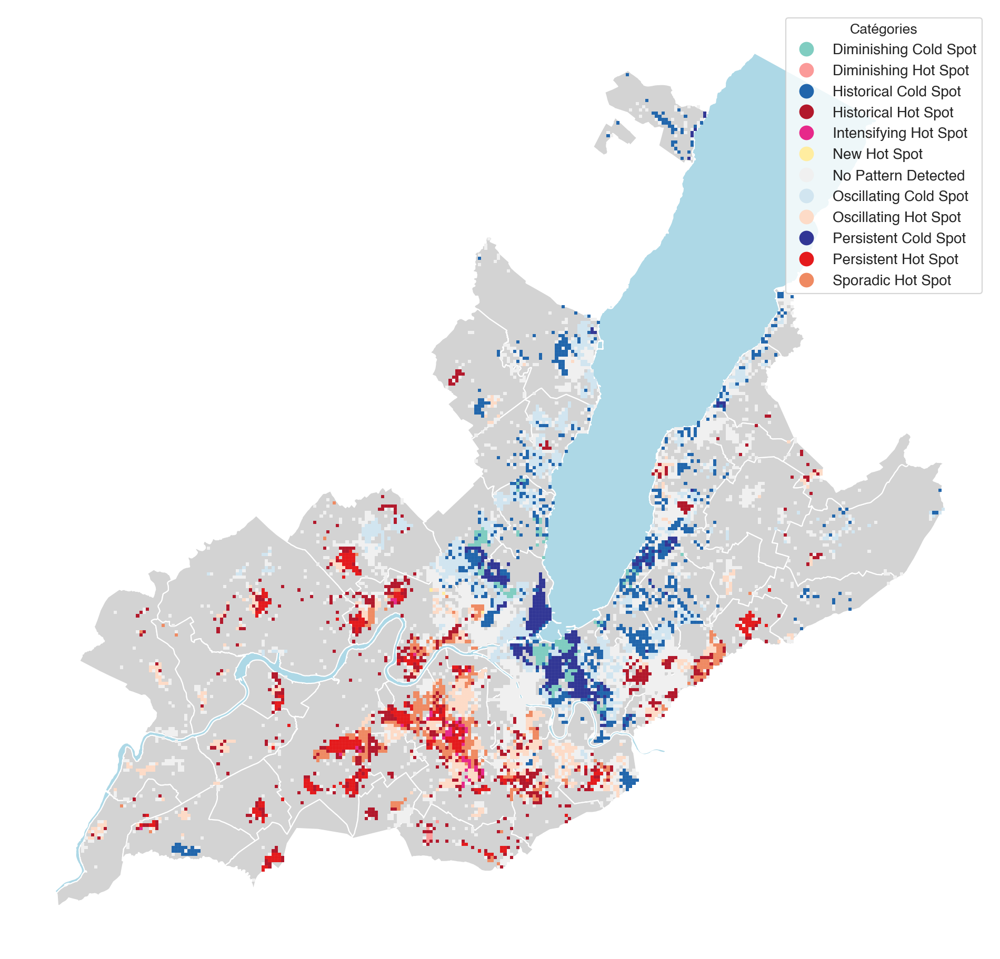

In [178]:
ax = df_emergent_getis_adj.plot('class', cmap = hmap, figsize = (12,12), zorder = 3, linewidth = 0.01, legend = True, legend_kwds = {'title':'Catégories','fontsize':10})
communes.plot(color = 'lightgrey', ax = ax, zorder = 1)
lake.plot(color = 'lightblue',ax = ax, zorder = 2)
ax.set_axis_off()
plt.savefig('../Results/Emergent Getis/Full_picture - Adjusted.png', dpi = 1200, bbox_inches = 'tight')

## Subanalyses

In [179]:
test = gdf_participation_ha.copy()

query = """select * from geounits.geo_girec;"""
geo_girec = gpd.GeoDataFrame.from_postgis(query,con = geo_engine,geom_col = 'geom')

In [180]:
mean_params_nom = gpd.sjoin(df_comparison_emergent_getis, geo_girec[['NOM','NUMERO','SECT_VILLE','CODE_SOUS_','geom']], predicate = 'intersects')

In [181]:
mean_params_nom = mean_params_nom.reset_index()

In [182]:
mean_params_nom = mean_params_nom.drop_duplicates(subset = 'RELI', keep = 'first')

In [183]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

In [184]:
mean_params_nom_paquis = mean_params_nom[mean_params_nom.NOM.str.contains('pâquis')]

In [185]:
nom_girec = mean_params_nom.pop('NOM')

In [186]:
# lut = dict(zip(nom_girec.unique(), "rbg"))
lut = {'pâquis-temple':'b','pâquis-navigation':'b','cornavin':'b','pâquis-centre':'b', 'pâquis-môle':'b'}
row_colors = nom_girec.map(lut)

In [187]:
features = ['ciqmd','ptot','center_nearest',
 'rpncam',
 'rpnnam',
 'rpnsam',
 'rpaf',
 'rpas','rpeu','rpnme',
 'rad3sec',
 'rad3tert',
 'rprnorel','income_ss','center_density','deprivation_pca','rpnch','wo_tertiary_education','dmdrent','rphh3p+']

In [188]:
mean_params_nom_std  = pd.DataFrame(scaler.fit_transform(mean_params_nom[features]),columns = features)

In [189]:
# sns.clustermap(mean_params_nom)
# sns.clustermap(mean_params_nom_std, row_colors=row_colors)

In [190]:
# fig, ax = plt.subplots(figsize = (12,12))
# sns.scatterplot(data = mean_params_nom, x = 'income_ss', y= 'dmdrent', ax = ax)
# def label_point(x, y, val, ax):
#     a = pd.concat({'x': x, 'y': y, 'val': val}, axis=1)
#     for i, point in a.iterrows():
#         ax.text(point['x']+.02, point['y'], str(point['val']), size = 8)

# label_point(mean_params_nom_paquis.income_ss, mean_params_nom_paquis.dmdrent, mean_params_nom_paquis.NOM, plt.gca())  

In [191]:
from sklearn.decomposition import PCA

#Standardize selected variables
x = mean_params_nom_std.values
# x = StandardScaler().fit_transform(x)

# microgis_data.to_feather('./microgis_data_depriv.feather',index = False)

#PCA with 3 components
pca = PCA(n_components=8)
X_pca = pca.fit_transform(x)
# principal_depriv_Df = pd.DataFrame(data = principalComponents_depriv
#              , columns = ['principal component 1', 'principal component 2','principal component 3'])

print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [ ]:
def pca_map(X,PC_a, PC_b, figsize=(10,10), sup="", print_values= False):
    #PCA
    columns=X.columns.values
    pca=PCA(n_components=8)
    pca.fit(X)
    pca_values=pca.components_
    
    #Plot
    plt.figure(figsize=figsize)
    plt.rcParams.update({'font.size': 14}) 
    
    #Plot circle
    x=np.linspace(start=-1,stop=1,num=500)
    y_positive=lambda x: np.sqrt(1-x**2) 
    y_negative=lambda x: -np.sqrt(1-x**2)
    plt.plot(x,list(map(y_positive, x)), color='maroon')
    plt.plot(x,list(map(y_negative, x)),color='maroon')
    
    #Plot smaller circle
    x=np.linspace(start=-0.5,stop=0.5,num=500)
    y_positive=lambda x: np.sqrt(0.5**2-x**2) 
    y_negative=lambda x: -np.sqrt(0.5**2-x**2)
    plt.plot(x,list(map(y_positive, x)), color='maroon')
    plt.plot(x,list(map(y_negative, x)),color='maroon')
    
    #Create broken lines
    x=np.linspace(start=-1,stop=1,num=30)
    plt.scatter(x,[0]*len(x), marker='_',color='maroon')
    plt.scatter([0]*len(x), x, marker='|',color='maroon')

    #Define color list
    colors = ['blue', 'red', 'green', 'black', 'purple', 'brown']
    if len(pca_values[0]) > 6:
        colors=colors*(int(len(pca_values[0])/6)+1)

    #Plot arrow
    add_string=""
    for i in range(len(pca_values[0])):
        xi=pca_values[PC_a-1][i]
        yi=pca_values[PC_b-1][i]
        plt.arrow(0,0, 
                  dx=xi, dy=yi, 
                  head_width=0.03, head_length=0.03, 
                  color=colors[i], length_includes_head=True)
        if print_values==True:
            add_string=f" ({round(xi,2)} {round(yi,2)})"
        plt.text(pca_values[PC_a-1, i], 
                 pca_values[PC_b-1, i] , 
                 s=columns[i] + add_string )

    plt.xlabel(f"Component {PC_a} ({round(pca.explained_variance_ratio_[PC_a-1]*100,2)}%)")
    plt.ylabel(f"Component {PC_b} ({round(pca.explained_variance_ratio_[PC_b-1]*100,2)}%)")
    plt.title('Variable factor map (PCA)')
    plt.suptitle(sup, y=1, fontsize=18)
    plt.show()

In [ ]:
# ??pca_map

In [ ]:
pca_map(mean_params_nom_std,1,2, figsize=(10,10), sup="Iris", print_values= False)

In [ ]:
# Calculate cumulative explained variance across all PCs

cum_exp_var = []
var_exp = 0
for i in pca.explained_variance_ratio_:
    var_exp += i
    cum_exp_var.append(var_exp)

# Plot cumulative explained variance for all PCs

fig, ax = plt.subplots(figsize=(8,6))
ax.bar(range(1,9), cum_exp_var)
ax.set_xlabel('# Principal Components')
ax.set_ylabel('% Cumulative Variance Explained');

In [ ]:
mean_params_nom['NOM'] = nom_girec

In [ ]:
mean_params_nom_paquis = mean_params_nom[mean_params_nom.NOM.str.contains('pâquis')]

In [ ]:
from sklearn.cluster import AgglomerativeClustering

In [ ]:
# X = mean_params_nom.drop('NOM',axis=1).values
# X = StandardScaler().fit_transform(X)

# hc = AgglomerativeClustering(n_clusters = 10, affinity = 'euclidean', linkage ='ward')
# y_hc = hc.fit_predict(X)
# mean_params_nom = mean_params_nom.assign(gp_hc = y_hc)

In [ ]:
mean_params_nom['PC1'] = X_pca.T[0]
mean_params_nom['PC2'] = X_pca.T[1]
mean_params_nom['PC3'] = X_pca.T[2]
mean_params_nom['PC4'] = X_pca.T[3]
mean_params_nom['PC5'] = X_pca.T[4]
mean_params_nom['PC6'] = X_pca.T[5]
mean_params_nom['PC7'] = X_pca.T[6]
mean_params_nom['PC8'] = X_pca.T[7]

In [ ]:
classes_mean = mean_params_nom.filter(regex = 'PC|class').groupby('class_emergent_getis').mean()

In [ ]:
mean_params_nom[mean_params_nom.NOM.str.contains('pâquis|prieuré')]

In [ ]:
classes_mean_paquis = mean_params_nom[mean_params_nom.NOM.str.contains('pâquis|prieuré')].filter(regex = 'PC|class').mean()
classes_mean_paquis = pd.DataFrame(classes_mean_paquis).T
classes_mean_paquis['NOM'] = 'Pâquis'

classes_mean_lignon = mean_params_nom[mean_params_nom.NOM.str.contains('lignon')].filter(regex = 'PC|class').mean()
classes_mean_lignon = pd.DataFrame(classes_mean_lignon).T
classes_mean_lignon['NOM'] = 'Lignon'

In [ ]:
classes_mean_girecs = mean_params_nom.filter(regex = 'NOM|PC').groupby('NOM').mean().reset_index()

In [ ]:
sns.heatmap(mean_params_nom[['PC1','PC2','PC3','ciqmd','income_ss','wo_tertiary_education','rpaf','center_density','rpnch']].corr(), cmap = 'bwr')

In [ ]:
n_class_by_nom = mean_params_nom[mean_params_nom.class_emergent_getis != 'Aucun modèle détecté'].groupby(['NOM','class_emergent_getis']).size()
df_n_class_by_nom = pd.DataFrame(n_class_by_nom, columns = ['n']).reset_index()
max_class_by_nom = df_n_class_by_nom[df_n_class_by_nom.index.isin(df_n_class_by_nom.groupby('NOM').n.idxmax().values)]
# max_class_by_nom['geometry'] = max_class_by_nom['NOM'].map(geo_girec.set_index('NOM')['geom'].to_dict())
max_class_by_nom
# max_class_by_nom = gpd.GeoDataFrame(max_class_by_nom, crs = 2056, geometry = max_class_by_nom['geometry'])

In [ ]:
classes_mean_girecs['max_class'] = classes_mean_girecs['NOM'].map(max_class_by_nom.set_index('NOM')['class_emergent_getis'].to_dict())

PC1 : Proportions de non-suisse, Précarité SES, accès
PC2 : Education et SES
PC3 : Rural-urbain

In [ ]:
def abline(slope, intercept):
    axes = plt.gca()
    x_vals = np.array(axes.get_xlim())
    y_vals = intercept + slope * x_vals
    plt.plot(x_vals, y_vals, '--', c = 'lightblue')
def avline(slope, intercept):
    axes = plt.gca()
    y_vals = np.array(axes.get_ylim())
    x_vals = intercept + slope * y_vals
    plt.plot(x_vals, y_vals, '--', c = 'lightblue')

In [ ]:
test = mean_params_nom.groupby('NOM').mean().reset_index()

In [ ]:
test[test.NOM.str.contains('champel|pâquis|prieuré|anière|cologny')][['NOM','ciqmd','dmdrent','deprivation_pca','wo_tertiary_education','PC2']].sort_values('PC2')

In [ ]:
def label_point(x, y, val, ax):
    a = pd.concat({'x': x, 'y': y, 'val': val}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x']+.02, point['y'], str(point['val']), size = 5)

In [ ]:
fig, ax = plt.subplots(figsize = (15,15))

sns.scatterplot(data = test, x = 'PC1', y= 'PC2')
label_point(test[test.NOM.str.contains('champel|pâquis|prieuré')].PC1, test[test.NOM.str.contains('champel|pâquis|prieuré')].PC2, classes_mean_girecs.NOM, plt.gca())  


In [ ]:
fig, ax = plt.subplots(figsize = (15,15))

sns.scatterplot(data = test, x = 'PC2', y= 'wo_tertiary_education')
label_point(test[test.NOM.str.contains('champel|pâquis|prieuré')].PC2, test[test.NOM.str.contains('champel|pâquis|prieuré')].wo_tertiary_education, classes_mean_girecs.NOM, plt.gca())  


In [ ]:
classes_mean

In [ ]:
import matplotlib.patches as mpatches

In [ ]:
fig, ax = plt.subplots(figsize = (15,15))
sns.scatterplot(data = classes_mean, x = 'PC1', y= 'PC2',hue = 'class_emergent_getis', s=100, palette = colors_cl_getis, ax = ax)
plt.legend(title='Classes', loc='upper left')

# sns.scatterplot(data = classes_mean_paquis, x = 'PC1',y = 'PC2', palette = {'Pâquis':'Green'}, hue = 'NOM', style = 'NOM', s = 150, ax = ax)
sns.scatterplot(data = classes_mean_girecs, x = 'PC1',y = 'PC2', s = 10, hue = 'max_class',palette = colors_cl_getis, markers = '*', legend = False,ax = ax)
# sns.regplot(data = classes_mean_girecs[classes_mean_girecs.max_class.str.contains('chaud', na = False)], x = 'PC1',y = 'PC2',color = 'red',scatter = False,ax = ax)
# sns.regplot(data = classes_mean_girecs[classes_mean_girecs.max_class.str.contains('froid', na = False)], x = 'PC1',y = 'PC2',color = 'blue',scatter = False,ax = ax)
abline(0, 0)
avline(0, 0)
ax.annotate('Aisé',xy=(8,5.5))
ax.annotate('Urbain',xy=(8,5.2))
ax.annotate('Cosmopolite',xy=(8,4.9))
left, bottom, width, height = (7.8, 4.7, 1.8, 1.1)
rect=mpatches.Rectangle((left,bottom),width,height, 
                        fill=False,
                        color="grey",
                       linewidth=2)
                       #facecolor="red")
plt.gca().add_patch(rect)

ax.annotate('Précaire',xy=(8,-3))
ax.annotate('Urbain',xy=(8,-3.3))
ax.annotate('Cosmopolite',xy=(8,-3.6))
left, bottom, width, height = (7.8, -3.8, 1.8, 1.1)
rect=mpatches.Rectangle((left,bottom),width,height, 
                        fill=False,
                        color="grey",
                       linewidth=2)
                       #facecolor="red")
plt.gca().add_patch(rect)
ax.annotate('Précaire',xy=(-4,-3))
ax.annotate('Rural/Périurbain',xy=(-4,-3.3))
ax.annotate('Faible pop. étrangère',xy=(-4,-3.6))
left, bottom, width, height = (-4.2, -3.8, 2.9, 1.1)
rect=mpatches.Rectangle((left,bottom),width,height, 
                        fill=False,
                        color="grey",
                       linewidth=2)
                       #facecolor="red")
plt.gca().add_patch(rect)
ax.annotate('Aisé',xy=(-4,5.5))
ax.annotate('Rural/Périurbain',xy=(-4,5.2))
ax.annotate('Faible pop. étrangère',xy=(-4,4.9))
left, bottom, width, height = (-4.2, 4.7, 2.9, 1.1)
rect=mpatches.Rectangle((left,bottom),width,height, 
                        fill=False,
                        color="grey",
                       linewidth=2)
                       #facecolor="red")
plt.gca().add_patch(rect)
# plt.legend([],[], frameon=False)
label_point(classes_mean_girecs.PC1, classes_mean_girecs.PC2, classes_mean_girecs.NOM, plt.gca())  

plt.xlabel(f"Première composante ({round(pca.explained_variance_ratio_[0]*100,1)}%)")
plt.ylabel(f"Première composante ({round(pca.explained_variance_ratio_[1]*100,1)}%)")
plt.savefig('../Results/PCA_emergent_geogirec_giracs_PC12.pdf',bbox_inches = 'tight')

In [ ]:
fig, ax = plt.subplots(figsize = (15,15))
sns.scatterplot(data = classes_mean, x = 'PC1', y= 'PC3',hue = 'class_emergent_getis', s=100, palette = colors_cl_getis, ax = ax)
sns.scatterplot(data = classes_mean_paquis, x = 'PC1',y = 'PC3', palette = {'Pâquis':'Green'}, hue = 'NOM', style = 'NOM', s = 150, ax = ax)
sns.scatterplot(data = classes_mean_girecs, x = 'PC1',y = 'PC3', s = 5, hue = 'max_class',palette = colors_cl_getis, ax = ax)
# plt.legend([],[], frameon=False)
def label_point(x, y, val, ax):
    a = pd.concat({'x': x, 'y': y, 'val': val}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x']+.02, point['y'], str(point['val']), size = 5)
label_point(classes_mean_girecs.PC1, classes_mean_girecs.PC3, classes_mean_girecs.NOM, plt.gca())  

plt.savefig('../Results/PCA_emergent_geogirec_giracs_PC13.pdf',bbox_inches = 'tight')

In [ ]:
fig, ax = plt.subplots(figsize = (15,15))
sns.scatterplot(data = classes_mean, x = 'PC2', y= 'PC3',hue = 'class_emergent_getis', s=100, palette = colors_cl_getis, ax = ax)
sns.scatterplot(data = classes_mean_paquis, x = 'PC2',y = 'PC3', palette = {'Pâquis':'Green'}, hue = 'NOM', style = 'NOM', s = 150, ax = ax)
sns.scatterplot(data = classes_mean_girecs, x = 'PC2',y = 'PC3', hue = 'max_class',palette = colors_cl_getis, s = 5, ax = ax)
# plt.legend([],[], frameon=False)
def label_point(x, y, val, ax):
    a = pd.concat({'x': x, 'y': y, 'val': val}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x']+.02, point['y'], str(point['val']), size = 5)
label_point(classes_mean_girecs.PC2, classes_mean_girecs.PC3, classes_mean_girecs.NOM, plt.gca())  

plt.savefig('../Results/PCA_emergent_geogirec_giracs_PC23.pdf',bbox_inches = 'tight')

In [ ]:
df_carte_interactive = df_comparison_emergent_getis[['ebs_rate','class_emergent_getis','geometry']]

In [ ]:
df_carte_interactive['ebs_rate'] = df_carte_interactive['ebs_rate'].round(1)
df_carte_interactive.columns = ['Taux de participation lissé (%)','Classe','geometry']

In [ ]:
m = df_carte_interactive.explore('Classe', cmap = hmap)
m
m.save('../Manuscript/Carte interactive - Analyse spatiotemporelle.html')

## Modelling

In [ ]:
from sklearn.model_selection import train_test_split
import xgboost
import shap
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler


In [ ]:
df_modelling = df_comparison_emergent_getis.copy()

In [ ]:
df_modelling['e'] = df_modelling.geometry.centroid.x
df_modelling['n'] = df_modelling.geometry.centroid.y

In [ ]:
df_modelling.name = '2020 participation'
y = 'mammo'
X_eq0 = ['income_ss','center_density','deprivation_pca','dmdrent','wo_tertiary_education','rpnch','ptot',
 '50-54',
 '55-59',
 '60-64',
 '65-69',
 '70-74']
# X_eq1 = ['LST','NDVI','pm25','no2','SES_cat','noise_car_night','B20BTOT','B20BTOT_lag8']
Xs = [X_eq0]

In [ ]:
# df_modelling[X_eq0] = StandardScaler().fit_transform(df_modelling[X_eq0])


In [ ]:
X_coords = df_modelling[X_eq0 + ['e','n']]
# X_coords = np.hstack([X,coords])
y = df_modelling['ebs_rate']

In [ ]:
names = ['Revenu médian','Dénsité de centres','Précarité SES','Loyer médian','Prop. de la pop. sans éduc. supérieure','Prop. de la pop. de nat. suisse',"Nombre d'habitants",
 '50-54',
 '55-59',
 '60-64',
 '65-69',
 '70-74',
'x-coord','y-coord']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_coords, y, 
                                                    test_size = 0.2, 
                                                    random_state = 0)

In [ ]:
%%time
from hyperopt import fmin, tpe, hp, STATUS_OK, Trials, space_eval

# Choose hyperparameter domain to search over
space = {
        'max_depth':hp.choice('max_depth', np.arange(1, 30, 1, dtype=int)),
        'colsample_bytree':hp.quniform('colsample_bytree', 0.3, 1.01, 0.05),
        'min_child_weight':hp.choice('min_child_weight', np.arange(1, 30, 1, dtype=int)),
        'subsample':        hp.quniform('subsample', 0.3, 1.01, 0.05),
        'learning_rate':    hp.choice('learning_rate',    np.arange(0.05, 1.01, 0.05)),
        'gamma': hp.quniform('gamma', 0.1, 5, 0.05),
    
        'objective':'reg:squarederror',
        'eval_metric': 'rmse',
    }

def score(params, n_folds=5):
    
    #Cross-validation
    d_train = xgboost.DMatrix(X_coords,y)
    
    cv_results = xgboost.cv(params, d_train, nfold = n_folds, num_boost_round=500,
                        early_stopping_rounds = 10, metrics = 'rmse', seed = 0)
    
    loss = min(cv_results['test-rmse-mean'])
    
    return loss

def optimize(trials, space, n_evals):
    
    best = fmin(score, space, algo=tpe.suggest, max_evals=n_evals,trials=trials,
                rstate=np.random.default_rng(333))#Add seed to fmin function
    return best

In [ ]:
# trials = Trials()
# best_params = optimize(trials, space, n_evals = 100)

# # Return the best parameters
# best_params = space_eval(space, best_params)

# best_params

In [ ]:
# with open('trials.pkl','wb') as f:
#     pickle.dump(trials, f)

# with open('best_params.pkl','wb') as f:
#     pickle.dump(best_params, f)

In [ ]:
sns.regplot(x = pd.DataFrame.from_dict(trials.results).index, y = pd.DataFrame.from_dict(trials.results).loss)

In [ ]:
d_train = xgboost.DMatrix(X_train, label=y_train)
d_test = xgboost.DMatrix(X_test, label=y_test)
d_all = xgboost.DMatrix(X_coords,label=y)

final_model = xgboost.train(best_params,  d_train, num_boost_round=500, evals = [(d_train,"train"),(d_test, "test")], 
                      verbose_eval=False, early_stopping_rounds=10)

y_pred_t = final_model.predict(d_test)

print("RMSE:",np.sqrt(mean_squared_error(y_test, y_pred_t)))
print("R2:",r2_score(y_test,y_pred_t))

In [ ]:
data_test = xgboost.DMatrix(X_test,y_test)
data = xgboost.DMatrix(X_train,y_train)
final_model = xgboost.train(best_params, data, num_boost_round=5000, verbose_eval=False,
                            evals=[(data_test, "Test")],early_stopping_rounds=10)


data_all = xgboost.DMatrix(X_coords)
y_pred = final_model.predict(data_all)
print('RMSE:',np.sqrt(mean_squared_error(y, y_pred)))
print('R2: ',r2_score(y, y_pred))

### Interpretation

In [ ]:
explainer_shap = shap.TreeExplainer(final_model)
shap_values = explainer_shap(X_coords)

shap_interaction_values = shap.TreeExplainer(final_model).shap_interaction_values(X_coords)

In [ ]:
shap.summary_plot(shap_values,feature_names = names)

In [ ]:
plt.figure(figsize=(4, 4), dpi=160)

shap.summary_plot(shap_interaction_values, X_coords, max_display=16, 
                  feature_names = names,
                  plot_type="compact_dot")

In [ ]:
f1_est = shap_values[:,0].values
f2_est = shap_values[:,1].values
f3_est = shap_values[:,2].values
f4_est = shap_values[:,3].values

In [ ]:
plt.figure(figsize=(10, 8), dpi=300)

plt.subplot(221)
# plt.plot(shap_values[:,0].data,shap_values[:,0].data*b1, label=r"True ($\beta_1=2$)",color="red")
plt.scatter(shap_values[:,0].data,f1_est, label="XGBoost",s=8)

plt.xlabel(names[0],fontsize=13)
plt.ylabel("SHAP value \n(impact on model output)",fontsize=13)
# plt.ylim(-,8)
plt.legend()

plt.subplot(222)
# plt.plot(shap_values[:,1].data,shap_values[:,1].data*b2, label=r"True ($\beta_2=1$)",color="red")
plt.scatter(shap_values[:,1].data,f2_est, label="XGBoost",s=8)


plt.xlabel(names[1],fontsize=13)
# plt.ylim(-8,8)
plt.legend()

plt.subplot(223)
# plt.plot(shap_values[:,1].data,shap_values[:,1].data*b2, label=r"True ($\beta_2=1$)",color="red")
plt.scatter(shap_values[:,2].data,f3_est, label="XGBoost",s=8)
plt.ylabel("SHAP value \n(impact on model output)",fontsize=13)


plt.xlabel(names[2],fontsize=13)
# plt.ylim(-8,8)
plt.legend()

plt.subplot(224)
# plt.plot(shap_values[:,1].data,shap_values[:,1].data*b2, label=r"True ($\beta_2=1$)",color="red")
plt.scatter(shap_values[:,3].data,f4_est, label="XGBoost",s=8)


plt.xlabel(names[3],fontsize=13)
# plt.ylim(-8,8)
plt.legend()

plt.tight_layout()

In [ ]:
f0_est = y.mean() + shap_values.values.sum(axis=1) 

In [ ]:
df_modelling['shap_values_pred'] = f0_est
df_modelling['pred'] = y_pred
df_modelling['residuals'] = df_modelling['ebs_rate'] - df_modelling['pred']


In [ ]:
df_modelling = df_modelling.reset_index()

In [ ]:
df_modelling[df_modelling['class_emergent_getis'] == 'Point froid persistant']

In [ ]:
?shap.plots.waterfall

In [ ]:
# Exemple point froid persistant
shap.plots.waterfall(shap_values[5738], feature_names = names)

In [ ]:
# Exemple nouveau point chaud
shap.plots.waterfall(shap_values[6])

In [ ]:
df_modelling.plot('residuals', linewidth = 0.01, cmap = 'viridis',legend = True, figsize = (10, 10))

In [ ]:
df_modelling['residuals_scaled'] = minmax_scale(df_modelling['residuals'], feature_range = (0,100))

In [ ]:
wnn16 = lps.weights.KNN(cKDTree(get_points_array(df_modelling.geometry.centroid)),16)
getiswnn16 = pyspace.compute_getis(df_modelling,'residuals_scaled',wnn16, 9999, p_001 = True)
fdr_pvalue = fdr(getiswnn16.p_sim, 0.05)
df_modelling['residuals_scaled_G_cl_fdr'] = df_modelling['residuals_scaled_G_cl']  
df_modelling.loc[df_modelling['residuals_scaled_G_psim'] >= fdr_pvalue, 'residuals_scaled_G_cl_fdr'] = 'Not significant'
fig, ax = pyspace.plotGetisMap(df_modelling,'residuals_scaled_G_cl',p_001 = True, commune_name = False)

In [ ]:
fig, ax = pyspace.plotGetisMap(df_modelling,'residuals_scaled_G_cl_fdr',p_001 = True, commune_name = False)

In [ ]:
fig, ax = plt.subplots(dpi=300)

df_modelling.plot(ax=ax, linewidth = 0.01, column = shap_values.values[:,-1] + shap_values.values[:,-2],
             legend=True,vmin=-0.6,vmax=0.6,figsize=(15,8),
                cmap=shap.plots.colors.red_white_blue)


plt.title("Effet géographique sur la participation \n(valeurs SHAP des coordonnées géographiques)\n",fontsize=8)

plt.axis('off')

In [ ]:
xgboost.plot_importance(final_model)
plt.title("xgboost.plot_importance(model)")
plt.show()

In [ ]:
xgboost.plot_importance(final_model, importance_type="cover")
plt.title('xgboost.plot_importance(model, importance_type="cover")')
plt.show()

In [ ]:
shap.summary_plot(shap_values, X_coords, plot_type="bar")

In [ ]:
# this takes a minute or two since we are explaining over 30 thousand samples in a model with over a thousand trees
explainer = shap.TreeExplainer(final_model)
shap_values = explainer.shap_values(X_coords)

shap.initjs() 
shap.force_plot(explainer.expected_value, shap_values[2,:], X_coords.iloc[2,:])

In [ ]:
shap.initjs() 
shap.force_plot(explainer.expected_value, shap_values[:2000,:], X_coords.iloc[:2000,:])

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

shap_pca50 = PCA(n_components=6).fit_transform(shap_values[:2000,:])
shap_embedded = TSNE(n_components=2, perplexity=50).fit_transform(shap_values[:2000,:])

In [ ]:
import matplotlib as mpl
cdict1 = {
    'red': ((0.0, 0.11764705882352941, 0.11764705882352941),
            (1.0, 0.9607843137254902, 0.9607843137254902)),

    'green': ((0.0, 0.5333333333333333, 0.5333333333333333),
              (1.0, 0.15294117647058825, 0.15294117647058825)),

    'blue': ((0.0, 0.8980392156862745, 0.8980392156862745),
             (1.0, 0.3411764705882353, 0.3411764705882353)),

    'alpha': ((0.0, 1, 1),
              (0.5, 1, 1),
              (1.0, 1, 1))
}  # #1E88E5 -> #ff0052
red_blue_solid = mpl.colors.LinearSegmentedColormap('RedBlue', cdict1)

In [ ]:
f = plt.figure(figsize=(5,5))
plt.scatter(shap_embedded[:,0],
           shap_embedded[:,1],
           c=shap_values[:2000,:].sum(1).astype(np.float64),
           linewidth=0, alpha=1., cmap=red_blue_solid)
cb = plt.colorbar(label="Participation", aspect=40, orientation="horizontal")
cb.set_alpha(1)
# cb.draw_all()
cb.outline.set_linewidth(0)
cb.ax.tick_params('x', length=0)
cb.ax.xaxis.set_label_position('top')
# plt.gca().axis("off")
# plt.show()

In [ ]:
for feature in ["income_ss",'center_density','deprivation_pca','ptot']:
    f = plt.figure(figsize=(5,5))
    plt.scatter(shap_embedded[:,0],
               shap_embedded[:,1],
               c=X_coords[feature].values[:2000].astype(np.float64),
               linewidth=0, alpha=1., cmap=red_blue_solid)
    cb = plt.colorbar(label=feature, aspect=40, orientation="horizontal")
    cb.set_alpha(1)
    cb.outline.set_linewidth(0)
    cb.ax.tick_params('x', length=0)
    cb.ax.xaxis.set_label_position('top')
    plt.gca().axis("off")
    plt.show()

## Hierarchical clustering

In [ ]:
geo_girec_hc = pd.merge(geo_girec, mean_params_nom[['NOM','gp_hc']], on = 'NOM')

In [ ]:
mean_params_nom['gp_hc'] = mean_params_nom['gp_hc'].astype(str)

In [ ]:
geo_girec_hc.explore('gp_hc')

In [ ]:
m = df_emergent_getis.explore('class', cmap = hmap)
geo_girec_hc.explore('gp_hc',m = m)

In [ ]:
def label_point(x, y, val, ax):
    a = pd.concat({'x': x, 'y': y, 'val': val}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x']+.02, point['y'], str(point['val']), size = 3)

In [ ]:
fig, ax = plt.subplots(figsize = (12,12))
sns.scatterplot(data = mean_params_nom, x = 'income_ss', y= 'dmdrent', hue = 'gp_hc', style = 'gp_hc', ax = ax)
label_point(mean_params_nom_paquis.income_ss, mean_params_nom_paquis.dmdrent, mean_params_nom_paquis.NOM, plt.gca())  

In [ ]:
# test.set_index('NOM')

In [ ]:
test['gp_hc'] = test['NOM'].map(mean_params_nom.set_index('NOM')['gp_hc'].to_dict())

In [ ]:
mean_params_nom.groupby('gp_hc').mean().ciqmd.plot.bar()

In [ ]:
mean_params_nom.groupby('gp_hc').mean().rpnch.plot.bar()

In [ ]:
test[(test.year_invit_2y == '2020')].groupby('gp_hc').mammo.mean()

In [ ]:
gp_paquis = test[(test.gp_hc.isin(['5']))&(test.year_invit_2y == '2020')]

In [ ]:
gp_paquis.groupby('NOM')['income_ss'].mean().sort_values().plot.bar()

### Decision tree

In [ ]:
mean_params_nom.columns

In [ ]:
feature_cols = ['ciqmd', 'ptot', 'center_nearest', 'rpnoce', 'rpncam', 'rpncas',
       'rpnceu', 'rpneeu', 'rpneceu', 'rpnfe', 'rpnme', 'rpnnaf', 'rpnnam',
       'rpnneu', 'rpnnweu', 'rpnsam', 'rpnsas', 'rpnseas', 'rpnseeu',
       'rpnsweu', 'rpnsubaf', 'rpnweu', 'rad3sec', 'rad3tert', 'rprprot',
       'rprcath', 'rprochr', 'rprjew', 'rprmusl', 'rproth', 'rprnorel',
       'income_ss', 'center_density', 'deprivation_pca', 'rpnch',
       'wo_tertiary_education', 'dmdrent', 'rp65+', 'rphh3p+']
X = mean_params_nom[feature_cols] # Features
y = mean_params_nom.gp_hc 

In [ ]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import s

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1) # 70% training and 30% test

In [ ]:
# Create Decision Tree classifer object
clf = DecisionTreeClassifier(criterion="entropy", max_depth=3)

# Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)


In [ ]:
#Predict the response for test dataset
y_pred = clf.predict(X_test)

In [ ]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

In [ ]:
from sklearn.tree import export_graphviz
from six import StringIO
  
from IPython.display import Image  
import pydotplus

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['0','1','2','3','4','5','6','7','8','9'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('HC_tree.png')
Image(graph.create_png())

In [ ]:
X_train

### Pourquoi cette zone "intensification de point chaud"?

In [ ]:
df_intensification_emergent = df_emergent_getis[df_emergent_getis['class'] == 'Intensification de point chaud']

In [ ]:
df_intensification_emergent

In [ ]:
df_intensification_hs = df_all_years[df_all_years.RELI.isin(df_intensification_emergent.index)]

In [ ]:
df_intensification_hs

## Legacy code

In [ ]:
with open('../Results/dfs_year.pkl','wb') as f:
    pickle.dump(dfs_year, f)

In [ ]:
df_ha['cumul_LISA_res'] = 0
df_ha['cumul_LISA_9909_res'] = 0
df_ha['cumul_LISA_1018_res'] = 0

df_ha['cumul_LISA_zscore_res'] = 0
df_ha['cumul_LISA_9909_zscore_res'] = 0
df_ha['cumul_LISA_1018_zscore_res'] = 0
for df_year in dfs_year:
    _dict = df_year.set_index('RELI')['ebs_rate_res_Zs'].to_dict()
    df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_res_cl'].isin(['1 High-High','4 High-Low'])].RELI),'cumul_LISA_res'] +=1
    df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_res_cl'].isin(['3 Low-Low','2 Low-High'])].RELI),'cumul_LISA_res'] -=1
    df_ha['cumul_LISA_zscore'] += df_ha['RELI'].map(_dict)
    if df_year.year_invit.astype(int).unique()[0] < 2010:
        df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_res_cl'].isin(['1 High-High','4 High-Low'])].RELI),'cumul_LISA_9909_res'] +=1
        df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_res_cl'].isin(['3 Low-Low','2 Low-High'])].RELI),'cumul_LISA_9909_res'] -=1
    if  df_year.year_invit.astype(int).unique()[0] > 2009 and df_year.year_invit.astype(int).unique()[0] < 2019:
        df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_res_cl'].isin(['1 High-High','4 High-Low'])].RELI),'cumul_LISA_1018_res'] +=1
        df_ha.loc[df_ha.RELI.isin(df_year[df_year['ebs_rate_res_cl'].isin(['3 Low-Low','2 Low-High'])].RELI),'cumul_LISA_1018_res'] -=1

In [ ]:
df_ha['cumul_LISA_res_q3'] = pd.qcut(df_ha['cumul_LISA_res'], 3)
dict_cumul_LISA_res_q3 = df_ha.set_index('RELI')['cumul_LISA_res_q3'].to_dict()
df_ebs_over_years['cumul_LISA_res_q3'] = df_ebs_over_years.RELI.map(dict_cumul_LISA_res_q3)

In [ ]:
df_heatmap = df_ebs_over_years.groupby(['cumul_LISA_res_q3','index_socio_q3']).mean().reset_index()
df_heatmap = df_heatmap.pivot(index = 'cumul_LISA_res_q3',columns = 'index_socio_q3', values = 'ebs_rate')
df_heatmap.columns = ['Low','Medium','High']
df_heatmap = df_heatmap.sort_values('cumul_LISA_res_q3', ascending = False)

In [ ]:
fig, ax = plt.subplots(figsize = (10, 10))
df_ha.plot('cumul_LISA_res', legend = True, cmap = 'bwr', ax = ax, zorder = 3, legend_kwds = {'label':'Cumulated LISA cluster score','shrink':0.5})
communes.plot(color = 'lightgrey', alpha = 0.6, ax = ax, zorder = 1)
lake.plot(color = 'lightblue',ax = ax, zorder = 2)
lake.apply(lambda x: ax.annotate(text=x.NOM, xy=x.geometry.centroid.coords[0], ha='center', size=12), axis=1)

ax.set_axis_off()

left, bottom, width, height = [0.2, 0.55, 0.14, 0.12]
ax2 = fig.add_axes([left, bottom, width, height])
sns.set_context("paper")
x_label = 'Deprivation'
y_label = 'Cumulated cluster score'
chart = sns.heatmap(df_heatmap, cmap = 'Blues', alpha = 0.8, cbar_kws={'label': 'Participation rate (%)'})
chart.set_xticklabels(chart.get_xticklabels(),size=8, rotation=0, horizontalalignment='center')
chart.set_yticklabels(chart.get_yticklabels(),color = 'white', size=0, rotation=0, horizontalalignment='right')

plt.tick_params(bottom = False, left = False)

chart.set_xlabel(x_label, size=10)
chart.set_ylabel(y_label, size=10)



plt.savefig('../Results/LISA - Hectares/Cumulated LISA/Biannual_LISA_cumulated_socioadj_wnn16_005.png', dpi = 300, bbox_inches = 'tight')
# plt.savefig('../Results/LISA - Hectares/Cumulated LISA/Biannual_LISA_cumulated_socioadj_wnn16_005.pdf', bbox_inches = 'tight')

In [ ]:
df_ha.to_crs(21781).to_feather('20220130_df_giracs_ha.feather')

### Stability of participation over time among LISA classes

In [ ]:
fig, ax = plt.subplots(figsize = (15,8))
# the size of A4 paper
g = sns.lineplot(data=df_all_years_2020ha.groupby(['year_invit','ebs_rate_cl']).mean().reset_index(), x="year_invit", y="ebs_rate", hue = 'ebs_rate_cl', palette = colors_cl, errorbar = ('ci', 95),ax = ax)
for l in g.lines:
    y = l.get_ydata()
    if len(y)>0:
        g.annotate(f'{y[-1]:.1f}', xy=(1,y[-1]), xycoords=('axes fraction', 'data'), 
                     ha='left', va='center', color=l.get_color(), size = 12)
ax.set_xlabel('Date',labelpad = 10, size = 16)
ax.set_ylabel('Taux de vaccination (%)',labelpad = 10, size = 16)
plt.legend(prop={'size': 14})
plt.xticks(size = 12)
plt.yticks(size = 12)
ax.grid('on', which='minor', axis='x' )
ax.grid('on', which='major', axis='y')
plt.title('Evolution du taux de participation au sein des clusters locaux (LISA) identifiés en 2020',size = 16)

In [ ]:
fig, ax = plt.subplots(figsize = (15,8))
# the size of A4 paper
g = sns.lineplot(data=df_all_years_2020ha, x="year_invit", y="ebs_rate", hue = 'ebs_rate_cl', palette = colors_cl, errorbar = ('ci', 95),ax = ax)
for l in g.lines:
    y = l.get_ydata()
    if len(y)>0:
        g.annotate(f'{y[-1]:.1f}', xy=(1,y[-1]), xycoords=('axes fraction', 'data'), 
                     ha='left', va='center', color=l.get_color(), size = 12)
ax.set_xlabel('Date',labelpad = 10, size = 16)
ax.set_ylabel('Taux de vaccination (%)',labelpad = 10, size = 16)
plt.legend(prop={'size': 14})
plt.xticks(size = 12)
plt.yticks(size = 12)
ax.grid('on', which='minor', axis='x' )
ax.grid('on', which='major', axis='y')
plt.title('Evolution du taux de participation au sein des clusters locaux (LISA) identifiés en 2020',size = 16)

## HC

In [ ]:
cluster_result_folder = Path('../Results/Cluster analyses/')
if not os.path.exists(cluster_result_folder):
    os.makedirs(cluster_result_folder)

In [ ]:
ha_charac = []
for df_year in dfs_year:
    y_mean_by_ha = pd.DataFrame(pd.merge(gdf_participation_ha,df_year.drop('year_invit', axis = 1), on = 'RELI').groupby('RELI')[['year_invit','ptot','income_ss','center_density','center_nearest','deprivation_pca','50-54','55-59','60-64','65-69','70-74','75-79','80-84']].mean()).reset_index()
    y_mean_by_ha['geometry'] = y_mean_by_ha['RELI'].map(df_year[['RELI','geometry']].set_index('RELI').to_dict()['geometry'])
    ha_charac.append(y_mean_by_ha)

In [ ]:
from sklearn.cluster import AgglomerativeClustering
has_hcs = []

for has in ha_charac:
    X = has.iloc[:,1:13].values
    hc = AgglomerativeClustering(n_clusters = 3, affinity = 'euclidean', linkage ='ward')
    y_hc = hc.fit_predict(X)
    has = has.assign(gp_hc = y_hc)
    has_hcs.append(has)


In [ ]:
from matplotlib import colors
def plot_hc(clusters,df,col,period):
    fig, ax = plt.subplots(1, figsize=(15, 15))
    hmap = colors.ListedColormap(['#2166ac','#67a9cf','#d1e5f0','#b2182b','#ef8a62','#fddbc7','#f7f7f7'])
    communes.plot(ax = ax, label='Communes',alpha = 0.3,color=None,edgecolor='black',facecolor='grey')
    communes.apply(lambda x: ax.annotate(text=x.NAME, xy=x.geometry.centroid.coords[0], ha='center',size = 7),axis=1);
    
    lake.plot(ax = ax, label='Lake',alpha = 1,color = 'lightblue',edgecolor='None')
#     df.plot(col,cmap=hmap,markersize = 3,alpha = 0.4,ax = ax,categorical=True)
    hmap = colors.ListedColormap(['#beaed4','#fdc086','#7fc97f'])
    ##plot
    df_high = df[df[col].isin(['1 High-High','4 High-Low'])]
    df_low = df[df[col].isin(['3 Low-Low','2 Low-High'])]

    df_low.plot('gp_hc',cmap = hmap,ax = ax,alpha = 1,categorical = True,edgecolor='blue',linewidth=0.2)
    df_high.plot('gp_hc',cmap = hmap,ax = ax,alpha = 1,categorical = True,edgecolor='red',linewidth=0.2)

#     chulls_cold.plot(ax = ax,color = 'blue',alpha = 0.4,edgecolor='None')
#     hmap = colors.ListedColormap(['#fdbf6f','#cab2d6', '#ffffb3','#f03b20'])
#     ashapes_hc_hot.plot('gp_hc',cmap = hmap,ax = ax,alpha = 0.6,categorical = True,edgecolor='red',linewidth=1.4)
#     chulls_hot.plot(ax = ax,color = 'red',alpha = 0.4,edgecolor='None')
#     ashapes_hc_cold.apply(lambda x: ax.annotate(text=x['desc'], xy=x.geometry.centroid.coords[0], ha='center',size = 8),axis=1);
#     ashapes_hc_hot.apply(lambda x: ax.annotate(text=x['desc'], xy=x.geometry.centroid.coords[0], ha='center',size = 8),axis=1);

    ax.set_facecolor('grey')
    ax.set_axis_off()
    filename = "Getis Clusters Alpha Shapes with HC - {} - {}.pdf".format('HA - Mammo',period)
    plt.title(period)
    plt.savefig(cluster_result_folder/filename, dpi = 300,bbox_inches = 'tight')
    return fig, ax



In [ ]:
len(dfs_year)

In [ ]:
for ha_hc, df_year in zip(has_hcs, dfs_year):
    print(df_year.year_invit.unique()[0])
    ha_hc = gpd.GeoDataFrame(ha_hc, crs = 2056, geometry = ha_hc['geometry'])
    df_year['gp_hc'] = df_year.RELI.map(ha_hc[['RELI','gp_hc']].set_index('RELI').to_dict()['gp_hc'])
    plot_hc(ha_hc,df_year,'ebs_rate_cl', df_year.year_invit.unique()[0])

In [ ]:
dfs_year[10].plot('gp_hc', legend = True, categorical = True)

In [ ]:
has_hcs[10].groupby(['gp_hc'])[['income_ss','deprivation_pca','center_nearest','ptot']].mean().round(1).sort_values('income_ss')

In [ ]:
from sklearn.cluster import AgglomerativeClustering
X = df_year.iloc[:,4:].values
hc = AgglomerativeClustering(n_clusters = 3, affinity = 'euclidean', linkage ='ward')
try:
    y_hc_Cold = hc.fit_predict(X_cold)
    y_hc_Hot = hc.fit_predict(X_hot)

    ashape_cold = ashape_cold.assign(gp_hc = y_hc_Cold)
    ashape_hot = ashape_hot.assign(gp_hc = y_hc_Hot)
    ashape_hc = pd.concat([ashape_hot,ashape_cold])
    ashape_hcs.append(ashape_hc)
except:
    pass

# Spatial panel model

### Define list of hectares present in all years

In [ ]:
n_invit_by_ha

In [ ]:
test = n_invit_by_ha.drop(['2000','2002','2004','2006'], axis = 1)

In [ ]:
test = test.set_index('RELI')

In [ ]:
dfs_year

In [ ]:
year = 2000
for df in dfs_year:
    df = df.set_index('RELI')
    print(year)
    colname = 'PR'+ str(year)
    test[colname] = df['ebs_rate']
    year += 2

In [ ]:
test

In [ ]:
test = test.drop(['PR2000','PR2002','PR2004','PR2006'], axis = 1)

In [ ]:
PR_ = test[test>0].filter(regex = 'PR').dropna()
PR_ = PR_.fillna(0)

In [ ]:
# Define dependent variable
name_y = [ "PR2008","PR2010","PR2012","PR2014","PR2016","PR2018","PR2020"]
y = np.array([PR_[name] for name in name_y]).T


In [ ]:
name_x = ['Intercept2008','Intercept2010','Intercept2012','Intercept2014','Intercept2016','Intercept2018','Intercept2020']
x = np.array([np.random.normal(3,2.5,size = (4195)) for name in name_x]).T

In [ ]:
w = lps.weights.KNN.from_dataframe(df_ha[df_ha.RELI.isin(test[test>0].dropna().index)], k = 24)

In [ ]:
import spreg
fe_lag = spreg.Panel_FE_Lag(
    y, x, w, name_y=name_y, name_x=name_x, name_ds="NAT")

In [ ]:
pickle.dump(fe_lag, open('../Results/panel_model.pkl', 'wb'))

In [ ]:
with open('../Results/panel_model.pkl', 'rb') as f:
    fe_lag = pickle.load(f)

In [ ]:
print(fe_lag.summary)

# Données Bus Santé

In [ ]:
query = '''select a.codbar_new, a.geom, b.mamo1,b.mamo2,b.mamo3, a.yy_surv, a.age,b.ctry_bth from bussante_tr.bussante_id a, bussante_tr.qs_9219 b where a.codbar_new = b.codbar_new and b.mamo1 is not null;'''
bussante_data = gpd.GeoDataFrame.from_postgis(query,con = engine,geom_col = 'geom')

In [ ]:
bussante_data_ha = gpd.sjoin(bussante_data,df_ha[['RELI','geometry']], predicate = 'intersects')

In [ ]:
bussante_data_ha.drop('index_right',axis = 1,inplace = True)

In [ ]:
n_bus_mammo_by_ha = pd.DataFrame(bussante_data_ha.groupby(['RELI','yy_surv']).mamo1.sum()).reset_index()

In [ ]:
bussante_data = gpd.sjoin(bussante_data, communes[['geom']], predicate = 'intersects').drop('index_right', axis = 1)

In [ ]:
bussante_data['e'] = bussante_data['geom'].x
bussante_data['n'] = bussante_data['geom'].y

In [ ]:
bussante_data = pyspace.add_random_noise(bussante_data)

In [ ]:
w_mammo = lps.weights.KNN.from_dataframe(bussante_data, k = 24)
bussante_data, wq600_giracs_bus = pyspace.get_distanceBandW(bussante_data,600)


In [ ]:
gi_bus = pyspace.compute_getis(bussante_data, 'mamo1', wq600_giracs_bus, 999)
fig, ax = pyspace.plotGetisMap(bussante_data,'mamo1_G_cl',p_001 = False)

In [ ]:
bussante_data_mamo3 = bussante_data[(bussante_data.mamo3.isnull() == False)&(bussante_data_mamo3.mamo1 == 1)&(bussante_data_mamo3.age < 80)]

In [ ]:
bussante_data_mamo3['diff_age_mamo3'] = bussante_data_mamo3['age'] - bussante_data_mamo3['mamo3']

In [ ]:
bussante_data_mamo3, wq600_giracs_bus_mamo3 = pyspace.get_distanceBandW(bussante_data_mamo3, 600)

In [ ]:
bussante_data_mamo3[bussante_data_mamo3.mamo3_G_cl.isnull()]

In [ ]:
gi_bus = pyspace.compute_getis(bussante_data_mamo3, 'diff_age_mamo3', wq600_giracs_bus_mamo3, 999)
fig, ax = pyspace.plotGetisMap(bussante_data_mamo3,'diff_age_mamo3_G_cl',p_001 = False)

## Fidélité au programme

In [ ]:
n_mammo_by_patient = gdf_participation.groupby('numerodossier').mammo.sum()

In [ ]:
patients_with_atleast_one_mammo = n_mammo_by_patient[n_mammo_by_patient > 0].index.tolist()

In [ ]:
gdf_participation_onemammo = gdf_participation[gdf_participation.numerodossier.isin(patients_with_atleast_one_mammo)]

In [ ]:
gdf_participation.isna().sum().sort_values()

In [ ]:
patients_invited_atleast_5times = gdf_participation_onemammo[gdf_participation_onemammo.numeroinvitation_seq == 5].numerodossier.tolist()

In [ ]:
gdf_participation_onemammo_5timesplus = gdf_participation_onemammo[gdf_participation_onemammo.numerodossier.isin(patients_invited_atleast_5times)]

In [ ]:
gdf_participation_onemammo_5timesplus